<center><h1>1-cd: Convolutional Neural Networks (ConvNets)</h1></center>

In [1]:
#!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git
! wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py

--2024-10-28 09:00:14--  https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py [following]
--2024-10-28 09:00:14--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2627 (2.6K) [text/plain]
Saving to: ‘utils.py.5’

utils.py.5          100%[===================>]   2.57K  --.-KB/s    in 0s      

2024-10-28 09:00:14 (19.4 MB/s) - ‘utils.py.5’ saved [2627/2627]



In [2]:
%run 'utils.py'

In [3]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from utils import *

PRINT_INTERVAL = 200
PATH="datasets"

In [4]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(1, 6, (5, 5), stride=1, padding=2),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(6, 16, (5, 5), stride=1, padding=0),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(400, 120),
            nn.Tanh(),
            nn.Linear(120, 84),
            nn.Tanh(),
            nn.Linear(84, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output

In [5]:
def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.MNIST(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.MNIST(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

In [6]:
def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss

In [7]:
def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

## Part 2 Training from scratch of the model

=== EPOCH 1 =====

[TRAIN Batch 000/469]	Time 1.783s (1.783s)	Loss 2.3148 (2.3148)	Prec@1  13.3 ( 13.3)	Prec@5  41.4 ( 41.4)


<Figure size 640x480 with 0 Axes>

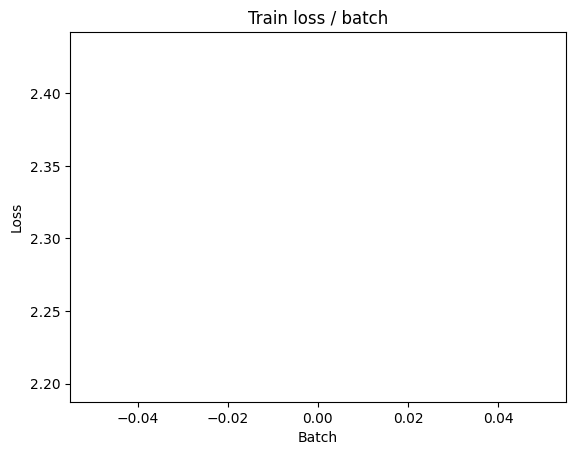

[TRAIN Batch 200/469]	Time 0.014s (0.021s)	Loss 0.2714 (1.0749)	Prec@1  92.2 ( 69.1)	Prec@5 100.0 ( 92.4)


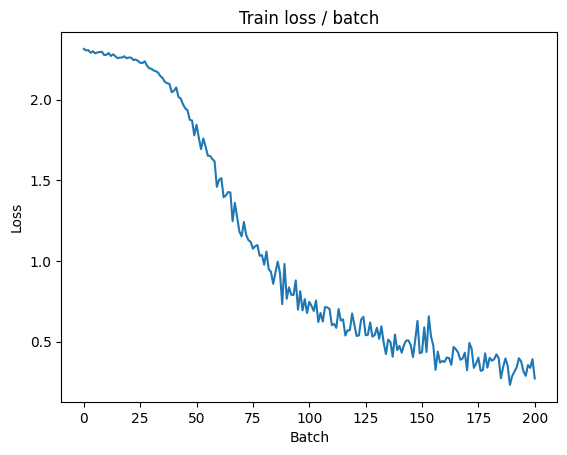

[TRAIN Batch 400/469]	Time 0.007s (0.017s)	Loss 0.1059 (0.6516)	Prec@1  96.9 ( 81.4)	Prec@5 100.0 ( 96.1)


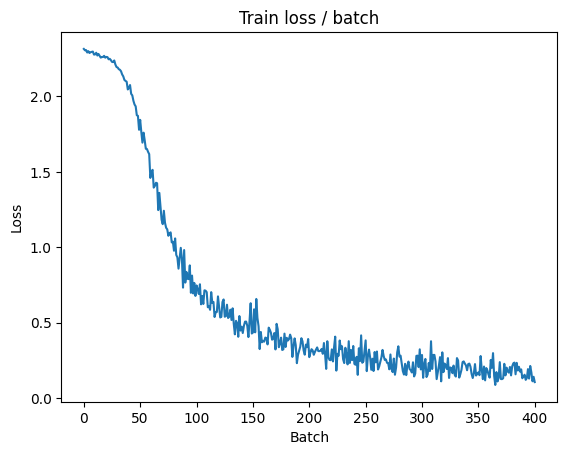


===============> Total time 7s	Avg loss 0.5800	Avg Prec@1 83.41 %	Avg Prec@5 96.62 %

[EVAL Batch 000/079]	Time 0.066s (0.066s)	Loss 0.1118 (0.1118)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.1459	Avg Prec@1 95.70 %	Avg Prec@5 99.90 %



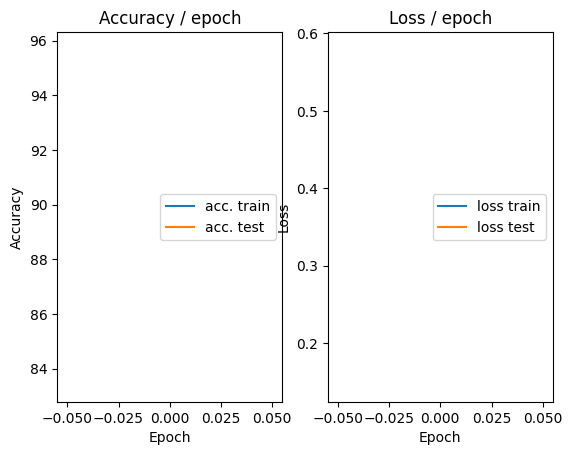

=== EPOCH 2 =====

[TRAIN Batch 000/469]	Time 0.073s (0.073s)	Loss 0.1435 (0.1435)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


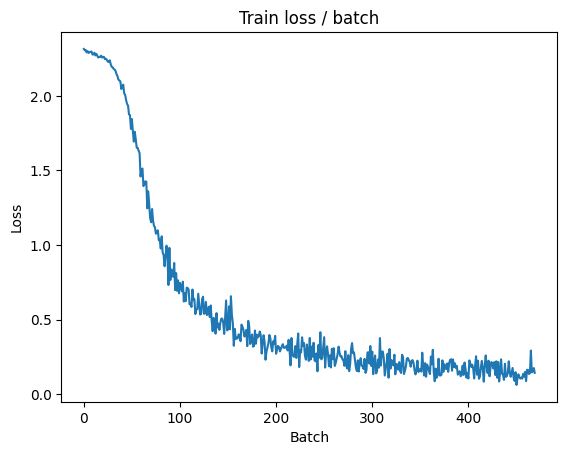

[TRAIN Batch 200/469]	Time 0.011s (0.013s)	Loss 0.1036 (0.1294)	Prec@1  97.7 ( 96.3)	Prec@5 100.0 ( 99.9)


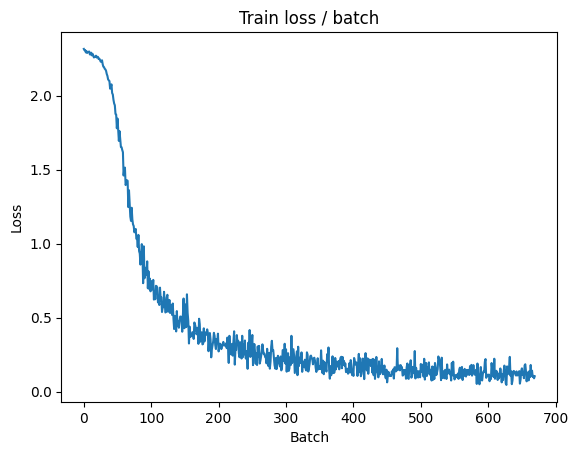

[TRAIN Batch 400/469]	Time 0.010s (0.012s)	Loss 0.1450 (0.1175)	Prec@1  95.3 ( 96.6)	Prec@5  99.2 ( 99.9)


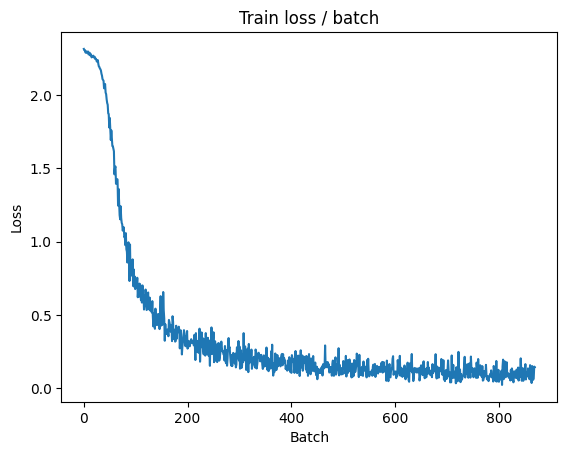


===============> Total time 5s	Avg loss 0.1140	Avg Prec@1 96.65 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.060s (0.060s)	Loss 0.0407 (0.0407)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0818	Avg Prec@1 97.56 %	Avg Prec@5 100.00 %



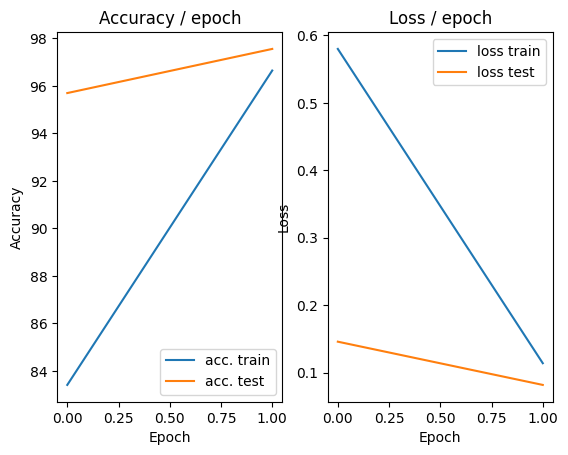

=== EPOCH 3 =====

[TRAIN Batch 000/469]	Time 0.091s (0.091s)	Loss 0.1803 (0.1803)	Prec@1  95.3 ( 95.3)	Prec@5  99.2 ( 99.2)


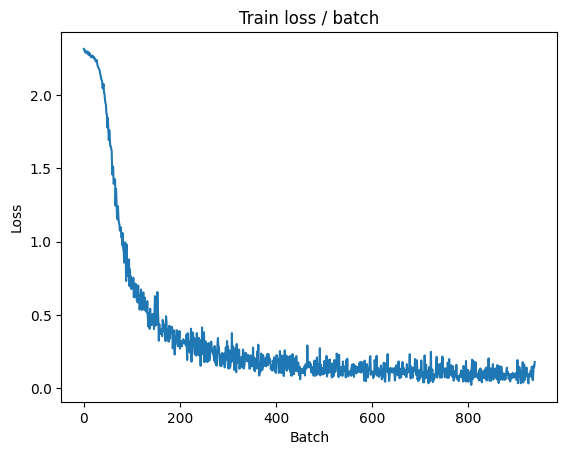

[TRAIN Batch 200/469]	Time 0.008s (0.014s)	Loss 0.1389 (0.0862)	Prec@1  96.9 ( 97.4)	Prec@5 100.0 ( 99.9)


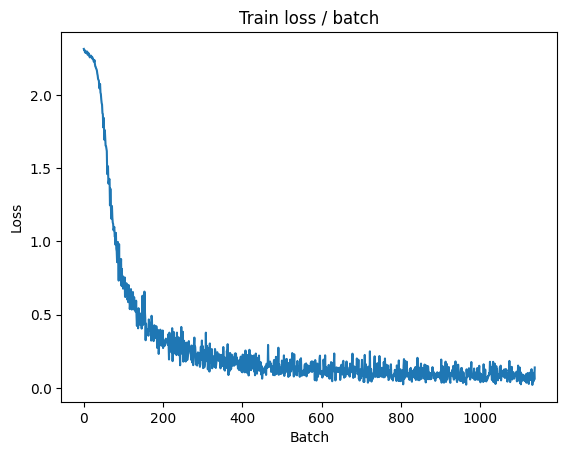

[TRAIN Batch 400/469]	Time 0.012s (0.014s)	Loss 0.0564 (0.0815)	Prec@1  97.7 ( 97.6)	Prec@5 100.0 ( 99.9)


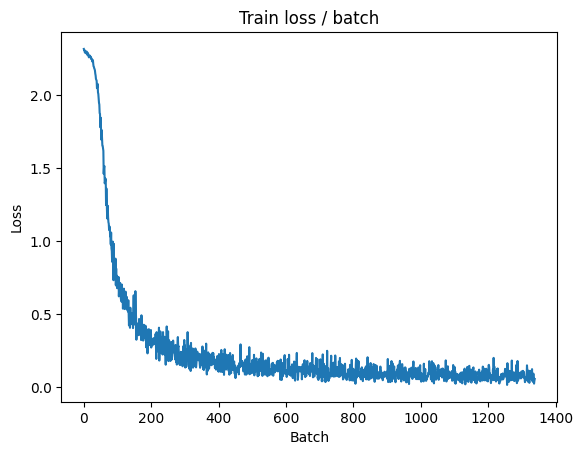


===============> Total time 6s	Avg loss 0.0787	Avg Prec@1 97.65 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 0.0299 (0.0299)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0602	Avg Prec@1 98.15 %	Avg Prec@5 100.00 %



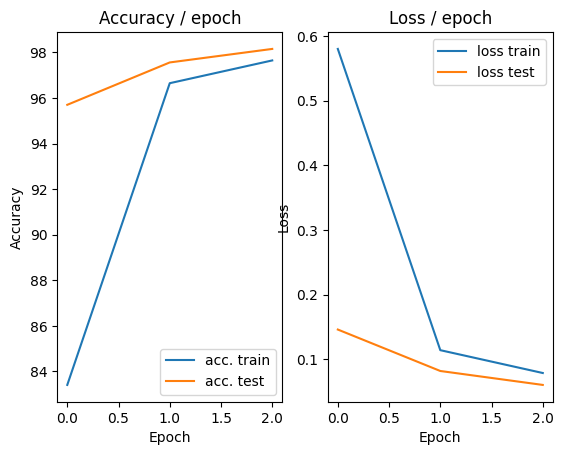

=== EPOCH 4 =====

[TRAIN Batch 000/469]	Time 0.127s (0.127s)	Loss 0.1199 (0.1199)	Prec@1  95.3 ( 95.3)	Prec@5  99.2 ( 99.2)


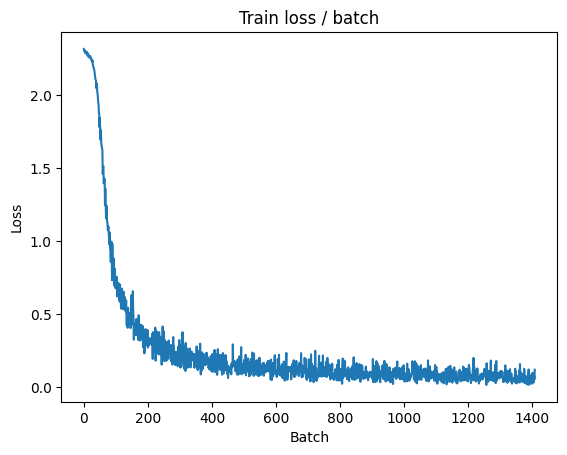

[TRAIN Batch 200/469]	Time 0.026s (0.020s)	Loss 0.0426 (0.0635)	Prec@1  99.2 ( 98.1)	Prec@5 100.0 (100.0)


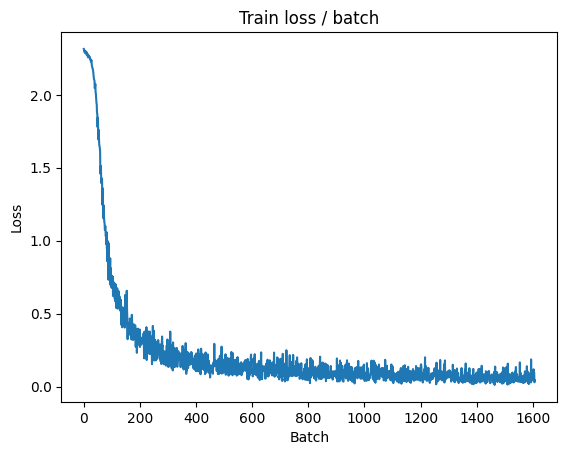

[TRAIN Batch 400/469]	Time 0.018s (0.019s)	Loss 0.0553 (0.0625)	Prec@1  98.4 ( 98.1)	Prec@5 100.0 (100.0)


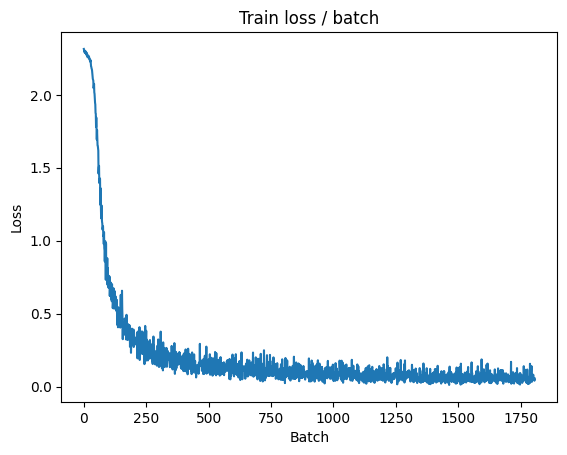


===============> Total time 8s	Avg loss 0.0621	Avg Prec@1 98.15 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.0342 (0.0342)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0565	Avg Prec@1 98.27 %	Avg Prec@5 100.00 %



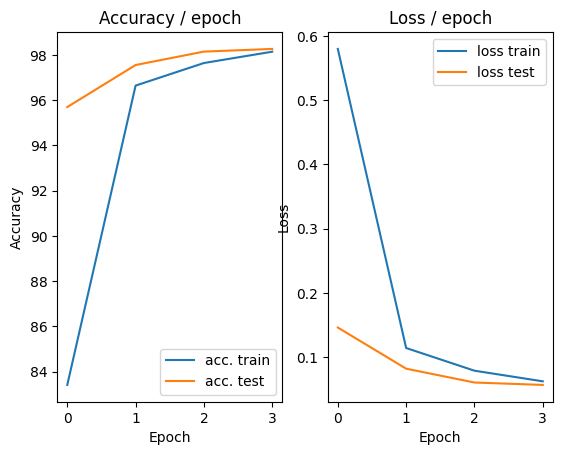

=== EPOCH 5 =====

[TRAIN Batch 000/469]	Time 0.134s (0.134s)	Loss 0.0599 (0.0599)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


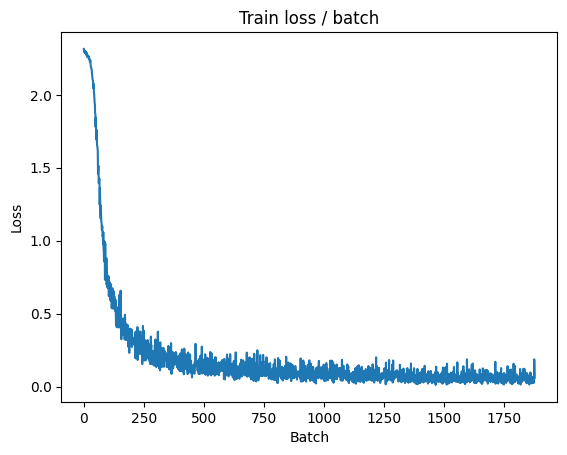

[TRAIN Batch 200/469]	Time 0.025s (0.018s)	Loss 0.0857 (0.0539)	Prec@1  97.7 ( 98.4)	Prec@5 100.0 (100.0)


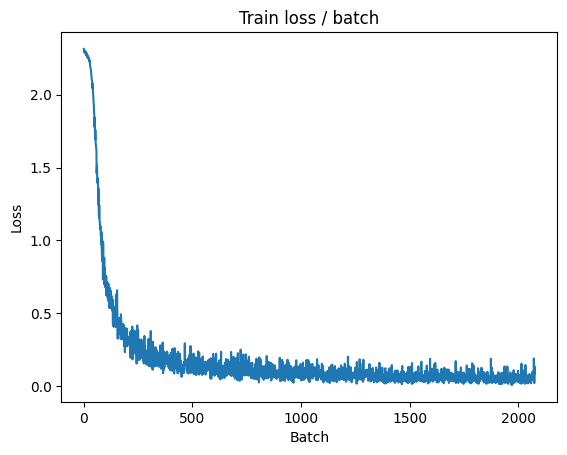

[TRAIN Batch 400/469]	Time 0.025s (0.018s)	Loss 0.0266 (0.0535)	Prec@1 100.0 ( 98.4)	Prec@5 100.0 (100.0)


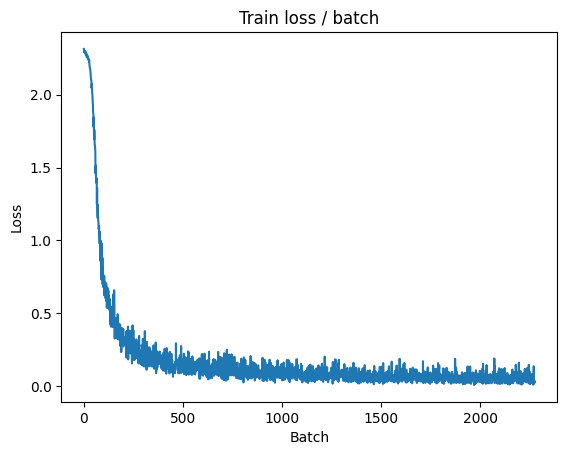


===============> Total time 8s	Avg loss 0.0525	Avg Prec@1 98.44 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 0.0192 (0.0192)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0425	Avg Prec@1 98.61 %	Avg Prec@5 100.00 %



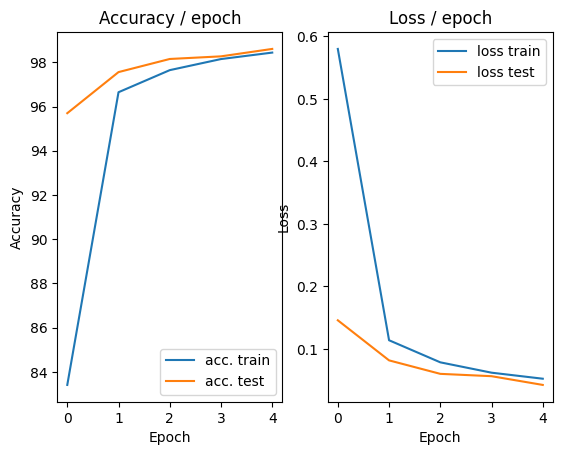

In [8]:
batch_size = 128
lr = 0.1
epochs = 5
main(batch_size, lr, epochs, cuda=True)

**Question 15** : Modify the code to use the CIFAR-10 dataset and implement the architecture requested above. 

In [9]:
def get_dataset(batch_size, cuda=False, download=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=download,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=download,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

In [10]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),      # output: 32 32 32
            nn.ReLU(),
            nn.MaxPool2d((2,2),stride=2,padding=0),             # output: 16 16 32

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),     # output: 16 16 64
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),          # output: 8 8 64

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),     # output: 8 8 64
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),          # output: 4 4 64
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(4*4*64, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10),
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output

In [11]:
#  We add the 'download' parameter prevents re-downloading the dataset if it already exists 
def main(batch_size=128, lr=0.1, epochs=5, cuda=False, download=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda, download)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 2.192s (2.192s)	Loss 2.3037 (2.3037)	Prec@1  14.1 ( 14.1)	Prec@5  43.0 ( 43.0)


<Figure size 640x480 with 0 Axes>

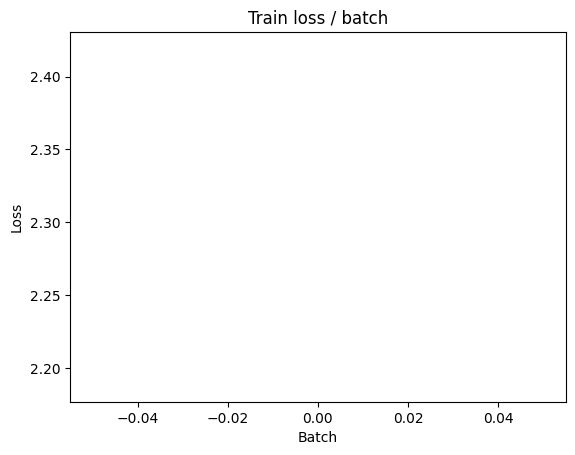

[TRAIN Batch 200/391]	Time 0.061s (0.072s)	Loss 2.1645 (2.2380)	Prec@1  17.2 ( 15.8)	Prec@5  72.7 ( 62.6)


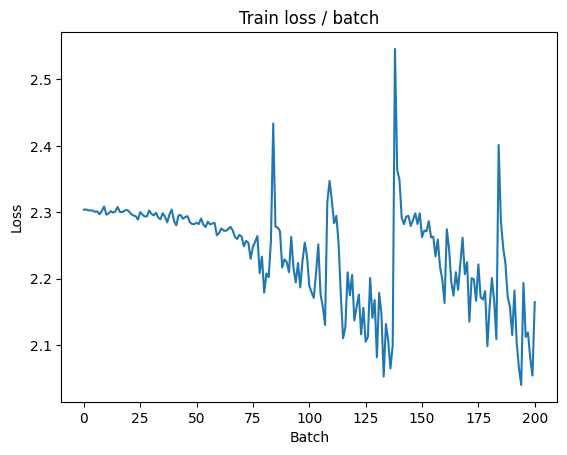


===============> Total time 27s	Avg loss 2.1494	Avg Prec@1 20.25 %	Avg Prec@5 68.96 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 2.1034 (2.1034)	Prec@1  25.8 ( 25.8)	Prec@5  78.1 ( 78.1)

===============> Total time 1s	Avg loss 2.0720	Avg Prec@1 26.54 %	Avg Prec@5 76.48 %



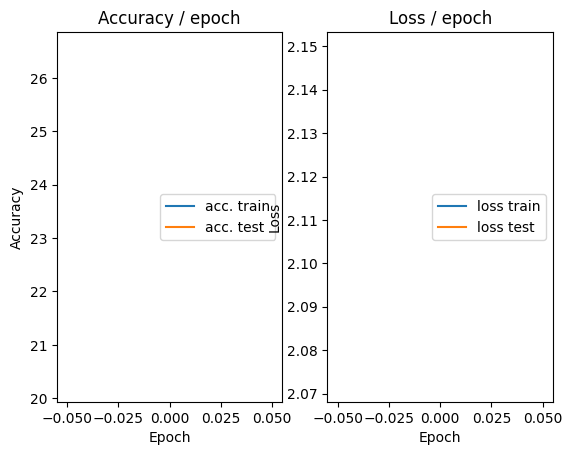

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.093s (0.093s)	Loss 2.0816 (2.0816)	Prec@1  25.8 ( 25.8)	Prec@5  72.7 ( 72.7)


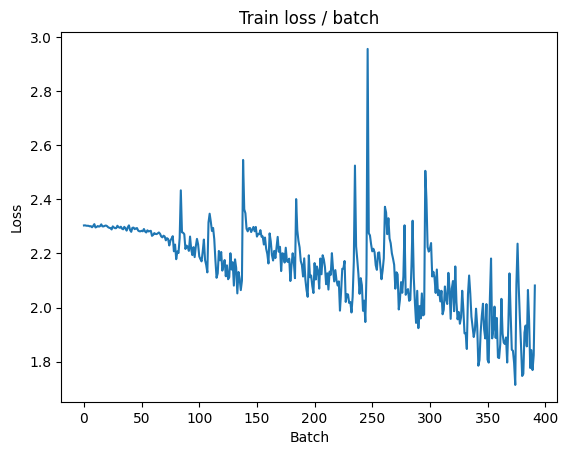

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 1.6517 (1.7801)	Prec@1  35.9 ( 35.4)	Prec@5  85.9 ( 85.8)


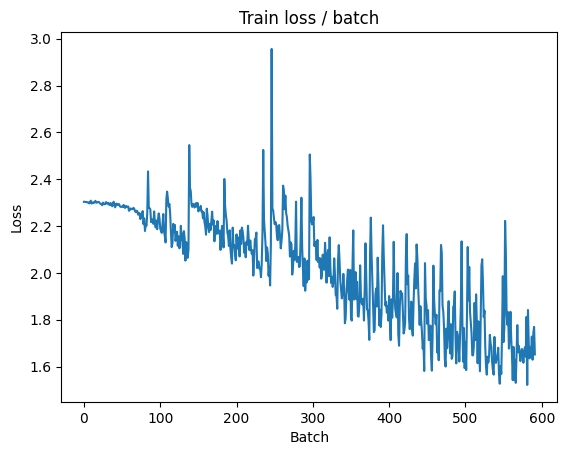


===============> Total time 24s	Avg loss 1.6885	Avg Prec@1 38.79 %	Avg Prec@5 87.74 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 1.4833 (1.4833)	Prec@1  45.3 ( 45.3)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.6071	Avg Prec@1 41.11 %	Avg Prec@5 89.54 %



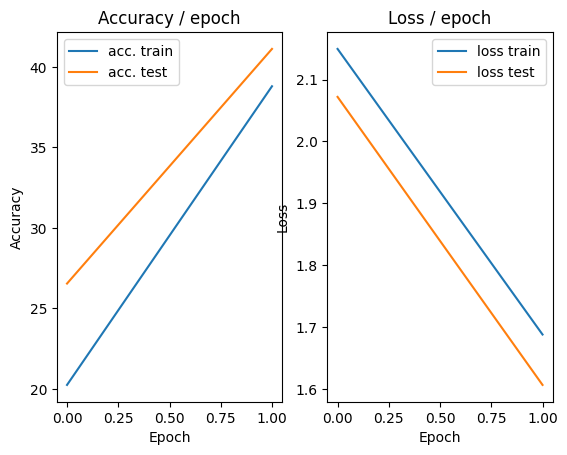

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 1.6095 (1.6095)	Prec@1  40.6 ( 40.6)	Prec@5  93.8 ( 93.8)


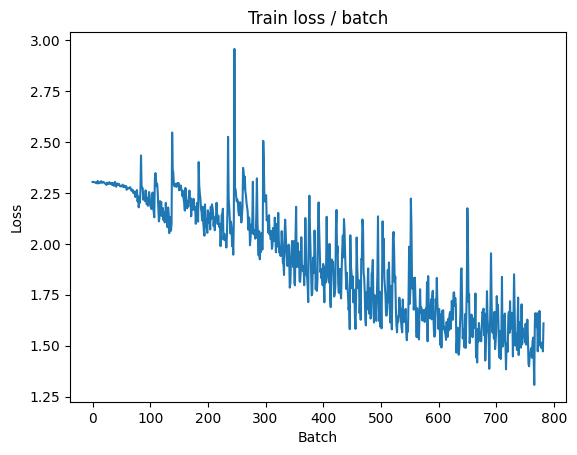

[TRAIN Batch 200/391]	Time 0.060s (0.063s)	Loss 1.3465 (1.4825)	Prec@1  50.0 ( 46.4)	Prec@5  94.5 ( 91.5)


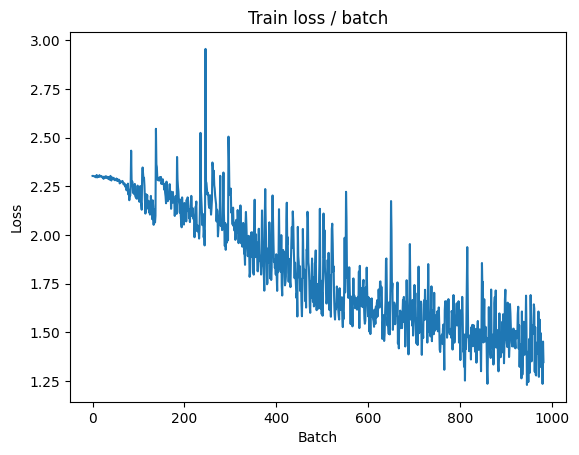


===============> Total time 24s	Avg loss 1.4303	Avg Prec@1 48.65 %	Avg Prec@5 92.32 %

[EVAL Batch 000/079]	Time 0.091s (0.091s)	Loss 1.2046 (1.2046)	Prec@1  61.7 ( 61.7)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.3195	Avg Prec@1 52.32 %	Avg Prec@5 94.04 %



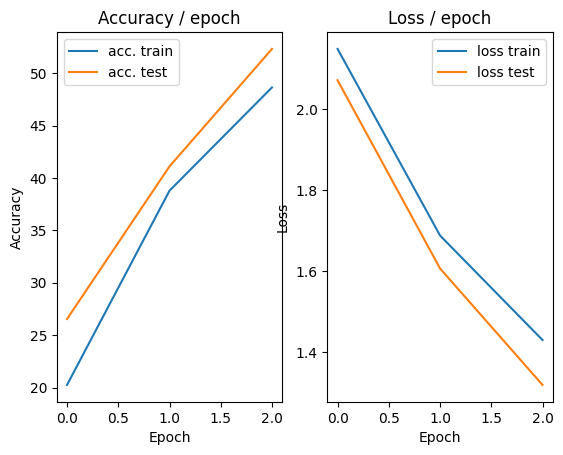

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.102s (0.102s)	Loss 1.2240 (1.2240)	Prec@1  53.9 ( 53.9)	Prec@5  97.7 ( 97.7)


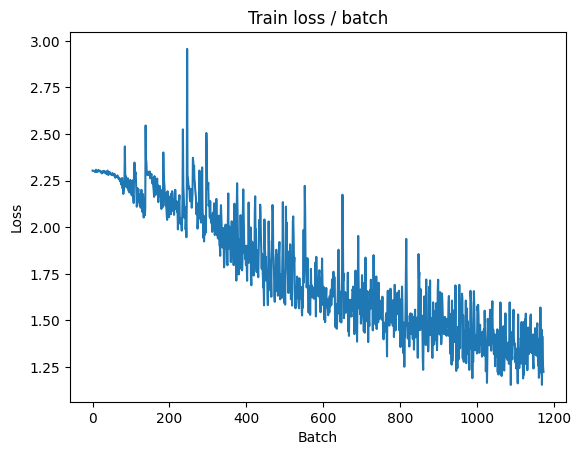

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 1.1468 (1.2936)	Prec@1  60.2 ( 53.8)	Prec@5  96.1 ( 94.1)


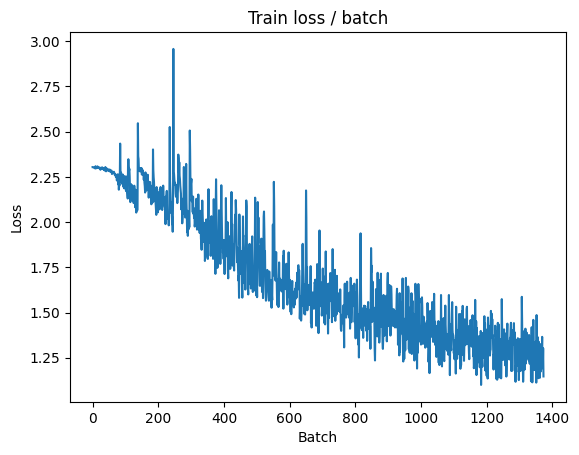


===============> Total time 24s	Avg loss 1.2677	Avg Prec@1 54.75 %	Avg Prec@5 94.45 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 1.0220 (1.0220)	Prec@1  64.8 ( 64.8)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.1860	Avg Prec@1 57.95 %	Avg Prec@5 95.16 %



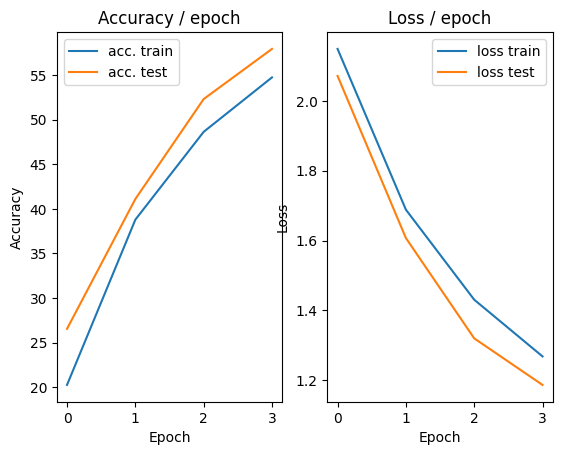

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.108s (0.108s)	Loss 1.1117 (1.1117)	Prec@1  59.4 ( 59.4)	Prec@5  96.9 ( 96.9)


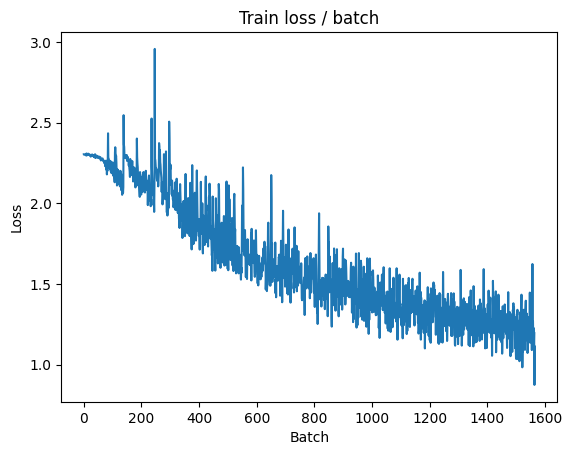

[TRAIN Batch 200/391]	Time 0.060s (0.062s)	Loss 1.1655 (1.1548)	Prec@1  55.5 ( 58.9)	Prec@5  96.9 ( 95.7)


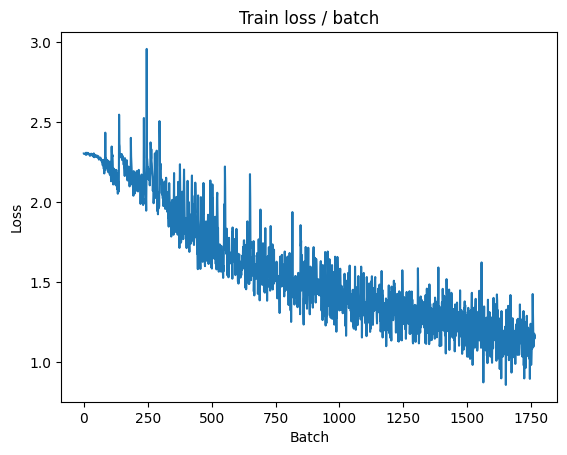


===============> Total time 24s	Avg loss 1.1307	Avg Prec@1 59.79 %	Avg Prec@5 95.86 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 1.2678 (1.2678)	Prec@1  54.7 ( 54.7)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2924	Avg Prec@1 52.96 %	Avg Prec@5 94.57 %



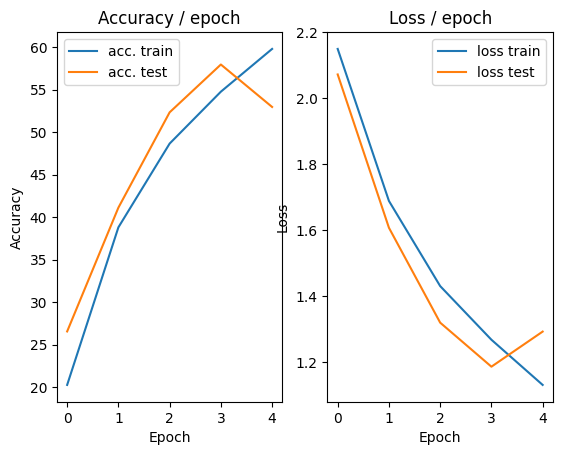

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.105s (0.105s)	Loss 1.1618 (1.1618)	Prec@1  59.4 ( 59.4)	Prec@5  96.1 ( 96.1)


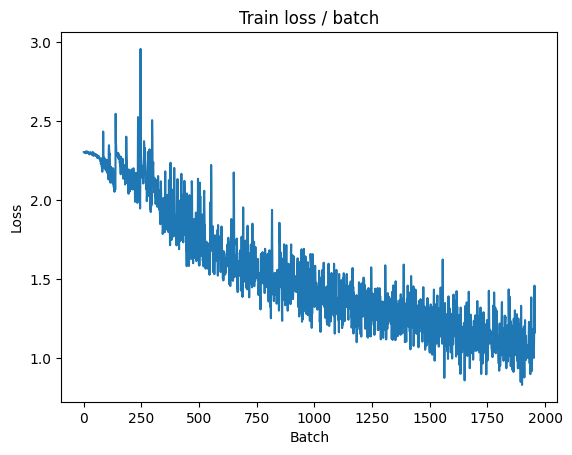

[TRAIN Batch 200/391]	Time 0.056s (0.062s)	Loss 1.0189 (1.0242)	Prec@1  67.2 ( 63.7)	Prec@5  94.5 ( 96.6)


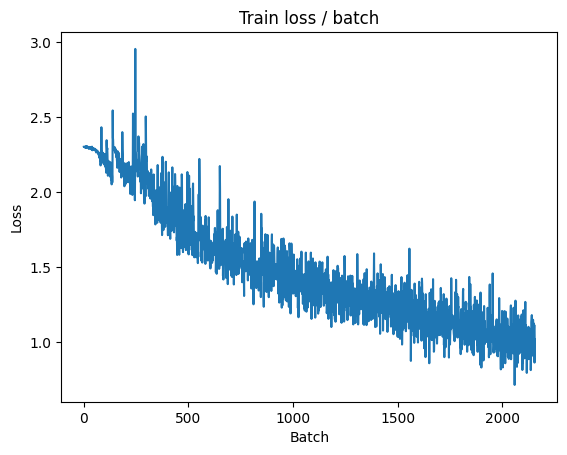


===============> Total time 24s	Avg loss 1.0092	Avg Prec@1 64.36 %	Avg Prec@5 96.75 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.9221 (0.9221)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0580	Avg Prec@1 62.26 %	Avg Prec@5 96.66 %



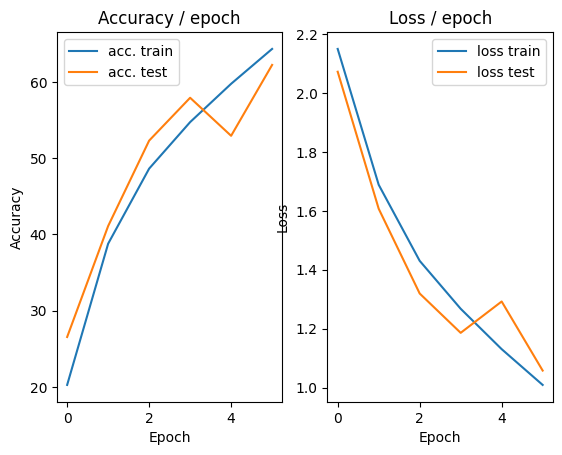

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.8308 (0.8308)	Prec@1  71.9 ( 71.9)	Prec@5  99.2 ( 99.2)


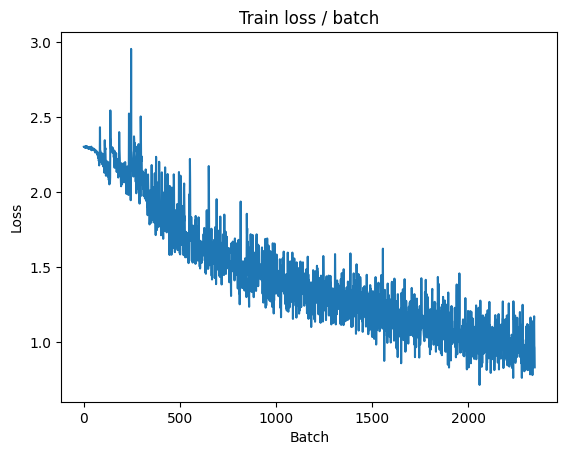

[TRAIN Batch 200/391]	Time 0.064s (0.062s)	Loss 1.0266 (0.9007)	Prec@1  65.6 ( 68.4)	Prec@5  94.5 ( 97.6)


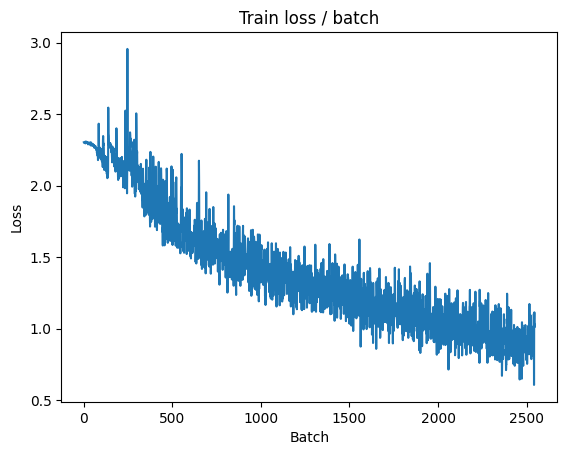


===============> Total time 24s	Avg loss 0.8975	Avg Prec@1 68.57 %	Avg Prec@5 97.49 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.9123 (0.9123)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9496	Avg Prec@1 66.76 %	Avg Prec@5 96.99 %



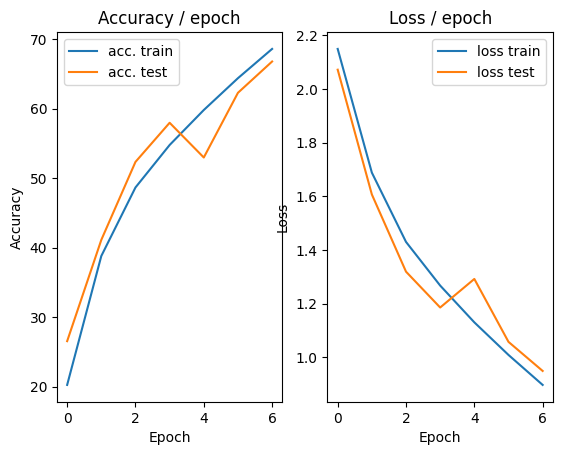

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.089s (0.089s)	Loss 0.6684 (0.6684)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)


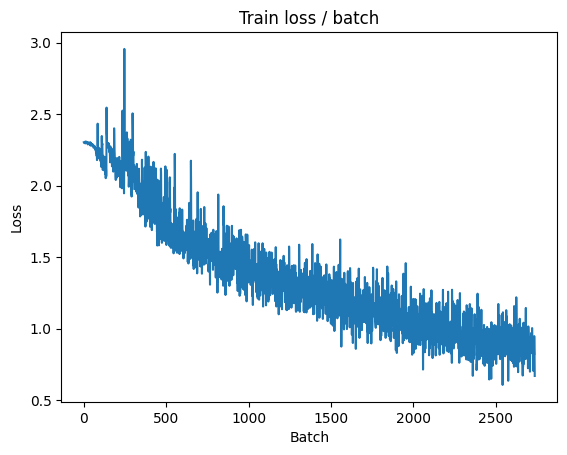

[TRAIN Batch 200/391]	Time 0.063s (0.062s)	Loss 0.9115 (0.7884)	Prec@1  68.8 ( 72.5)	Prec@5  97.7 ( 98.3)


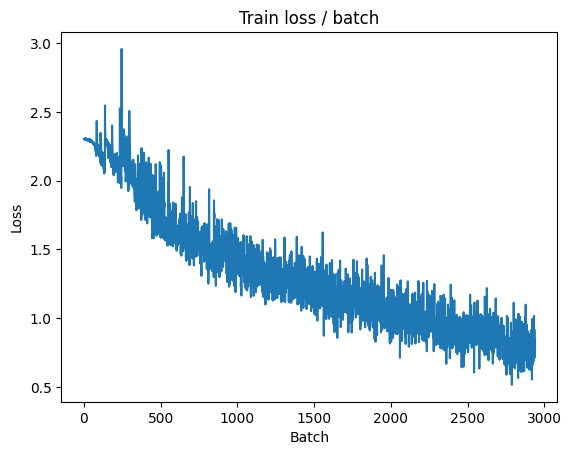


===============> Total time 24s	Avg loss 0.7936	Avg Prec@1 72.33 %	Avg Prec@5 98.22 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 1.0142 (1.0142)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9778	Avg Prec@1 65.64 %	Avg Prec@5 96.92 %



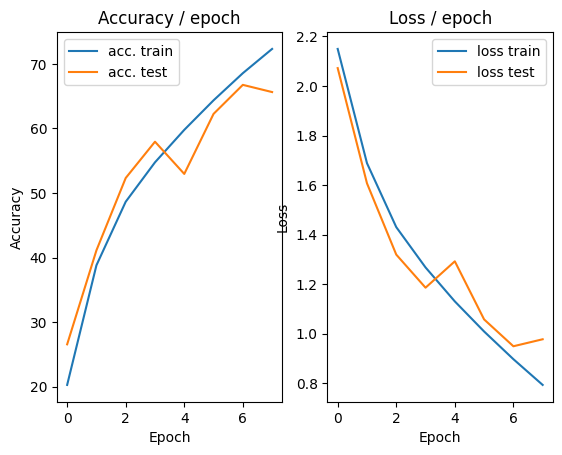

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.091s (0.091s)	Loss 0.8301 (0.8301)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)


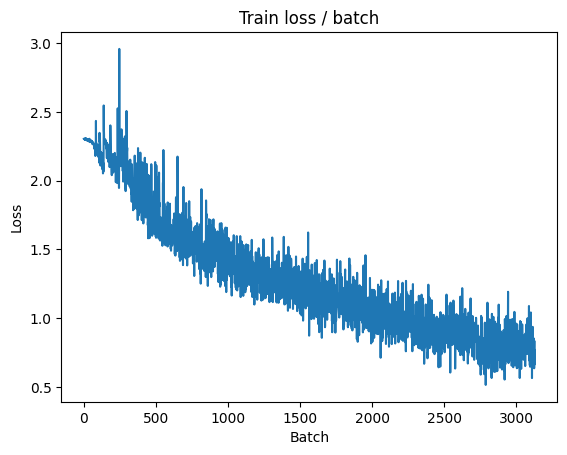

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 0.6738 (0.6999)	Prec@1  75.0 ( 75.5)	Prec@5  99.2 ( 98.6)


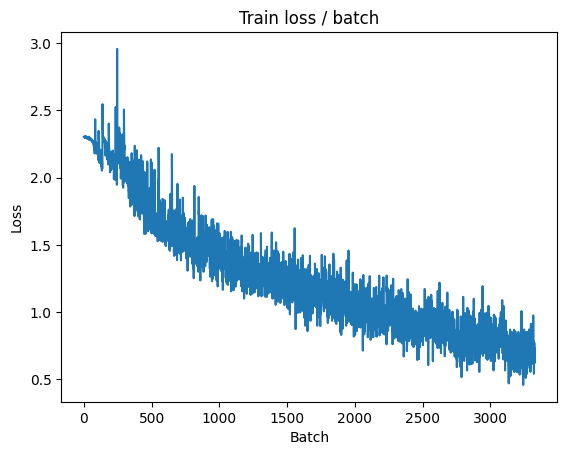


===============> Total time 24s	Avg loss 0.7045	Avg Prec@1 75.31 %	Avg Prec@5 98.60 %

[EVAL Batch 000/079]	Time 0.072s (0.072s)	Loss 0.9856 (0.9856)	Prec@1  71.1 ( 71.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 0.9106	Avg Prec@1 68.30 %	Avg Prec@5 97.46 %



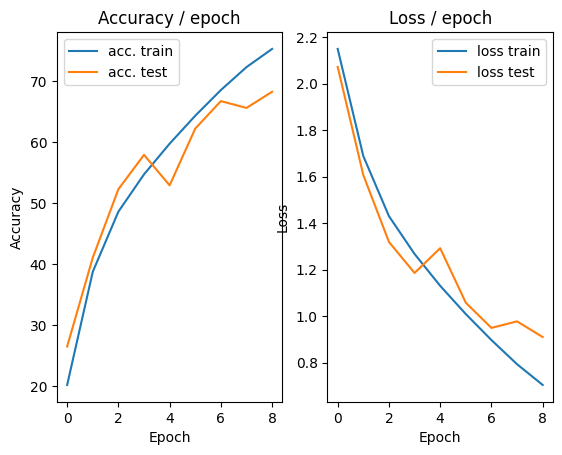

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.111s (0.111s)	Loss 0.5713 (0.5713)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)


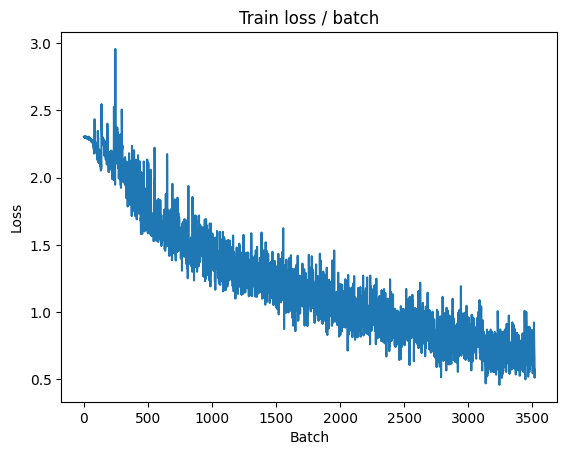

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 0.7442 (0.5959)	Prec@1  75.0 ( 79.0)	Prec@5  97.7 ( 99.1)


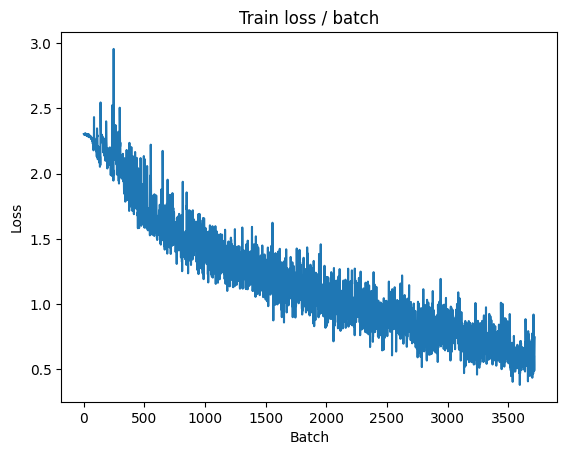


===============> Total time 24s	Avg loss 0.6041	Avg Prec@1 78.84 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.9485 (0.9485)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9835	Avg Prec@1 67.45 %	Avg Prec@5 97.36 %



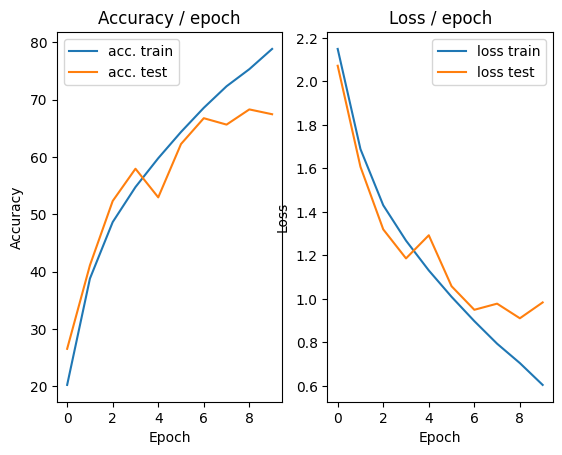

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.5279 (0.5279)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


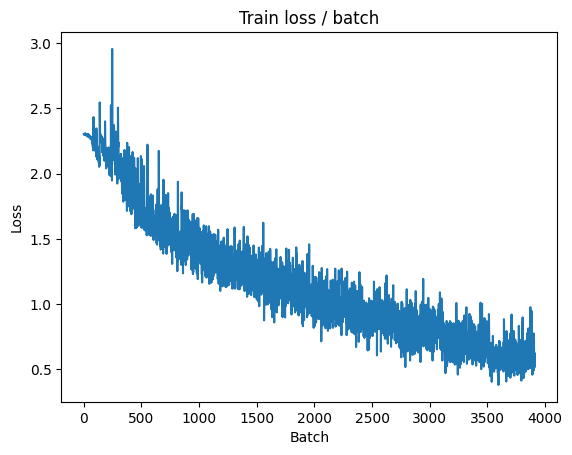

[TRAIN Batch 200/391]	Time 0.062s (0.062s)	Loss 0.6224 (0.5031)	Prec@1  78.1 ( 82.8)	Prec@5  99.2 ( 99.4)


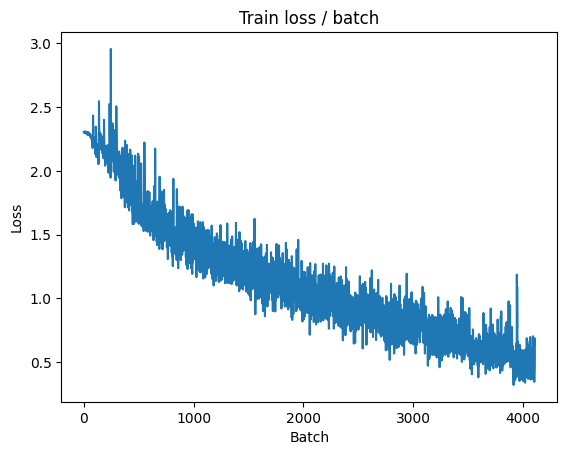


===============> Total time 24s	Avg loss 0.5154	Avg Prec@1 82.07 %	Avg Prec@5 99.36 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 1.2076 (1.2076)	Prec@1  68.0 ( 68.0)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.0004	Avg Prec@1 69.03 %	Avg Prec@5 97.55 %



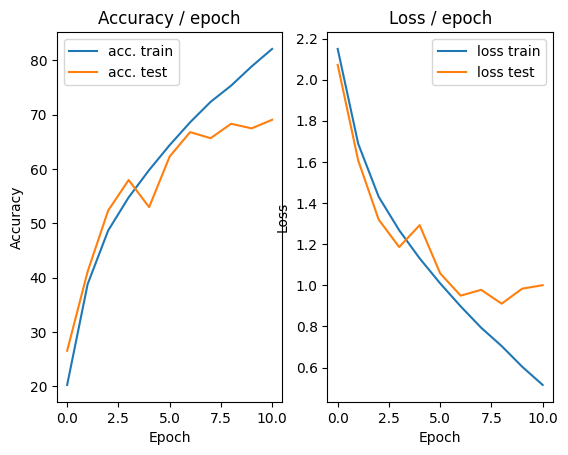

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.3368 (0.3368)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


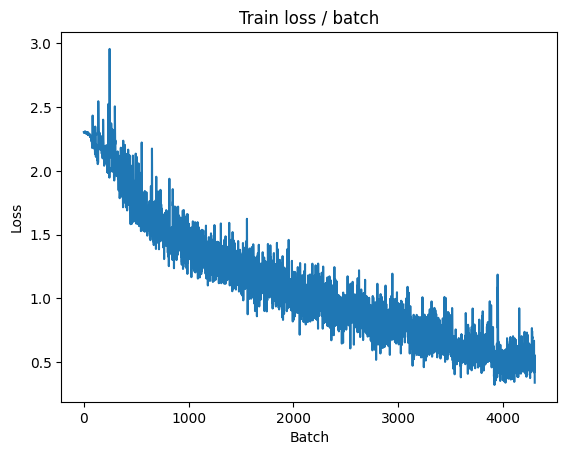

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 0.4645 (0.3941)	Prec@1  85.9 ( 86.4)	Prec@5 100.0 ( 99.7)


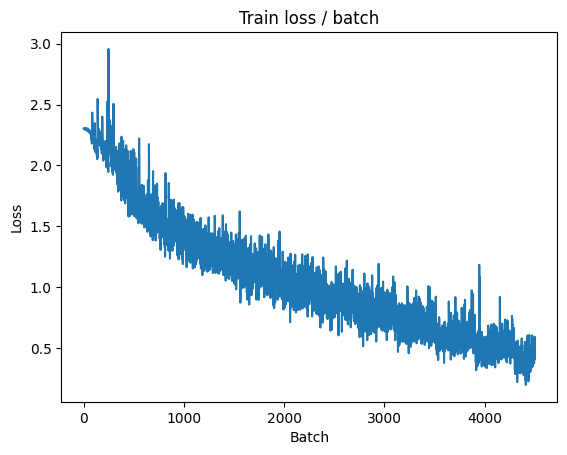


===============> Total time 24s	Avg loss 0.4234	Avg Prec@1 85.26 %	Avg Prec@5 99.60 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 1.0074 (1.0074)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9898	Avg Prec@1 69.20 %	Avg Prec@5 97.33 %



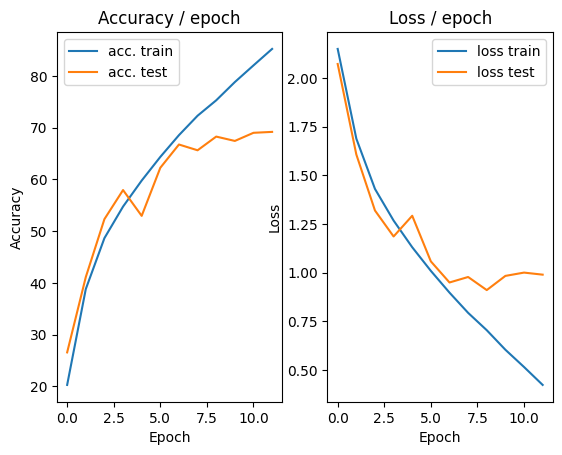

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.3530 (0.3530)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


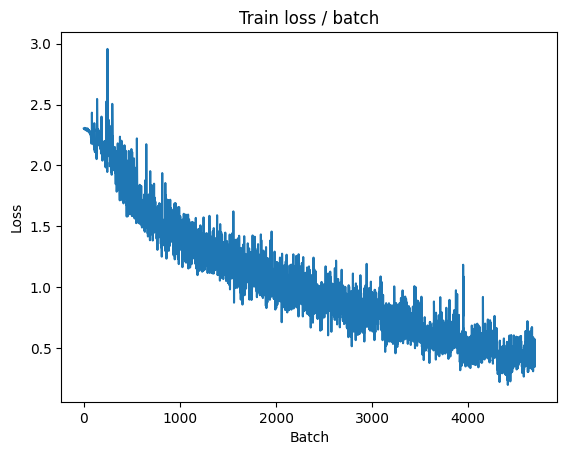

[TRAIN Batch 200/391]	Time 0.062s (0.062s)	Loss 0.3262 (0.3053)	Prec@1  88.3 ( 89.7)	Prec@5 100.0 ( 99.8)


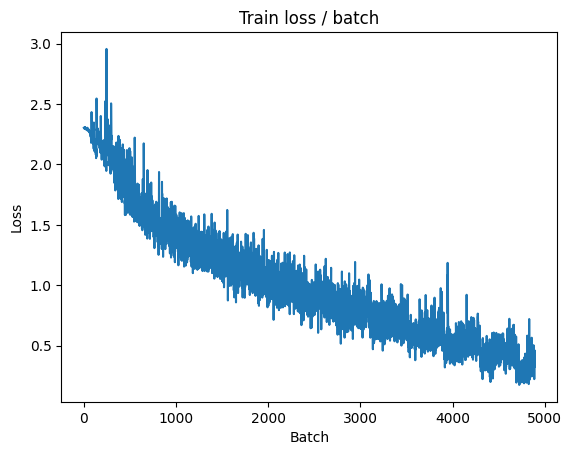


===============> Total time 24s	Avg loss 0.3259	Avg Prec@1 88.76 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 1.0195 (1.0195)	Prec@1  76.6 ( 76.6)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1176	Avg Prec@1 68.46 %	Avg Prec@5 97.05 %



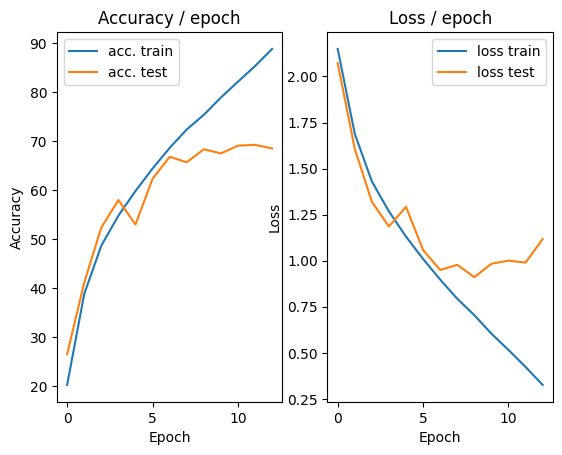

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.3306 (0.3306)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


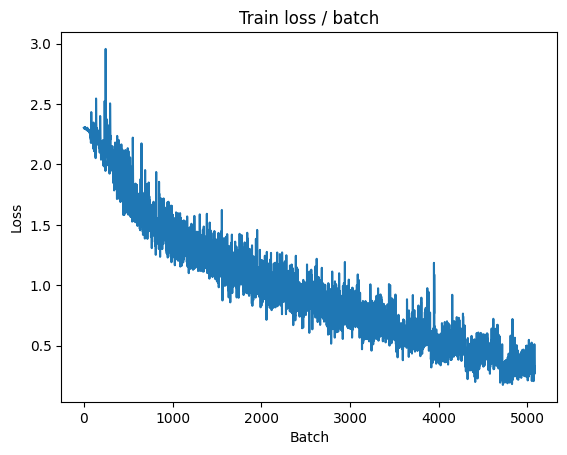

[TRAIN Batch 200/391]	Time 0.063s (0.062s)	Loss 0.4059 (0.2319)	Prec@1  85.2 ( 92.1)	Prec@5 100.0 ( 99.9)


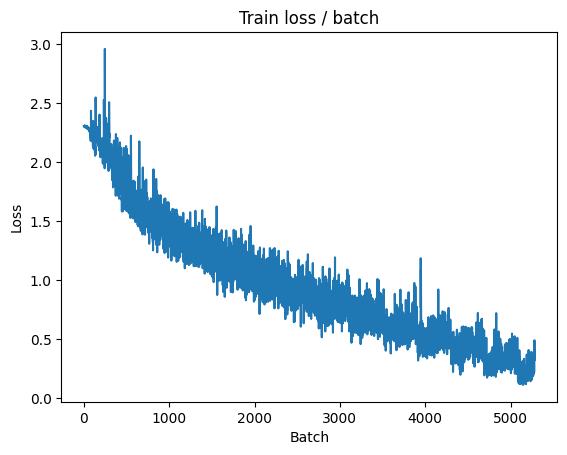


===============> Total time 24s	Avg loss 0.2519	Avg Prec@1 91.29 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 1.1545 (1.1545)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.2011	Avg Prec@1 67.50 %	Avg Prec@5 96.88 %



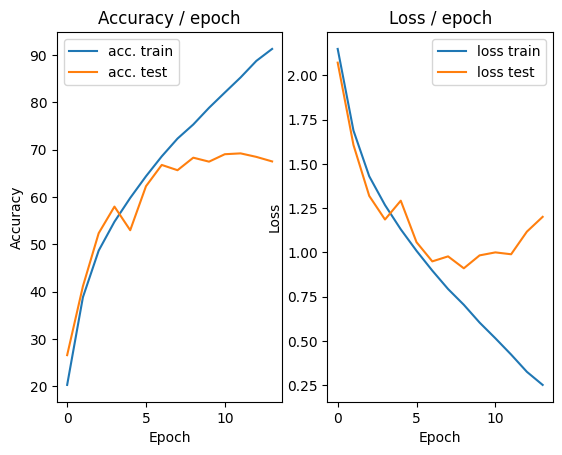

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.2257 (0.2257)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


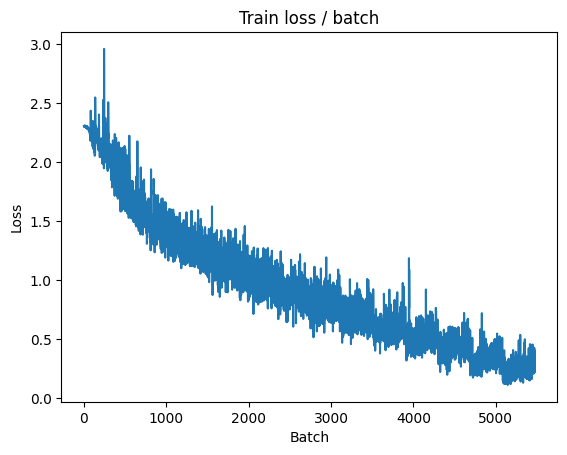

[TRAIN Batch 200/391]	Time 0.061s (0.063s)	Loss 0.2161 (0.1534)	Prec@1  89.8 ( 95.0)	Prec@5 100.0 (100.0)


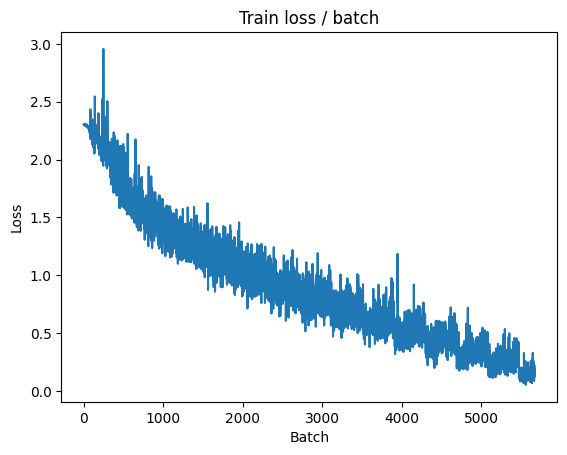


===============> Total time 24s	Avg loss 0.1822	Avg Prec@1 93.79 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 1.3486 (1.3486)	Prec@1  75.0 ( 75.0)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.3007	Avg Prec@1 69.02 %	Avg Prec@5 97.32 %



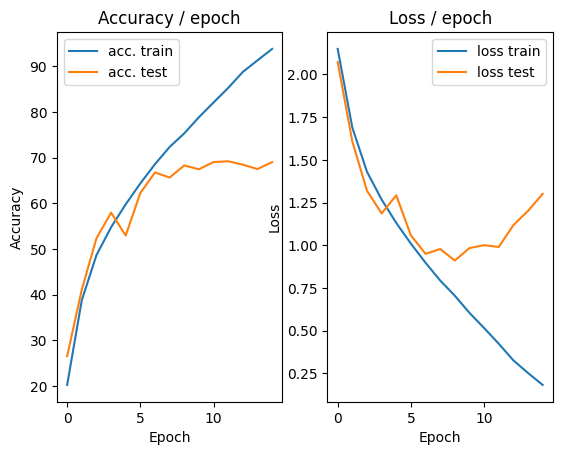

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.2045 (0.2045)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


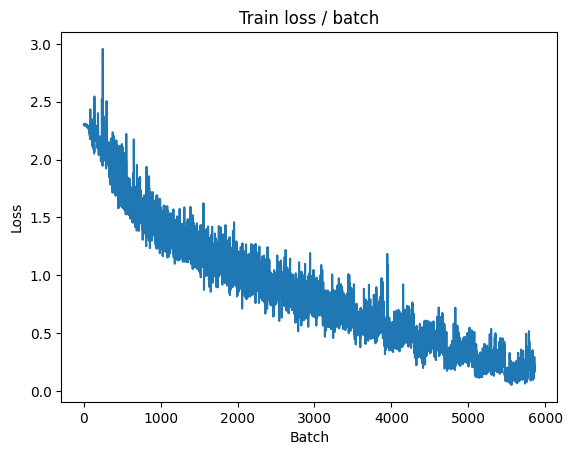

[TRAIN Batch 200/391]	Time 0.061s (0.063s)	Loss 0.1616 (0.1192)	Prec@1  94.5 ( 96.0)	Prec@5 100.0 (100.0)


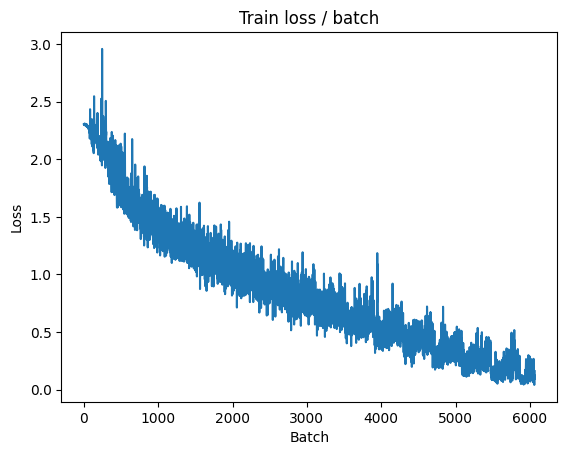


===============> Total time 24s	Avg loss 0.1463	Avg Prec@1 95.07 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 1.7030 (1.7030)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.4769	Avg Prec@1 67.03 %	Avg Prec@5 97.06 %



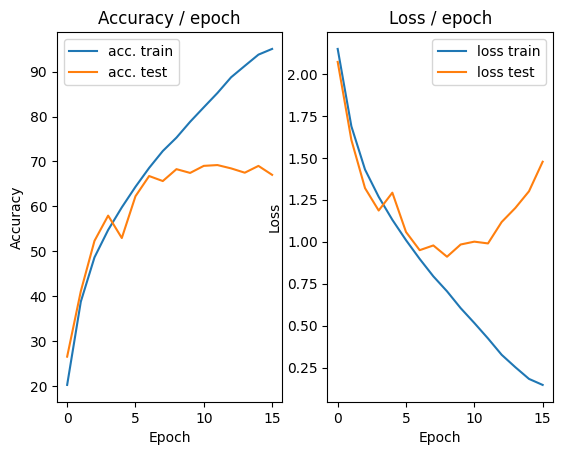

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.106s (0.106s)	Loss 0.1685 (0.1685)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


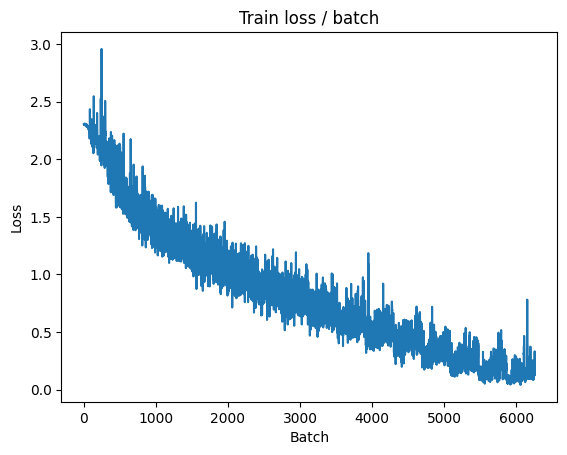

[TRAIN Batch 200/391]	Time 0.063s (0.062s)	Loss 0.1166 (0.0703)	Prec@1  96.1 ( 98.0)	Prec@5 100.0 (100.0)


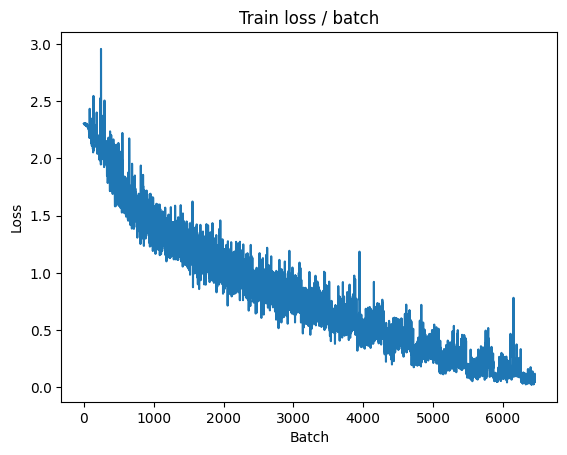


===============> Total time 24s	Avg loss 0.0898	Avg Prec@1 97.11 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 1.7344 (1.7344)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.4312	Avg Prec@1 69.29 %	Avg Prec@5 97.14 %



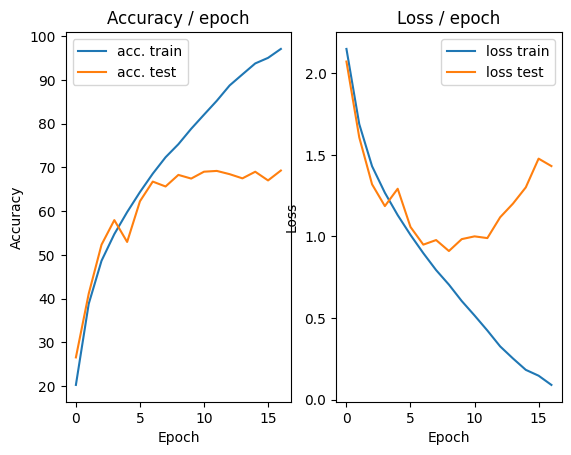

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.1445 (0.1445)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


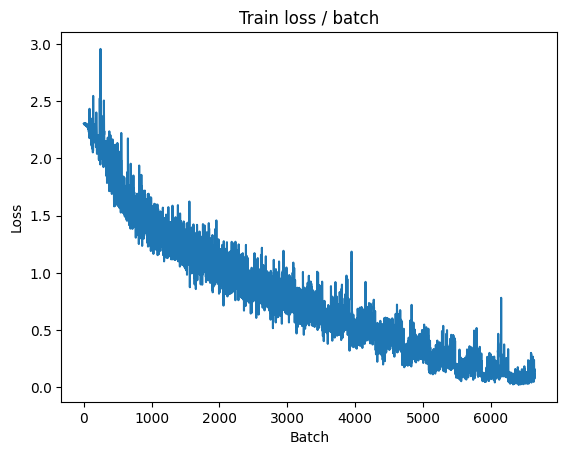

[TRAIN Batch 200/391]	Time 0.060s (0.063s)	Loss 0.0794 (0.0471)	Prec@1  96.9 ( 98.7)	Prec@5 100.0 (100.0)


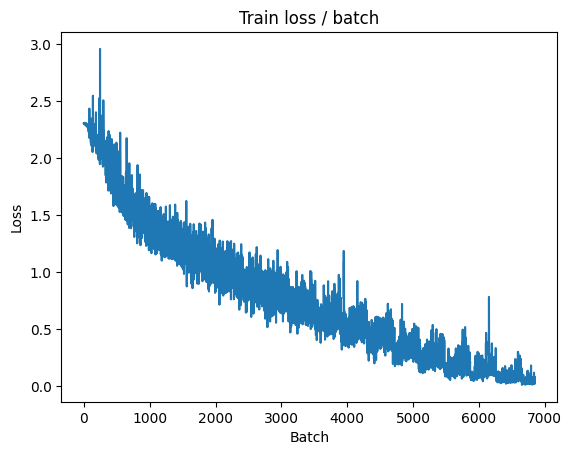


===============> Total time 24s	Avg loss 0.0823	Avg Prec@1 97.48 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 1.5888 (1.5888)	Prec@1  68.8 ( 68.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.5986	Avg Prec@1 68.34 %	Avg Prec@5 96.95 %



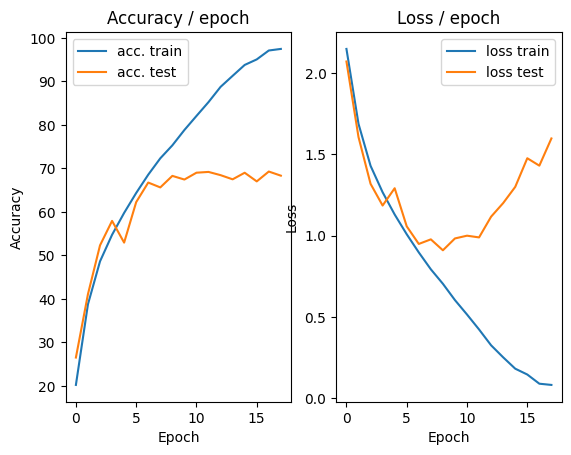

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.2321 (0.2321)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


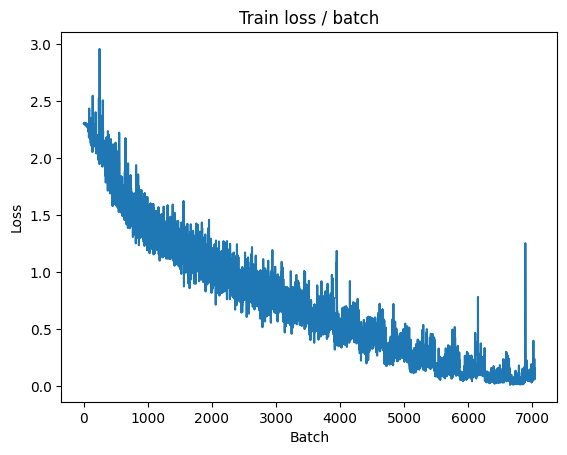

[TRAIN Batch 200/391]	Time 0.063s (0.063s)	Loss 0.0369 (0.0433)	Prec@1  98.4 ( 98.8)	Prec@5 100.0 (100.0)


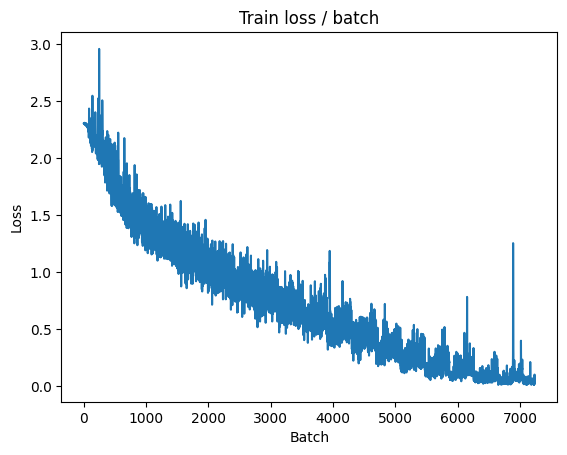


===============> Total time 24s	Avg loss 0.0564	Avg Prec@1 98.38 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 1.7318 (1.7318)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.6178	Avg Prec@1 68.60 %	Avg Prec@5 97.37 %



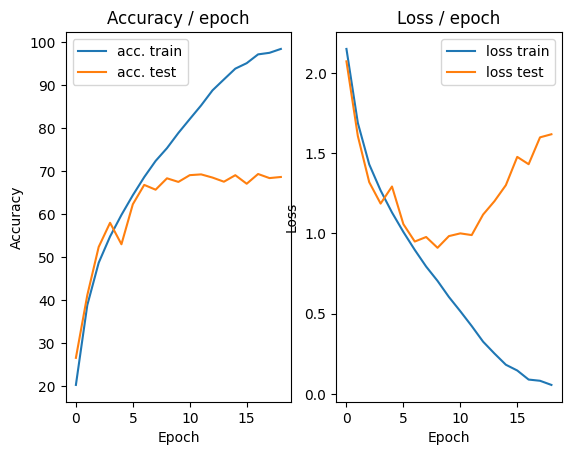

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.098s (0.098s)	Loss 0.0773 (0.0773)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


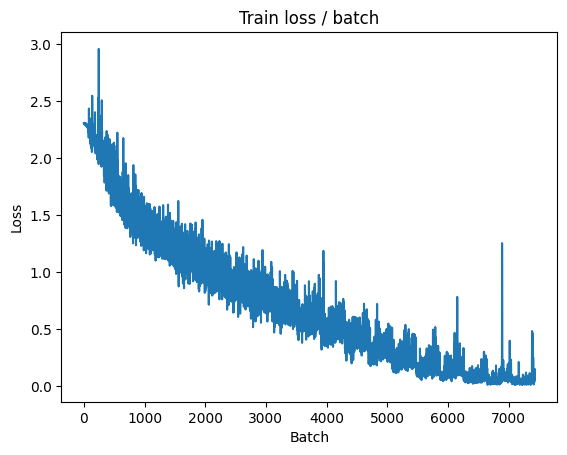

[TRAIN Batch 200/391]	Time 0.062s (0.062s)	Loss 0.0280 (0.0235)	Prec@1  98.4 ( 99.5)	Prec@5 100.0 (100.0)


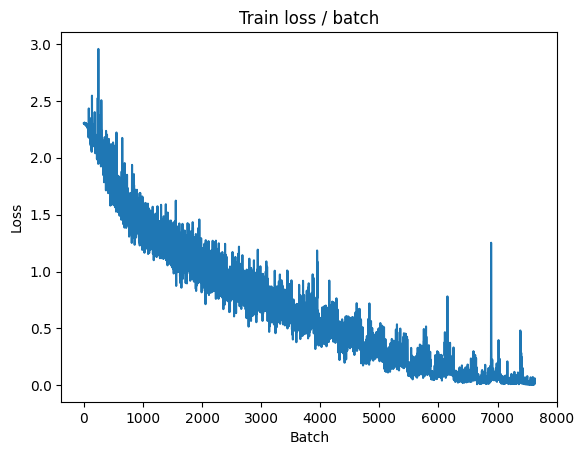


===============> Total time 24s	Avg loss 0.0362	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 1.8003 (1.8003)	Prec@1  74.2 ( 74.2)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.6930	Avg Prec@1 69.76 %	Avg Prec@5 96.79 %



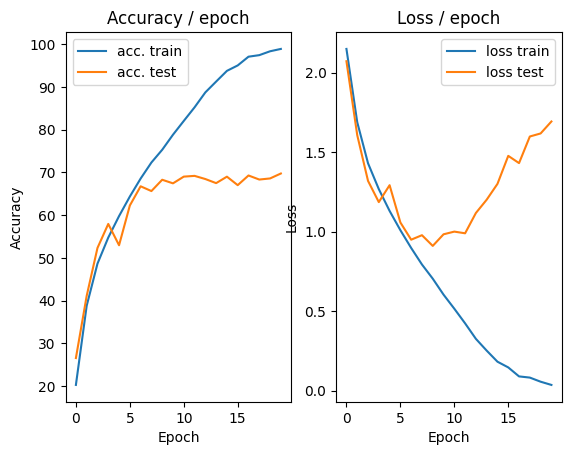

In [12]:
epochs = 20
main(batch_size, lr, epochs, cuda=True, download=True)

## Part 3 Result improvement
### 3.1 Standardization of examples
**Implémentation**:  Add normalization in the data pre-processing. This should be done when calling `datasets.CIFAR10` :


In [13]:
def get_dataset(batch_size, cuda=False, download=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=False,
        transform=transforms.Compose([
            transforms.ToTensor(), 
            # Normalization: 
            transforms.Normalize(mean=[0.491, 0.482, 0.447],  std=[0.202, 0.199, 0.201])   
    ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=False,
        transform=transforms.Compose([
            transforms.ToTensor(), 
            # Normalization: 
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std=[0.202, 0.199, 0.201])  
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 2.3049 (2.3049)	Prec@1   8.6 (  8.6)	Prec@5  47.7 ( 47.7)


<Figure size 640x480 with 0 Axes>

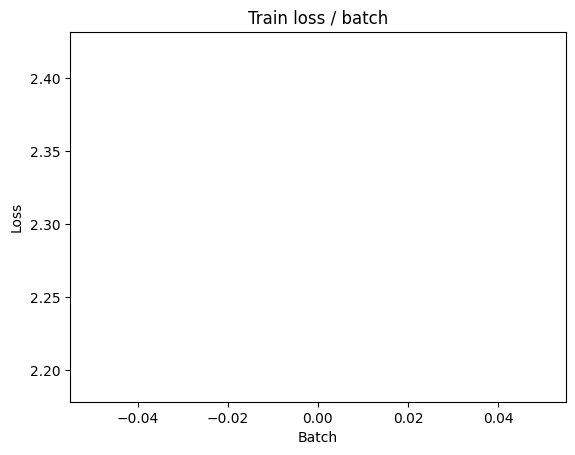

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 1.7506 (1.9152)	Prec@1  33.6 ( 30.1)	Prec@5  85.2 ( 80.6)


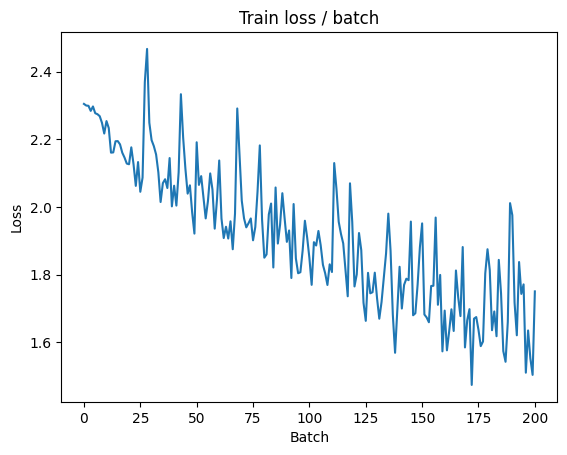


===============> Total time 24s	Avg loss 1.7156	Avg Prec@1 37.86 %	Avg Prec@5 85.88 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 1.3542 (1.3542)	Prec@1  51.6 ( 51.6)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.3737	Avg Prec@1 50.96 %	Avg Prec@5 93.34 %



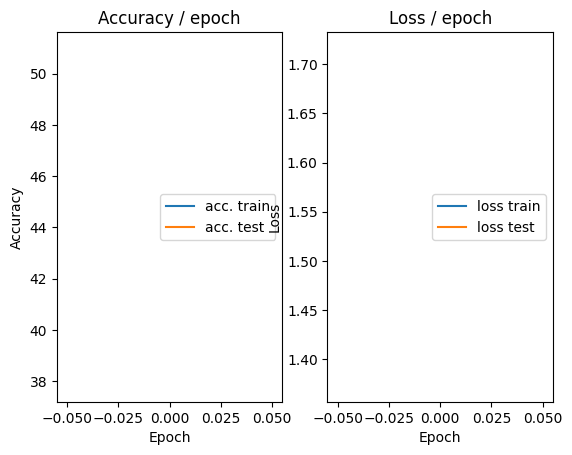

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.116s (0.116s)	Loss 1.2811 (1.2811)	Prec@1  53.1 ( 53.1)	Prec@5  94.5 ( 94.5)


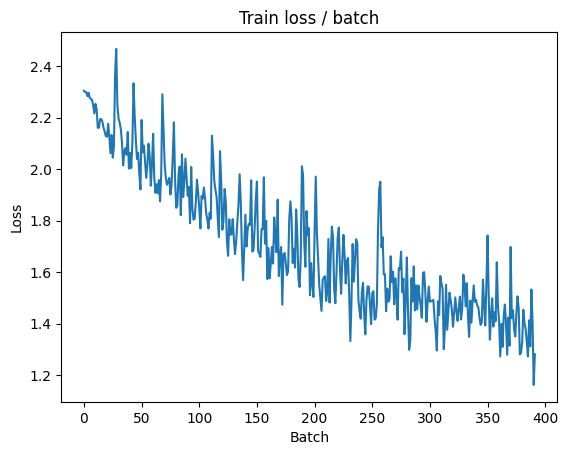

[TRAIN Batch 200/391]	Time 0.062s (0.063s)	Loss 1.3597 (1.3223)	Prec@1  50.8 ( 52.9)	Prec@5  93.0 ( 94.1)


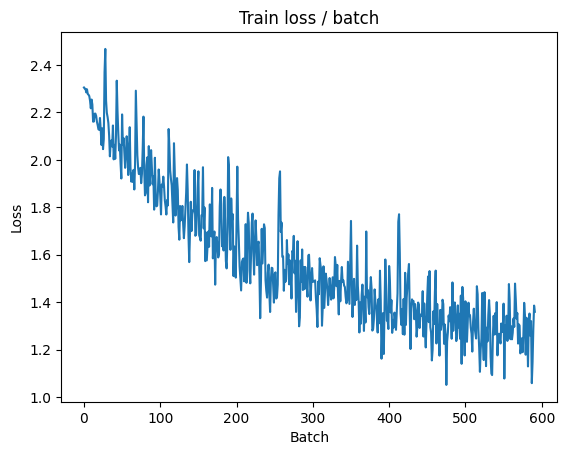


===============> Total time 24s	Avg loss 1.2622	Avg Prec@1 55.23 %	Avg Prec@5 94.74 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 1.0988 (1.0988)	Prec@1  63.3 ( 63.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.1246	Avg Prec@1 59.53 %	Avg Prec@5 96.08 %



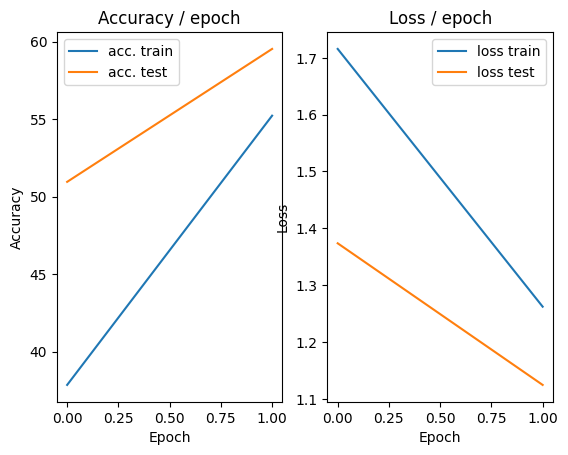

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 1.1807 (1.1807)	Prec@1  55.5 ( 55.5)	Prec@5  97.7 ( 97.7)


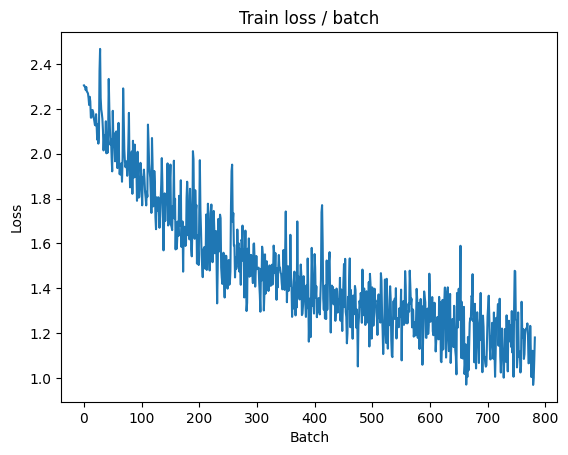

[TRAIN Batch 200/391]	Time 0.061s (0.063s)	Loss 1.0927 (1.0829)	Prec@1  64.8 ( 62.3)	Prec@5  97.7 ( 96.2)


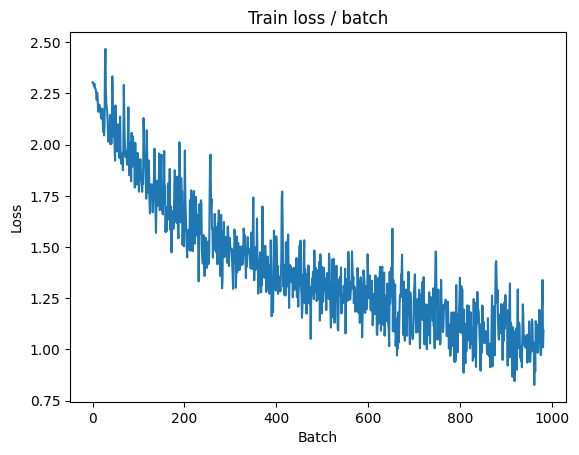


===============> Total time 24s	Avg loss 1.0304	Avg Prec@1 64.12 %	Avg Prec@5 96.62 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.1340 (1.1340)	Prec@1  60.2 ( 60.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1072	Avg Prec@1 60.84 %	Avg Prec@5 95.39 %



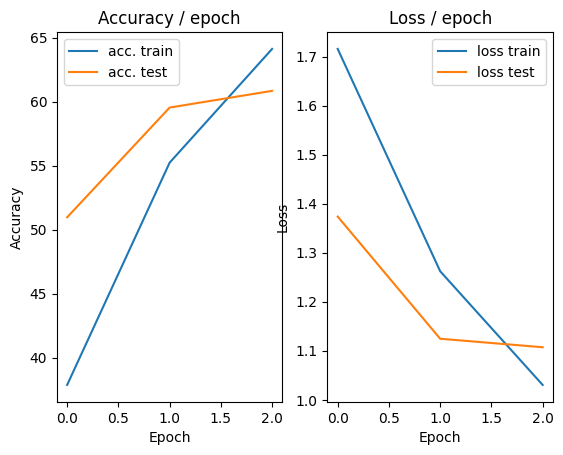

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 1.0661 (1.0661)	Prec@1  59.4 ( 59.4)	Prec@5  96.1 ( 96.1)


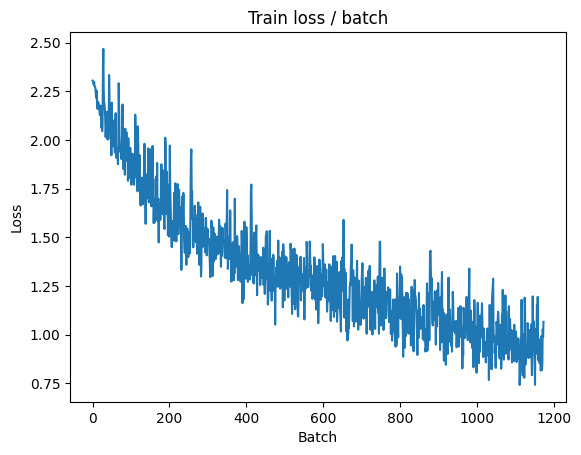

[TRAIN Batch 200/391]	Time 0.064s (0.063s)	Loss 0.8878 (0.8741)	Prec@1  70.3 ( 69.5)	Prec@5  97.7 ( 97.7)


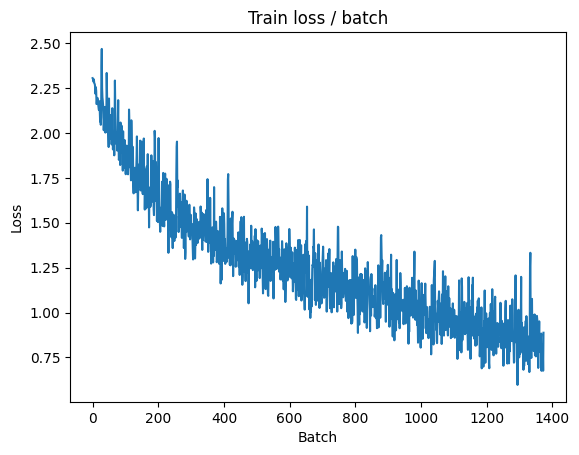


===============> Total time 24s	Avg loss 0.8519	Avg Prec@1 70.31 %	Avg Prec@5 97.77 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 0.8810 (0.8810)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9268	Avg Prec@1 68.11 %	Avg Prec@5 97.13 %



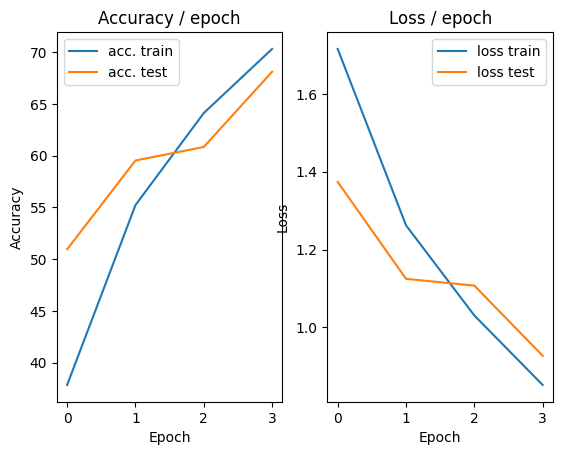

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.9552 (0.9552)	Prec@1  64.8 ( 64.8)	Prec@5 100.0 (100.0)


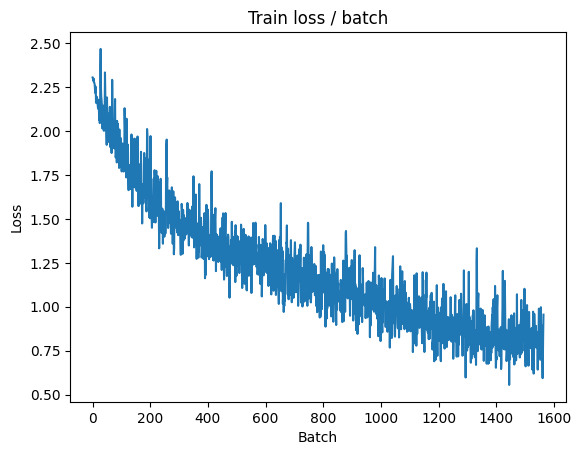

[TRAIN Batch 200/391]	Time 0.060s (0.063s)	Loss 0.8080 (0.7366)	Prec@1  67.2 ( 74.4)	Prec@5 100.0 ( 98.3)


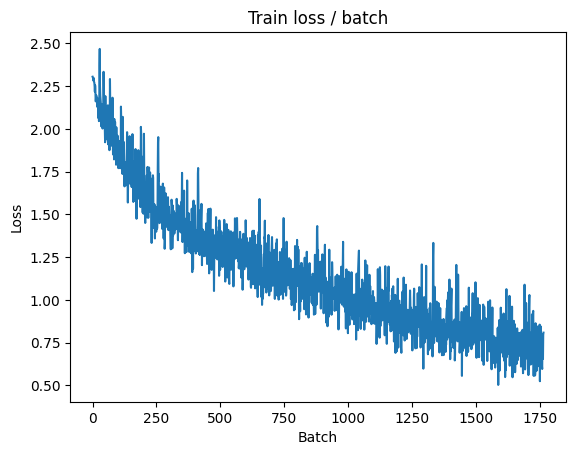


===============> Total time 24s	Avg loss 0.7162	Avg Prec@1 75.20 %	Avg Prec@5 98.47 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.8053 (0.8053)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8927	Avg Prec@1 69.42 %	Avg Prec@5 97.57 %



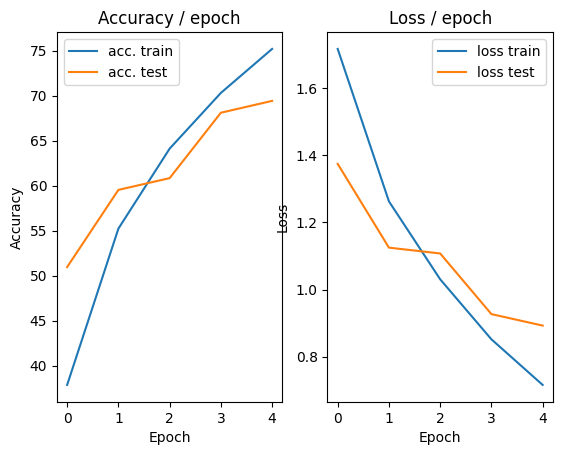

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.6129 (0.6129)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)


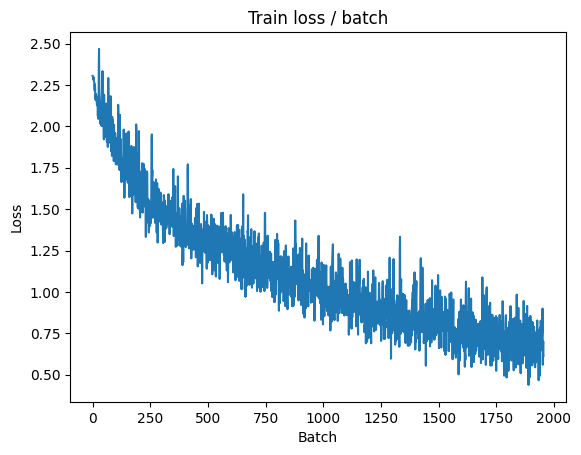

[TRAIN Batch 200/391]	Time 0.060s (0.063s)	Loss 0.7087 (0.5858)	Prec@1  71.1 ( 79.6)	Prec@5  97.7 ( 99.0)


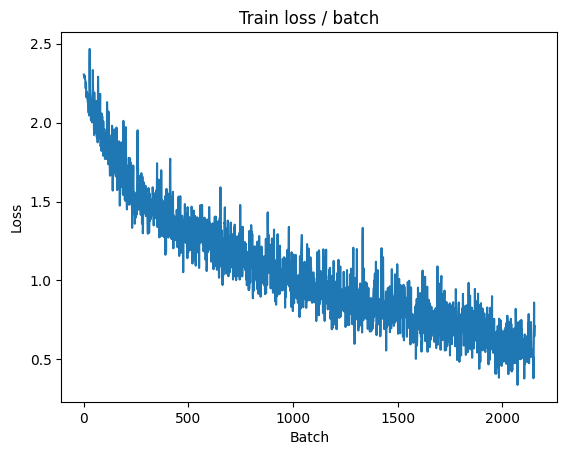


===============> Total time 24s	Avg loss 0.5933	Avg Prec@1 79.43 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.9334 (0.9334)	Prec@1  69.5 ( 69.5)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.9203	Avg Prec@1 69.62 %	Avg Prec@5 97.77 %



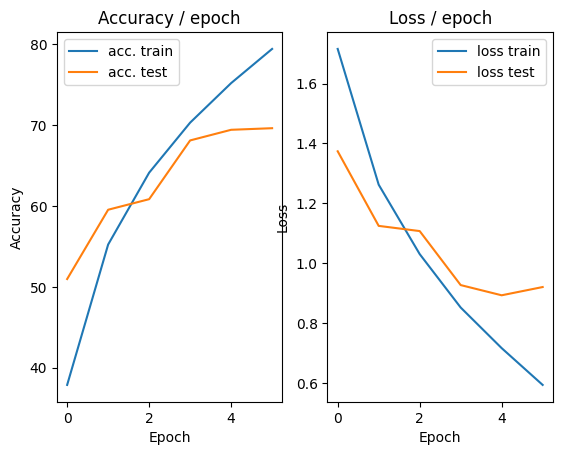

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 0.5957 (0.5957)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


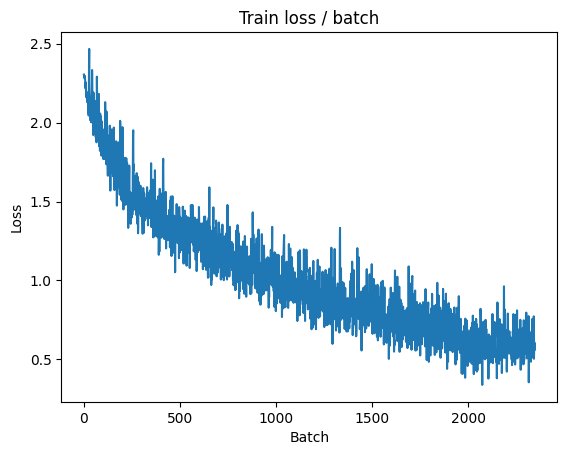

[TRAIN Batch 200/391]	Time 0.064s (0.064s)	Loss 0.5364 (0.4749)	Prec@1  80.5 ( 83.6)	Prec@5 100.0 ( 99.4)


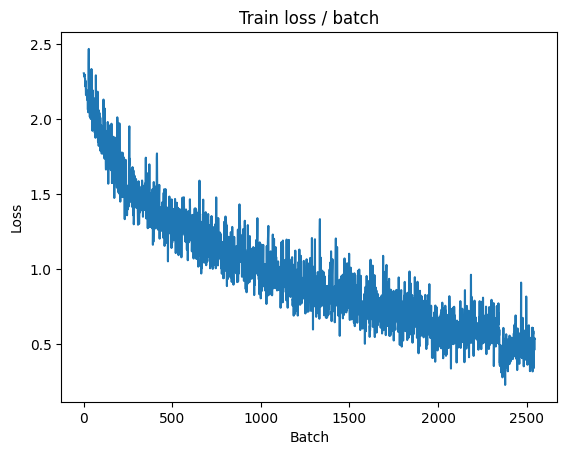


===============> Total time 24s	Avg loss 0.4826	Avg Prec@1 83.24 %	Avg Prec@5 99.41 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.7933 (0.7933)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8564	Avg Prec@1 72.77 %	Avg Prec@5 97.86 %



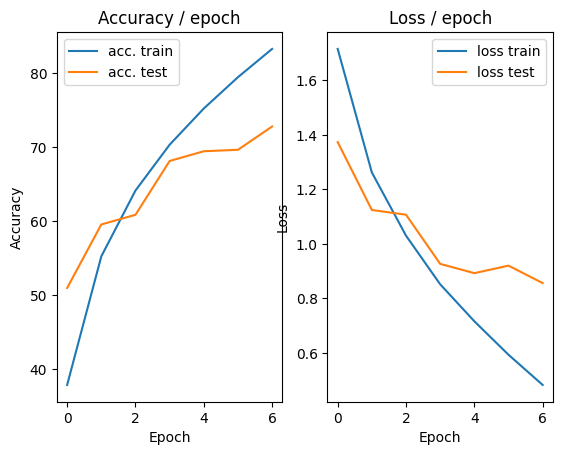

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.2353 (0.2353)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


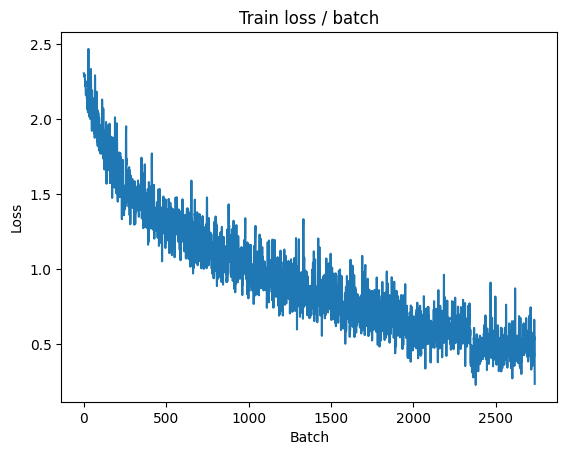

[TRAIN Batch 200/391]	Time 0.063s (0.064s)	Loss 0.3456 (0.3583)	Prec@1  88.3 ( 87.4)	Prec@5  99.2 ( 99.7)


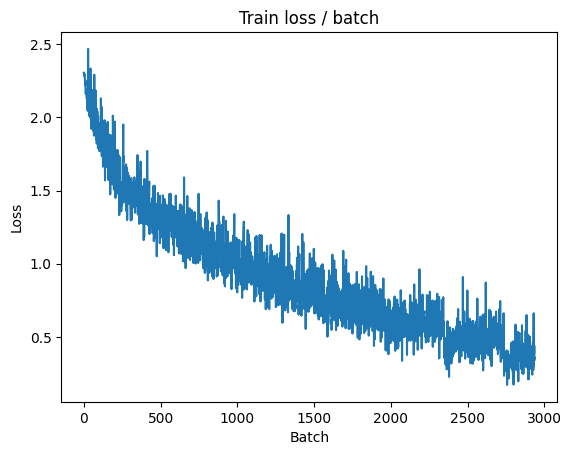


===============> Total time 25s	Avg loss 0.3782	Avg Prec@1 86.79 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.8675 (0.8675)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8866	Avg Prec@1 73.41 %	Avg Prec@5 97.98 %



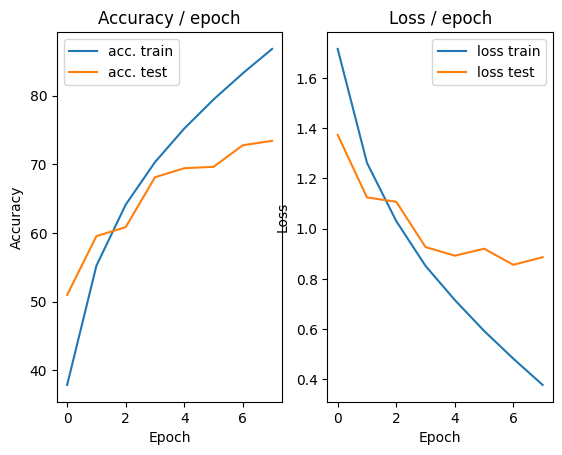

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.1501 (0.1501)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


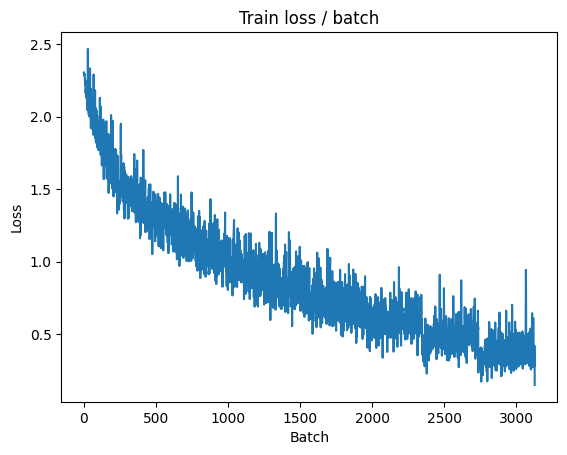

[TRAIN Batch 200/391]	Time 0.061s (0.064s)	Loss 0.2271 (0.2398)	Prec@1  93.8 ( 91.9)	Prec@5 100.0 ( 99.9)


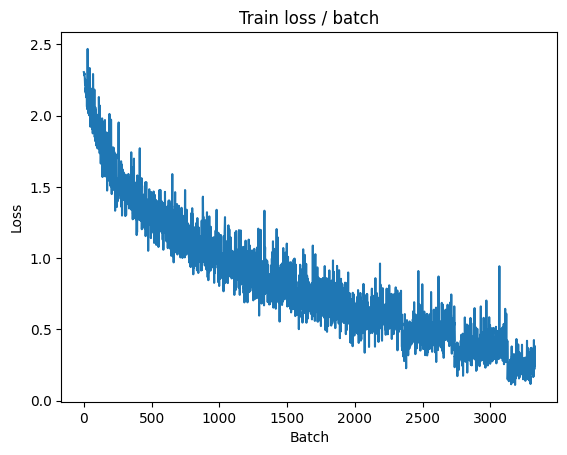


===============> Total time 24s	Avg loss 0.2746	Avg Prec@1 90.50 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.234s (0.234s)	Loss 0.8799 (0.8799)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9330	Avg Prec@1 73.39 %	Avg Prec@5 97.74 %



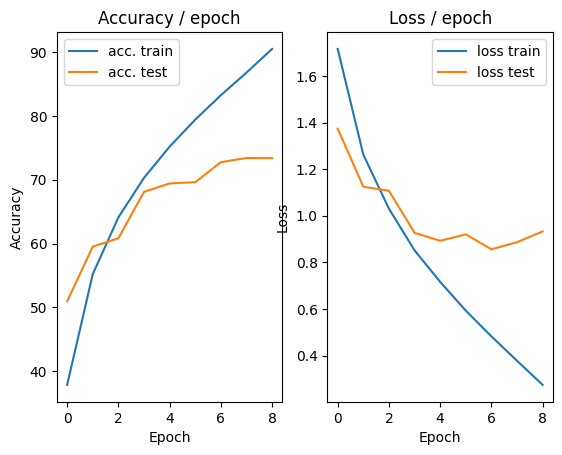

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.1562 (0.1562)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


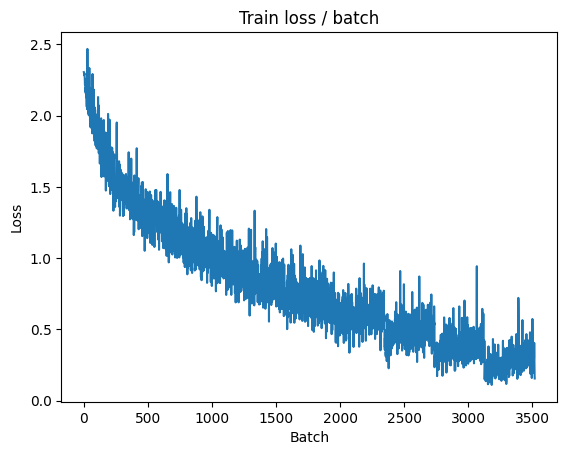

[TRAIN Batch 200/391]	Time 0.059s (0.064s)	Loss 0.0817 (0.1618)	Prec@1  97.7 ( 94.5)	Prec@5 100.0 (100.0)


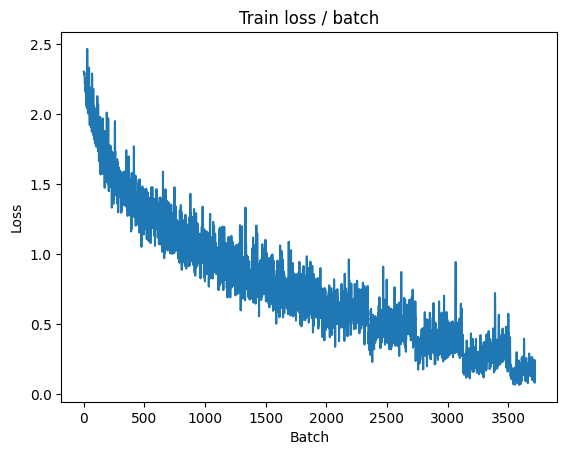


===============> Total time 24s	Avg loss 0.1906	Avg Prec@1 93.38 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.1780 (1.1780)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.1684	Avg Prec@1 71.74 %	Avg Prec@5 97.24 %



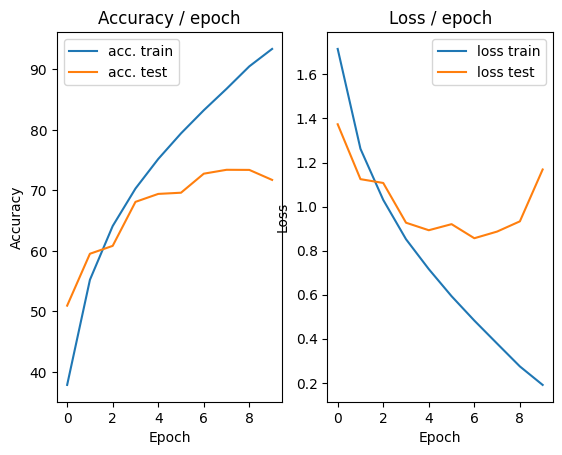

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.1798 (0.1798)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


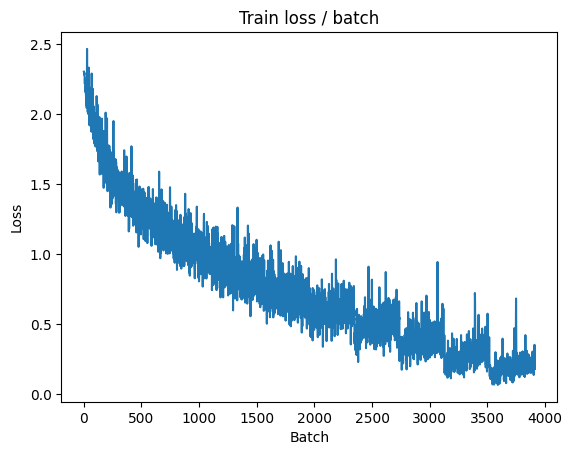

[TRAIN Batch 200/391]	Time 0.060s (0.064s)	Loss 0.1486 (0.1180)	Prec@1  93.0 ( 96.0)	Prec@5 100.0 (100.0)


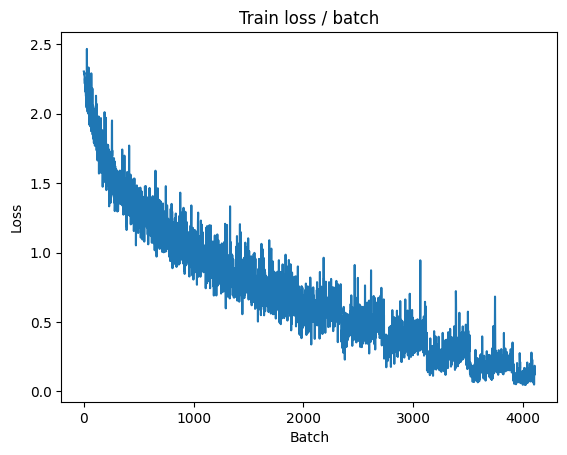


===============> Total time 24s	Avg loss 0.1435	Avg Prec@1 95.11 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 1.0513 (1.0513)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0890	Avg Prec@1 74.18 %	Avg Prec@5 97.91 %



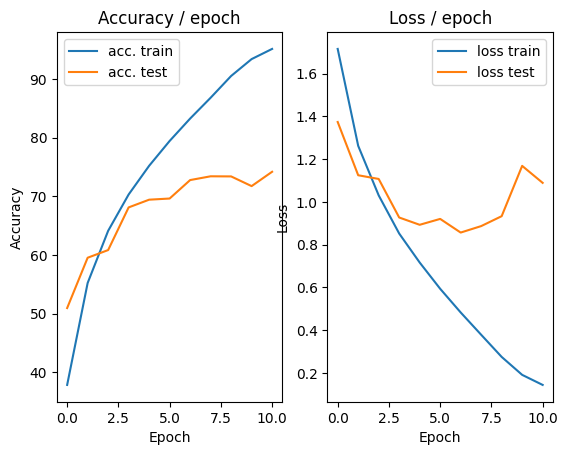

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.1052 (0.1052)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


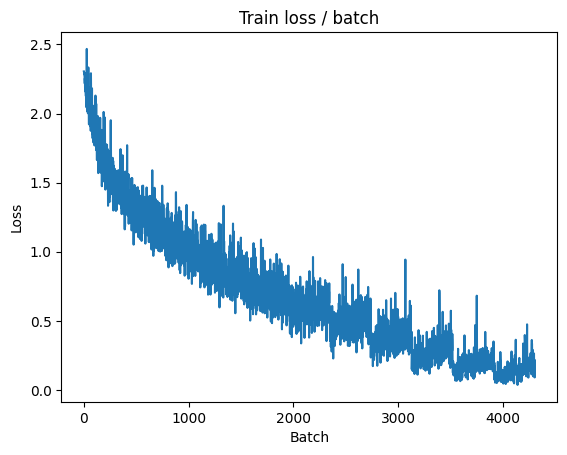

[TRAIN Batch 200/391]	Time 0.059s (0.063s)	Loss 0.0980 (0.0887)	Prec@1  96.9 ( 97.3)	Prec@5 100.0 (100.0)


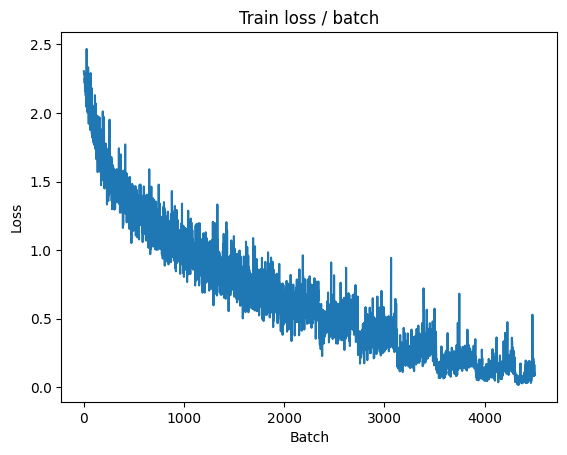


===============> Total time 24s	Avg loss 0.0959	Avg Prec@1 96.97 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 0.9055 (0.9055)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.3245	Avg Prec@1 72.77 %	Avg Prec@5 97.13 %



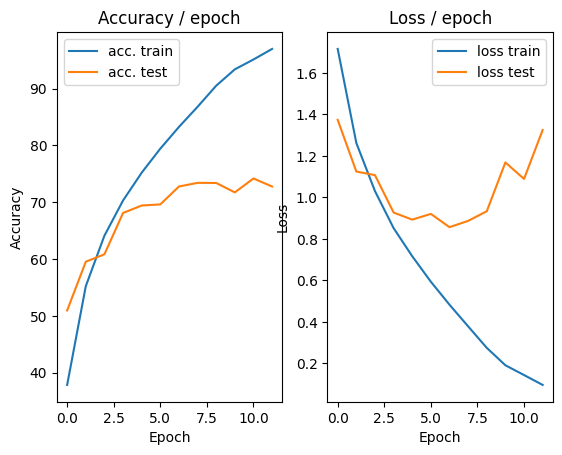

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.1539 (0.1539)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


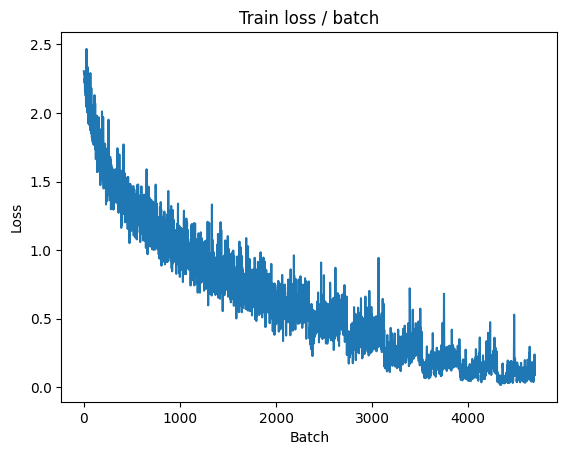

[TRAIN Batch 200/391]	Time 0.064s (0.063s)	Loss 0.0759 (0.0642)	Prec@1  96.9 ( 98.0)	Prec@5 100.0 (100.0)


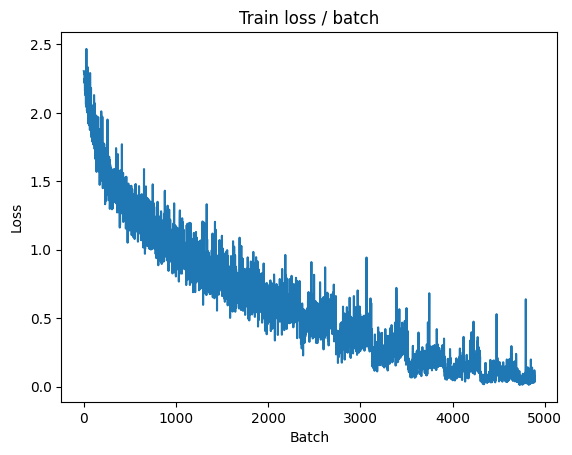


===============> Total time 24s	Avg loss 0.0936	Avg Prec@1 97.12 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 1.2155 (1.2155)	Prec@1  75.8 ( 75.8)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 1.3030	Avg Prec@1 73.17 %	Avg Prec@5 97.48 %



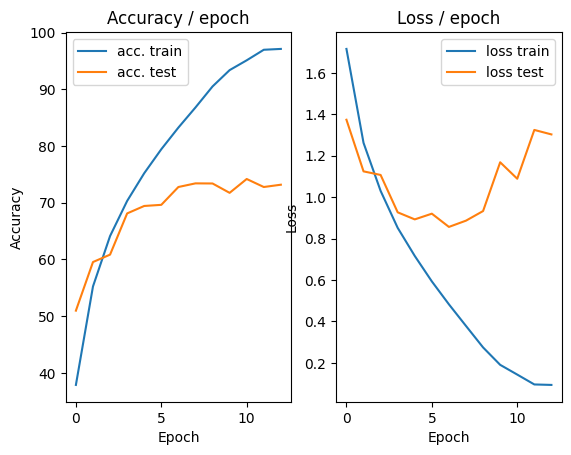

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.0648 (0.0648)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


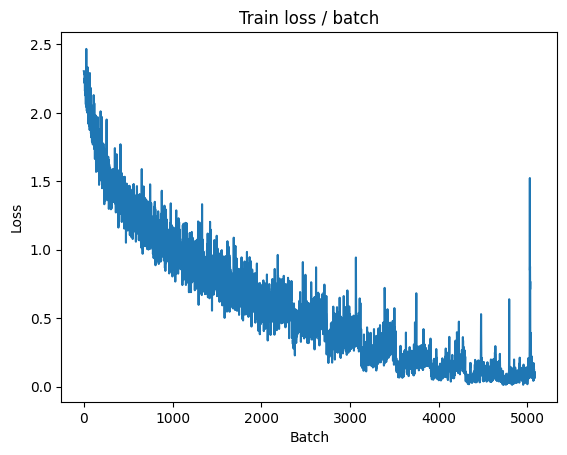

[TRAIN Batch 200/391]	Time 0.059s (0.063s)	Loss 0.0835 (0.0515)	Prec@1  97.7 ( 98.4)	Prec@5 100.0 (100.0)


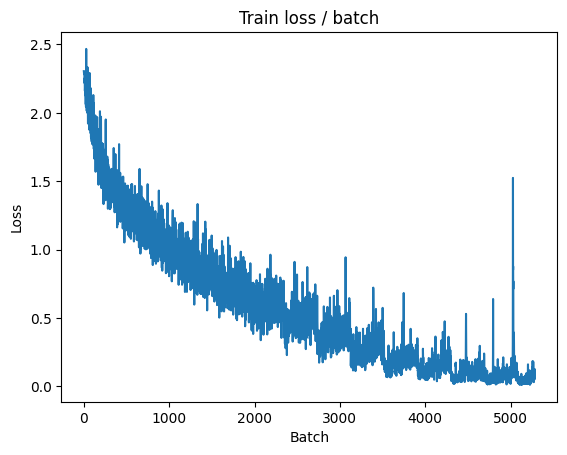


===============> Total time 24s	Avg loss 0.0734	Avg Prec@1 97.65 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.0986 (1.0986)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.3191	Avg Prec@1 74.37 %	Avg Prec@5 97.32 %



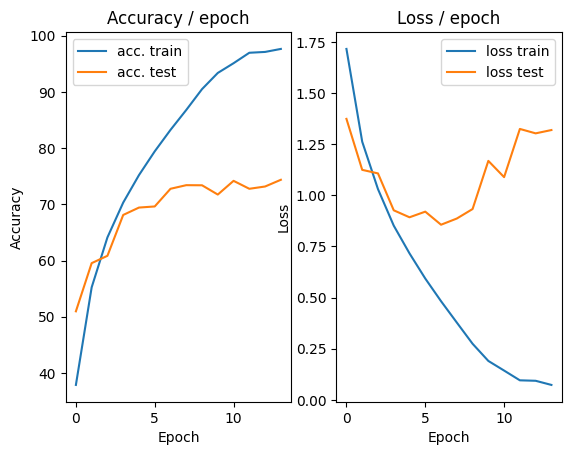

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.0480 (0.0480)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


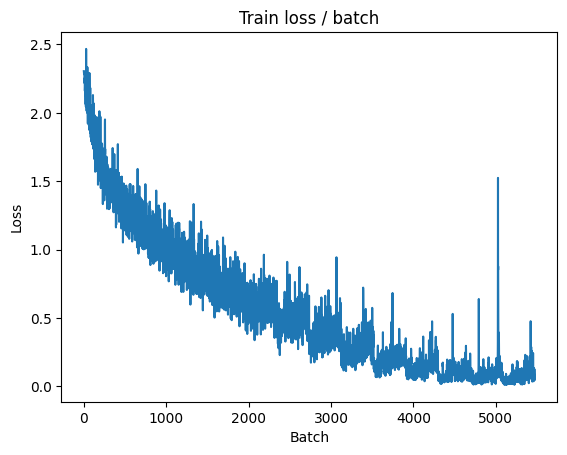

[TRAIN Batch 200/391]	Time 0.064s (0.063s)	Loss 0.0323 (0.0330)	Prec@1  99.2 ( 99.1)	Prec@5 100.0 (100.0)


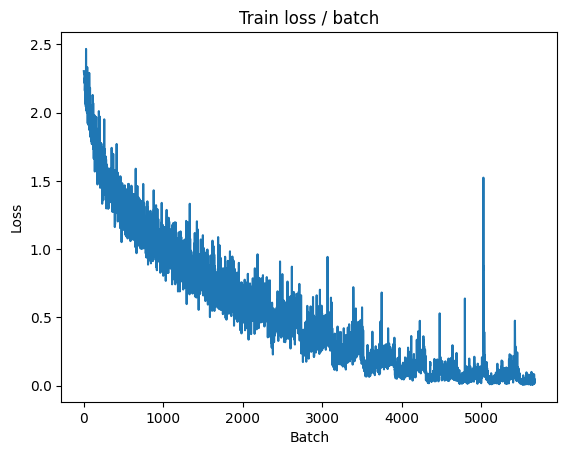


===============> Total time 24s	Avg loss 0.0478	Avg Prec@1 98.50 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 1.1747 (1.1747)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.4615	Avg Prec@1 73.73 %	Avg Prec@5 97.62 %



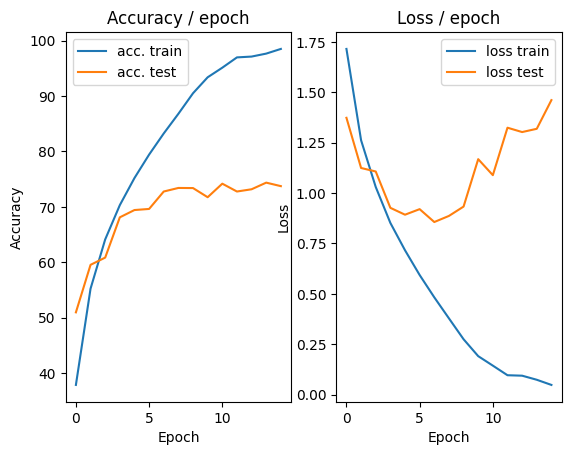

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.0574 (0.0574)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


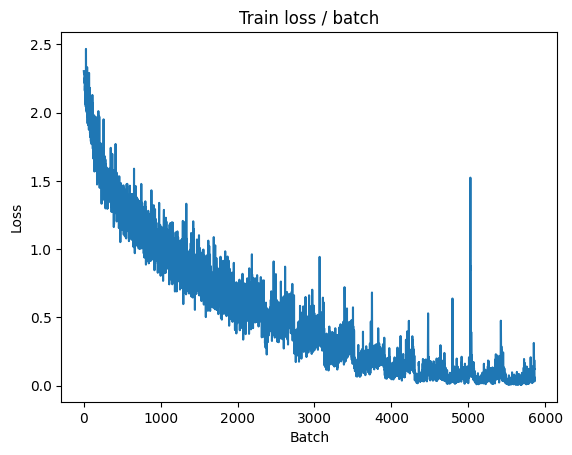

[TRAIN Batch 200/391]	Time 0.062s (0.063s)	Loss 0.1056 (0.0511)	Prec@1  96.1 ( 98.4)	Prec@5 100.0 (100.0)


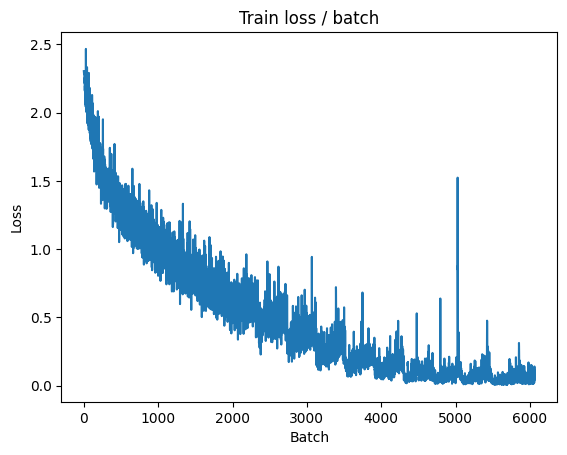


===============> Total time 24s	Avg loss 0.0528	Avg Prec@1 98.30 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.235s (0.235s)	Loss 1.7611 (1.7611)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.5644	Avg Prec@1 74.01 %	Avg Prec@5 97.77 %



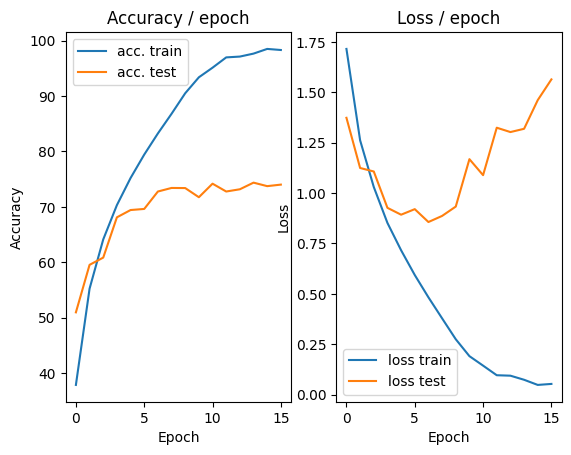

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.0118 (0.0118)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


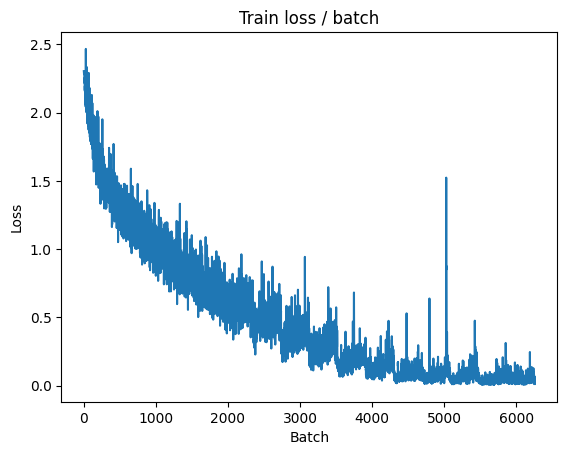

[TRAIN Batch 200/391]	Time 0.060s (0.064s)	Loss 0.0322 (0.0265)	Prec@1  98.4 ( 99.2)	Prec@5 100.0 (100.0)


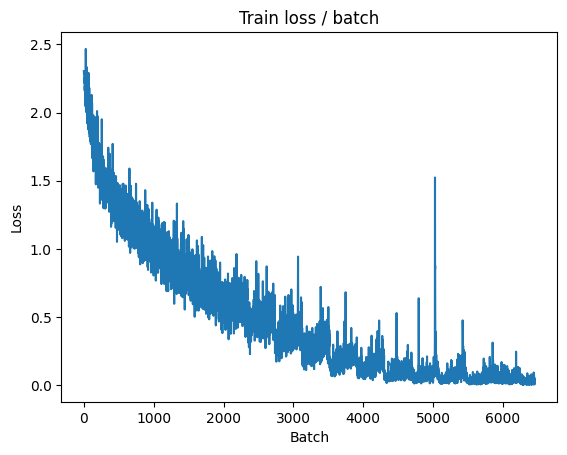


===============> Total time 24s	Avg loss 0.0349	Avg Prec@1 98.89 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 1.4793 (1.4793)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.6798	Avg Prec@1 73.62 %	Avg Prec@5 97.53 %



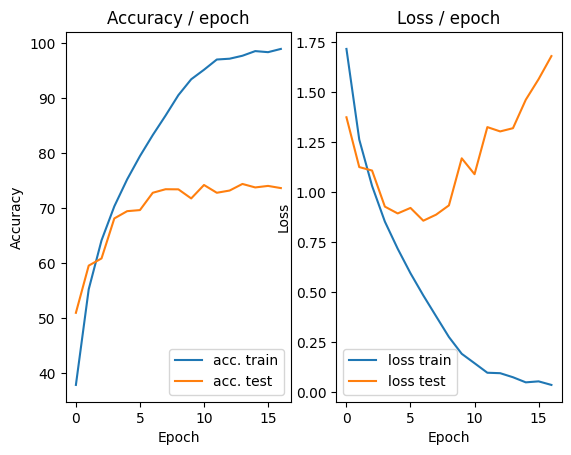

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.0601 (0.0601)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


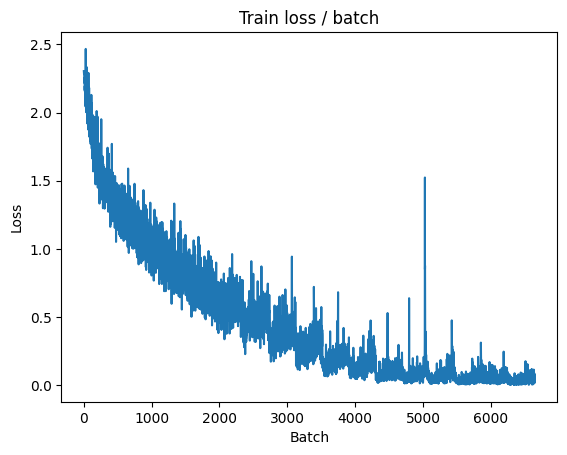

[TRAIN Batch 200/391]	Time 0.061s (0.064s)	Loss 0.0116 (0.0298)	Prec@1  99.2 ( 99.0)	Prec@5 100.0 (100.0)


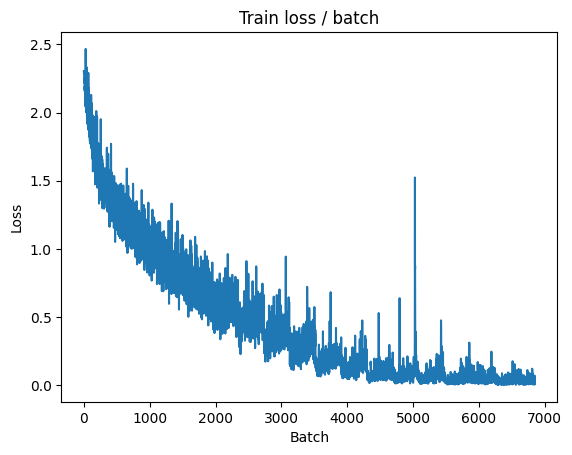


===============> Total time 24s	Avg loss 0.0381	Avg Prec@1 98.79 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 1.3945 (1.3945)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.6255	Avg Prec@1 73.76 %	Avg Prec@5 97.77 %



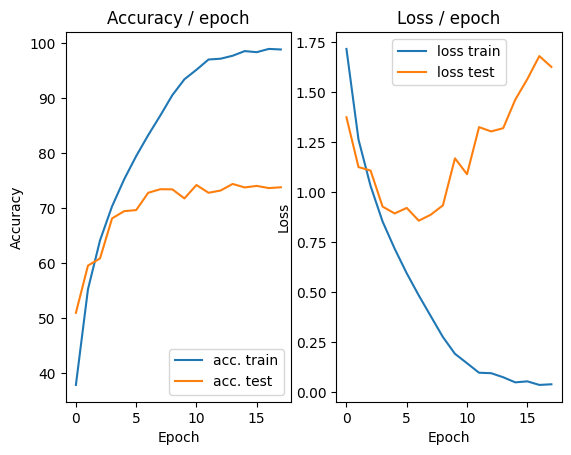

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.0433 (0.0433)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


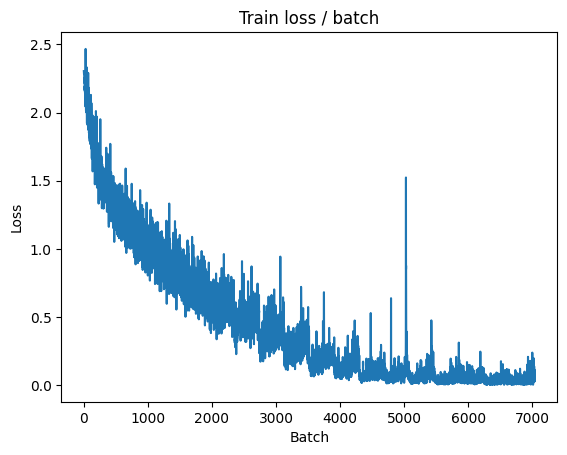

[TRAIN Batch 200/391]	Time 0.065s (0.064s)	Loss 0.2731 (0.0454)	Prec@1  95.3 ( 98.6)	Prec@5 100.0 (100.0)


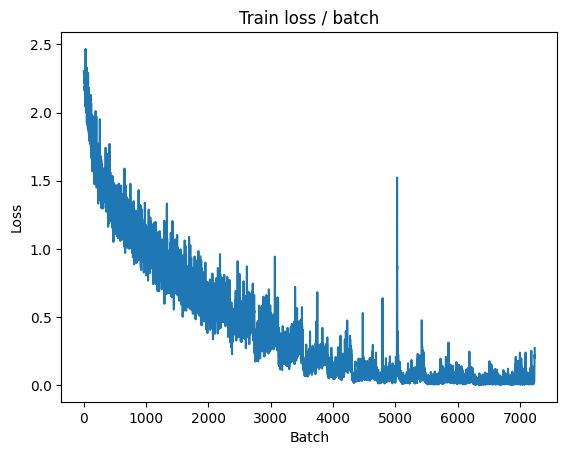


===============> Total time 24s	Avg loss 0.0493	Avg Prec@1 98.45 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.248s (0.248s)	Loss 1.4140 (1.4140)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.6215	Avg Prec@1 74.29 %	Avg Prec@5 97.57 %



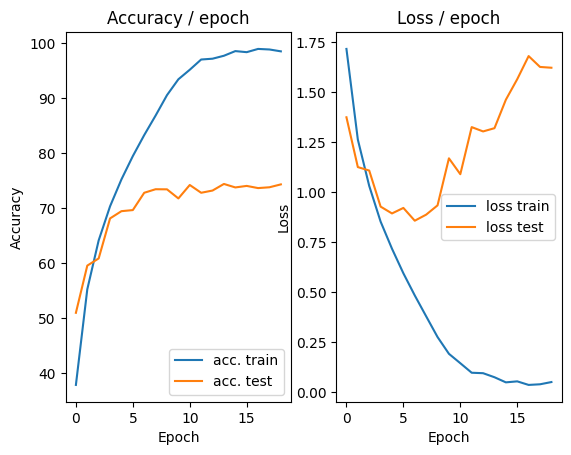

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 0.0153 (0.0153)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


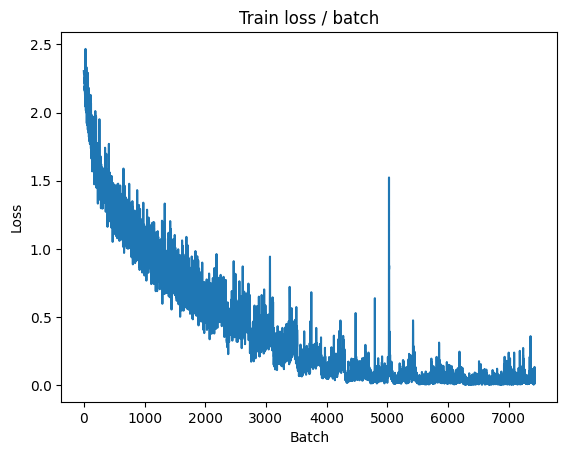

[TRAIN Batch 200/391]	Time 0.058s (0.063s)	Loss 0.0092 (0.0194)	Prec@1  99.2 ( 99.4)	Prec@5 100.0 (100.0)


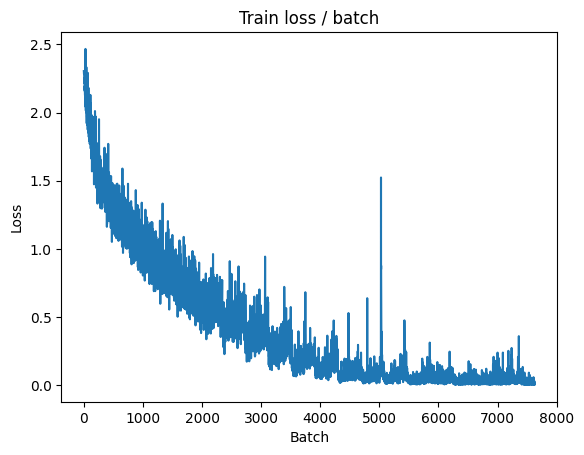


===============> Total time 24s	Avg loss 0.0287	Avg Prec@1 99.06 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 1.3454 (1.3454)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.6914	Avg Prec@1 73.79 %	Avg Prec@5 97.49 %



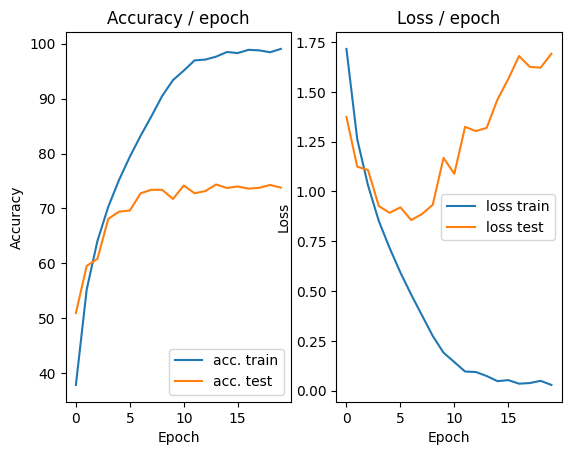

In [14]:
main(batch_size, lr, epochs, cuda=True)

**Question 21** [**Bonus**] : There are other normalization schemes that can be more efficient like ZCA normalization.Try other methods, explain the differences and compare them to the one requested.

In [15]:
def calculate_zca_matrix(train_dataset):
    """
    Calculate the ZCA whitening matrix.
    """
    data = torch.stack([img[0] for img in train_dataset])  # Extract all image data
    data = data.view(data.size(0), -1)  # Flatten images

    # Compute the mean and center the data
    mean = data.mean(dim=0)
    data -= mean

    # Compute the covariance matrix
    covariance = torch.mm(data.T, data) / data.size(0)
    U, S, _ = torch.svd(covariance)

    # Compute the ZCA whitening matrix
    epsilon = 1e-5
    zca_matrix = torch.mm(U, torch.mm(torch.diag(1.0 / torch.sqrt(S + epsilon)), U.T))
    return mean, zca_matrix

class ZCATransform:
    def __init__(self, mean, zca_matrix):
        self.mean = mean
        self.zca_matrix = zca_matrix

    def __call__(self, x):
        x = x.view(-1) - self.mean  # Flatten and center the image
        x = torch.matmul(self.zca_matrix, x)  # Apply ZCA transformation
        return x.view(3, 32, 32)  # Reshape back to original dimensions

def get_dataset(batch_size, cuda=False, download=False):
    """
    Load the dataset and apply ZCA whitening and normalization to each image.
    """
    # Load the raw training set without transformations to compute the ZCA matrix
    raw_train_dataset = datasets.CIFAR10(PATH, train=True, download=download, transform=transforms.ToTensor())

    # Calculate the ZCA matrix
    mean, zca_matrix = calculate_zca_matrix(raw_train_dataset)

    # Define the transformations with ZCA whitening
    train_transform = transforms.Compose([
        transforms.ToTensor(),
        ZCATransform(mean, zca_matrix),  # Apply ZCA whitening
    ])
    
    val_transform = transforms.Compose([
        transforms.ToTensor(),
        ZCATransform(mean, zca_matrix),  # Apply ZCA whitening to validation set as well
    ])

    # Load training and validation datasets with ZCA transformations
    train_dataset = datasets.CIFAR10(PATH, train=True, download=download, transform=train_transform)
    val_dataset = datasets.CIFAR10(PATH, train=False, download=download, transform=val_transform)

    train_loader = torch.utils.data.DataLoader(train_dataset,
                                               batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                                             batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.649s (0.649s)	Loss 2.2998 (2.2998)	Prec@1  13.3 ( 13.3)	Prec@5  50.0 ( 50.0)


<Figure size 640x480 with 0 Axes>

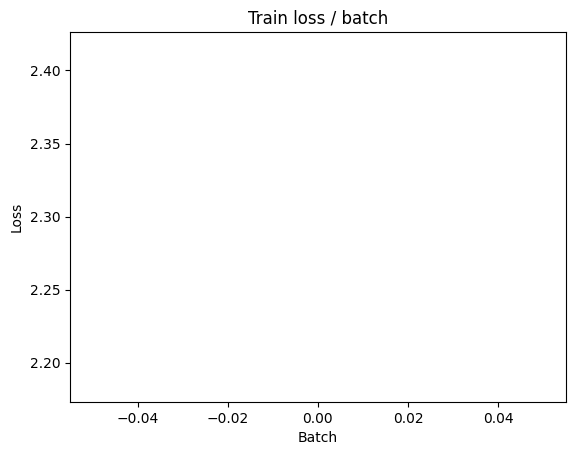

[TRAIN Batch 200/391]	Time 0.134s (0.195s)	Loss 1.8142 (2.0750)	Prec@1  32.8 ( 22.8)	Prec@5  87.5 ( 73.8)


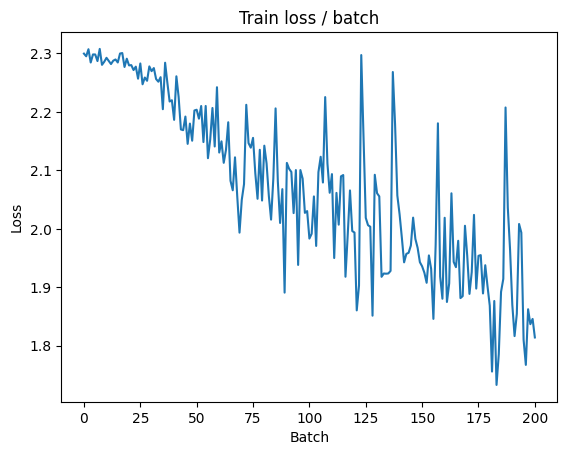


===============> Total time 77s	Avg loss 1.9093	Avg Prec@1 29.93 %	Avg Prec@5 80.19 %

[EVAL Batch 000/079]	Time 0.441s (0.441s)	Loss 1.5696 (1.5696)	Prec@1  46.1 ( 46.1)	Prec@5  89.8 ( 89.8)

===============> Total time 16s	Avg loss 1.5423	Avg Prec@1 46.47 %	Avg Prec@5 91.03 %



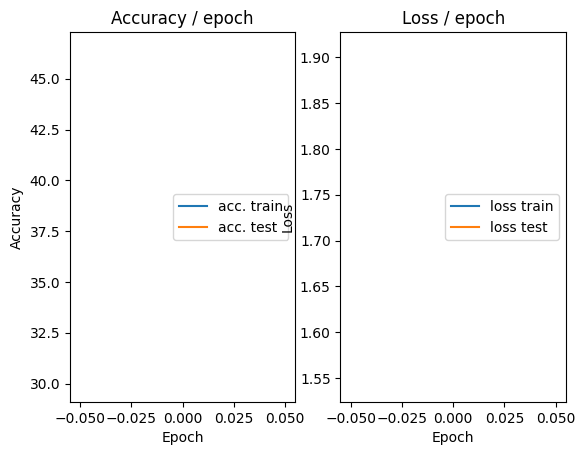

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.489s (0.489s)	Loss 1.7288 (1.7288)	Prec@1  42.2 ( 42.2)	Prec@5  90.6 ( 90.6)


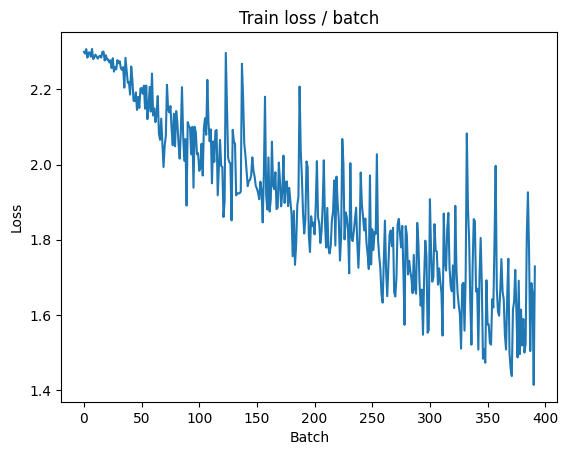

[TRAIN Batch 200/391]	Time 0.146s (0.210s)	Loss 1.2346 (1.4369)	Prec@1  57.8 ( 49.5)	Prec@5  97.7 ( 92.3)


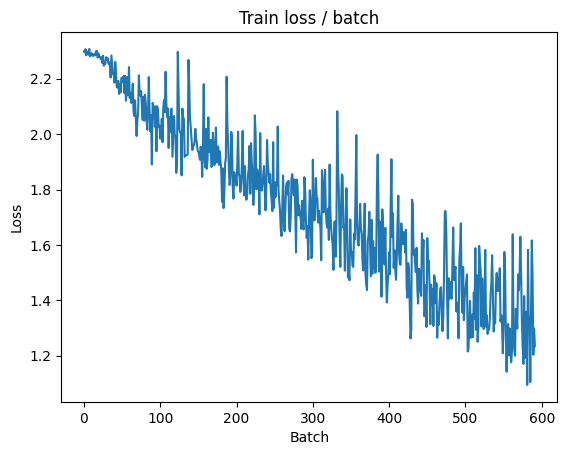


===============> Total time 80s	Avg loss 1.3131	Avg Prec@1 54.16 %	Avg Prec@5 93.58 %

[EVAL Batch 000/079]	Time 0.427s (0.427s)	Loss 1.1214 (1.1214)	Prec@1  57.8 ( 57.8)	Prec@5  94.5 ( 94.5)

===============> Total time 14s	Avg loss 1.2130	Avg Prec@1 58.23 %	Avg Prec@5 94.95 %



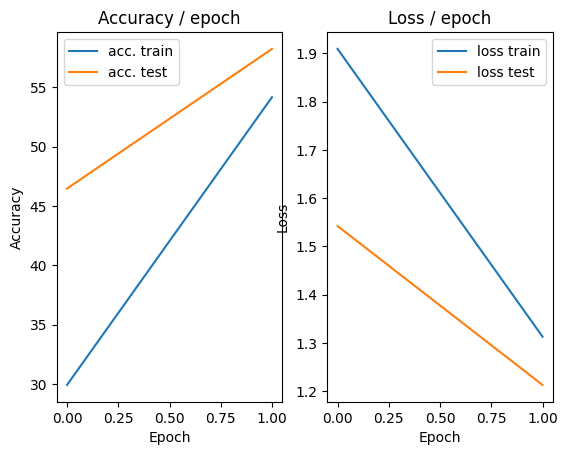

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.470s (0.470s)	Loss 1.2276 (1.2276)	Prec@1  57.0 ( 57.0)	Prec@5  95.3 ( 95.3)


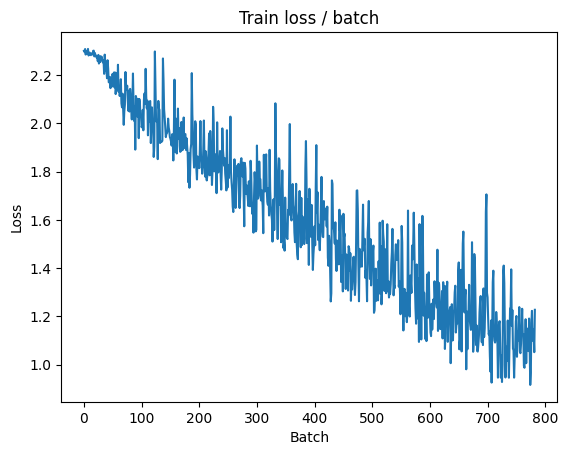

[TRAIN Batch 200/391]	Time 0.224s (0.205s)	Loss 0.8554 (1.0130)	Prec@1  71.1 ( 64.8)	Prec@5  97.7 ( 96.6)


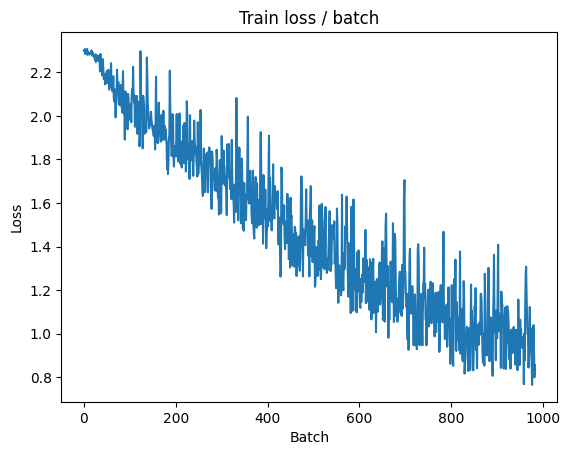


===============> Total time 80s	Avg loss 0.9588	Avg Prec@1 66.65 %	Avg Prec@5 96.93 %

[EVAL Batch 000/079]	Time 0.518s (0.518s)	Loss 0.9181 (0.9181)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)

===============> Total time 15s	Avg loss 0.9460	Avg Prec@1 67.25 %	Avg Prec@5 97.32 %



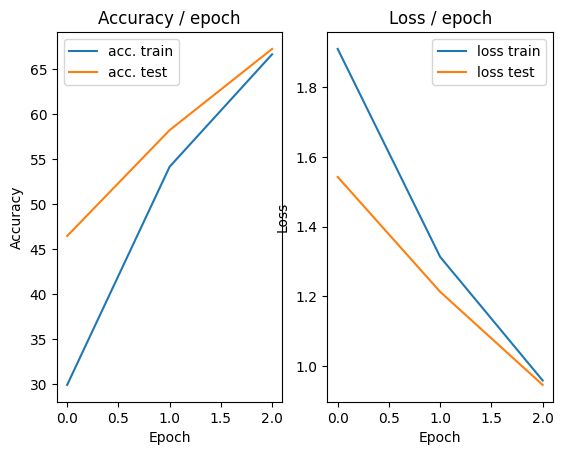

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.510s (0.510s)	Loss 0.7028 (0.7028)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)


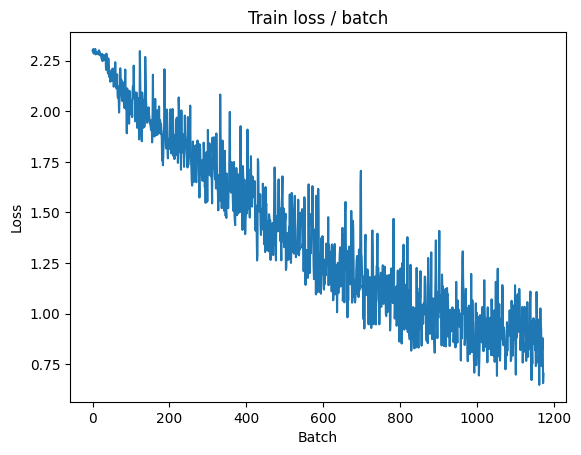

[TRAIN Batch 200/391]	Time 0.396s (0.218s)	Loss 0.7217 (0.7869)	Prec@1  74.2 ( 72.5)	Prec@5  99.2 ( 97.9)


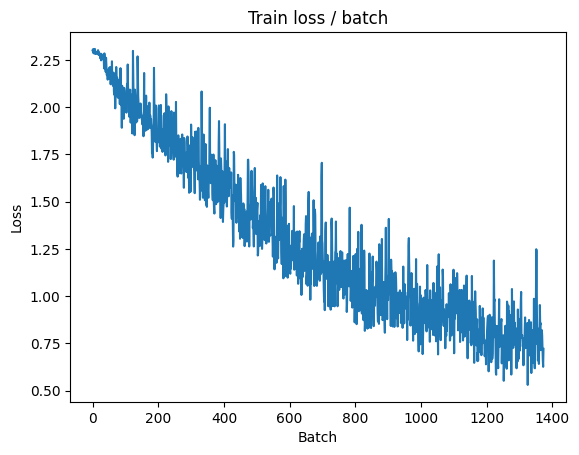


===============> Total time 92s	Avg loss 0.7671	Avg Prec@1 73.41 %	Avg Prec@5 98.06 %

[EVAL Batch 000/079]	Time 0.426s (0.426s)	Loss 0.9528 (0.9528)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 15s	Avg loss 1.0160	Avg Prec@1 66.31 %	Avg Prec@5 96.18 %



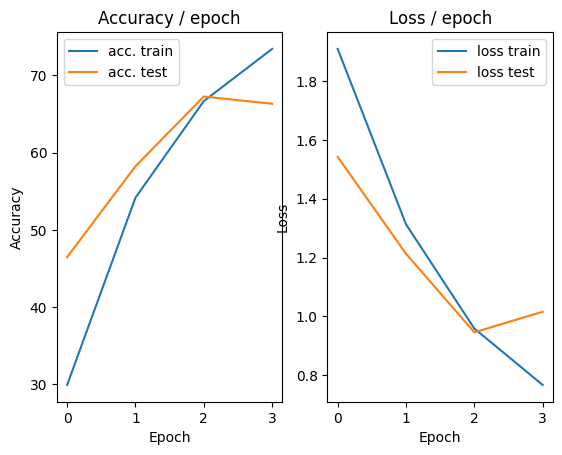

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.448s (0.448s)	Loss 1.0275 (1.0275)	Prec@1  66.4 ( 66.4)	Prec@5  98.4 ( 98.4)


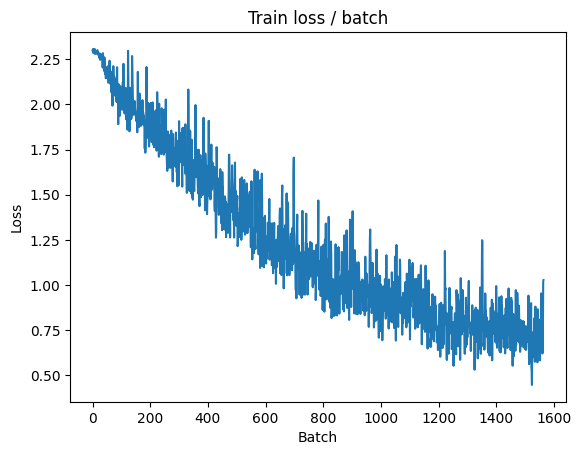

[TRAIN Batch 200/391]	Time 0.505s (0.227s)	Loss 0.5957 (0.6352)	Prec@1  75.8 ( 77.8)	Prec@5 100.0 ( 98.8)


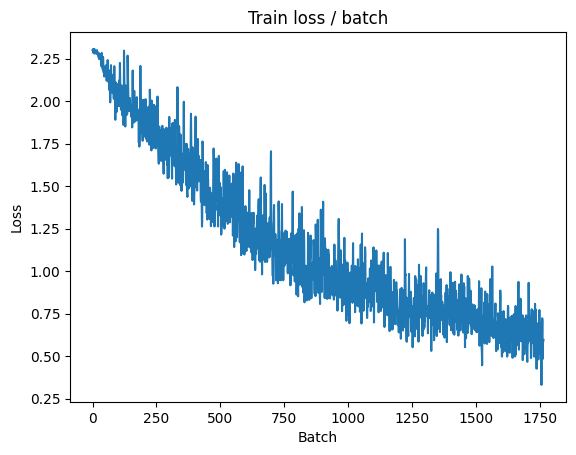


===============> Total time 92s	Avg loss 0.6343	Avg Prec@1 78.03 %	Avg Prec@5 98.74 %

[EVAL Batch 000/079]	Time 0.572s (0.572s)	Loss 0.6427 (0.6427)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 17s	Avg loss 0.7534	Avg Prec@1 74.98 %	Avg Prec@5 98.05 %



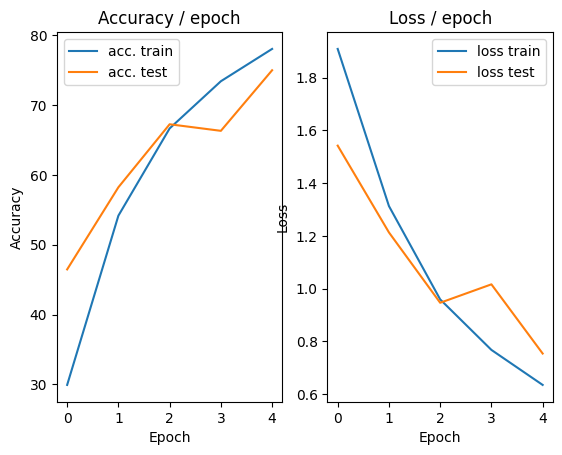

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.587s (0.587s)	Loss 0.4463 (0.4463)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


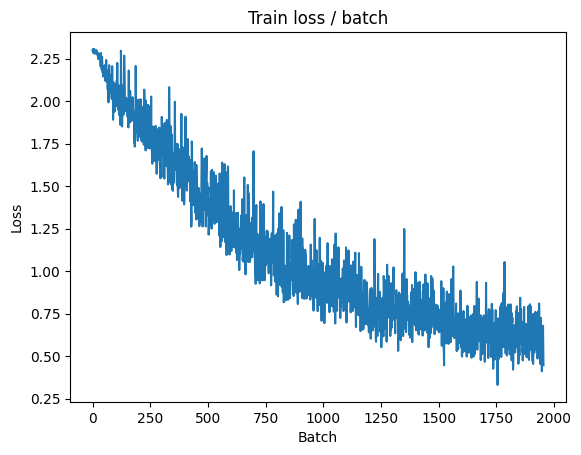

[TRAIN Batch 200/391]	Time 0.279s (0.245s)	Loss 0.6513 (0.5220)	Prec@1  78.1 ( 81.7)	Prec@5  97.7 ( 99.2)


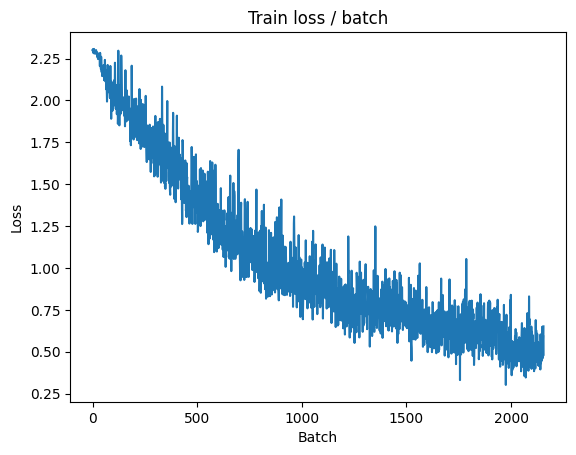


===============> Total time 88s	Avg loss 0.5290	Avg Prec@1 81.58 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.398s (0.398s)	Loss 0.6342 (0.6342)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 15s	Avg loss 0.7379	Avg Prec@1 76.00 %	Avg Prec@5 98.29 %



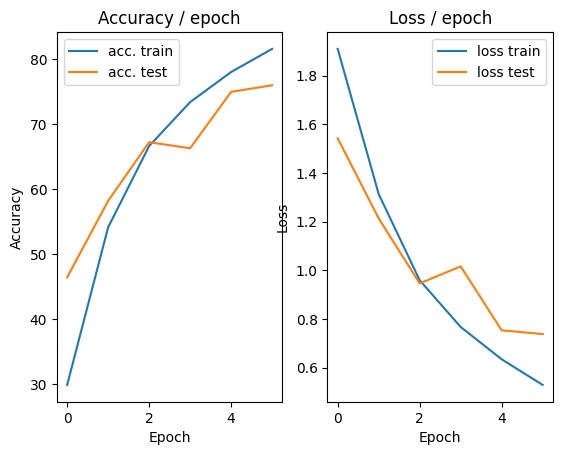

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.463s (0.463s)	Loss 0.4729 (0.4729)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


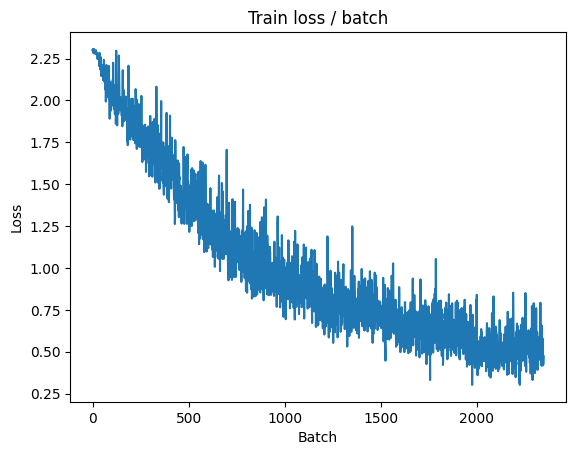

[TRAIN Batch 200/391]	Time 0.259s (0.204s)	Loss 0.5115 (0.4276)	Prec@1  82.0 ( 85.1)	Prec@5  98.4 ( 99.5)


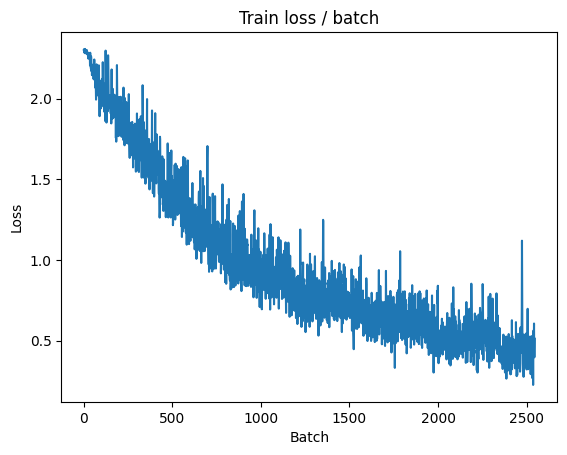


===============> Total time 80s	Avg loss 0.4356	Avg Prec@1 84.90 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.416s (0.416s)	Loss 0.8603 (0.8603)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 15s	Avg loss 1.1004	Avg Prec@1 69.03 %	Avg Prec@5 96.59 %



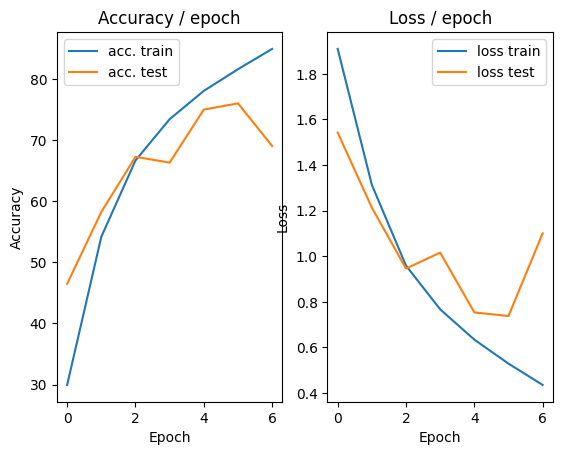

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.475s (0.475s)	Loss 0.5966 (0.5966)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)


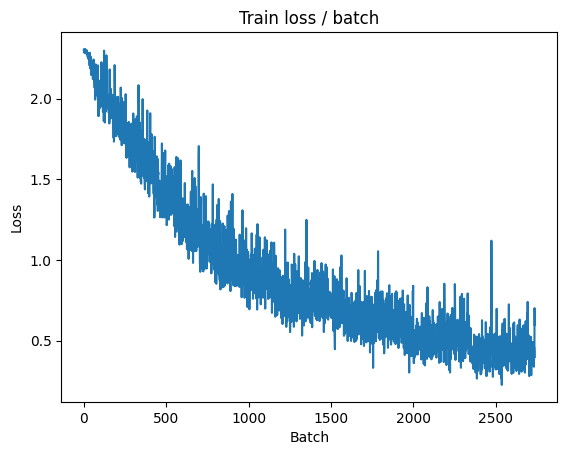

[TRAIN Batch 200/391]	Time 0.272s (0.204s)	Loss 0.3532 (0.3232)	Prec@1  88.3 ( 88.8)	Prec@5 100.0 ( 99.8)


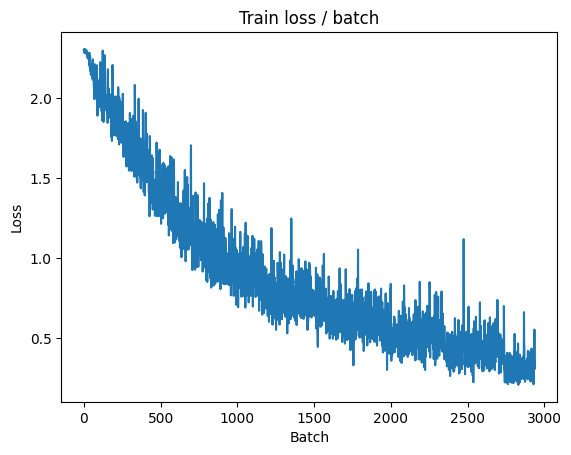


===============> Total time 87s	Avg loss 0.3357	Avg Prec@1 88.32 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.622s (0.622s)	Loss 0.6681 (0.6681)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)

===============> Total time 17s	Avg loss 0.8545	Avg Prec@1 73.78 %	Avg Prec@5 97.54 %



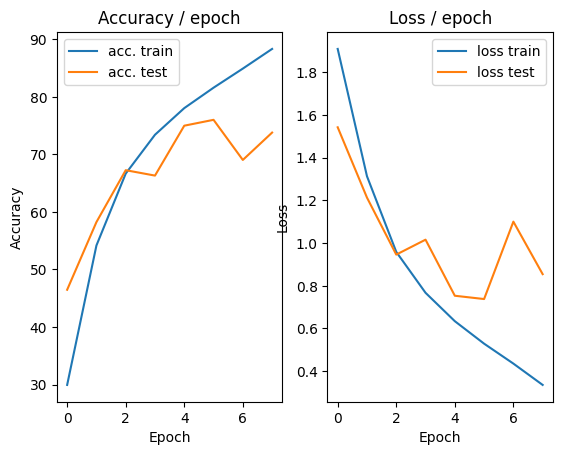

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.597s (0.597s)	Loss 0.2857 (0.2857)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


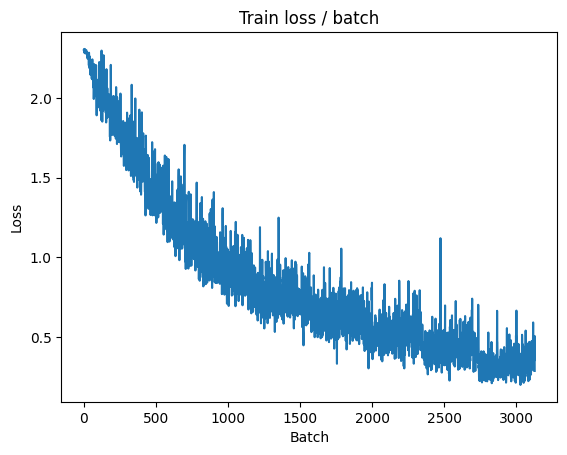

[TRAIN Batch 200/391]	Time 0.306s (0.229s)	Loss 0.2266 (0.2447)	Prec@1  94.5 ( 91.5)	Prec@5 100.0 ( 99.9)


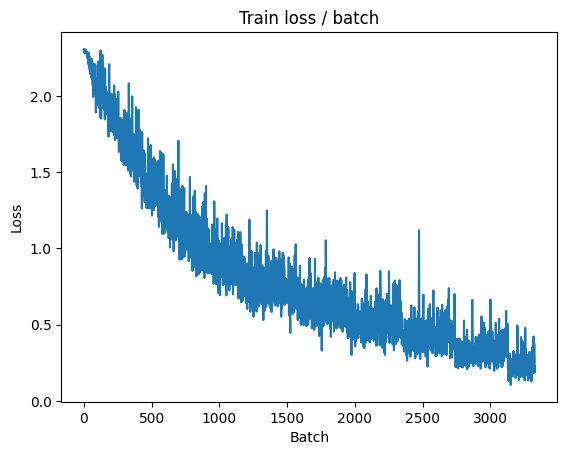


===============> Total time 84s	Avg loss 0.2561	Avg Prec@1 91.04 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.505s (0.505s)	Loss 0.5467 (0.5467)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 15s	Avg loss 0.8059	Avg Prec@1 77.87 %	Avg Prec@5 98.40 %



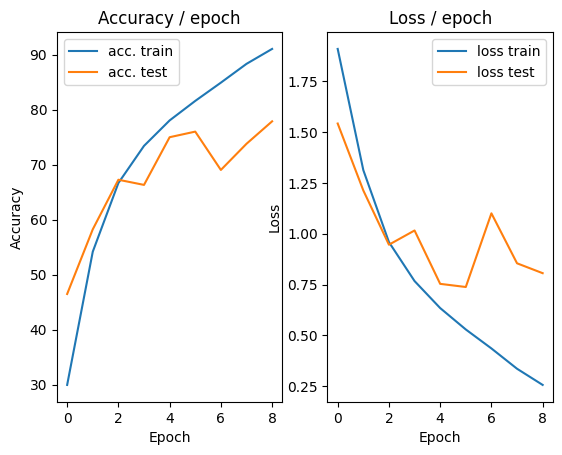

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.457s (0.457s)	Loss 0.1780 (0.1780)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


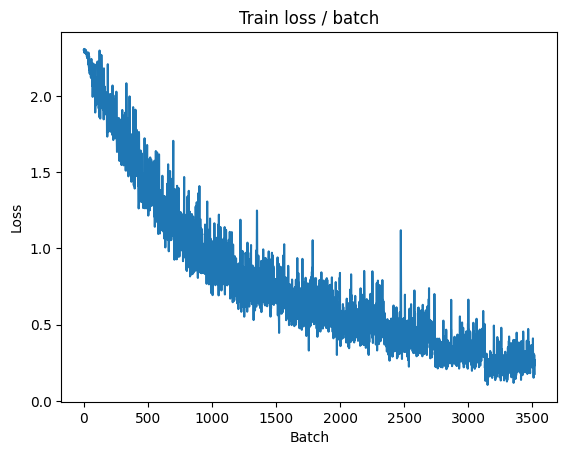

[TRAIN Batch 200/391]	Time 0.343s (0.205s)	Loss 0.2656 (0.1591)	Prec@1  91.4 ( 94.7)	Prec@5 100.0 (100.0)


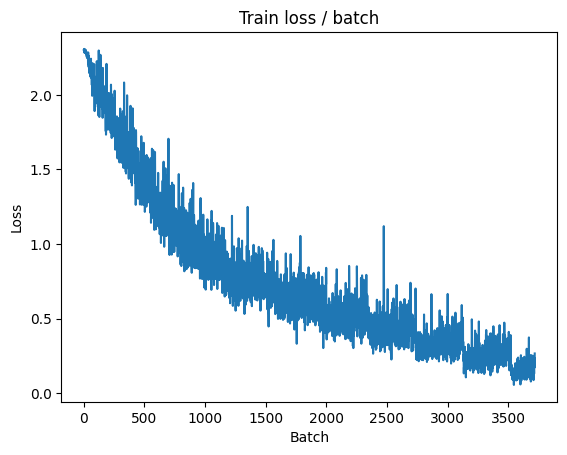


===============> Total time 81s	Avg loss 0.1744	Avg Prec@1 94.04 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.546s (0.546s)	Loss 0.6663 (0.6663)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 17s	Avg loss 0.9150	Avg Prec@1 76.35 %	Avg Prec@5 98.18 %



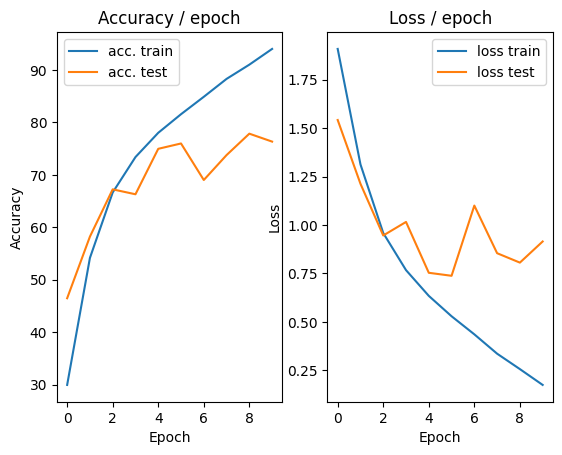

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.478s (0.478s)	Loss 0.1523 (0.1523)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


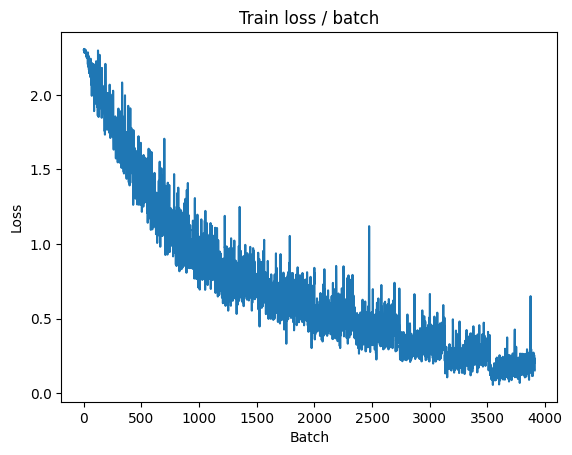

[TRAIN Batch 200/391]	Time 0.361s (0.210s)	Loss 0.1033 (0.1080)	Prec@1  96.1 ( 96.5)	Prec@5 100.0 (100.0)


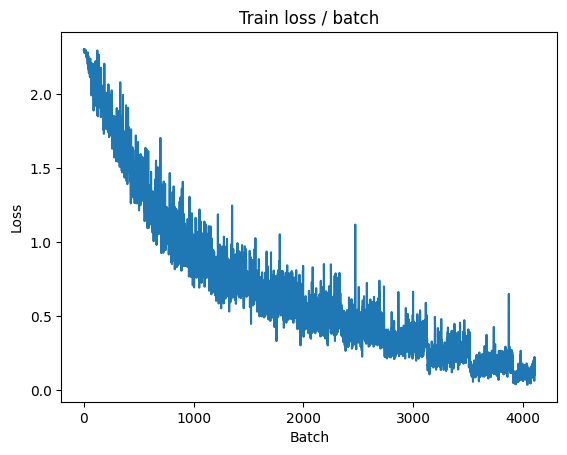


===============> Total time 80s	Avg loss 0.1208	Avg Prec@1 95.91 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.535s (0.535s)	Loss 0.7902 (0.7902)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 15s	Avg loss 0.9918	Avg Prec@1 77.23 %	Avg Prec@5 98.44 %



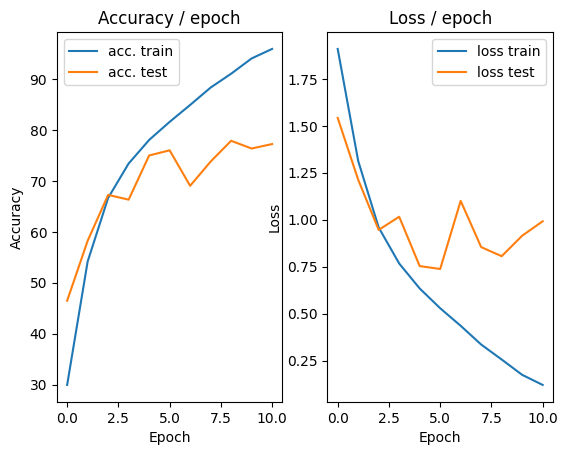

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.546s (0.546s)	Loss 0.0532 (0.0532)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


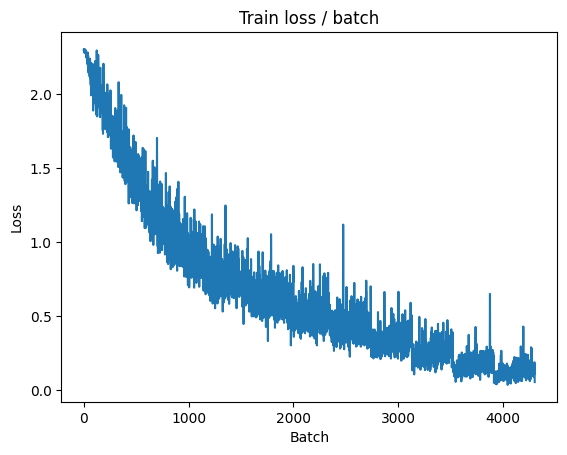

[TRAIN Batch 200/391]	Time 0.295s (0.211s)	Loss 0.0242 (0.0538)	Prec@1 100.0 ( 98.6)	Prec@5 100.0 (100.0)


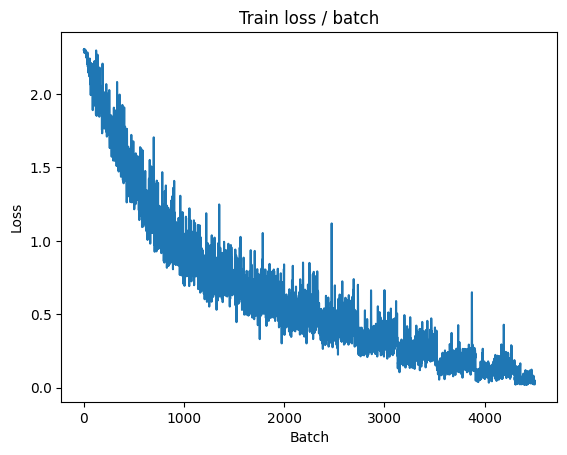


===============> Total time 81s	Avg loss 0.0732	Avg Prec@1 97.69 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.456s (0.456s)	Loss 0.7645 (0.7645)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 15s	Avg loss 0.9611	Avg Prec@1 77.11 %	Avg Prec@5 98.38 %



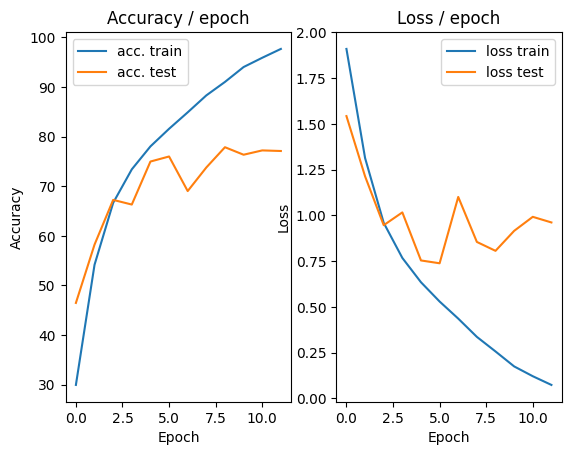

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.432s (0.432s)	Loss 0.0873 (0.0873)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


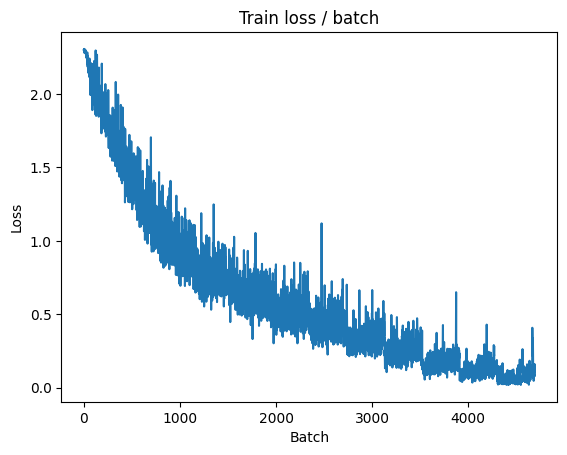

[TRAIN Batch 200/391]	Time 0.278s (0.207s)	Loss 0.0266 (0.0405)	Prec@1  99.2 ( 98.9)	Prec@5 100.0 (100.0)


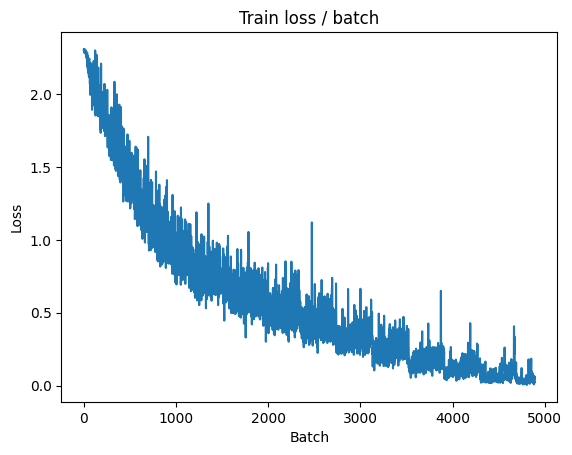


===============> Total time 78s	Avg loss 0.0536	Avg Prec@1 98.44 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.469s (0.469s)	Loss 1.1798 (1.1798)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 15s	Avg loss 1.3579	Avg Prec@1 74.45 %	Avg Prec@5 97.73 %



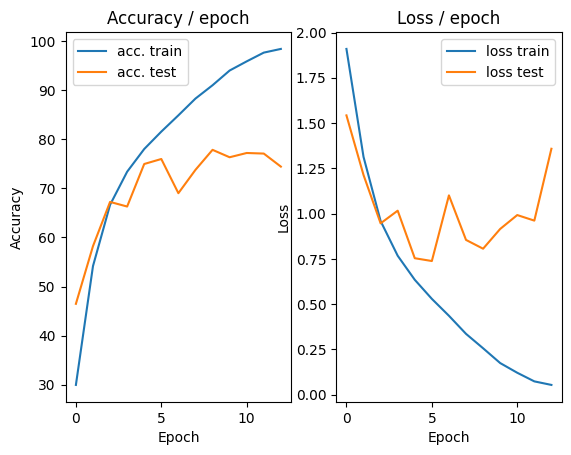

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.579s (0.579s)	Loss 0.1729 (0.1729)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


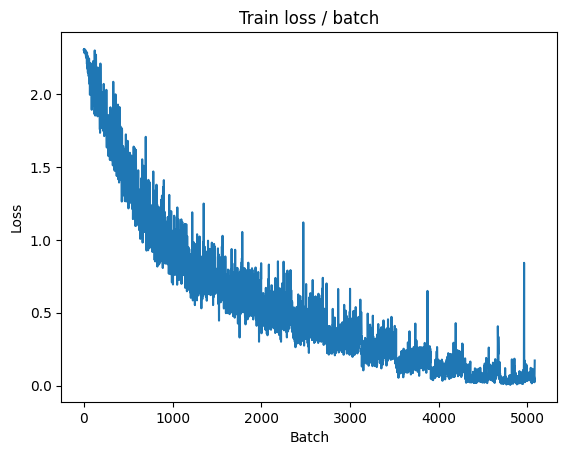

[TRAIN Batch 200/391]	Time 0.382s (0.222s)	Loss 0.0276 (0.0287)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


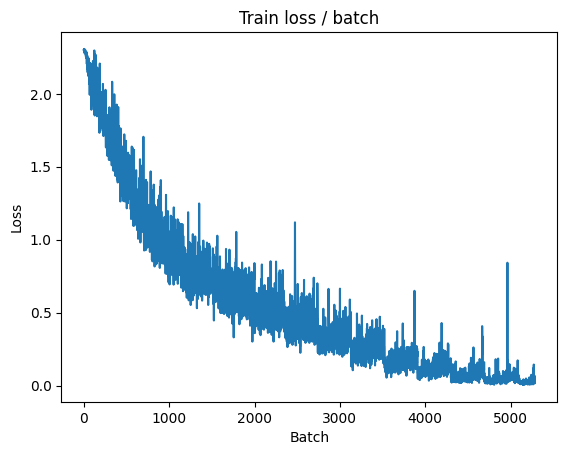


===============> Total time 84s	Avg loss 0.0417	Avg Prec@1 98.77 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.493s (0.493s)	Loss 0.9843 (0.9843)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 17s	Avg loss 1.0870	Avg Prec@1 77.87 %	Avg Prec@5 98.22 %



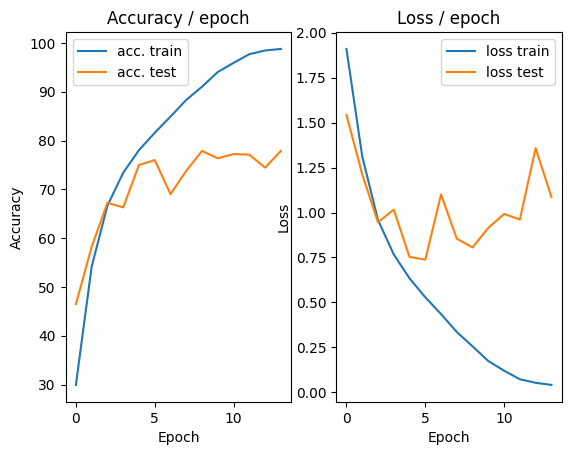

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.524s (0.524s)	Loss 0.0304 (0.0304)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


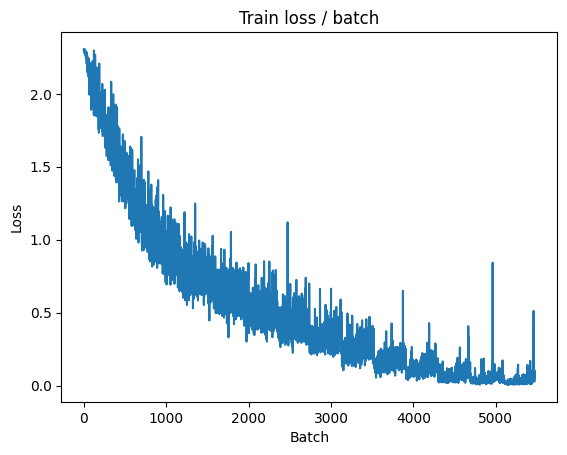

[TRAIN Batch 200/391]	Time 0.338s (0.216s)	Loss 0.0080 (0.0242)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


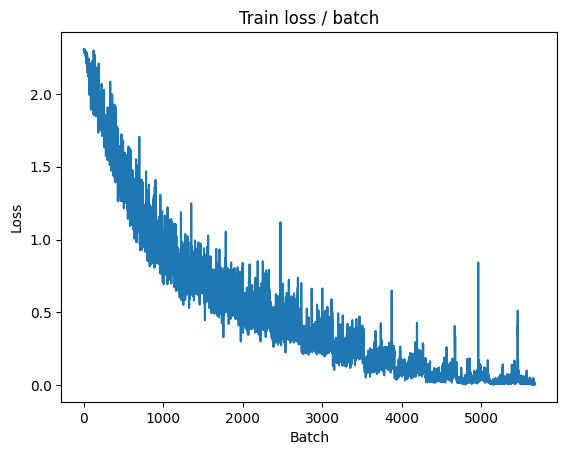


===============> Total time 92s	Avg loss 0.0244	Avg Prec@1 99.47 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.562s (0.562s)	Loss 0.8744 (0.8744)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 20s	Avg loss 1.3319	Avg Prec@1 73.82 %	Avg Prec@5 97.60 %



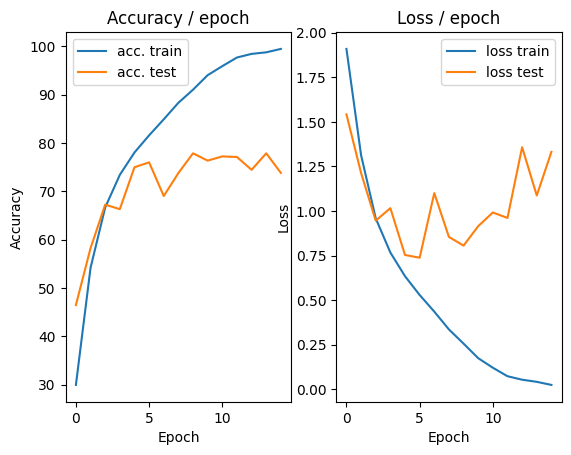

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.545s (0.545s)	Loss 0.2346 (0.2346)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


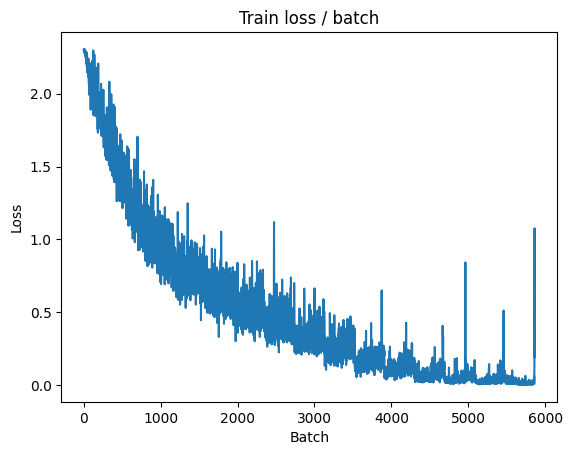

[TRAIN Batch 200/391]	Time 0.384s (0.237s)	Loss 0.0053 (0.0162)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


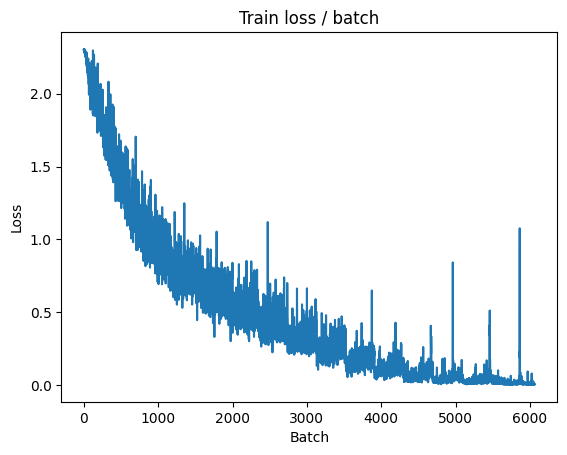


===============> Total time 87s	Avg loss 0.0135	Avg Prec@1 99.68 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.459s (0.459s)	Loss 0.8468 (0.8468)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 15s	Avg loss 1.4047	Avg Prec@1 77.80 %	Avg Prec@5 98.50 %



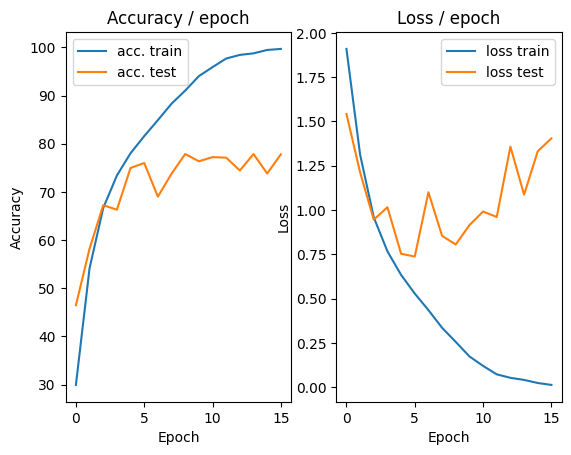

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.588s (0.588s)	Loss 0.0244 (0.0244)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


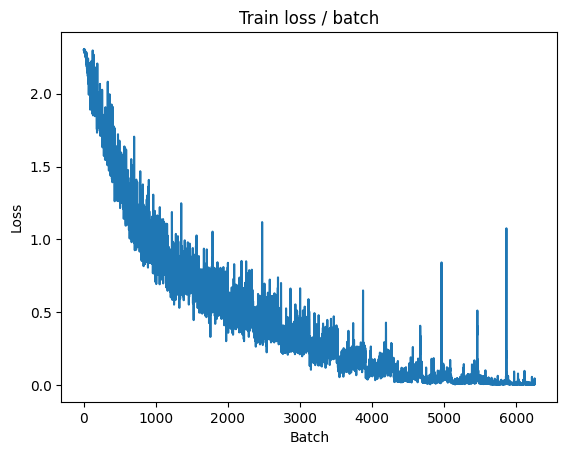

[TRAIN Batch 200/391]	Time 0.103s (0.211s)	Loss 0.0039 (0.0037)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


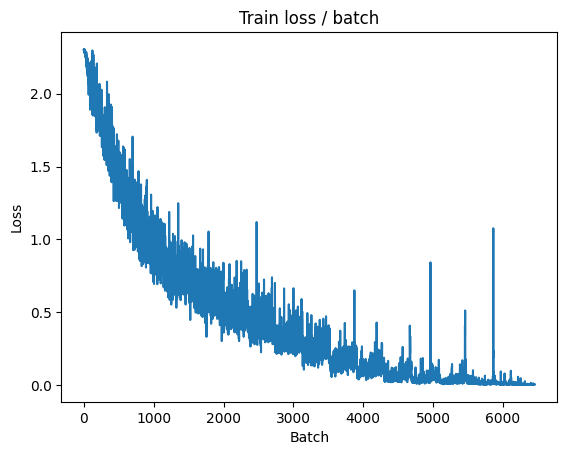


===============> Total time 81s	Avg loss 0.0029	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.531s (0.531s)	Loss 0.9761 (0.9761)	Prec@1  89.1 ( 89.1)	Prec@5  97.7 ( 97.7)

===============> Total time 16s	Avg loss 1.3963	Avg Prec@1 79.37 %	Avg Prec@5 98.55 %



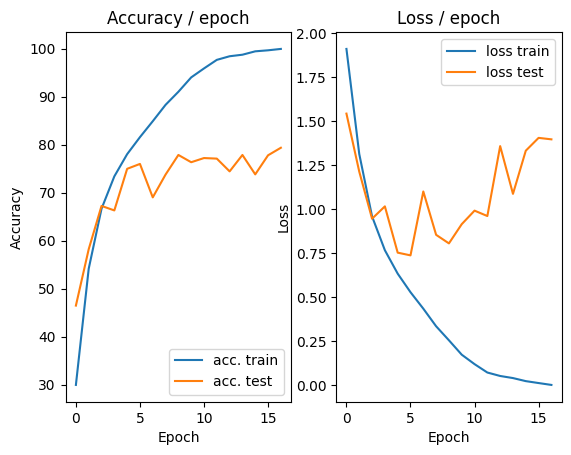

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.496s (0.496s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


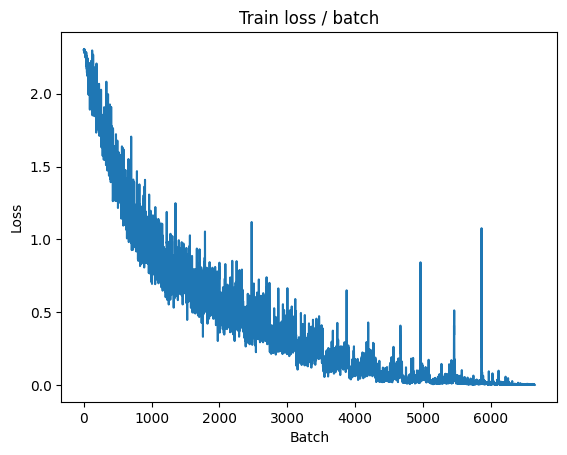

[TRAIN Batch 200/391]	Time 0.351s (0.227s)	Loss 0.0008 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


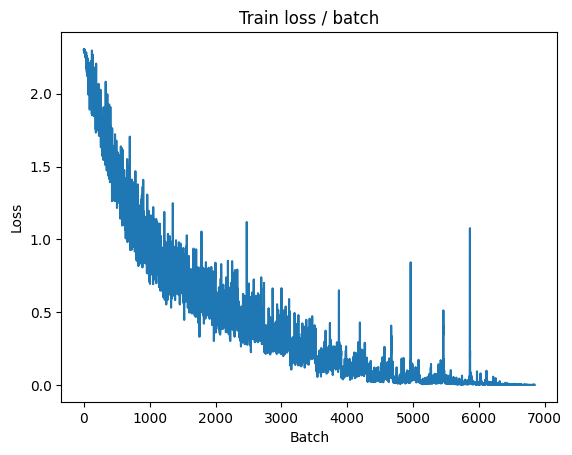


===============> Total time 86s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.579s (0.579s)	Loss 0.9951 (0.9951)	Prec@1  89.1 ( 89.1)	Prec@5  97.7 ( 97.7)

===============> Total time 16s	Avg loss 1.4599	Avg Prec@1 79.75 %	Avg Prec@5 98.49 %



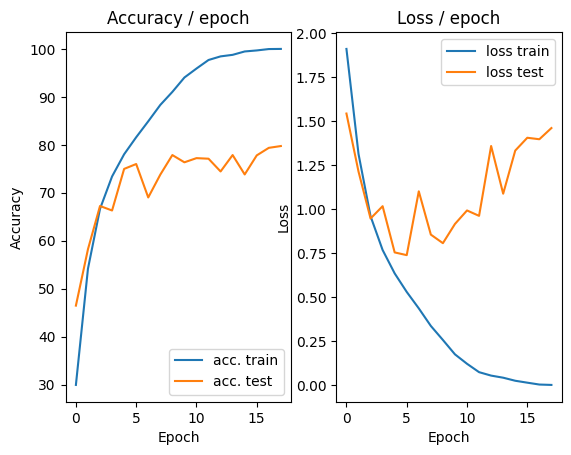

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.639s (0.639s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


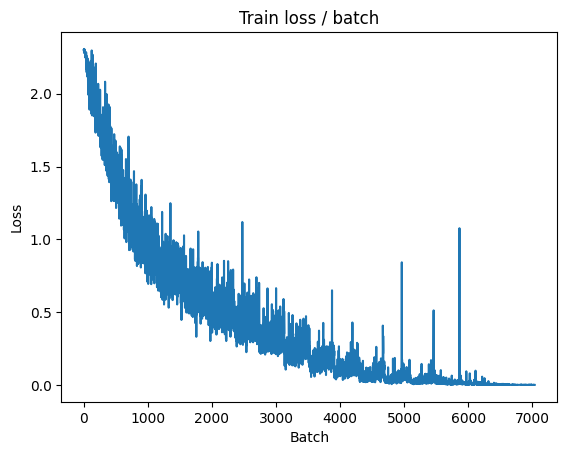

[TRAIN Batch 200/391]	Time 0.346s (0.232s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


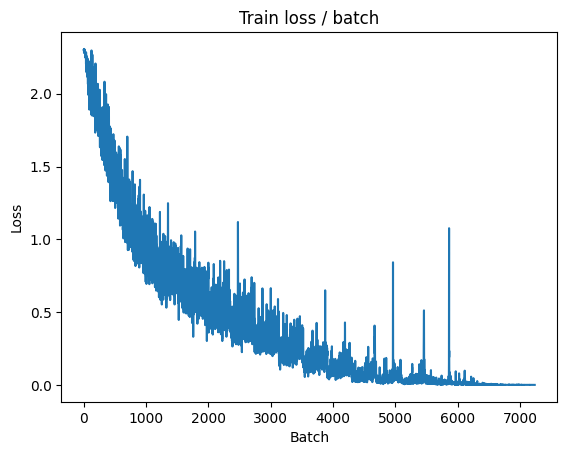


===============> Total time 89s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.491s (0.491s)	Loss 1.0088 (1.0088)	Prec@1  89.1 ( 89.1)	Prec@5  97.7 ( 97.7)

===============> Total time 15s	Avg loss 1.5067	Avg Prec@1 79.67 %	Avg Prec@5 98.49 %



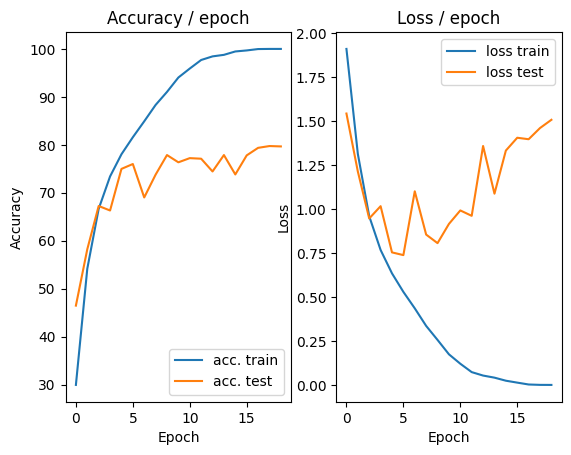

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.530s (0.530s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


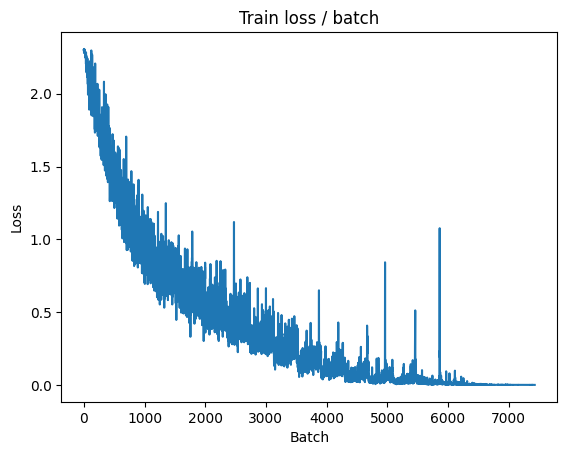

[TRAIN Batch 200/391]	Time 0.395s (0.215s)	Loss 0.0005 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


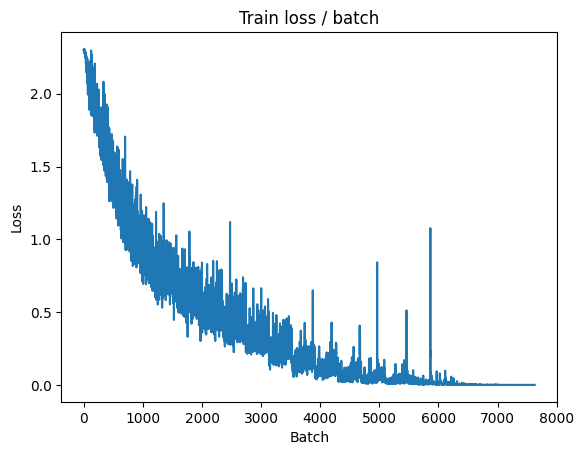


===============> Total time 82s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.447s (0.447s)	Loss 1.0289 (1.0289)	Prec@1  89.1 ( 89.1)	Prec@5  97.7 ( 97.7)

===============> Total time 15s	Avg loss 1.5400	Avg Prec@1 79.75 %	Avg Prec@5 98.49 %



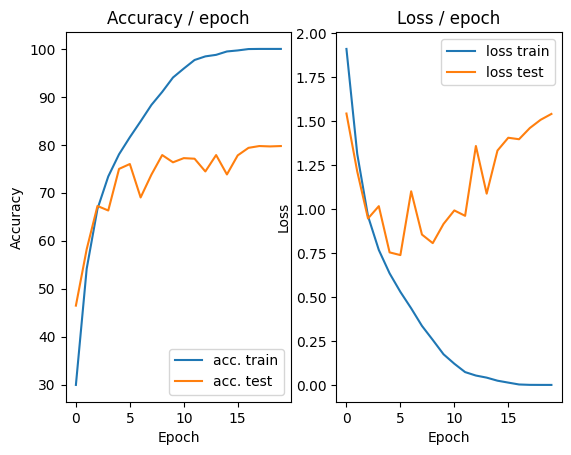

In [16]:
main(batch_size, lr, epochs, cuda=True)

### 3.2 Increase in the number of training examples by data increase
**Implementation**: <br>
— Modify the call to `datasets.CIFAR10` to add in train a random crop size 28 and a random horizontal symmetry ; and in test a centered crop size 28.<br>
— Modify the $\texttt{pool3}$ layer to add the option `ceil_mode = True`.

In [17]:
def get_dataset(batch_size, cuda=False,download=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=False,
        transform=transforms.Compose([
            # Random crop & Random horizontal symmetry
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip(),

            transforms.ToTensor(),  
            transforms.Normalize(mean=[0.491, 0.482, 0.447],  std=[0.202, 0.199, 0.201]) 
    ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=False,
        transform=transforms.Compose([
            #Centered crop
            transforms.CenterCrop(28),
            
            transforms.ToTensor(),  
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std=[0.202, 0.199, 0.201])  
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

In [18]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),     
            nn.ReLU(),
            nn.MaxPool2d((2,2),stride=2,padding=0),            

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),    
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),         

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),     
            nn.ReLU(),

            # Set ceil_mode=True to increase the feature map size in the pooling layer, compensating for the information loss caused by cropping.
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode = True),         
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(4*4*64, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10),
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 1.900s (1.900s)	Loss 2.3027 (2.3027)	Prec@1   9.4 (  9.4)	Prec@5  53.1 ( 53.1)


<Figure size 640x480 with 0 Axes>

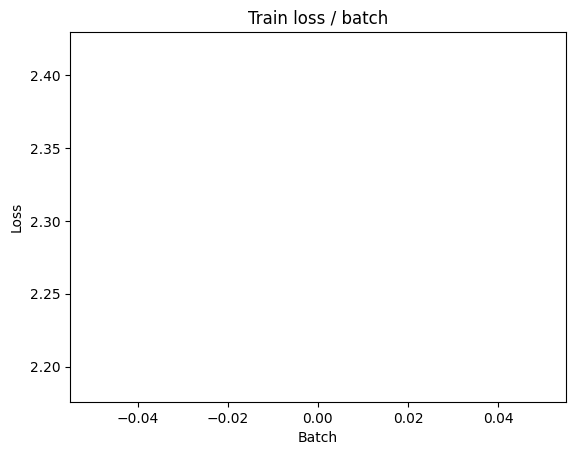

[TRAIN Batch 200/391]	Time 0.058s (0.065s)	Loss 1.6068 (1.9719)	Prec@1  42.2 ( 27.1)	Prec@5  90.6 ( 77.9)


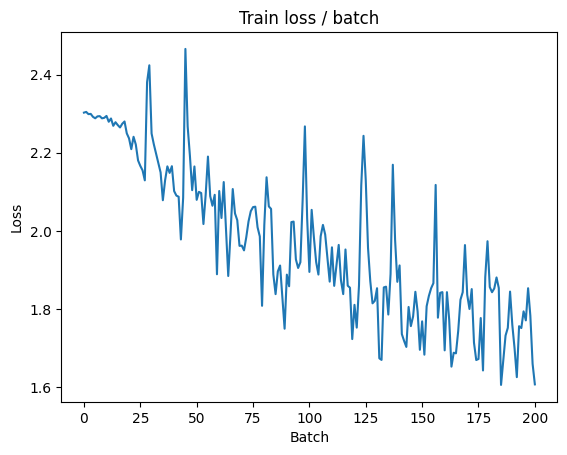


===============> Total time 25s	Avg loss 1.8083	Avg Prec@1 33.75 %	Avg Prec@5 83.68 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 1.4638 (1.4638)	Prec@1  51.6 ( 51.6)	Prec@5  87.5 ( 87.5)

===============> Total time 2s	Avg loss 1.4982	Avg Prec@1 46.89 %	Avg Prec@5 92.30 %



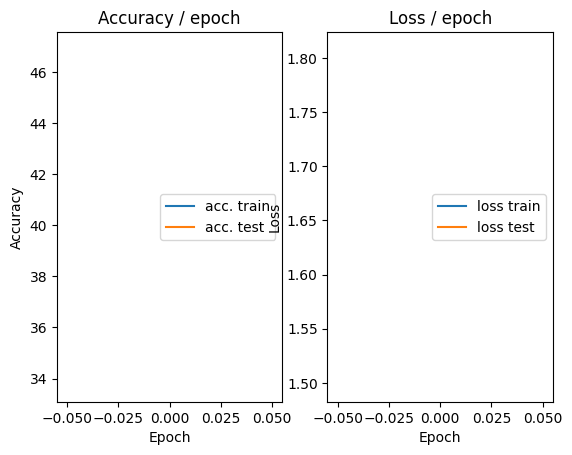

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 1.5141 (1.5141)	Prec@1  47.7 ( 47.7)	Prec@5  93.0 ( 93.0)


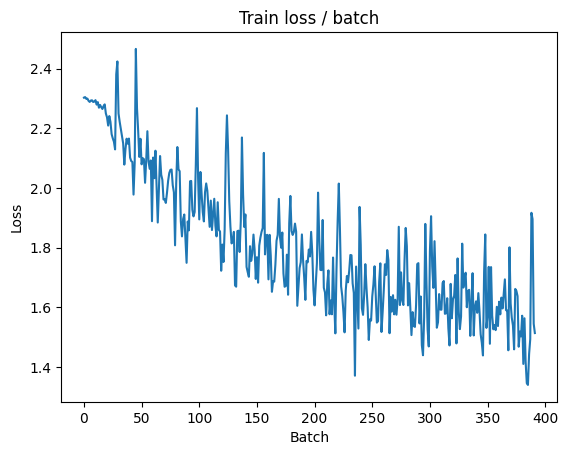

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 1.4692 (1.4702)	Prec@1  46.9 ( 47.2)	Prec@5  94.5 ( 92.5)


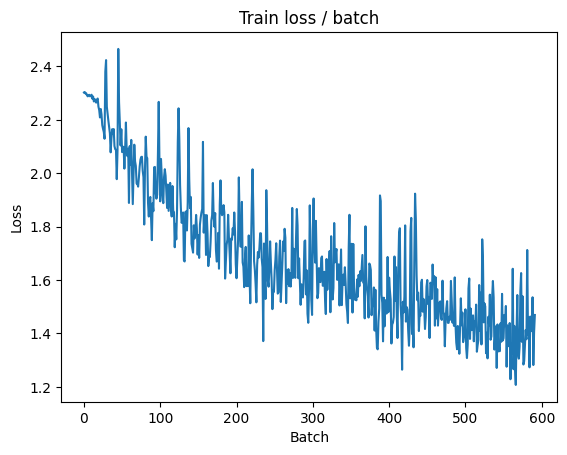


===============> Total time 22s	Avg loss 1.4076	Avg Prec@1 49.38 %	Avg Prec@5 93.10 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.2064 (1.2064)	Prec@1  57.8 ( 57.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.2788	Avg Prec@1 54.24 %	Avg Prec@5 94.79 %



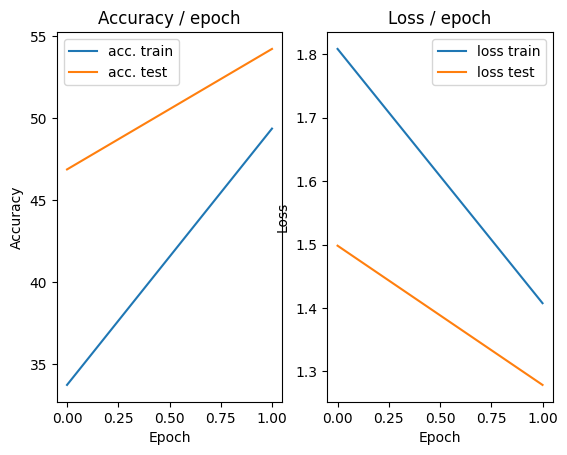

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 1.2573 (1.2573)	Prec@1  53.9 ( 53.9)	Prec@5  95.3 ( 95.3)


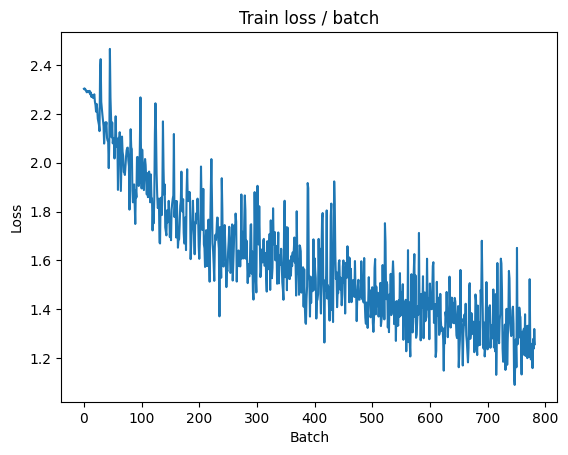

[TRAIN Batch 200/391]	Time 0.058s (0.057s)	Loss 1.3102 (1.2375)	Prec@1  51.6 ( 56.0)	Prec@5  93.0 ( 94.8)


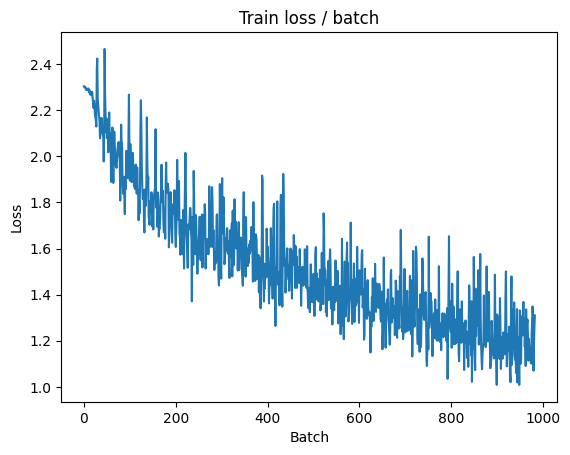


===============> Total time 22s	Avg loss 1.2001	Avg Prec@1 57.49 %	Avg Prec@5 95.09 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 1.0663 (1.0663)	Prec@1  65.6 ( 65.6)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.0870	Avg Prec@1 62.12 %	Avg Prec@5 96.38 %



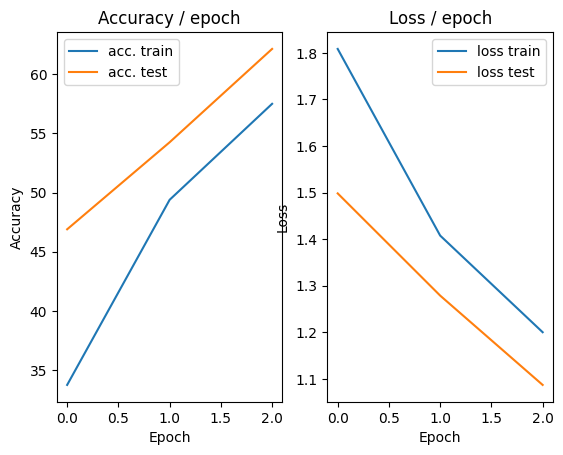

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 1.0656 (1.0656)	Prec@1  59.4 ( 59.4)	Prec@5  99.2 ( 99.2)


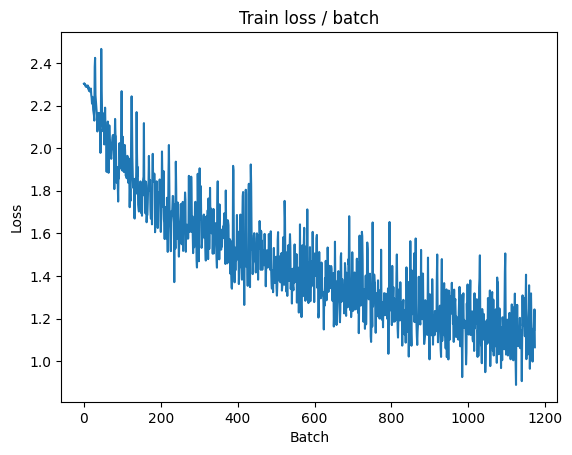

[TRAIN Batch 200/391]	Time 0.053s (0.057s)	Loss 1.0607 (1.0758)	Prec@1  63.3 ( 62.5)	Prec@5  98.4 ( 96.1)


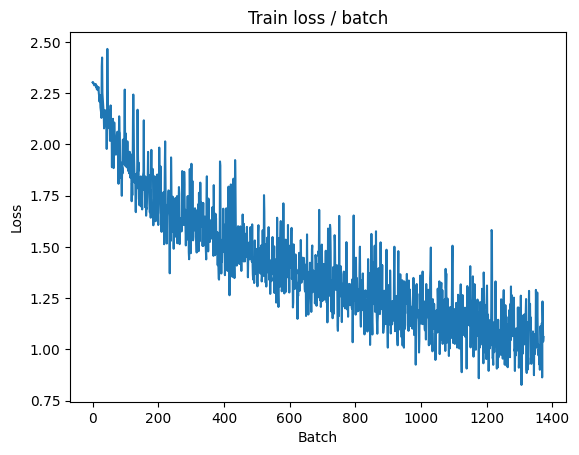


===============> Total time 22s	Avg loss 1.0503	Avg Prec@1 63.25 %	Avg Prec@5 96.33 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.9501 (0.9501)	Prec@1  67.2 ( 67.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9802	Avg Prec@1 66.21 %	Avg Prec@5 97.06 %



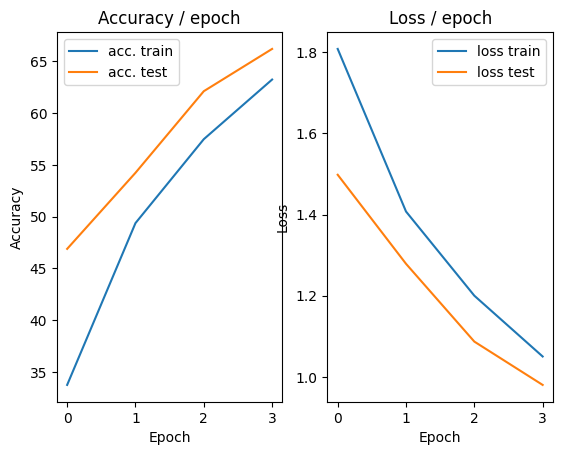

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.8748 (0.8748)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)


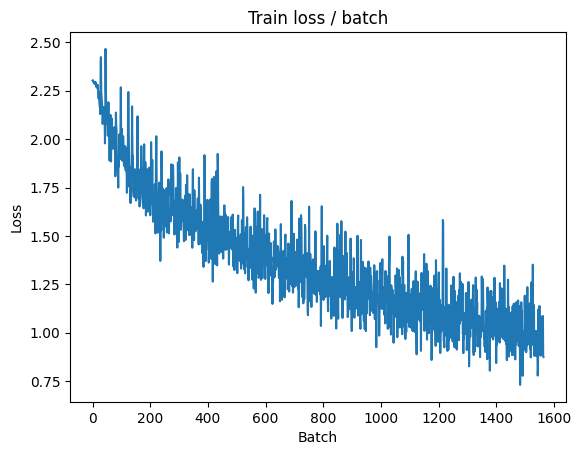

[TRAIN Batch 200/391]	Time 0.056s (0.058s)	Loss 1.0746 (0.9555)	Prec@1  64.1 ( 66.6)	Prec@5  98.4 ( 97.1)


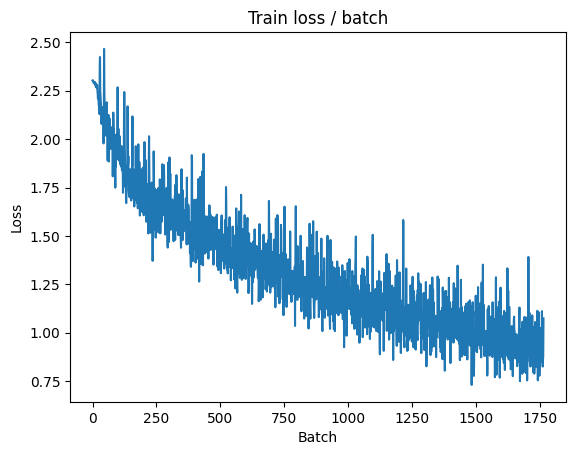


===============> Total time 22s	Avg loss 0.9440	Avg Prec@1 66.97 %	Avg Prec@5 97.05 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 0.9973 (0.9973)	Prec@1  63.3 ( 63.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.1205	Avg Prec@1 62.17 %	Avg Prec@5 97.15 %



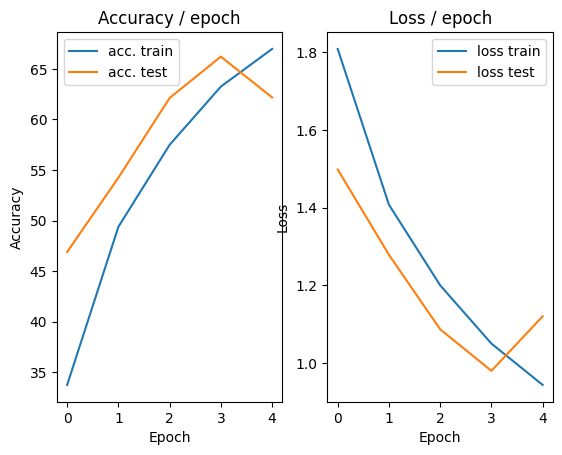

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 1.0469 (1.0469)	Prec@1  62.5 ( 62.5)	Prec@5  97.7 ( 97.7)


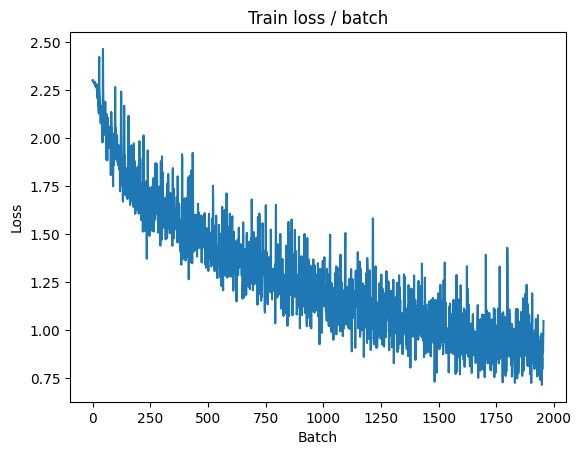

[TRAIN Batch 200/391]	Time 0.056s (0.057s)	Loss 0.7803 (0.8687)	Prec@1  72.7 ( 69.5)	Prec@5  97.7 ( 97.6)


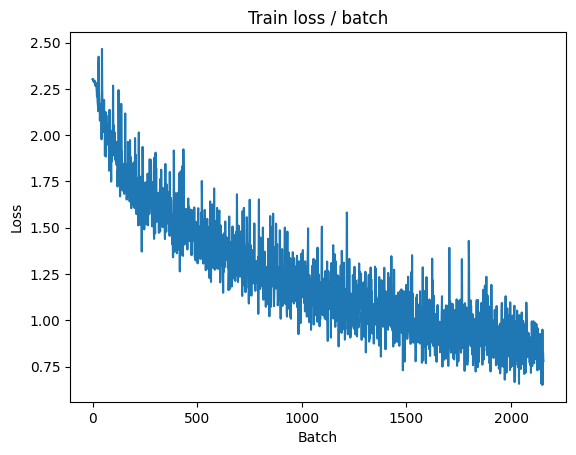


===============> Total time 22s	Avg loss 0.8544	Avg Prec@1 70.17 %	Avg Prec@5 97.71 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.7707 (0.7707)	Prec@1  72.7 ( 72.7)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.8120	Avg Prec@1 72.15 %	Avg Prec@5 97.92 %



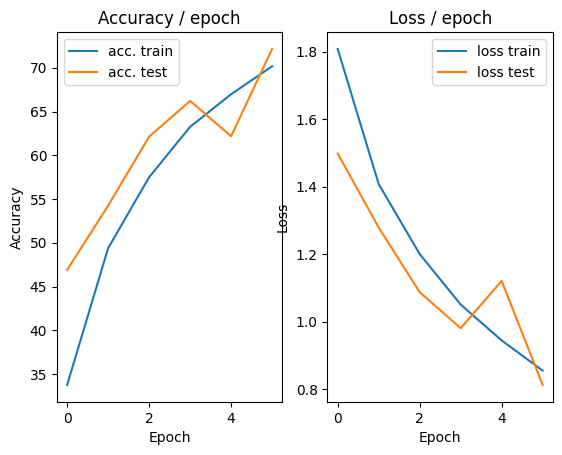

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 0.6302 (0.6302)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


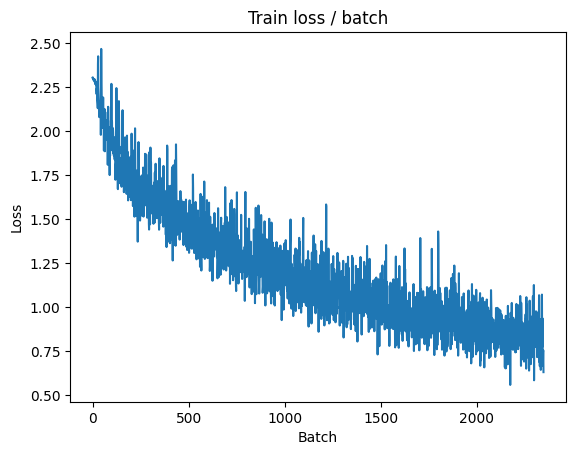

[TRAIN Batch 200/391]	Time 0.056s (0.057s)	Loss 0.7163 (0.7881)	Prec@1  78.1 ( 72.5)	Prec@5  97.7 ( 98.2)


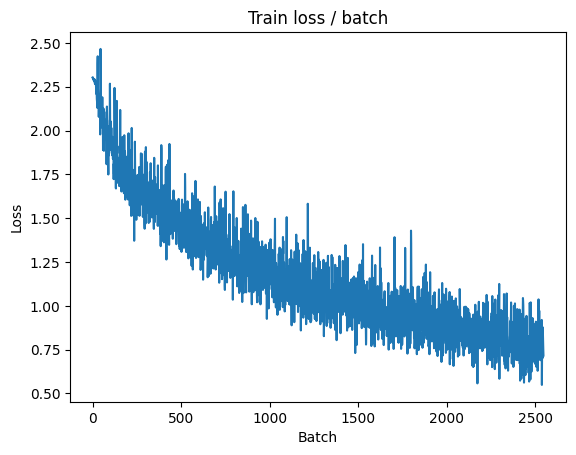


===============> Total time 22s	Avg loss 0.7825	Avg Prec@1 72.77 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.7231 (0.7231)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7762	Avg Prec@1 73.23 %	Avg Prec@5 98.02 %



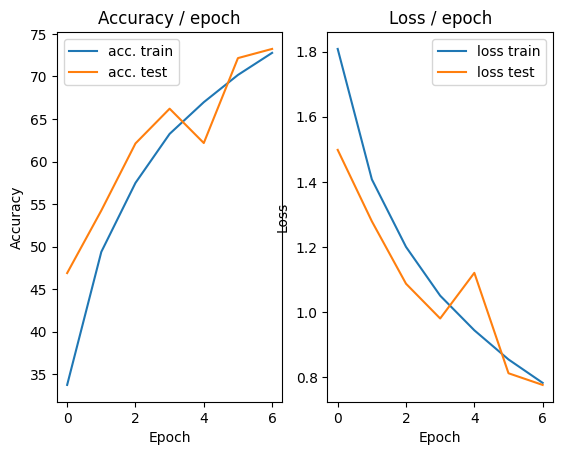

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.6696 (0.6696)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)


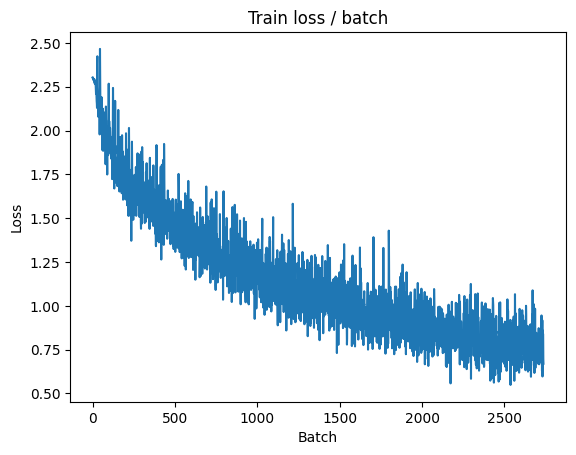

[TRAIN Batch 200/391]	Time 0.055s (0.057s)	Loss 0.6443 (0.7334)	Prec@1  78.9 ( 74.3)	Prec@5  99.2 ( 98.3)


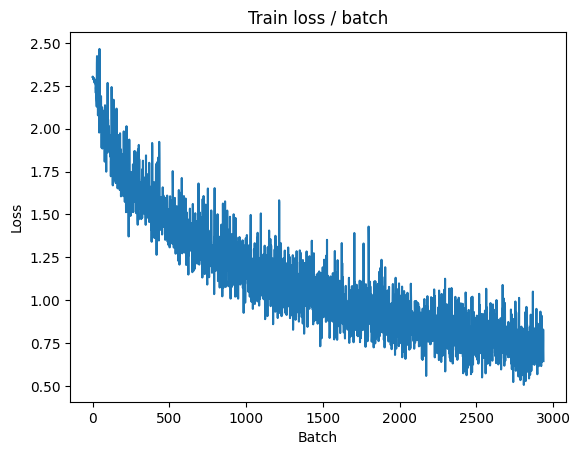


===============> Total time 22s	Avg loss 0.7310	Avg Prec@1 74.47 %	Avg Prec@5 98.28 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.7236 (0.7236)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7854	Avg Prec@1 73.38 %	Avg Prec@5 98.20 %



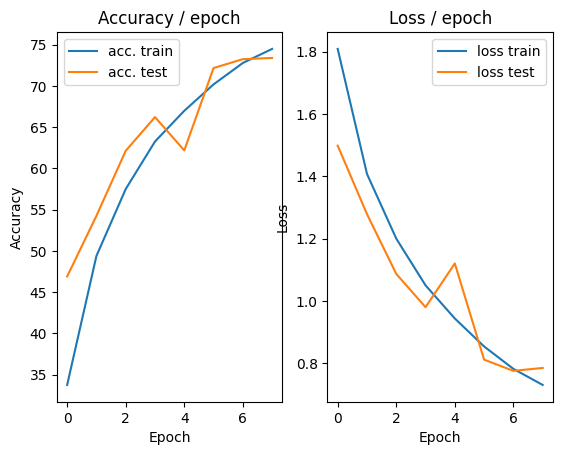

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.7027 (0.7027)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


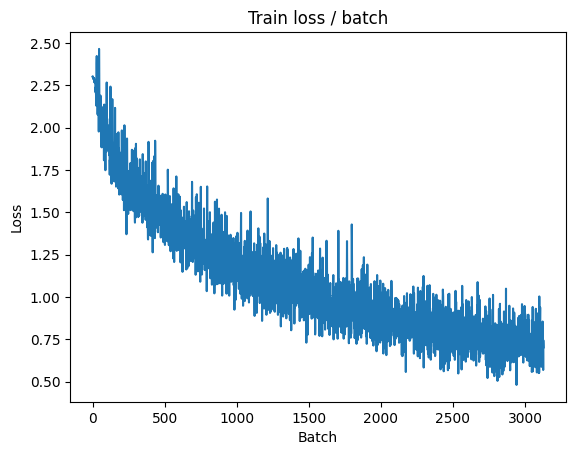

[TRAIN Batch 200/391]	Time 0.056s (0.061s)	Loss 0.5410 (0.6861)	Prec@1  83.6 ( 76.2)	Prec@5  99.2 ( 98.6)


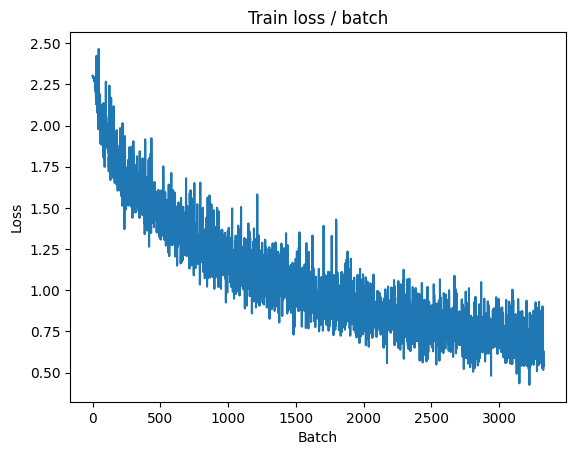


===============> Total time 23s	Avg loss 0.6888	Avg Prec@1 75.93 %	Avg Prec@5 98.55 %

[EVAL Batch 000/079]	Time 0.280s (0.280s)	Loss 0.7847 (0.7847)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7448	Avg Prec@1 74.49 %	Avg Prec@5 97.98 %



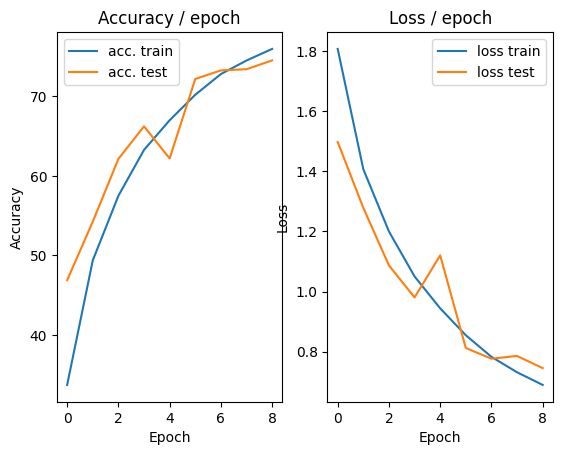

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.6759 (0.6759)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


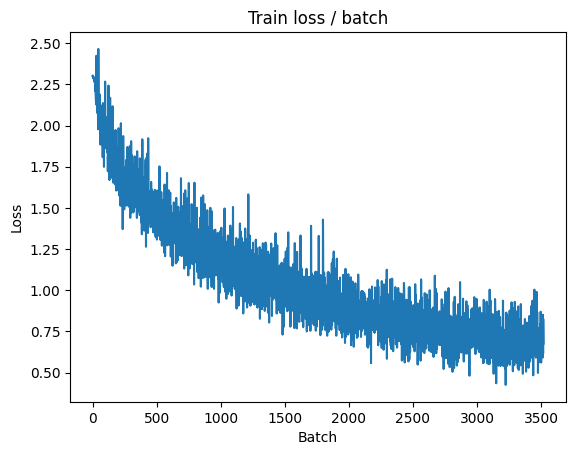

[TRAIN Batch 200/391]	Time 0.054s (0.058s)	Loss 0.7149 (0.6486)	Prec@1  77.3 ( 77.5)	Prec@5  96.9 ( 98.6)


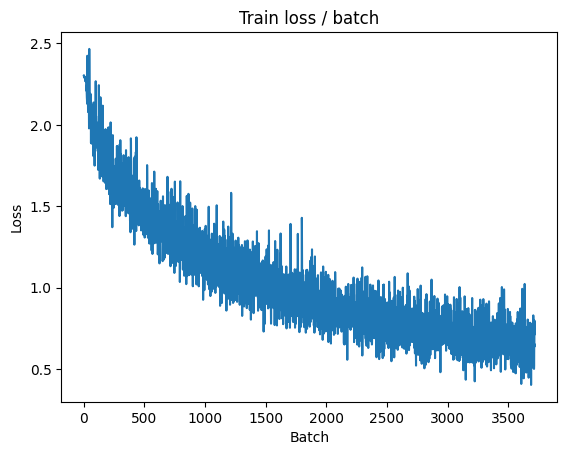


===============> Total time 22s	Avg loss 0.6458	Avg Prec@1 77.48 %	Avg Prec@5 98.65 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.6778 (0.6778)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7390	Avg Prec@1 74.62 %	Avg Prec@5 98.10 %



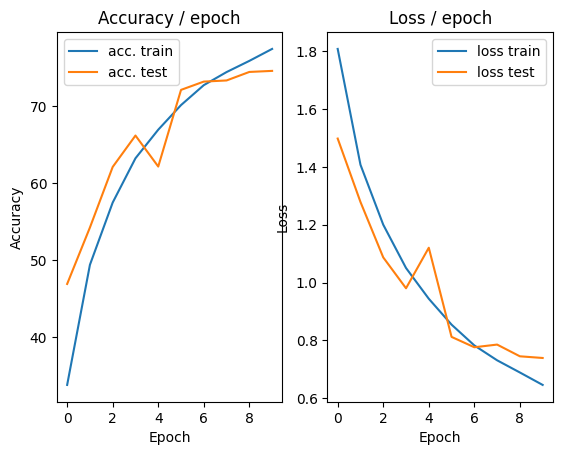

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.8158 (0.8158)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)


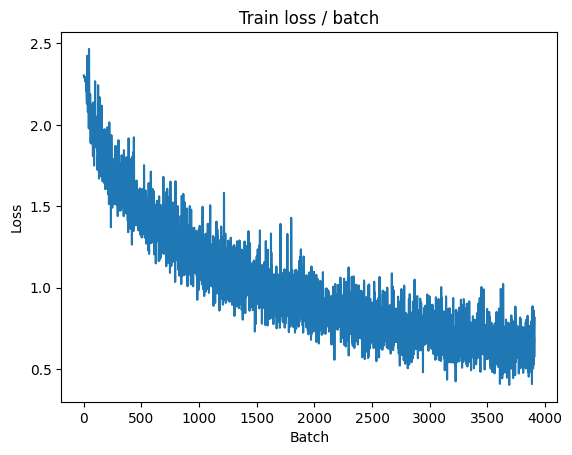

[TRAIN Batch 200/391]	Time 0.055s (0.059s)	Loss 0.5666 (0.5994)	Prec@1  81.2 ( 79.1)	Prec@5  98.4 ( 98.9)


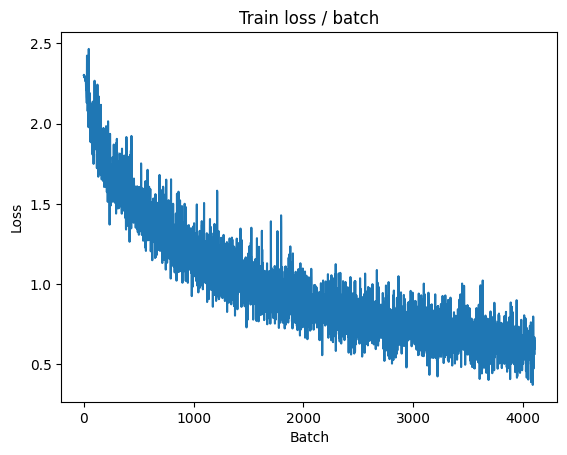


===============> Total time 22s	Avg loss 0.6067	Avg Prec@1 78.75 %	Avg Prec@5 98.89 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 0.6150 (0.6150)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6787	Avg Prec@1 76.78 %	Avg Prec@5 98.33 %



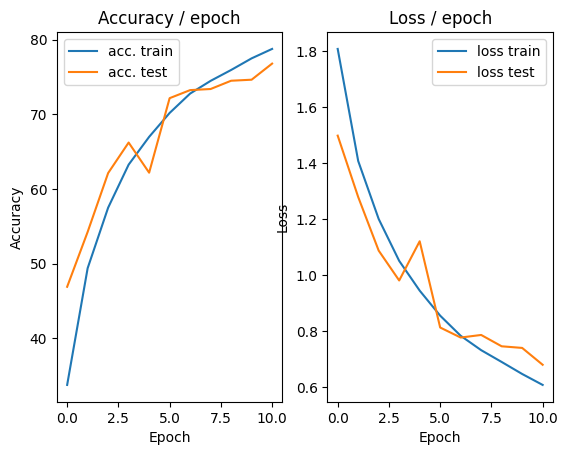

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.5293 (0.5293)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)


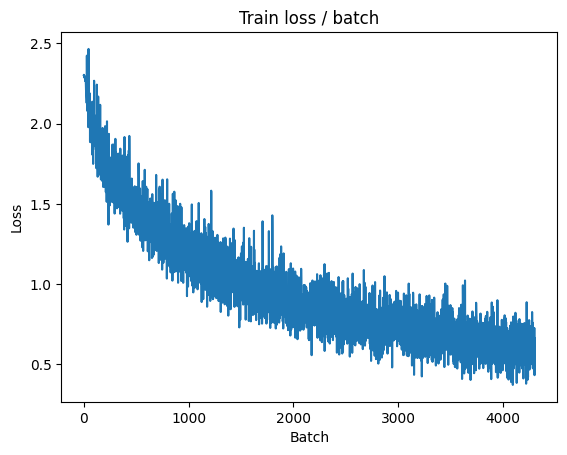

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.6632 (0.5784)	Prec@1  77.3 ( 79.8)	Prec@5  99.2 ( 98.9)


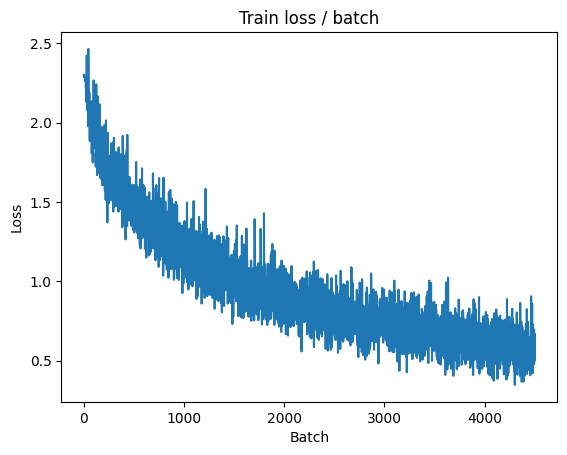


===============> Total time 21s	Avg loss 0.5732	Avg Prec@1 79.99 %	Avg Prec@5 98.99 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.6639 (0.6639)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6488	Avg Prec@1 77.72 %	Avg Prec@5 98.63 %



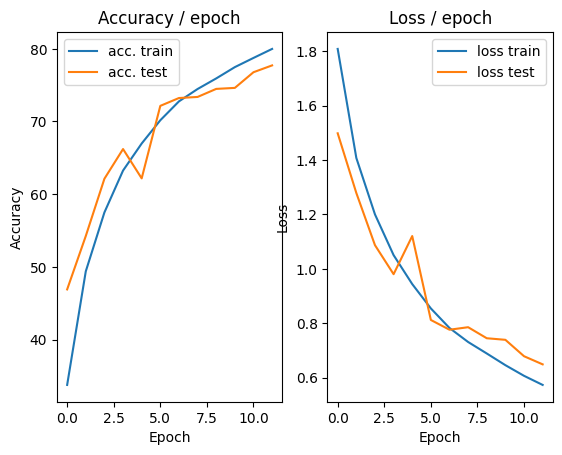

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 0.5748 (0.5748)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


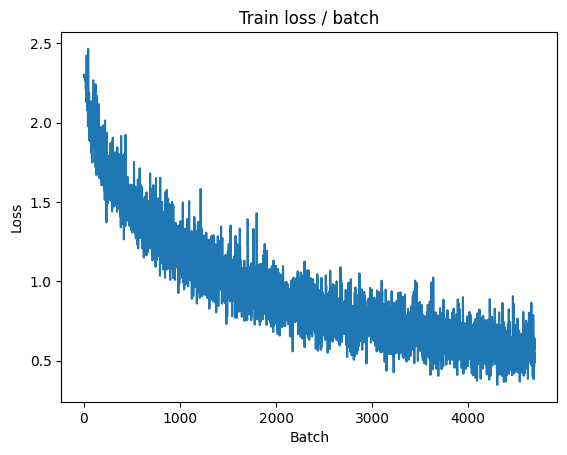

[TRAIN Batch 200/391]	Time 0.059s (0.057s)	Loss 0.6368 (0.5385)	Prec@1  77.3 ( 81.1)	Prec@5 100.0 ( 99.1)


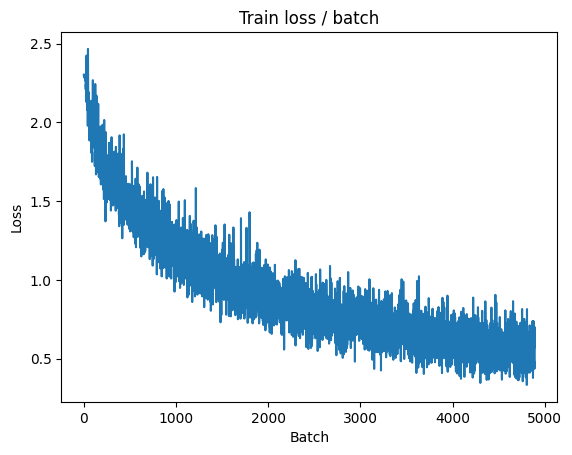


===============> Total time 22s	Avg loss 0.5465	Avg Prec@1 80.90 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.6283 (0.6283)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6653	Avg Prec@1 77.58 %	Avg Prec@5 98.53 %



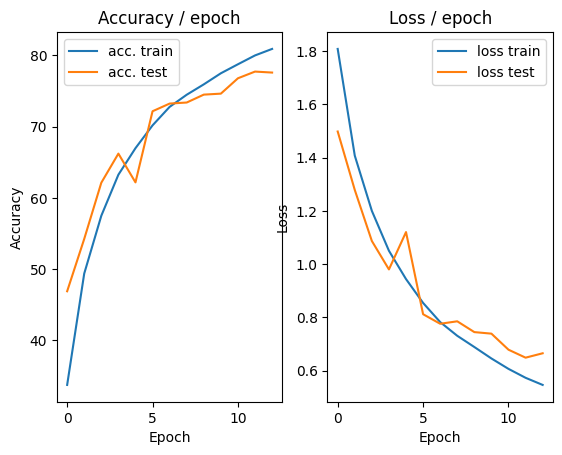

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.4438 (0.4438)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


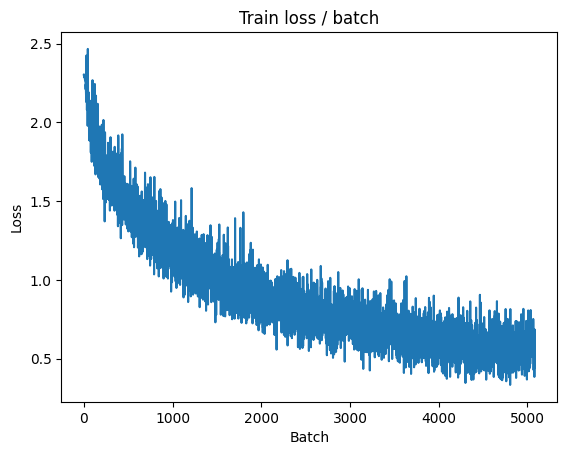

[TRAIN Batch 200/391]	Time 0.055s (0.058s)	Loss 0.4810 (0.5117)	Prec@1  80.5 ( 81.9)	Prec@5  99.2 ( 99.3)


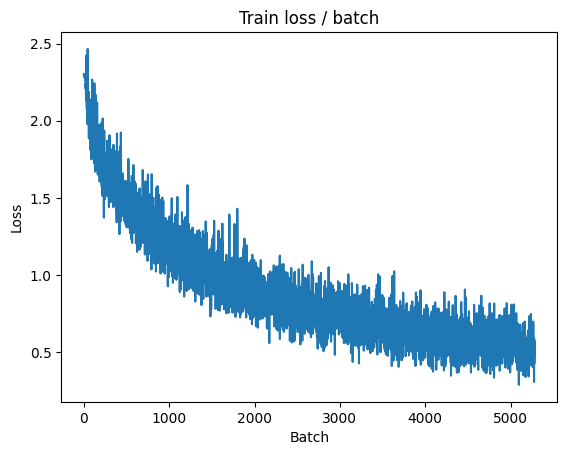


===============> Total time 22s	Avg loss 0.5207	Avg Prec@1 81.76 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 0.7147 (0.7147)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7014	Avg Prec@1 76.91 %	Avg Prec@5 98.51 %



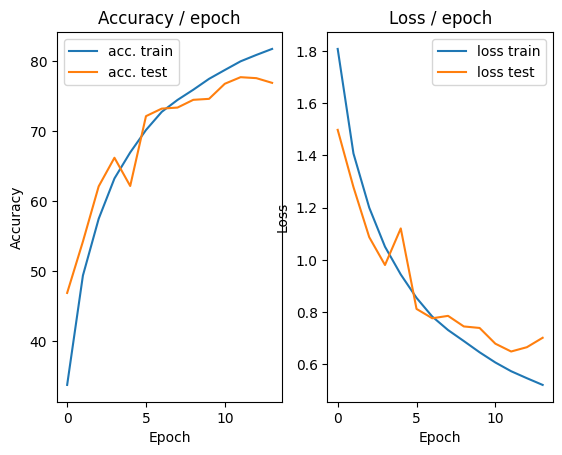

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.7773 (0.7773)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)


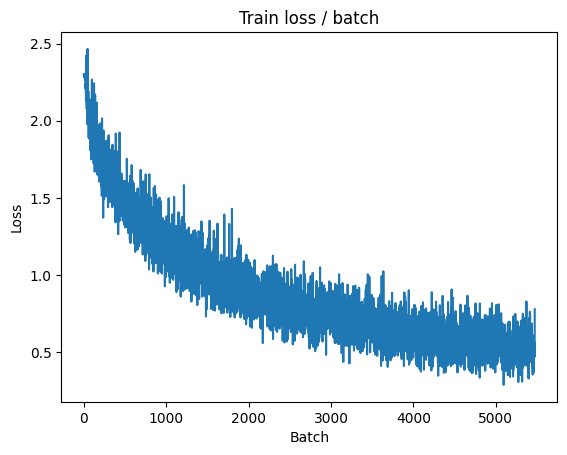

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.6316 (0.4899)	Prec@1  78.1 ( 82.7)	Prec@5  96.9 ( 99.3)


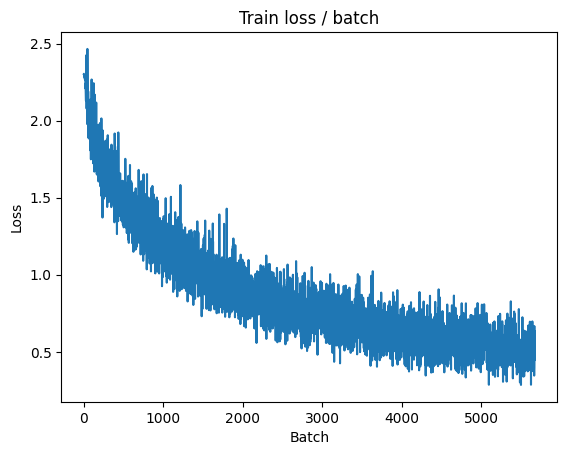


===============> Total time 21s	Avg loss 0.4930	Avg Prec@1 82.74 %	Avg Prec@5 99.32 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 0.7161 (0.7161)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6783	Avg Prec@1 77.57 %	Avg Prec@5 98.29 %



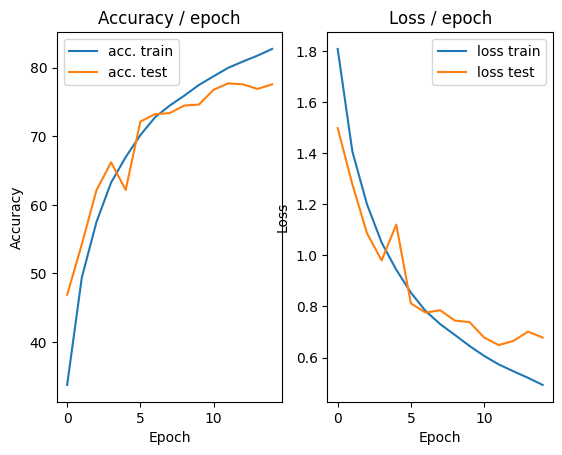

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 0.5213 (0.5213)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


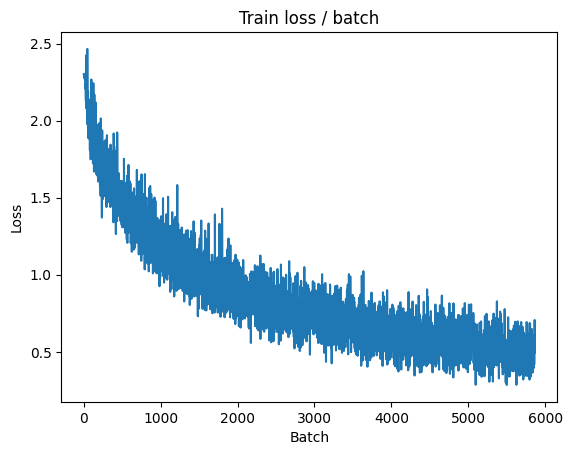

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.6138 (0.4639)	Prec@1  78.9 ( 83.7)	Prec@5  97.7 ( 99.4)


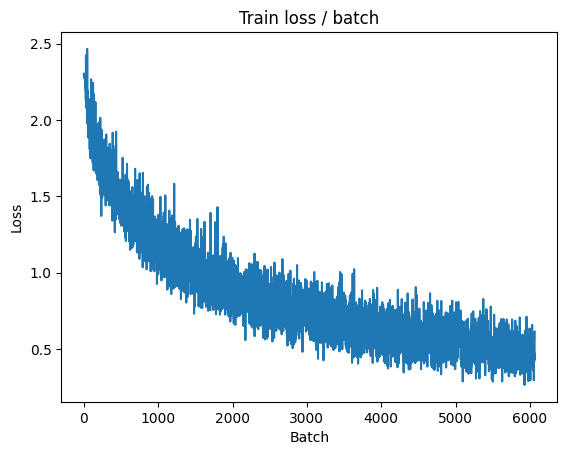


===============> Total time 21s	Avg loss 0.4675	Avg Prec@1 83.55 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.6491 (0.6491)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6621	Avg Prec@1 78.19 %	Avg Prec@5 98.66 %



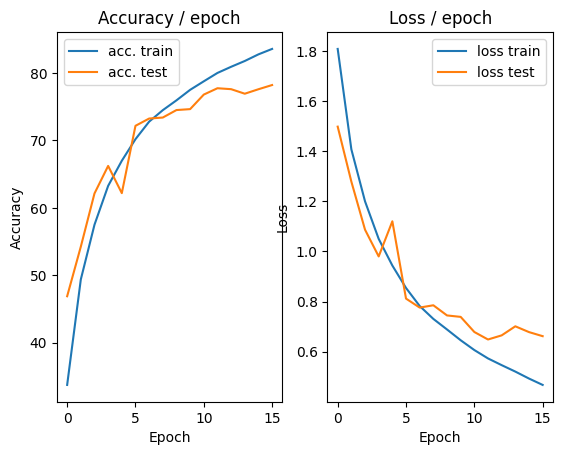

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.3965 (0.3965)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


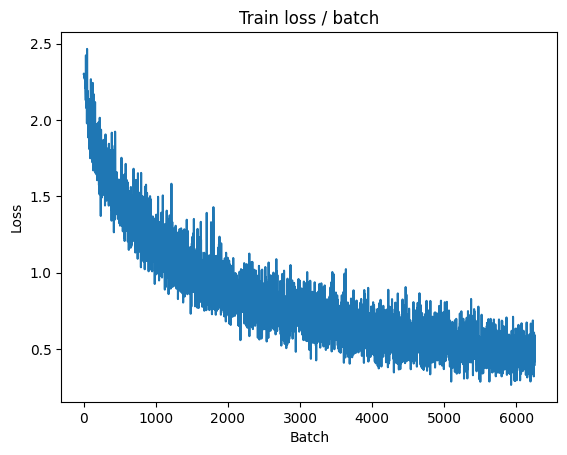

[TRAIN Batch 200/391]	Time 0.056s (0.057s)	Loss 0.4330 (0.4231)	Prec@1  82.0 ( 85.1)	Prec@5  99.2 ( 99.6)


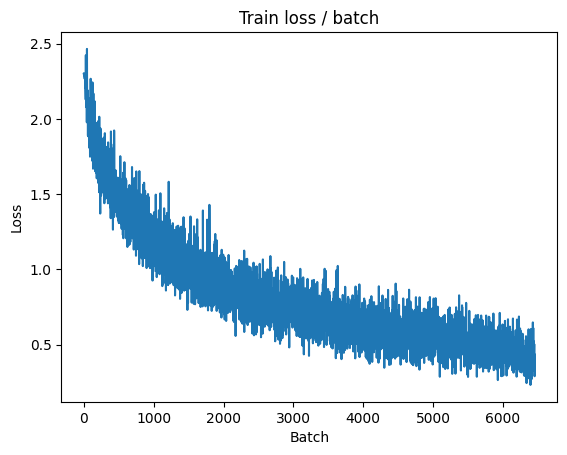


===============> Total time 22s	Avg loss 0.4408	Avg Prec@1 84.56 %	Avg Prec@5 99.46 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.6825 (0.6825)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6932	Avg Prec@1 77.62 %	Avg Prec@5 98.58 %



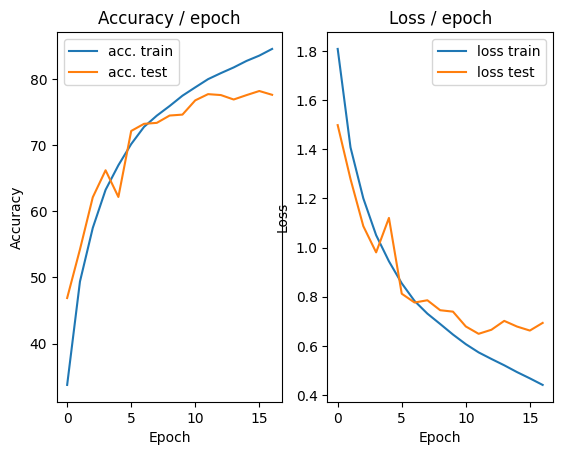

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.4249 (0.4249)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


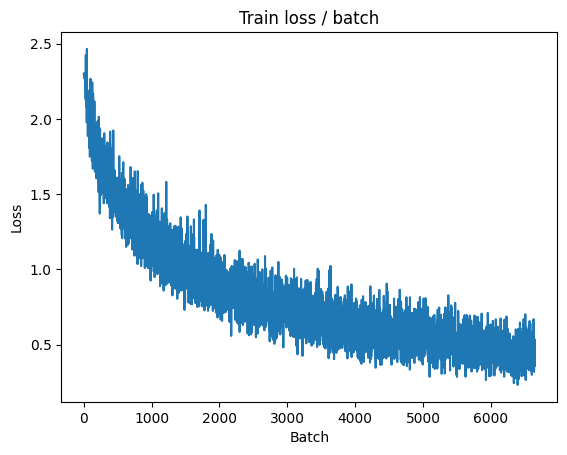

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.4734 (0.4120)	Prec@1  82.8 ( 85.4)	Prec@5  99.2 ( 99.6)


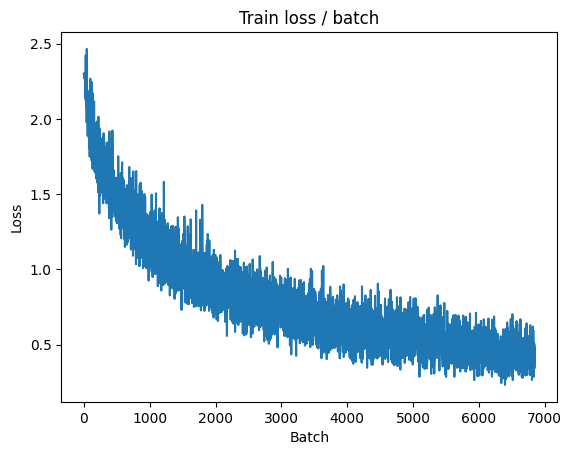


===============> Total time 22s	Avg loss 0.4249	Avg Prec@1 85.07 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 0.7334 (0.7334)	Prec@1  79.7 ( 79.7)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.6696	Avg Prec@1 77.85 %	Avg Prec@5 98.54 %



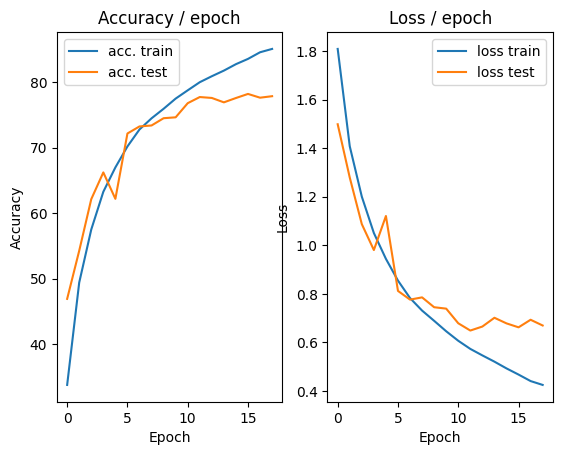

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.5268 (0.5268)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


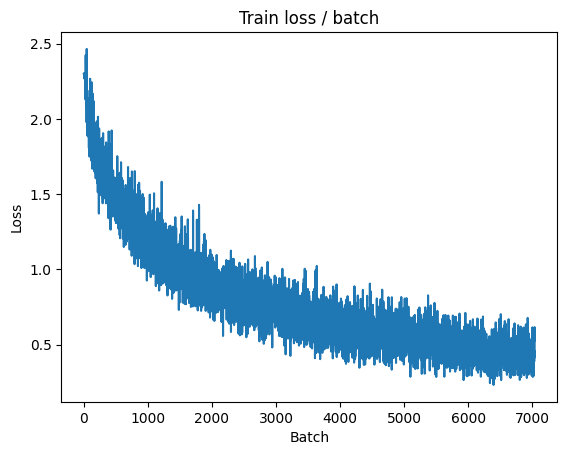

[TRAIN Batch 200/391]	Time 0.052s (0.057s)	Loss 0.2625 (0.4007)	Prec@1  90.6 ( 86.0)	Prec@5 100.0 ( 99.6)


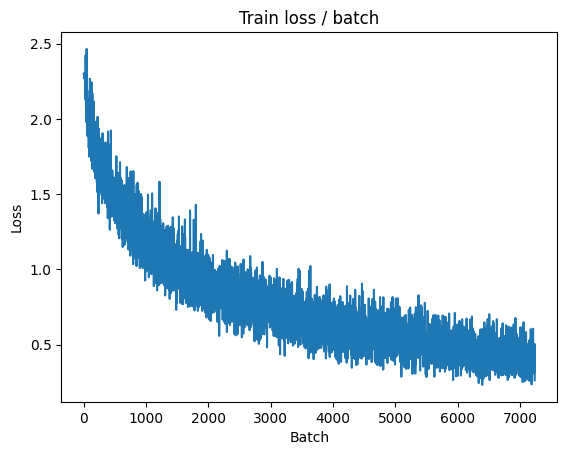


===============> Total time 22s	Avg loss 0.4082	Avg Prec@1 85.73 %	Avg Prec@5 99.56 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.6623 (0.6623)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6346	Avg Prec@1 79.45 %	Avg Prec@5 98.88 %



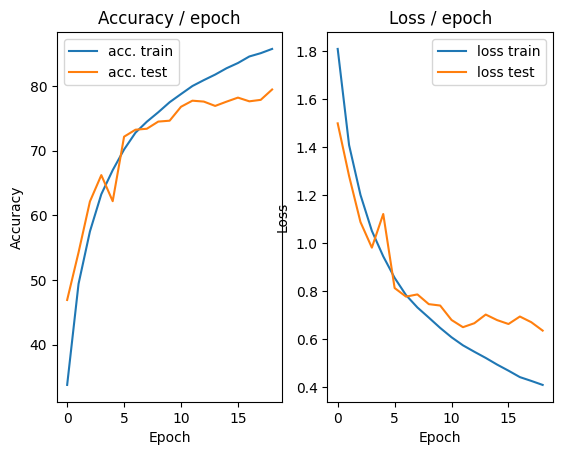

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 0.4323 (0.4323)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


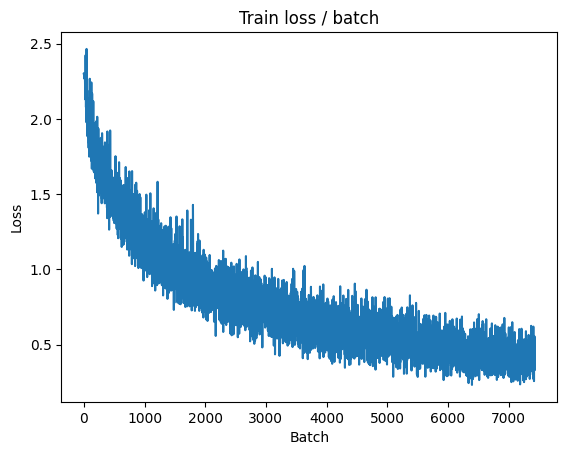

[TRAIN Batch 200/391]	Time 0.050s (0.057s)	Loss 0.4100 (0.3906)	Prec@1  85.2 ( 86.3)	Prec@5  99.2 ( 99.6)


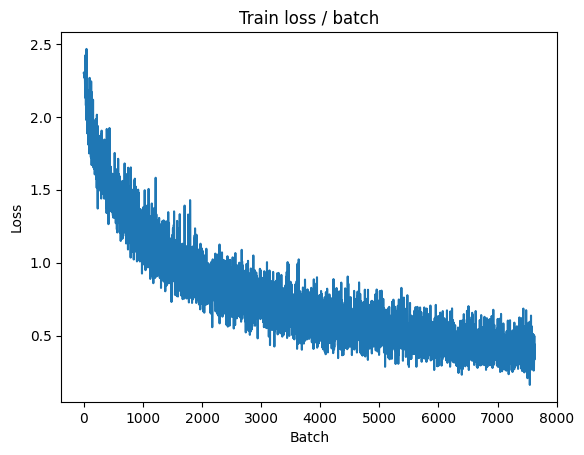


===============> Total time 22s	Avg loss 0.3943	Avg Prec@1 86.23 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.6060 (0.6060)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6370	Avg Prec@1 79.70 %	Avg Prec@5 98.51 %



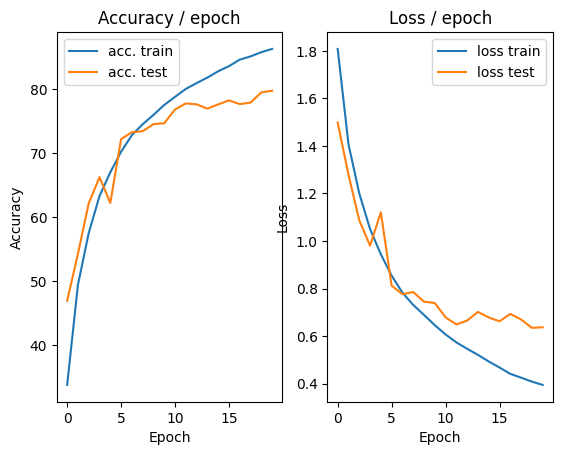

In [19]:
main(batch_size, lr, epochs, cuda=True)

**Question 25** [**Bonus**] : Other data augmentation methods are possible. Find out which ones and test some.


In [20]:
def get_dataset(batch_size, cuda=False, download=False):
    """
    Load CIFAR-10 dataset and apply data augmentation to training data.
    """
    # Define data augmentation and normalization for training set
    train_transform = transforms.Compose([
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),  # Color jitter
        transforms.RandomRotation(15),  # Random rotation within ±15 degrees
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.4914, 0.4822, 0.4465], std=[0.247, 0.243, 0.261])  # Normalize
    ])
    
    # Define transformations for test set (no data augmentation, only normalization)
    test_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.4914, 0.4822, 0.4465], std=[0.247, 0.243, 0.261])
    ])

    # Load datasets with the specified transformations
    train_dataset = datasets.CIFAR10(PATH, train=True, download=download, transform=train_transform)
    val_dataset = datasets.CIFAR10(PATH, train=False, download=download, transform=test_transform)

    train_loader = torch.utils.data.DataLoader(train_dataset,
                                               batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                                             batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 2.3039 (2.3039)	Prec@1  11.7 ( 11.7)	Prec@5  49.2 ( 49.2)


<Figure size 640x480 with 0 Axes>

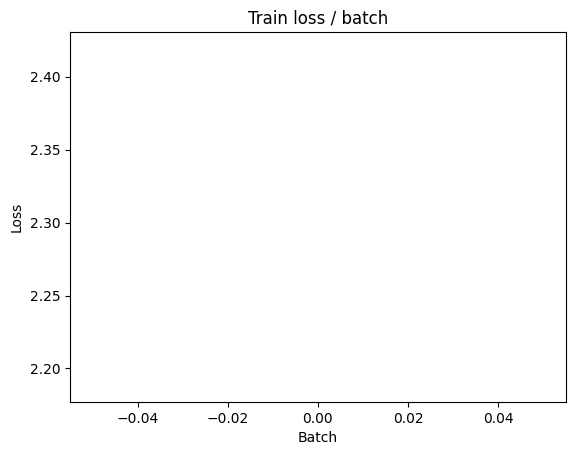

[TRAIN Batch 200/391]	Time 0.062s (0.089s)	Loss 1.9950 (1.9839)	Prec@1  36.7 ( 27.6)	Prec@5  82.0 ( 78.3)


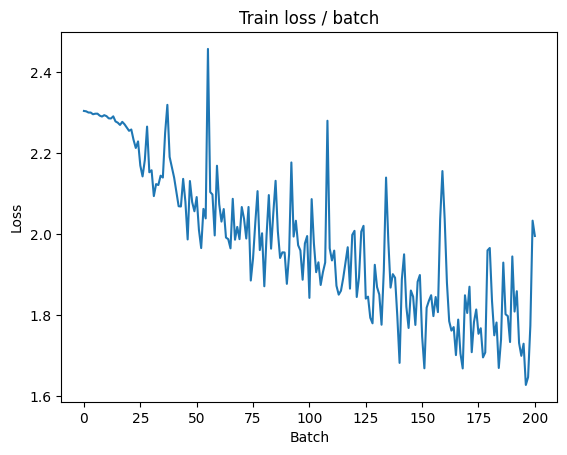


===============> Total time 33s	Avg loss 1.8313	Avg Prec@1 33.66 %	Avg Prec@5 83.34 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 1.4900 (1.4900)	Prec@1  52.3 ( 52.3)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.5358	Avg Prec@1 45.32 %	Avg Prec@5 91.92 %



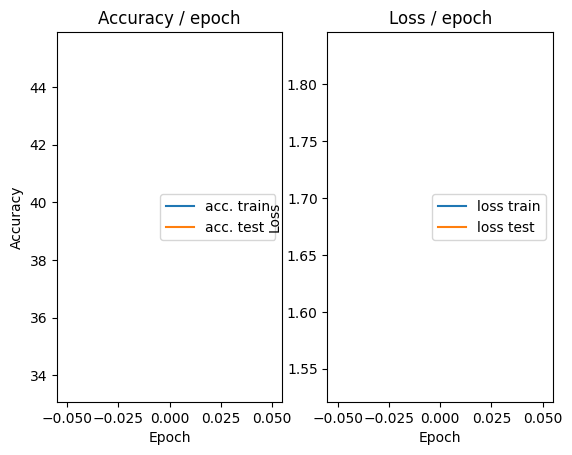

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 1.6966 (1.6966)	Prec@1  39.1 ( 39.1)	Prec@5  82.0 ( 82.0)


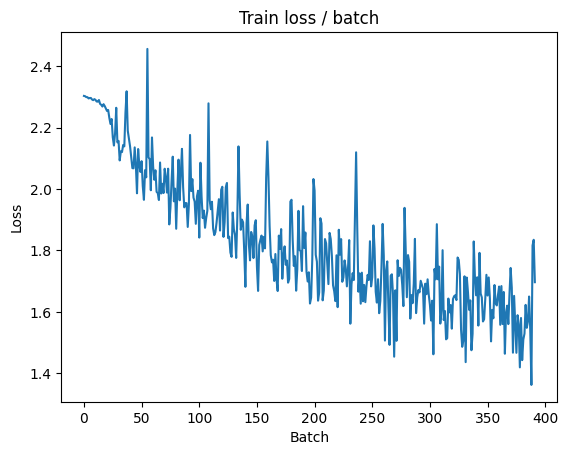

[TRAIN Batch 200/391]	Time 0.062s (0.088s)	Loss 1.3456 (1.5021)	Prec@1  49.2 ( 46.4)	Prec@5  92.2 ( 91.6)


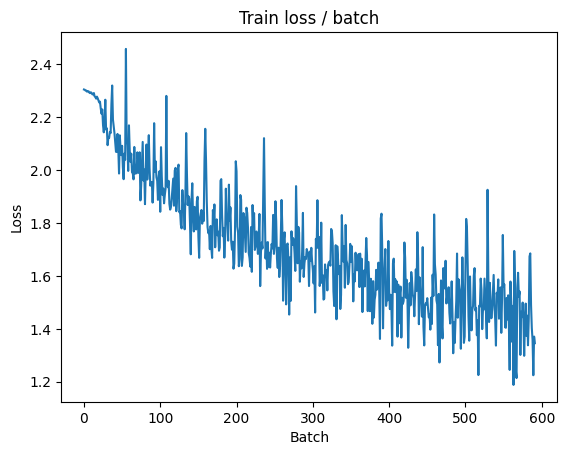


===============> Total time 33s	Avg loss 1.4414	Avg Prec@1 48.68 %	Avg Prec@5 92.50 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.2707 (1.2707)	Prec@1  54.7 ( 54.7)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.3793	Avg Prec@1 51.18 %	Avg Prec@5 94.09 %



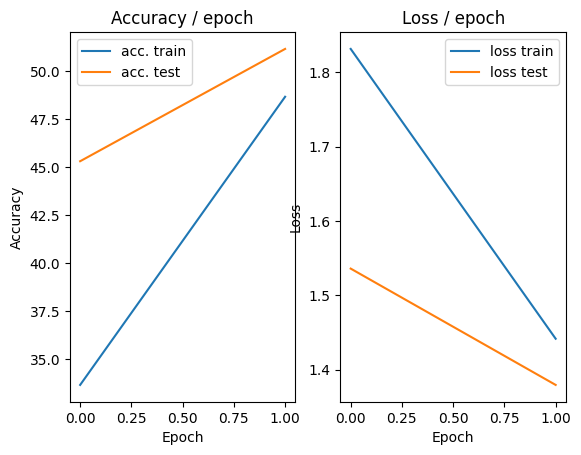

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 1.3056 (1.3056)	Prec@1  53.1 ( 53.1)	Prec@5  94.5 ( 94.5)


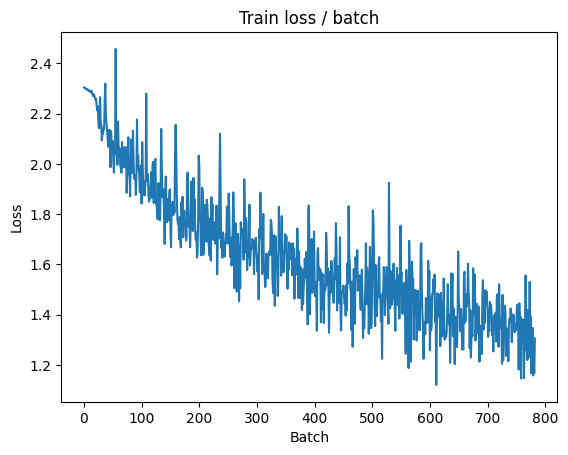

[TRAIN Batch 200/391]	Time 0.061s (0.089s)	Loss 1.1557 (1.2827)	Prec@1  58.6 ( 54.5)	Prec@5  96.1 ( 94.4)


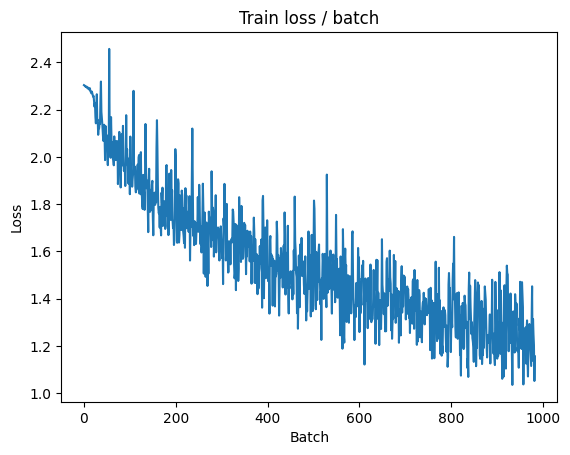


===============> Total time 35s	Avg loss 1.2426	Avg Prec@1 56.15 %	Avg Prec@5 94.74 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 1.0439 (1.0439)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1712	Avg Prec@1 58.56 %	Avg Prec@5 95.60 %



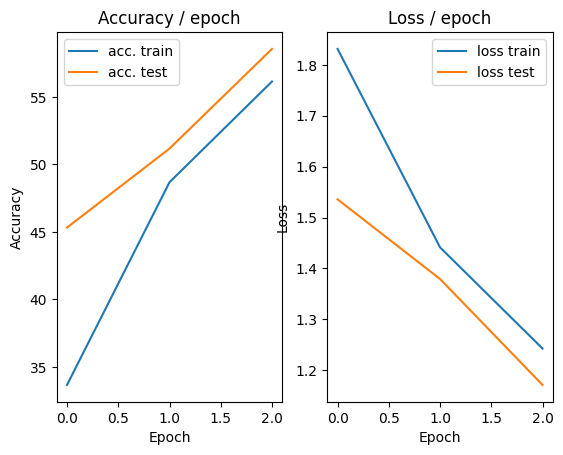

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 1.1770 (1.1770)	Prec@1  60.9 ( 60.9)	Prec@5  94.5 ( 94.5)


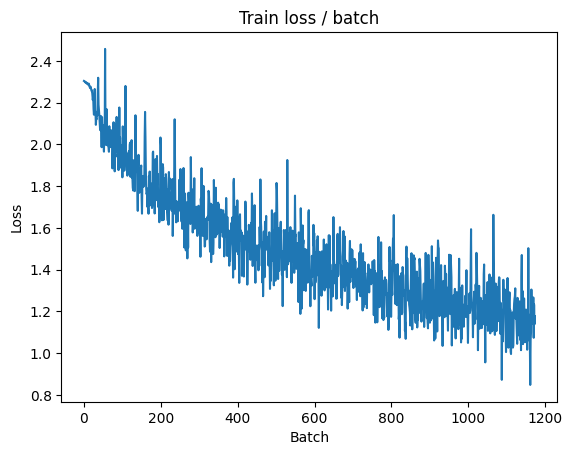

[TRAIN Batch 200/391]	Time 0.093s (0.090s)	Loss 1.1290 (1.1185)	Prec@1  63.3 ( 60.8)	Prec@5  97.7 ( 95.8)


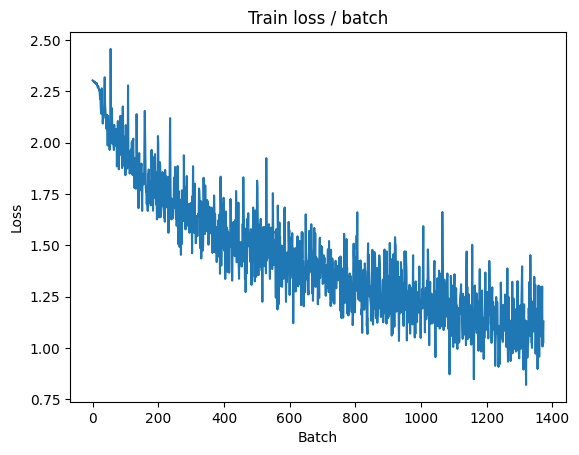


===============> Total time 33s	Avg loss 1.0976	Avg Prec@1 61.39 %	Avg Prec@5 96.04 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 0.8862 (0.8862)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9576	Avg Prec@1 66.35 %	Avg Prec@5 97.01 %



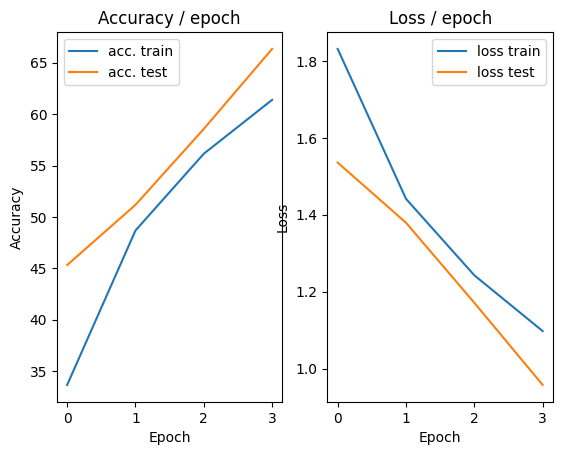

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 1.1323 (1.1323)	Prec@1  60.9 ( 60.9)	Prec@5  96.9 ( 96.9)


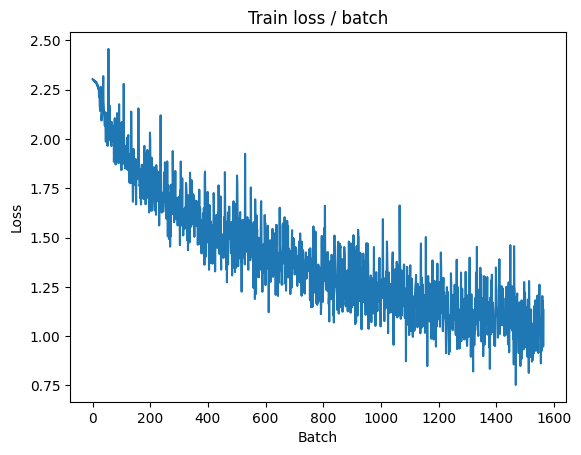

[TRAIN Batch 200/391]	Time 0.078s (0.083s)	Loss 0.8743 (0.9895)	Prec@1  63.3 ( 65.3)	Prec@5  97.7 ( 96.9)


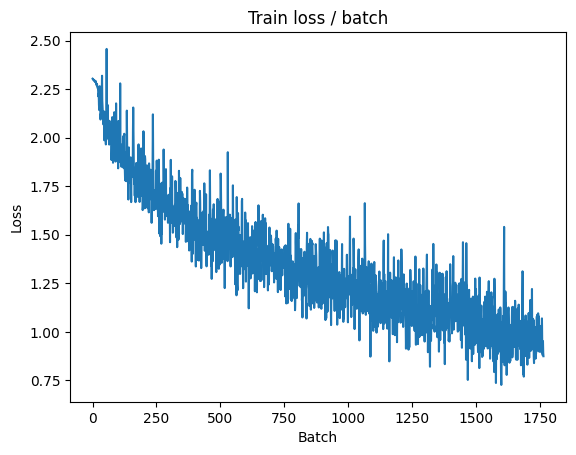


===============> Total time 32s	Avg loss 0.9757	Avg Prec@1 65.86 %	Avg Prec@5 96.90 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.9414 (0.9414)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9962	Avg Prec@1 64.76 %	Avg Prec@5 96.67 %



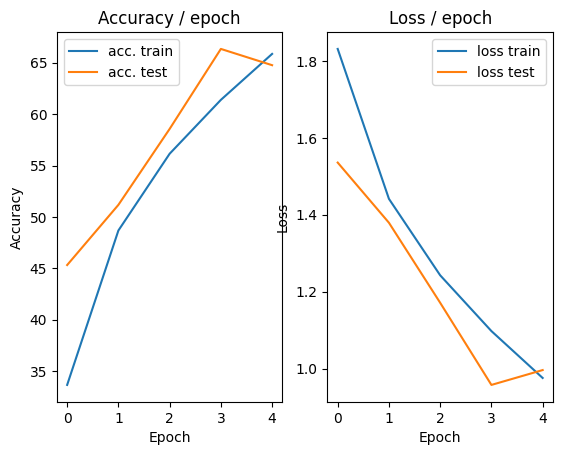

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.309s (0.309s)	Loss 0.8792 (0.8792)	Prec@1  66.4 ( 66.4)	Prec@5  99.2 ( 99.2)


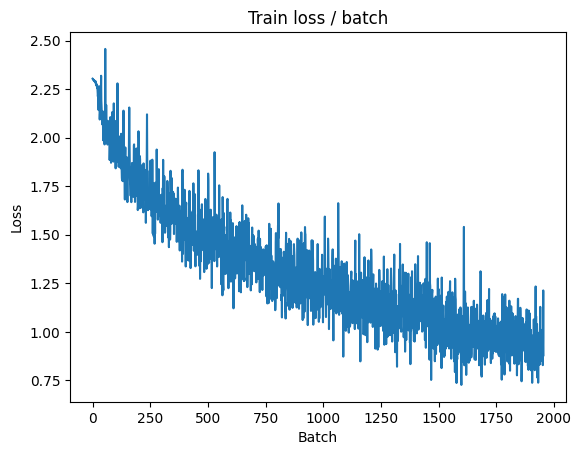

[TRAIN Batch 200/391]	Time 0.061s (0.081s)	Loss 0.7258 (0.8988)	Prec@1  74.2 ( 68.6)	Prec@5  99.2 ( 97.4)


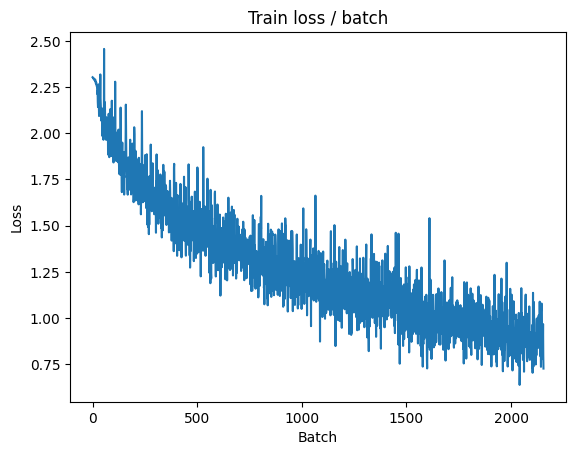


===============> Total time 32s	Avg loss 0.8856	Avg Prec@1 69.17 %	Avg Prec@5 97.49 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.1057 (1.1057)	Prec@1  58.6 ( 58.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0652	Avg Prec@1 63.33 %	Avg Prec@5 96.15 %



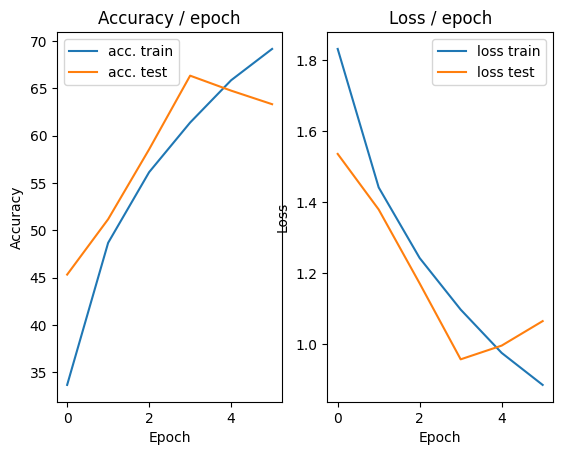

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 1.0036 (1.0036)	Prec@1  65.6 ( 65.6)	Prec@5  95.3 ( 95.3)


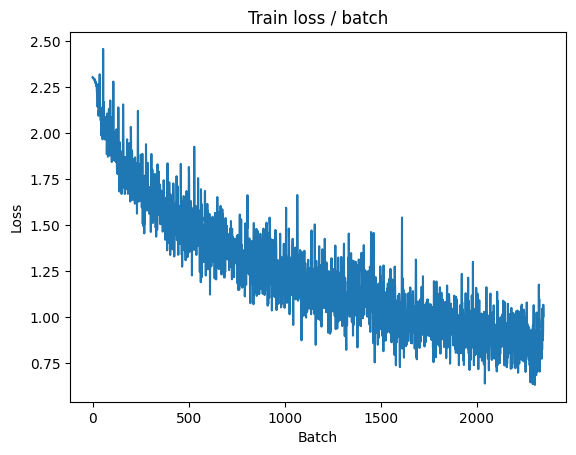

[TRAIN Batch 200/391]	Time 0.099s (0.084s)	Loss 0.7739 (0.8066)	Prec@1  75.0 ( 72.0)	Prec@5  95.3 ( 98.0)


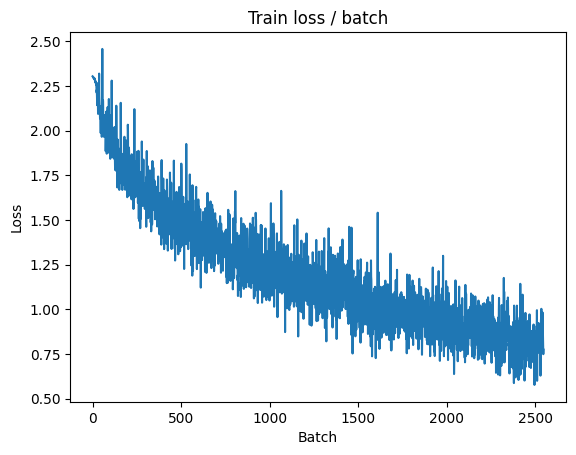


===============> Total time 34s	Avg loss 0.8040	Avg Prec@1 72.08 %	Avg Prec@5 98.02 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 0.7671 (0.7671)	Prec@1  75.8 ( 75.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8007	Avg Prec@1 72.35 %	Avg Prec@5 97.75 %



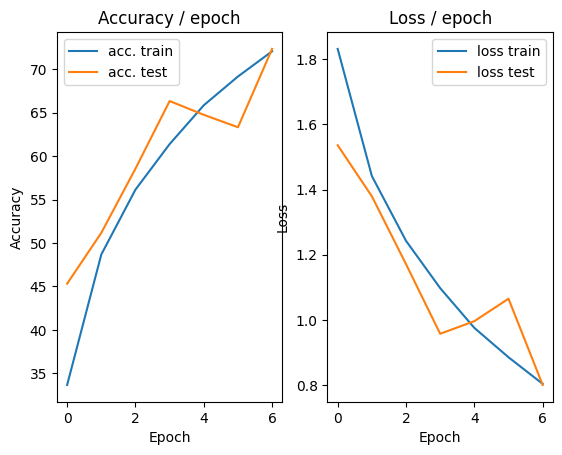

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.7577 (0.7577)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)


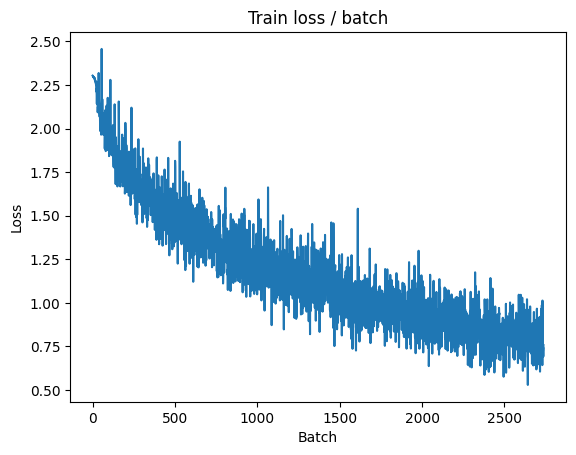

[TRAIN Batch 200/391]	Time 0.057s (0.087s)	Loss 0.6951 (0.7307)	Prec@1  75.0 ( 74.7)	Prec@5 100.0 ( 98.5)


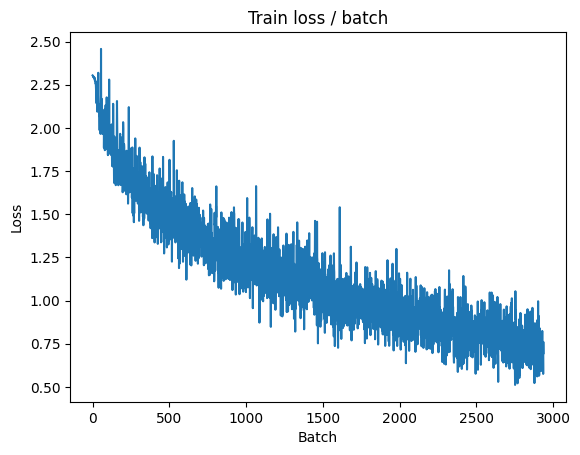


===============> Total time 33s	Avg loss 0.7356	Avg Prec@1 74.42 %	Avg Prec@5 98.44 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 0.8499 (0.8499)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8449	Avg Prec@1 71.52 %	Avg Prec@5 97.56 %



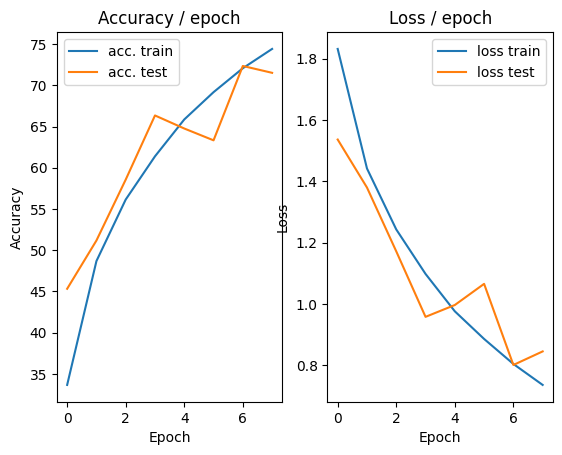

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.7362 (0.7362)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)


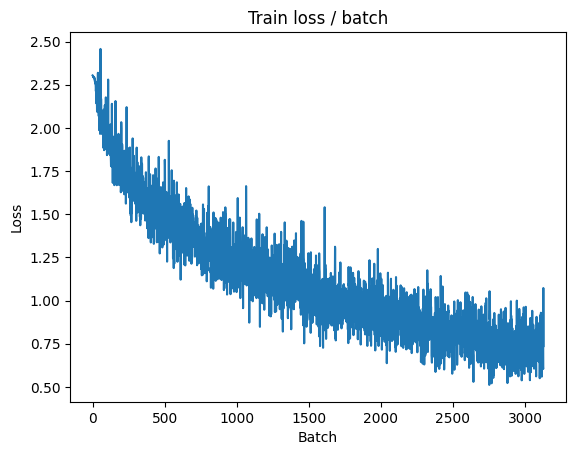

[TRAIN Batch 200/391]	Time 0.137s (0.090s)	Loss 0.7406 (0.6731)	Prec@1  75.0 ( 76.4)	Prec@5  99.2 ( 98.7)


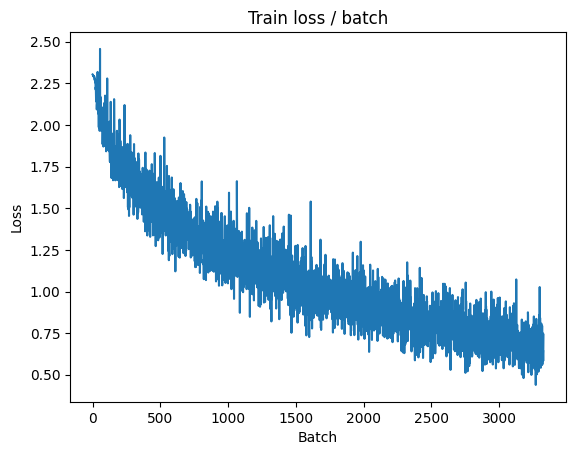


===============> Total time 34s	Avg loss 0.6810	Avg Prec@1 76.09 %	Avg Prec@5 98.64 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 0.8888 (0.8888)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9023	Avg Prec@1 70.25 %	Avg Prec@5 97.31 %



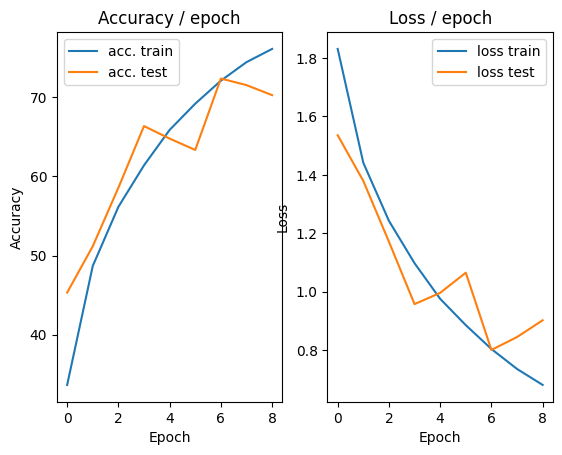

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.323s (0.323s)	Loss 0.7728 (0.7728)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


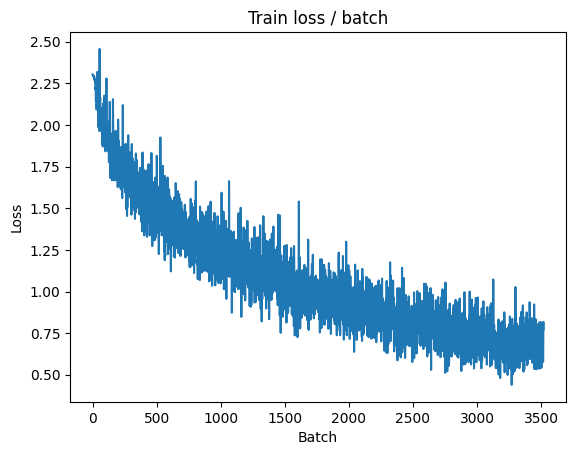

[TRAIN Batch 200/391]	Time 0.194s (0.091s)	Loss 0.7117 (0.6123)	Prec@1  76.6 ( 78.8)	Prec@5  96.9 ( 98.8)


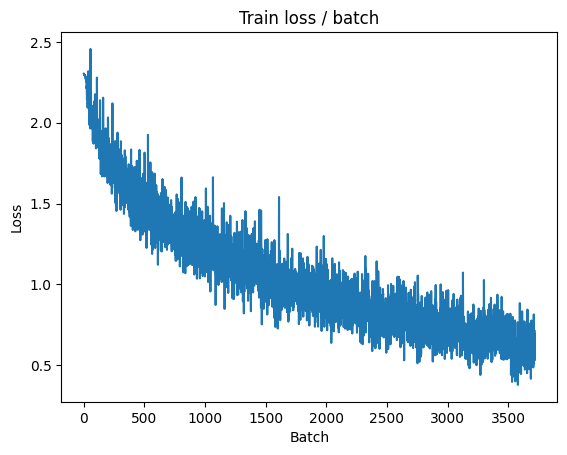


===============> Total time 35s	Avg loss 0.6245	Avg Prec@1 78.44 %	Avg Prec@5 98.85 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.8593 (0.8593)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8036	Avg Prec@1 73.00 %	Avg Prec@5 97.88 %



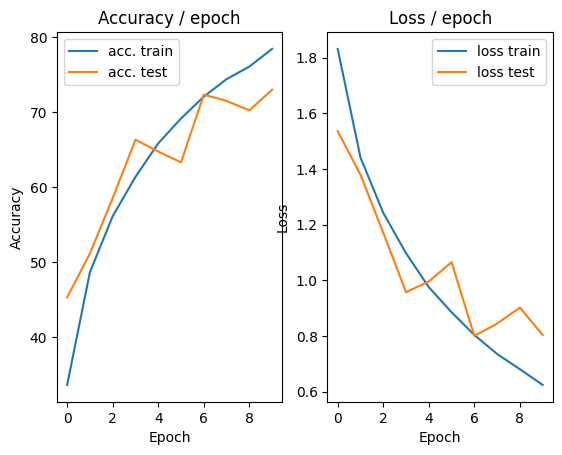

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.288s (0.288s)	Loss 0.3905 (0.3905)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


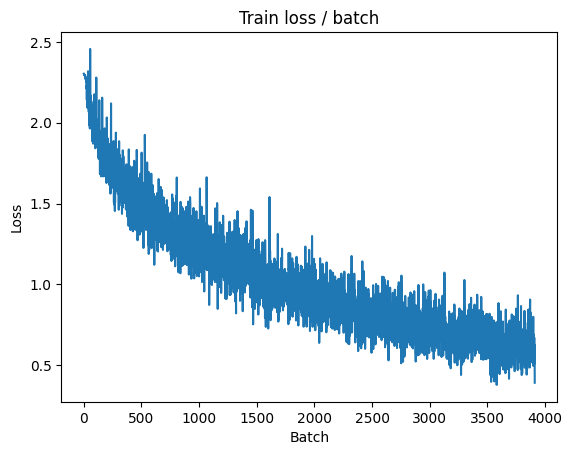

[TRAIN Batch 200/391]	Time 0.059s (0.094s)	Loss 0.6372 (0.5578)	Prec@1  75.8 ( 80.7)	Prec@5  99.2 ( 99.2)


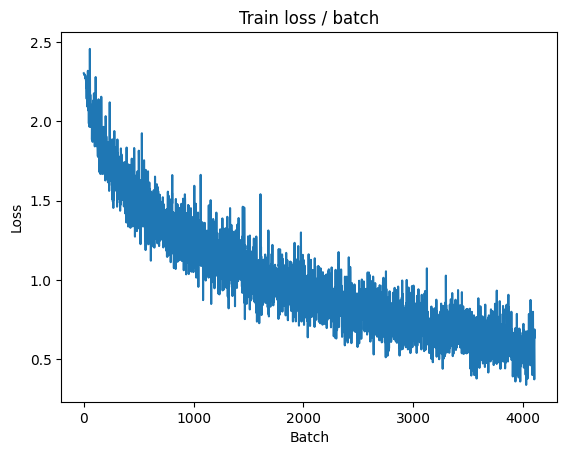


===============> Total time 35s	Avg loss 0.5718	Avg Prec@1 80.11 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.8118 (0.8118)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7968	Avg Prec@1 74.03 %	Avg Prec@5 97.99 %



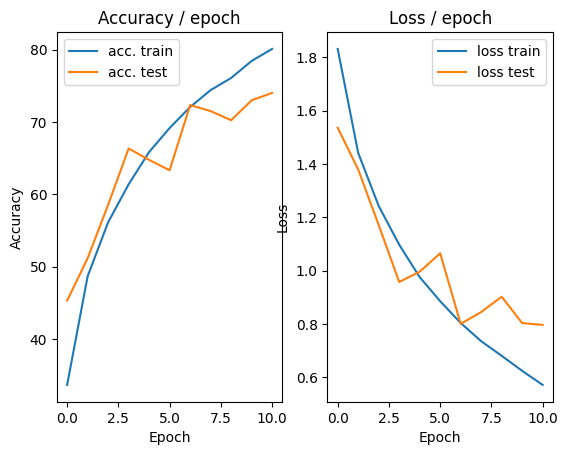

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.306s (0.306s)	Loss 0.4027 (0.4027)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


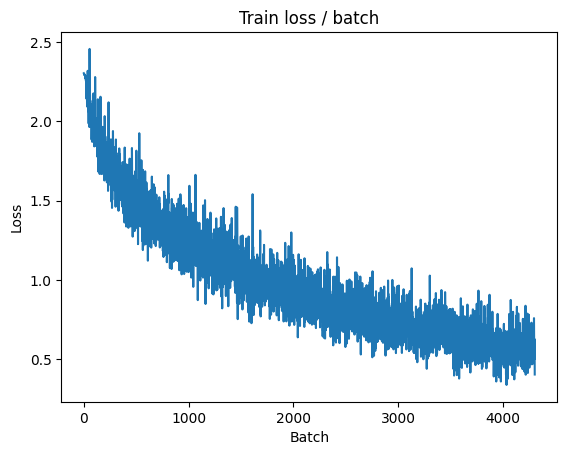

[TRAIN Batch 200/391]	Time 0.102s (0.087s)	Loss 0.6021 (0.5169)	Prec@1  81.2 ( 81.8)	Prec@5  99.2 ( 99.3)


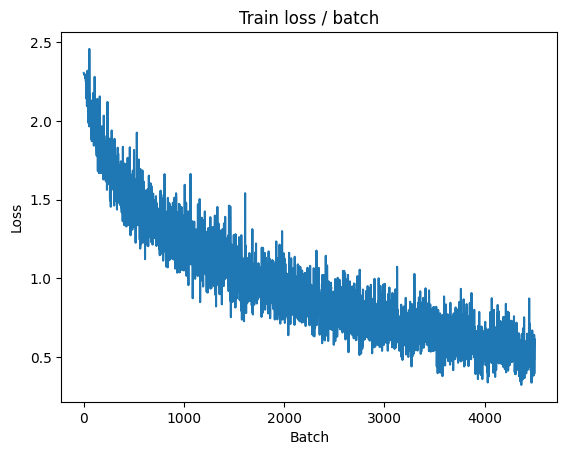


===============> Total time 33s	Avg loss 0.5286	Avg Prec@1 81.38 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.8187 (0.8187)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7907	Avg Prec@1 74.29 %	Avg Prec@5 98.03 %



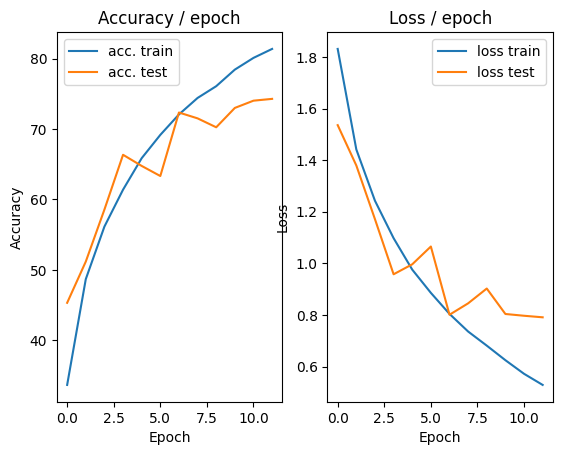

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.303s (0.303s)	Loss 0.6740 (0.6740)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)


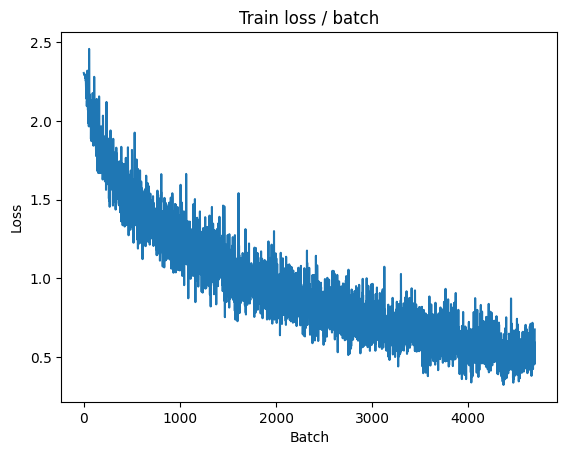

[TRAIN Batch 200/391]	Time 0.183s (0.085s)	Loss 0.6078 (0.4664)	Prec@1  75.0 ( 83.8)	Prec@5 100.0 ( 99.4)


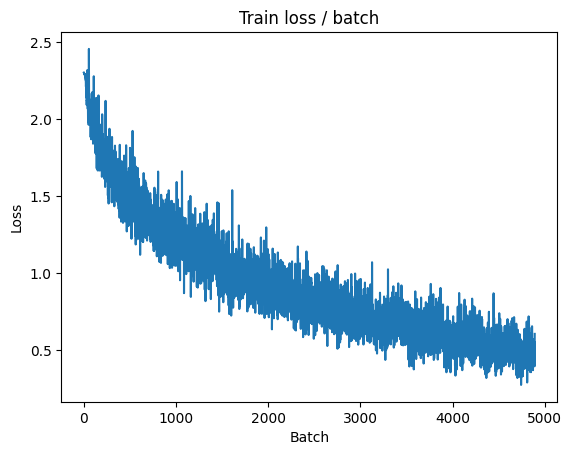


===============> Total time 34s	Avg loss 0.4823	Avg Prec@1 83.14 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.9970 (0.9970)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9125	Avg Prec@1 71.03 %	Avg Prec@5 97.71 %



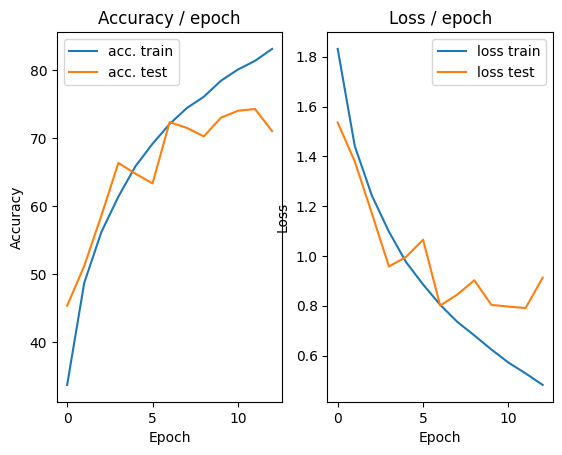

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.335s (0.335s)	Loss 0.6618 (0.6618)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


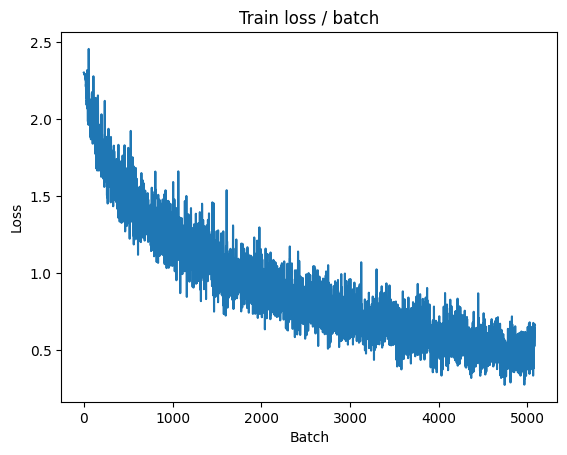

[TRAIN Batch 200/391]	Time 0.061s (0.099s)	Loss 0.4891 (0.4272)	Prec@1  82.0 ( 85.2)	Prec@5 100.0 ( 99.6)


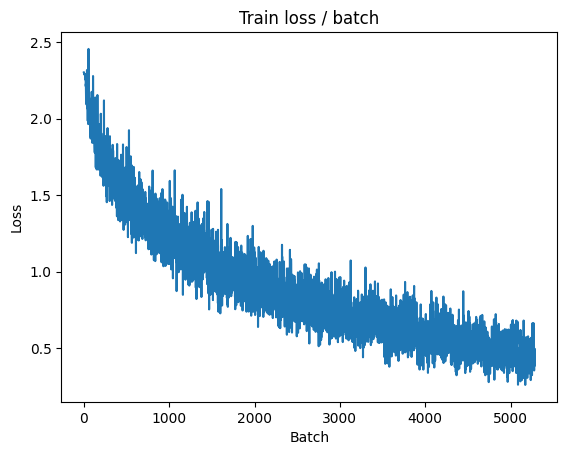


===============> Total time 37s	Avg loss 0.4484	Avg Prec@1 84.38 %	Avg Prec@5 99.49 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 0.9323 (0.9323)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8492	Avg Prec@1 75.01 %	Avg Prec@5 98.22 %



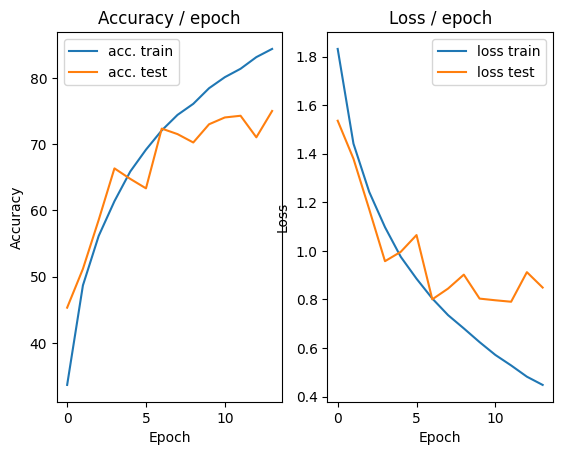

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.317s (0.317s)	Loss 0.4810 (0.4810)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


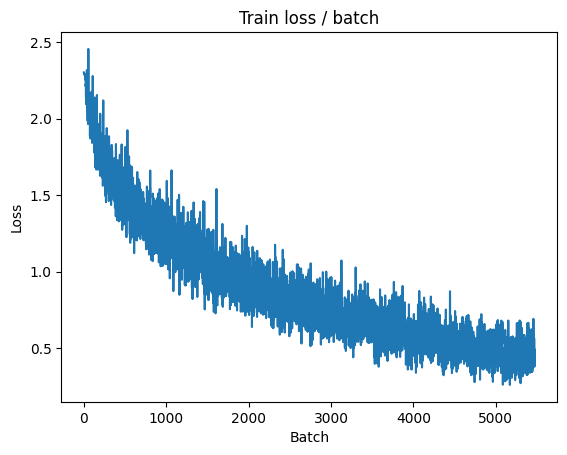

[TRAIN Batch 200/391]	Time 0.058s (0.087s)	Loss 0.4538 (0.4051)	Prec@1  85.2 ( 85.9)	Prec@5 100.0 ( 99.6)


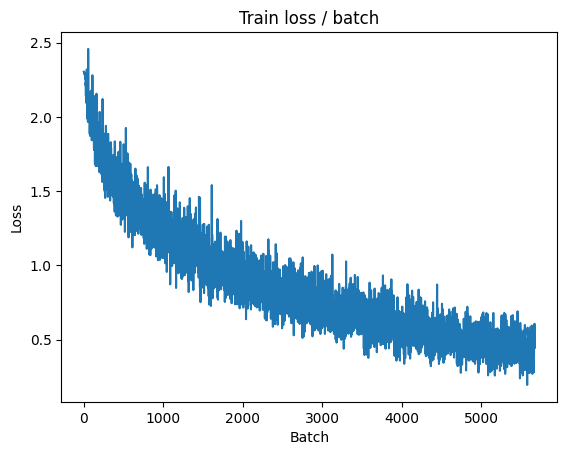


===============> Total time 33s	Avg loss 0.4139	Avg Prec@1 85.65 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 1.0096 (1.0096)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8171	Avg Prec@1 75.28 %	Avg Prec@5 98.16 %



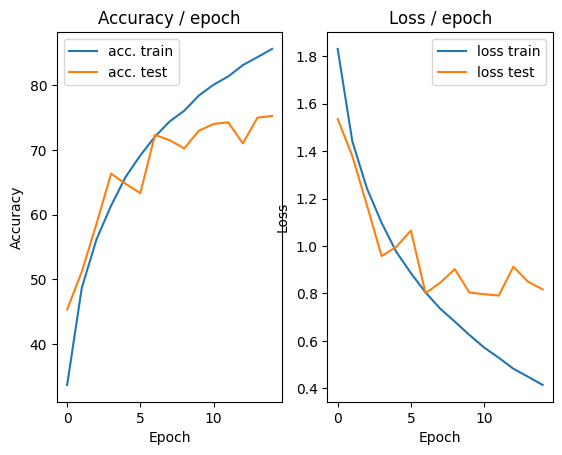

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.348s (0.348s)	Loss 0.3505 (0.3505)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


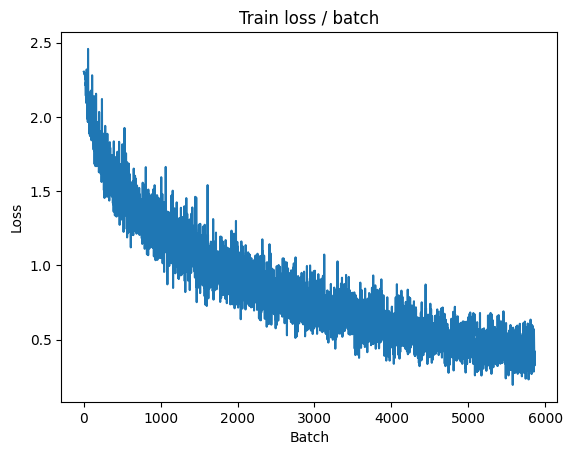

[TRAIN Batch 200/391]	Time 0.057s (0.091s)	Loss 0.2621 (0.3665)	Prec@1  90.6 ( 87.3)	Prec@5 100.0 ( 99.8)


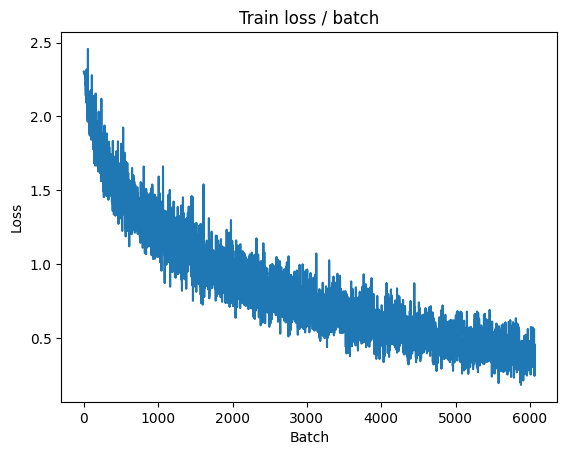


===============> Total time 35s	Avg loss 0.3792	Avg Prec@1 86.83 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.9563 (0.9563)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8223	Avg Prec@1 75.53 %	Avg Prec@5 98.13 %



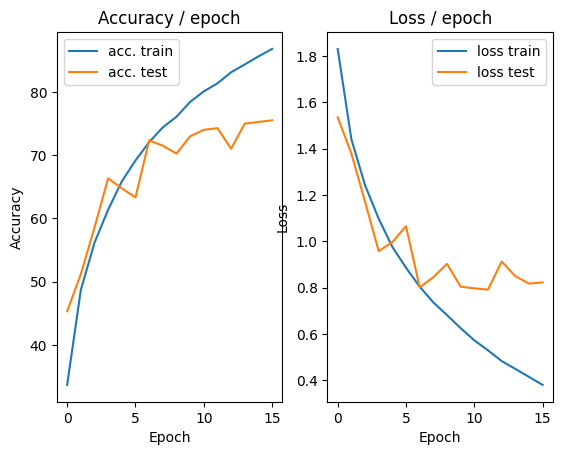

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.3843 (0.3843)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)


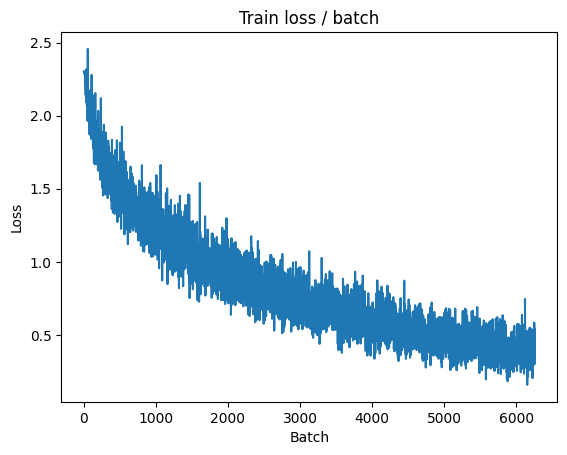

[TRAIN Batch 200/391]	Time 0.063s (0.093s)	Loss 0.3644 (0.3373)	Prec@1  89.8 ( 88.1)	Prec@5 100.0 ( 99.8)


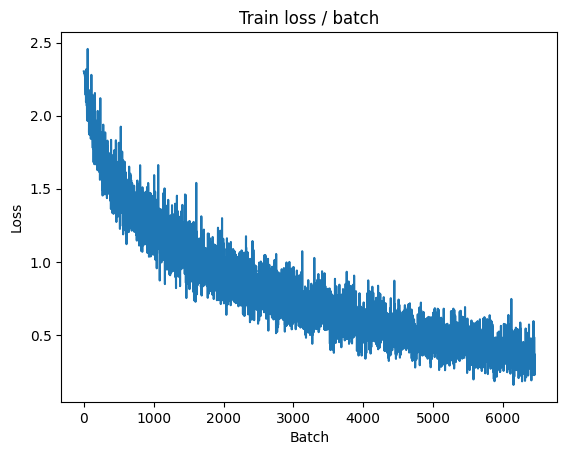


===============> Total time 36s	Avg loss 0.3451	Avg Prec@1 87.89 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 1.1845 (1.1845)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9571	Avg Prec@1 73.61 %	Avg Prec@5 98.00 %



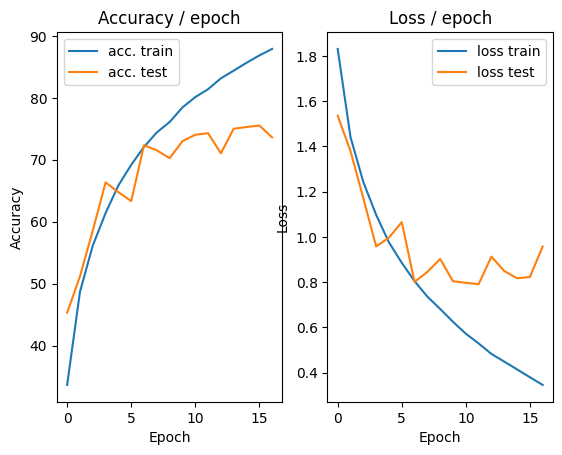

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.283s (0.283s)	Loss 0.5700 (0.5700)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


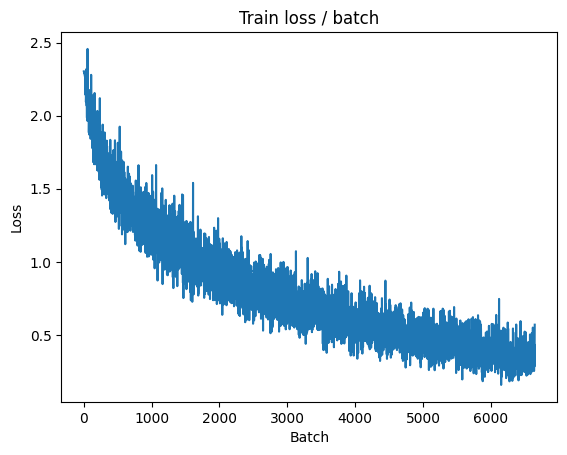

[TRAIN Batch 200/391]	Time 0.062s (0.099s)	Loss 0.2999 (0.3112)	Prec@1  90.6 ( 89.3)	Prec@5 100.0 ( 99.8)


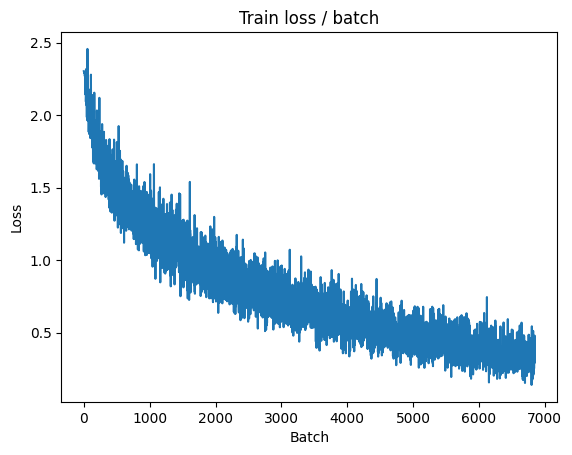


===============> Total time 36s	Avg loss 0.3258	Avg Prec@1 88.66 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 1.0408 (1.0408)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9484	Avg Prec@1 74.62 %	Avg Prec@5 98.02 %



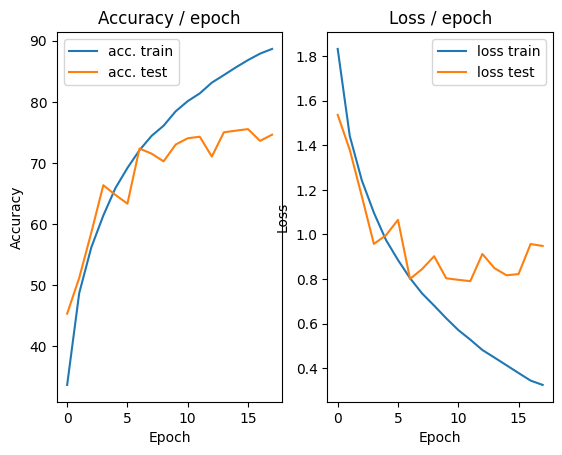

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.2272 (0.2272)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


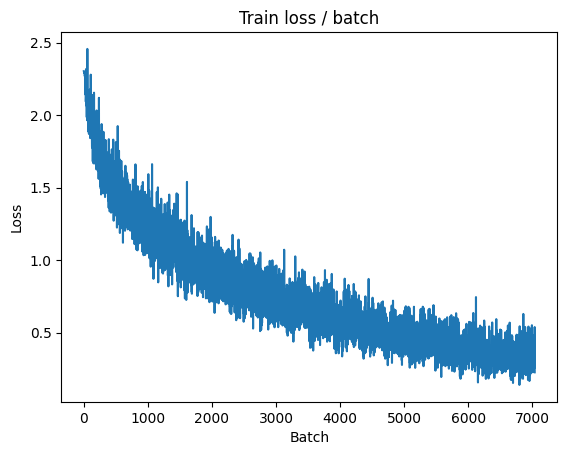

[TRAIN Batch 200/391]	Time 0.059s (0.084s)	Loss 0.4448 (0.2804)	Prec@1  83.6 ( 90.3)	Prec@5  99.2 ( 99.8)


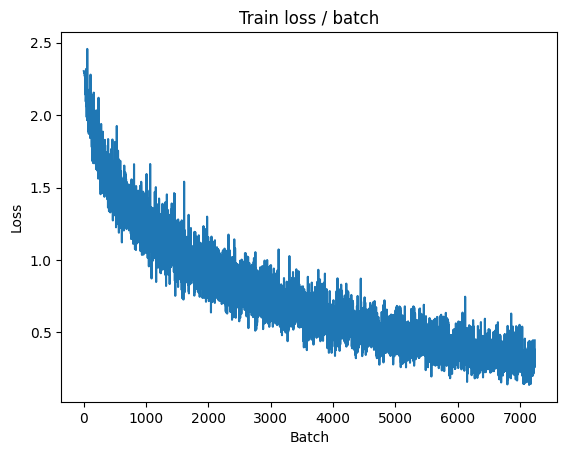


===============> Total time 32s	Avg loss 0.2936	Avg Prec@1 89.75 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.1571 (1.1571)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9494	Avg Prec@1 74.77 %	Avg Prec@5 97.93 %



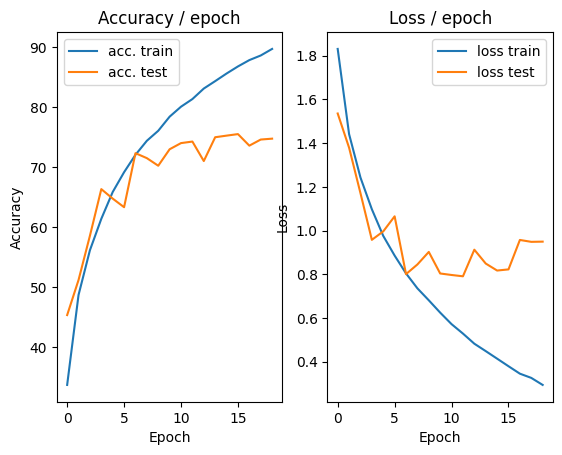

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.3162 (0.3162)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


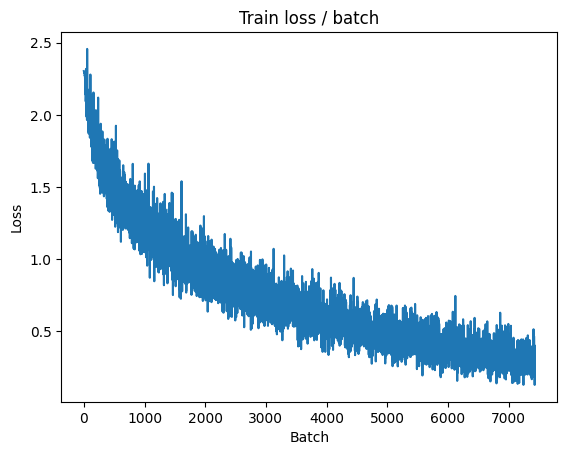

[TRAIN Batch 200/391]	Time 0.092s (0.092s)	Loss 0.2327 (0.2588)	Prec@1  92.2 ( 90.9)	Prec@5 100.0 ( 99.9)


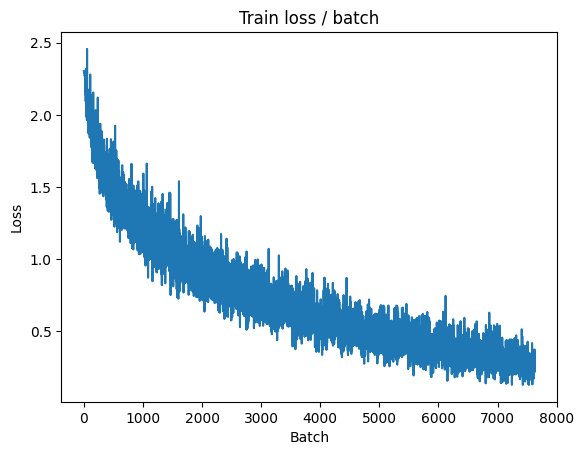


===============> Total time 34s	Avg loss 0.2718	Avg Prec@1 90.53 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 1.0372 (1.0372)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0116	Avg Prec@1 74.64 %	Avg Prec@5 97.84 %



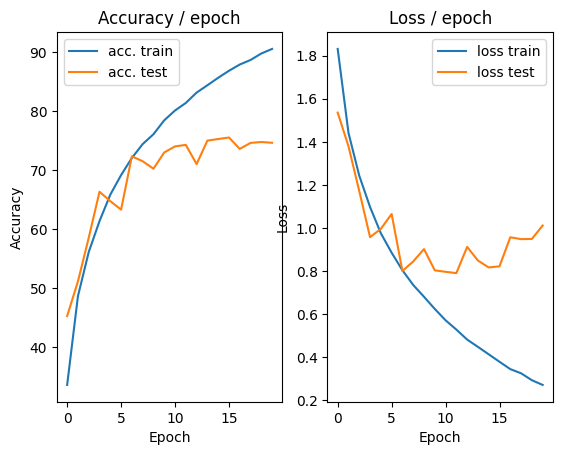

In [21]:
main(batch_size, lr, epochs, cuda=True)

### 3.3 Variants on the optimisation algorithm
**Implementation** : Add a *learning rate scheduler* and use an exponential decay with a coefficient of 0.95

In [22]:
# The former version before bonus 
def get_dataset(batch_size, cuda=False,download=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=False,
        transform=transforms.Compose([
            # Random crop & Random horizontal symmetry
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip(),

            transforms.ToTensor(),  
            transforms.Normalize(mean=[0.491, 0.482, 0.447],  std=[0.202, 0.199, 0.201]) 
    ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=False,
        transform=transforms.Compose([
            #Centered crop
            transforms.CenterCrop(28),
            
            transforms.ToTensor(),  
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std=[0.202, 0.199, 0.201])  
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

def main(batch_size=128, lr=0.1, epochs=5, cuda=False, download=False):

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    # Create learning rate scheduler
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda, download)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        # Modify the learning rate after each epoch
        lr_sched.step()

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 2.3041 (2.3041)	Prec@1   7.0 (  7.0)	Prec@5  48.4 ( 48.4)


<Figure size 640x480 with 0 Axes>

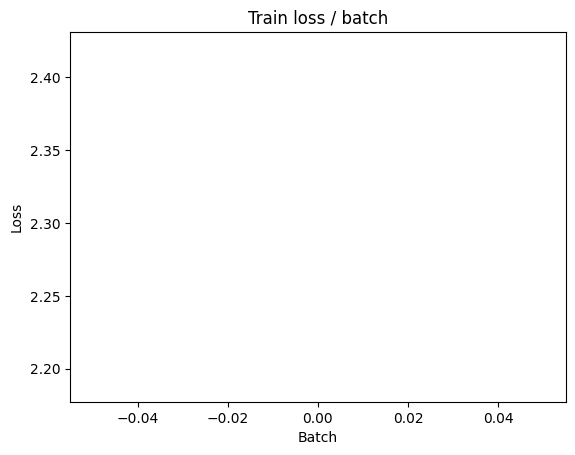

[TRAIN Batch 200/391]	Time 0.054s (0.059s)	Loss 1.7378 (1.9588)	Prec@1  33.6 ( 28.2)	Prec@5  91.4 ( 79.2)


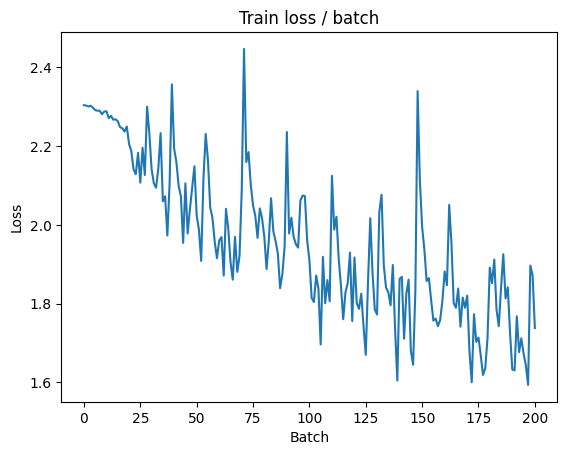


===============> Total time 24s	Avg loss 1.8008	Avg Prec@1 34.33 %	Avg Prec@5 84.13 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 1.4970 (1.4970)	Prec@1  43.0 ( 43.0)	Prec@5  92.2 ( 92.2)

===============> Total time 3s	Avg loss 1.5378	Avg Prec@1 43.87 %	Avg Prec@5 91.50 %



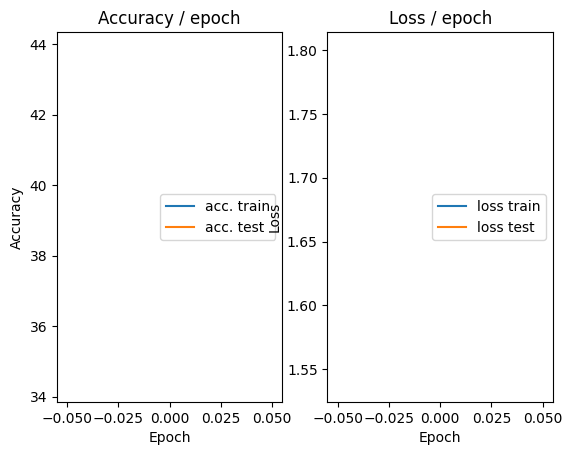

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 1.4903 (1.4903)	Prec@1  49.2 ( 49.2)	Prec@5  93.0 ( 93.0)


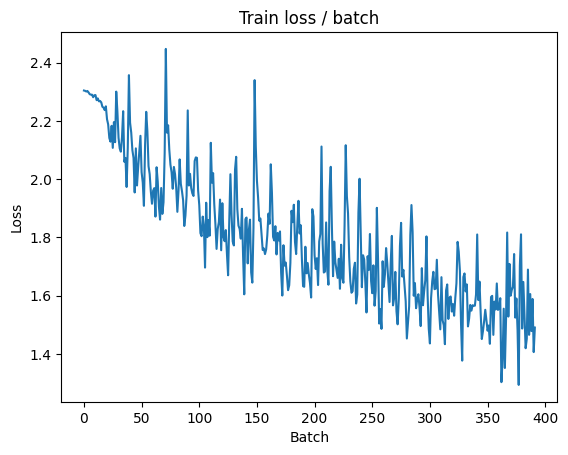

[TRAIN Batch 200/391]	Time 0.057s (0.057s)	Loss 1.4643 (1.4564)	Prec@1  46.1 ( 47.9)	Prec@5  92.2 ( 92.5)


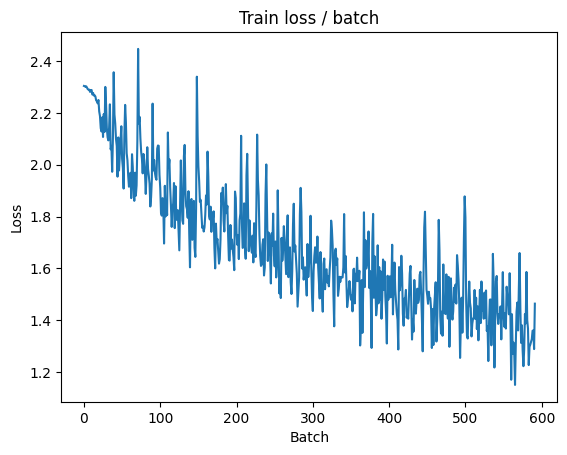


===============> Total time 22s	Avg loss 1.3957	Avg Prec@1 49.99 %	Avg Prec@5 93.18 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 1.3158 (1.3158)	Prec@1  53.1 ( 53.1)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.3655	Avg Prec@1 51.96 %	Avg Prec@5 93.51 %



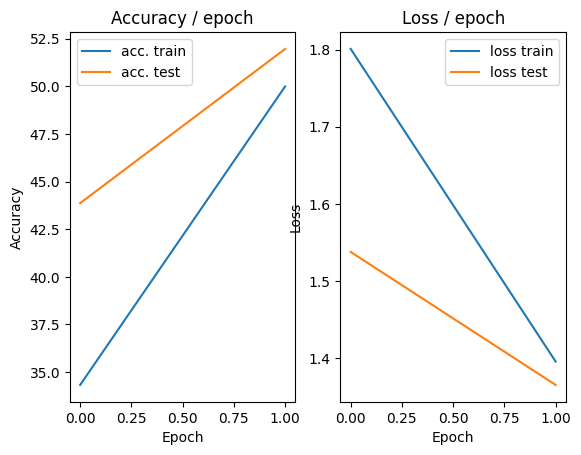

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 1.3877 (1.3877)	Prec@1  50.0 ( 50.0)	Prec@5  95.3 ( 95.3)


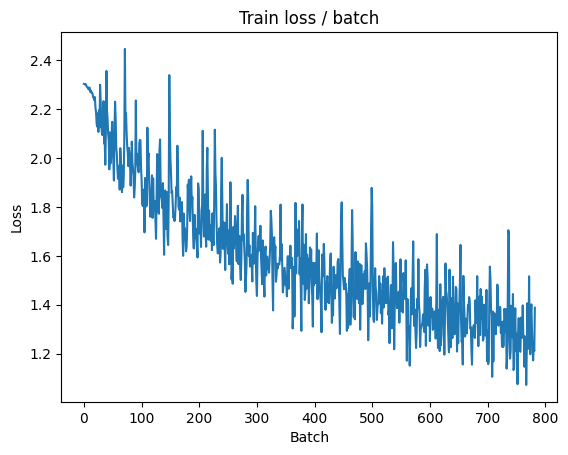

[TRAIN Batch 200/391]	Time 0.057s (0.057s)	Loss 1.0979 (1.2148)	Prec@1  60.2 ( 57.0)	Prec@5  95.3 ( 95.1)


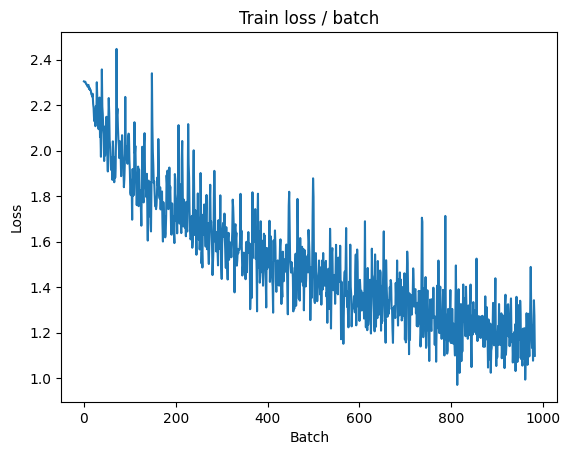


===============> Total time 22s	Avg loss 1.1794	Avg Prec@1 58.34 %	Avg Prec@5 95.28 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 1.0736 (1.0736)	Prec@1  64.8 ( 64.8)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.0737	Avg Prec@1 62.37 %	Avg Prec@5 96.31 %



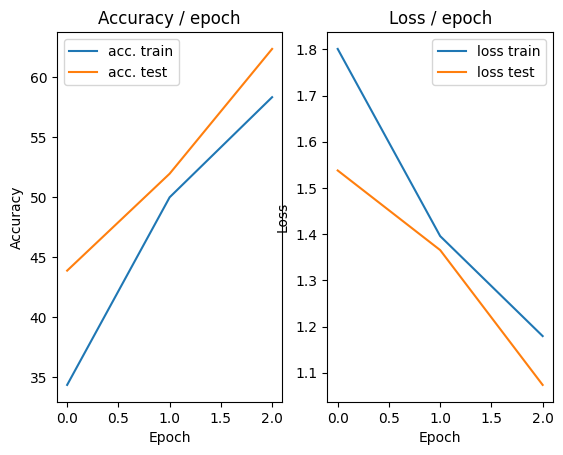

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 1.1740 (1.1740)	Prec@1  61.7 ( 61.7)	Prec@5  95.3 ( 95.3)


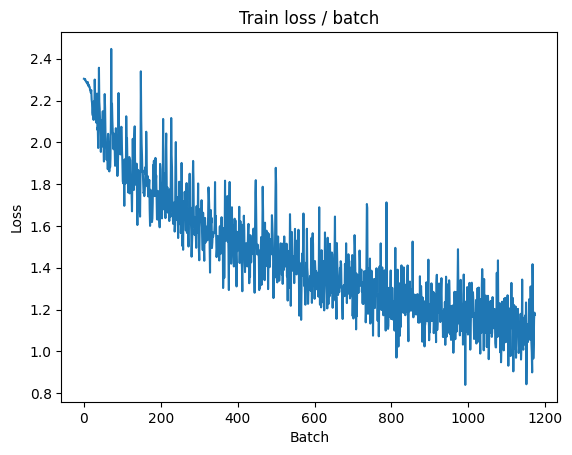

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 1.0946 (1.0534)	Prec@1  58.6 ( 63.5)	Prec@5  96.1 ( 96.2)


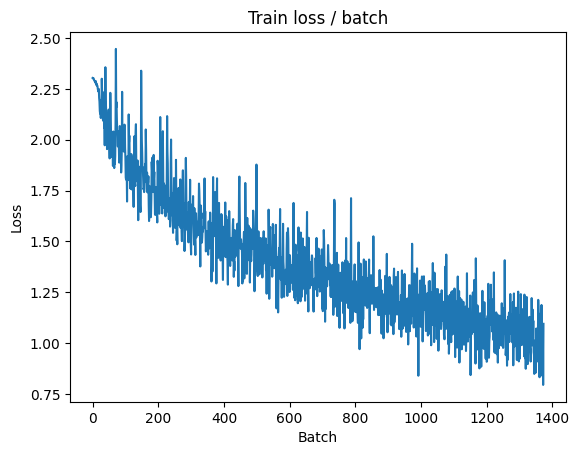


===============> Total time 22s	Avg loss 1.0232	Avg Prec@1 64.41 %	Avg Prec@5 96.54 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 0.9807 (0.9807)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9639	Avg Prec@1 67.06 %	Avg Prec@5 96.57 %



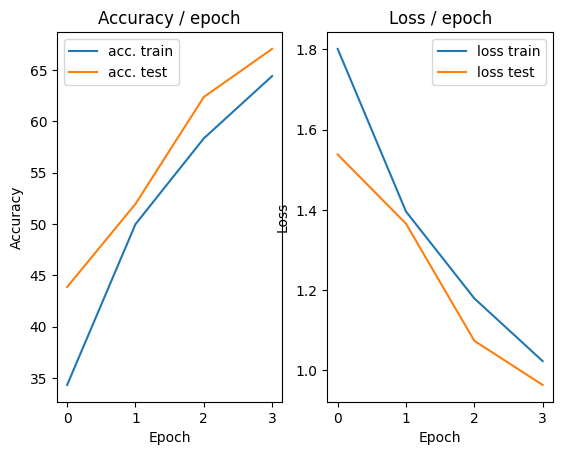

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 1.2029 (1.2029)	Prec@1  59.4 ( 59.4)	Prec@5  92.2 ( 92.2)


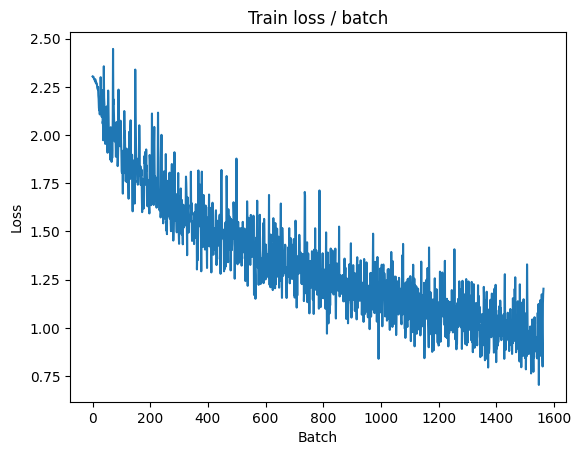

[TRAIN Batch 200/391]	Time 0.055s (0.057s)	Loss 0.9272 (0.9320)	Prec@1  65.6 ( 67.8)	Prec@5  97.7 ( 97.1)


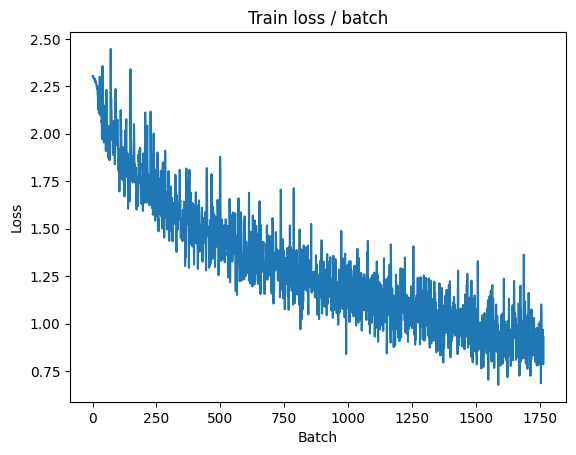


===============> Total time 21s	Avg loss 0.9128	Avg Prec@1 68.43 %	Avg Prec@5 97.21 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.9383 (0.9383)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9217	Avg Prec@1 67.41 %	Avg Prec@5 97.42 %



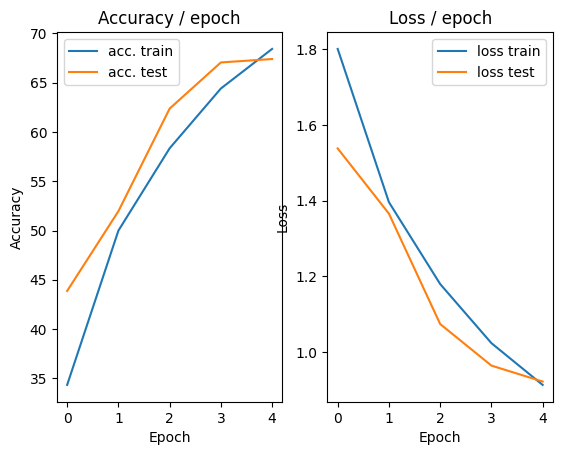

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.8336 (0.8336)	Prec@1  71.9 ( 71.9)	Prec@5  99.2 ( 99.2)


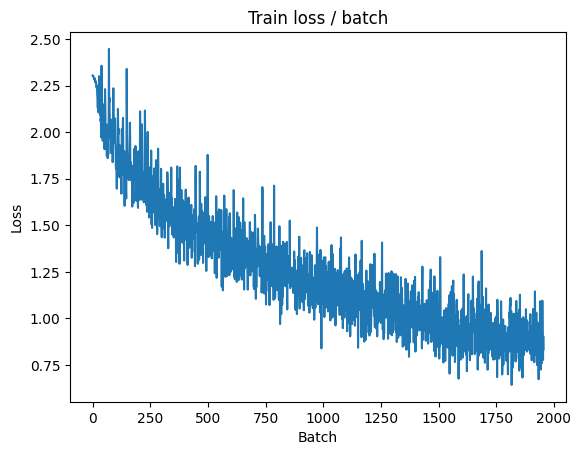

[TRAIN Batch 200/391]	Time 0.050s (0.057s)	Loss 0.8404 (0.8212)	Prec@1  67.2 ( 71.3)	Prec@5  99.2 ( 97.8)


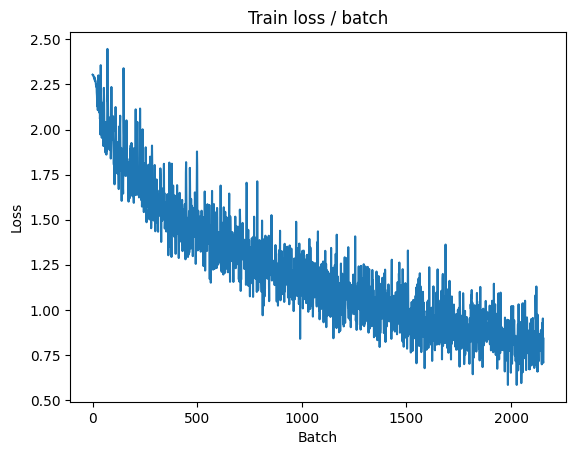


===============> Total time 22s	Avg loss 0.8221	Avg Prec@1 71.41 %	Avg Prec@5 97.86 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.7573 (0.7573)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7840	Avg Prec@1 72.77 %	Avg Prec@5 97.83 %



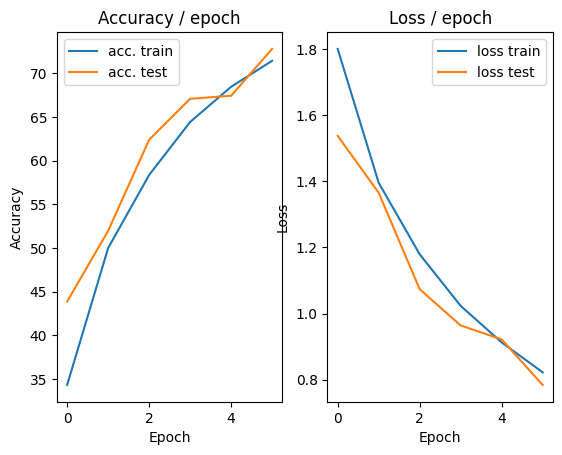

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 0.8450 (0.8450)	Prec@1  70.3 ( 70.3)	Prec@5  99.2 ( 99.2)


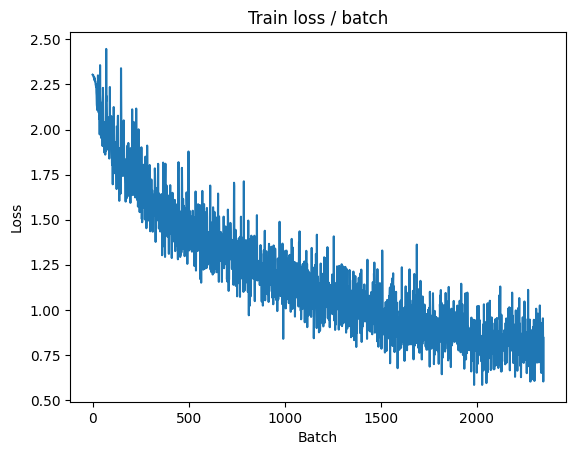

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.6909 (0.7633)	Prec@1  77.3 ( 73.6)	Prec@5  97.7 ( 98.2)


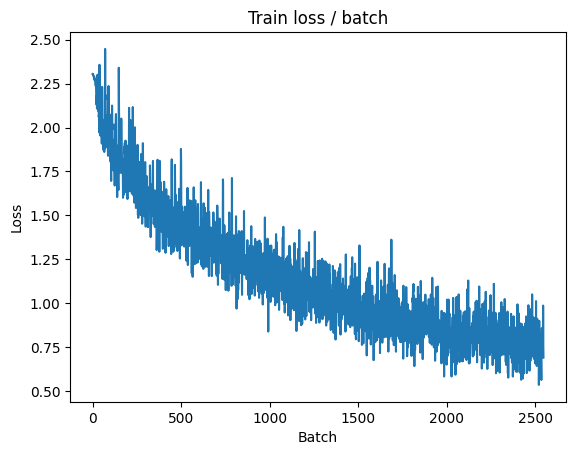


===============> Total time 22s	Avg loss 0.7579	Avg Prec@1 73.77 %	Avg Prec@5 98.15 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.7733 (0.7733)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7815	Avg Prec@1 73.13 %	Avg Prec@5 98.02 %



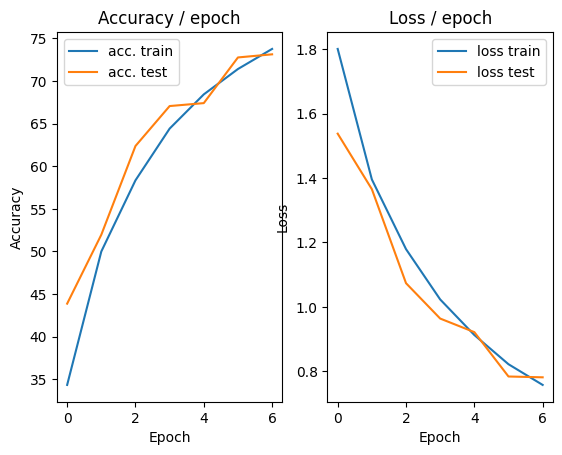

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.8625 (0.8625)	Prec@1  74.2 ( 74.2)	Prec@5  95.3 ( 95.3)


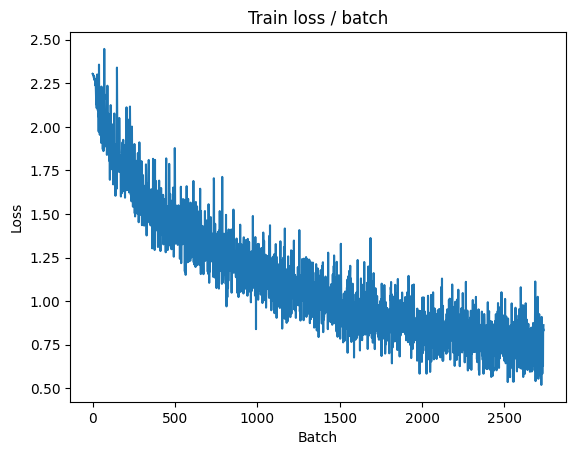

[TRAIN Batch 200/391]	Time 0.053s (0.059s)	Loss 0.6216 (0.7101)	Prec@1  74.2 ( 75.3)	Prec@5  97.7 ( 98.4)


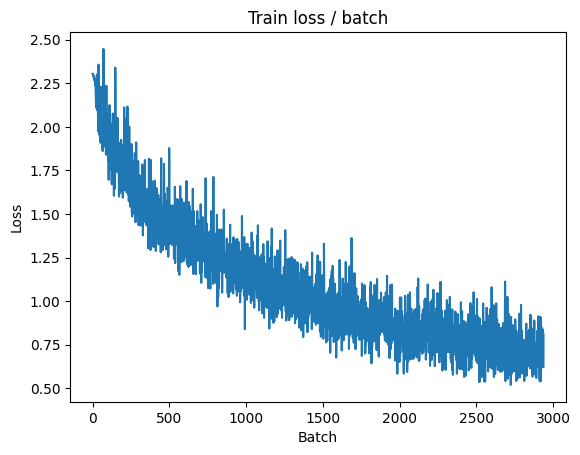


===============> Total time 22s	Avg loss 0.7065	Avg Prec@1 75.35 %	Avg Prec@5 98.42 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.7290 (0.7290)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7359	Avg Prec@1 75.23 %	Avg Prec@5 98.18 %



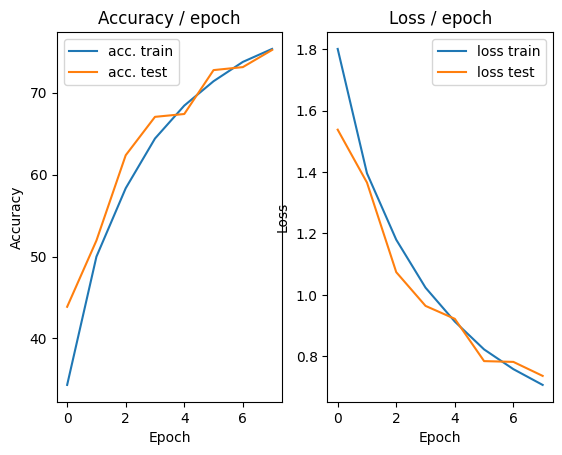

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.7797 (0.7797)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)


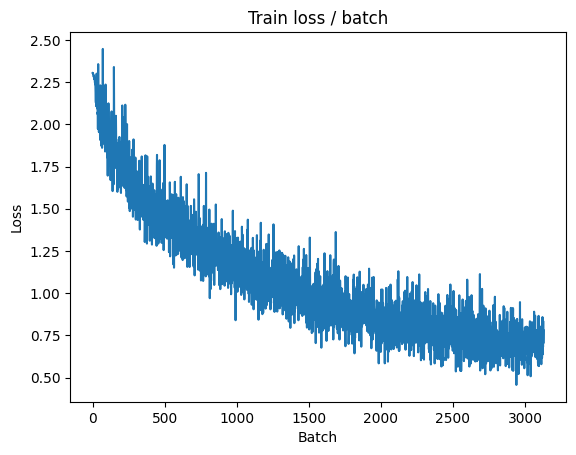

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.6744 (0.6528)	Prec@1  75.8 ( 77.4)	Prec@5  98.4 ( 98.7)


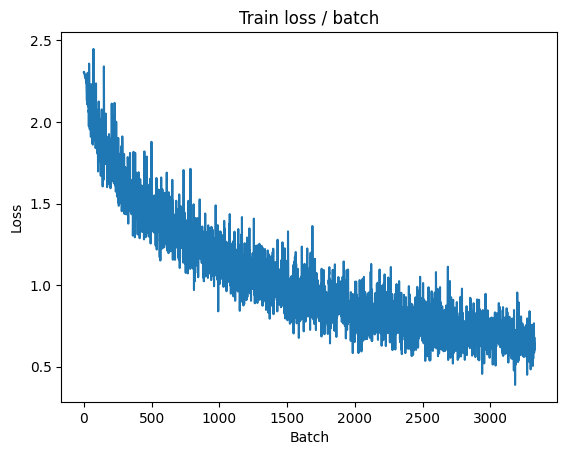


===============> Total time 21s	Avg loss 0.6583	Avg Prec@1 77.10 %	Avg Prec@5 98.65 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 0.7579 (0.7579)	Prec@1  74.2 ( 74.2)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.7648	Avg Prec@1 73.67 %	Avg Prec@5 98.13 %



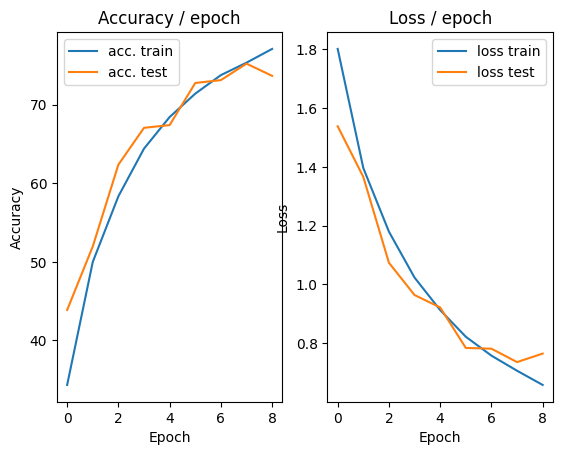

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.7276 (0.7276)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)


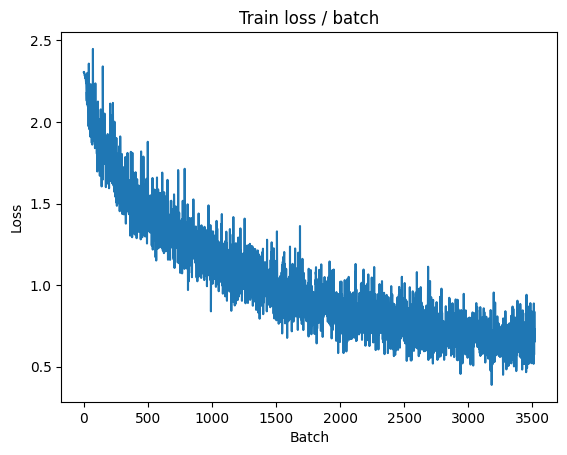

[TRAIN Batch 200/391]	Time 0.055s (0.057s)	Loss 0.5631 (0.6322)	Prec@1  85.2 ( 78.0)	Prec@5  98.4 ( 98.9)


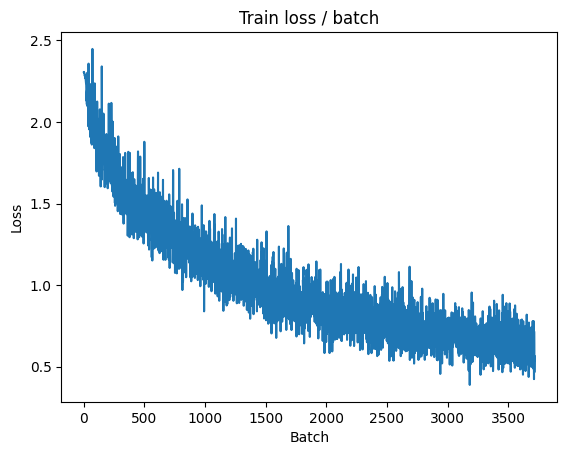


===============> Total time 22s	Avg loss 0.6243	Avg Prec@1 78.28 %	Avg Prec@5 98.86 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.6673 (0.6673)	Prec@1  75.8 ( 75.8)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6863	Avg Prec@1 76.23 %	Avg Prec@5 98.55 %



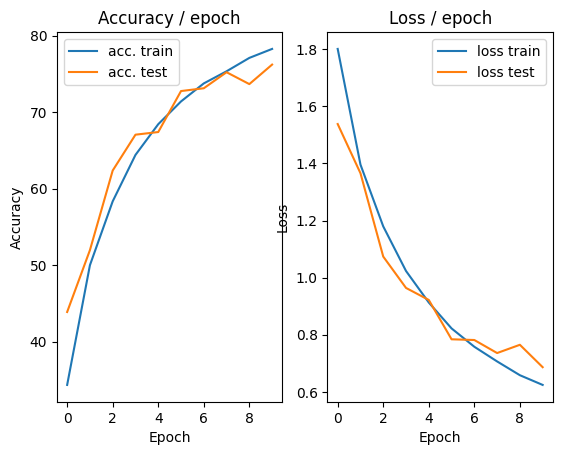

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.5052 (0.5052)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


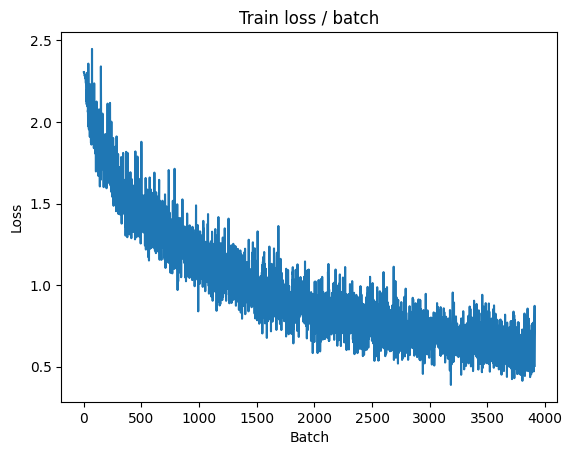

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.5581 (0.5893)	Prec@1  80.5 ( 79.4)	Prec@5 100.0 ( 98.9)


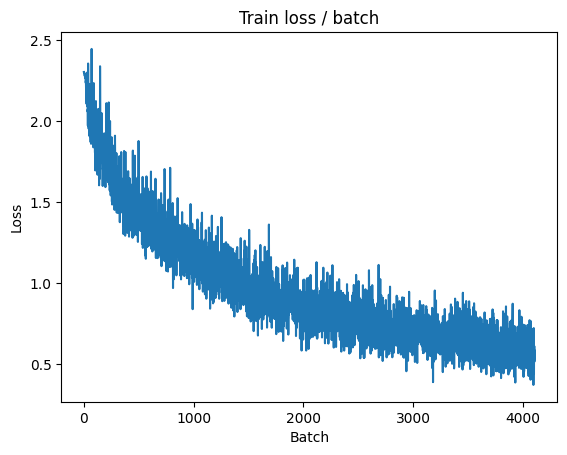


===============> Total time 22s	Avg loss 0.5855	Avg Prec@1 79.64 %	Avg Prec@5 98.95 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 0.7013 (0.7013)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6972	Avg Prec@1 76.55 %	Avg Prec@5 98.19 %



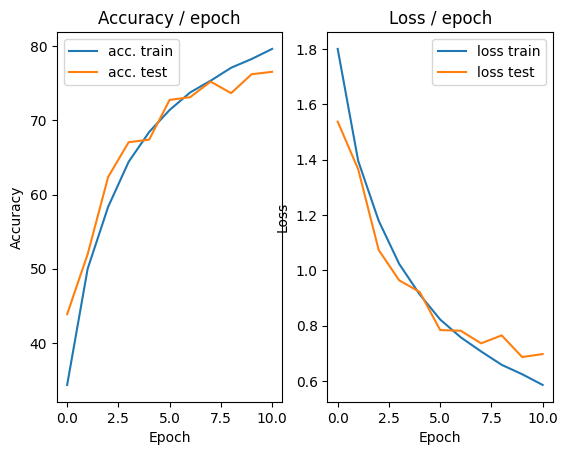

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.6012 (0.6012)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)


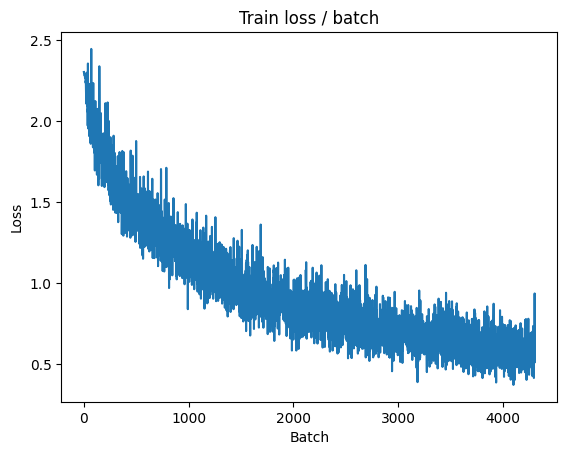

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.4839 (0.5468)	Prec@1  84.4 ( 80.9)	Prec@5 100.0 ( 99.1)


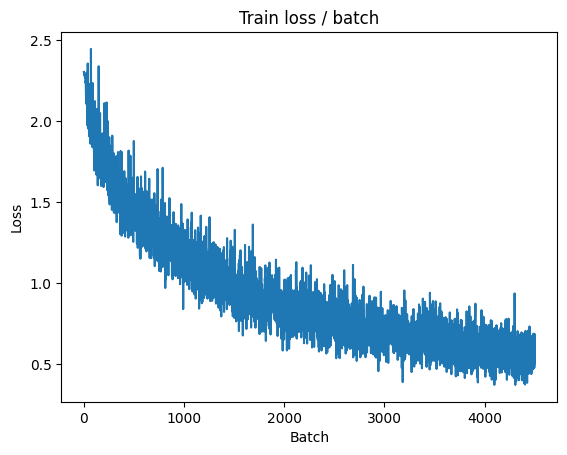


===============> Total time 22s	Avg loss 0.5531	Avg Prec@1 80.71 %	Avg Prec@5 99.04 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.6475 (0.6475)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6364	Avg Prec@1 78.12 %	Avg Prec@5 98.69 %



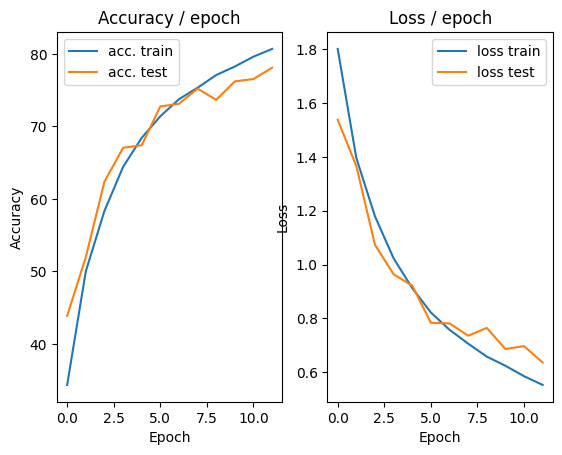

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.5435 (0.5435)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


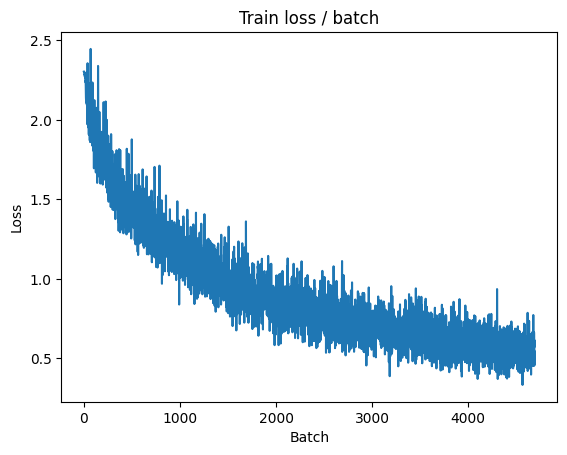

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.6559 (0.5239)	Prec@1  73.4 ( 81.9)	Prec@5  98.4 ( 99.2)


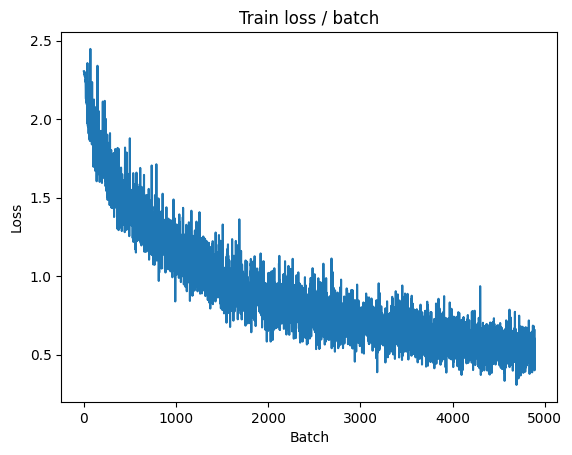


===============> Total time 22s	Avg loss 0.5214	Avg Prec@1 81.74 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.6100 (0.6100)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6311	Avg Prec@1 78.56 %	Avg Prec@5 98.70 %



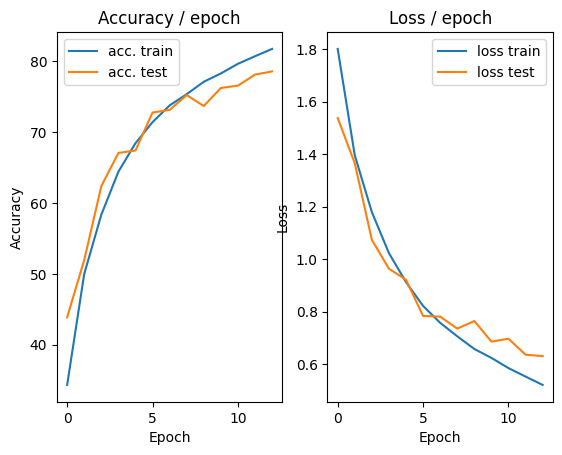

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 0.4633 (0.4633)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


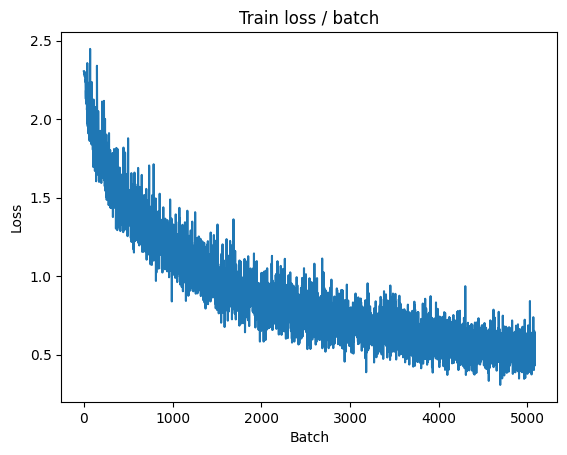

[TRAIN Batch 200/391]	Time 0.056s (0.057s)	Loss 0.4260 (0.4872)	Prec@1  82.8 ( 82.9)	Prec@5 100.0 ( 99.3)


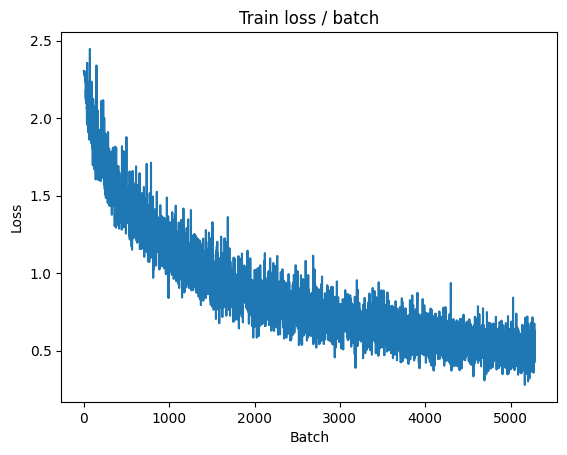


===============> Total time 21s	Avg loss 0.4935	Avg Prec@1 82.74 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.5617 (0.5617)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6524	Avg Prec@1 78.10 %	Avg Prec@5 98.54 %



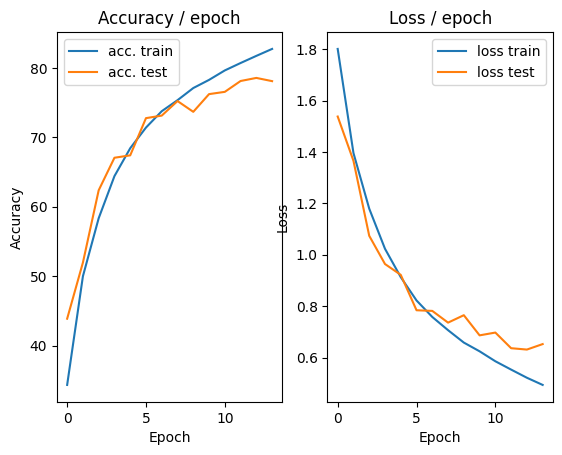

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.5628 (0.5628)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


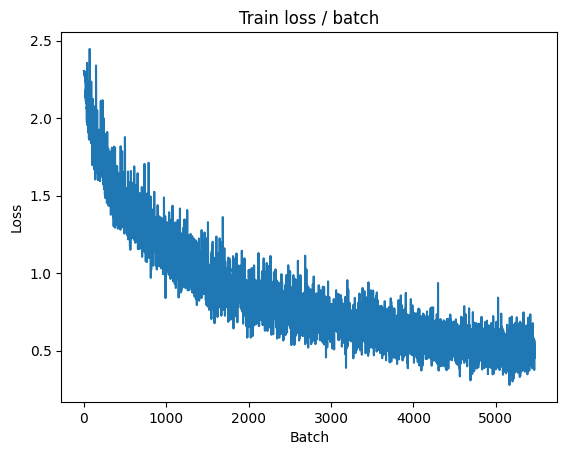

[TRAIN Batch 200/391]	Time 0.057s (0.056s)	Loss 0.5075 (0.4689)	Prec@1  82.0 ( 83.6)	Prec@5 100.0 ( 99.4)


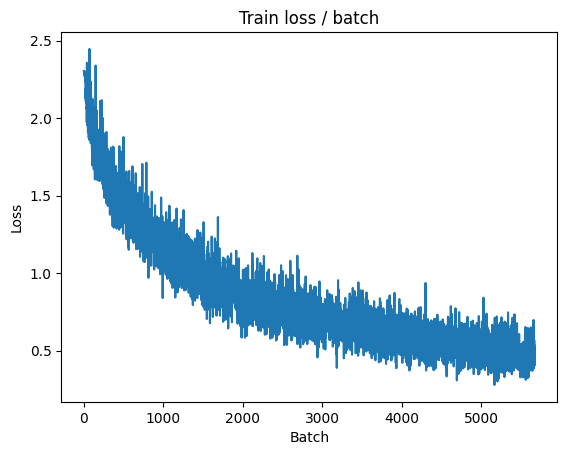


===============> Total time 21s	Avg loss 0.4679	Avg Prec@1 83.66 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 0.5824 (0.5824)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6003	Avg Prec@1 79.69 %	Avg Prec@5 98.75 %



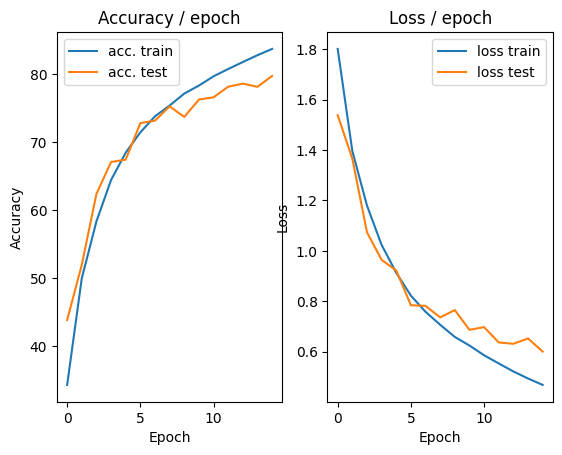

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.4021 (0.4021)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


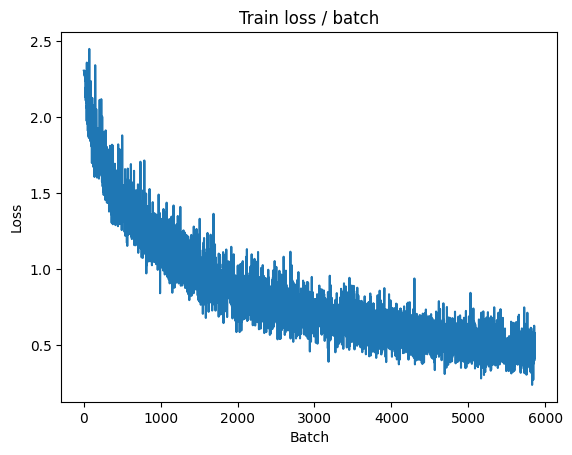

[TRAIN Batch 200/391]	Time 0.053s (0.057s)	Loss 0.5397 (0.4344)	Prec@1  79.7 ( 84.8)	Prec@5  97.7 ( 99.5)


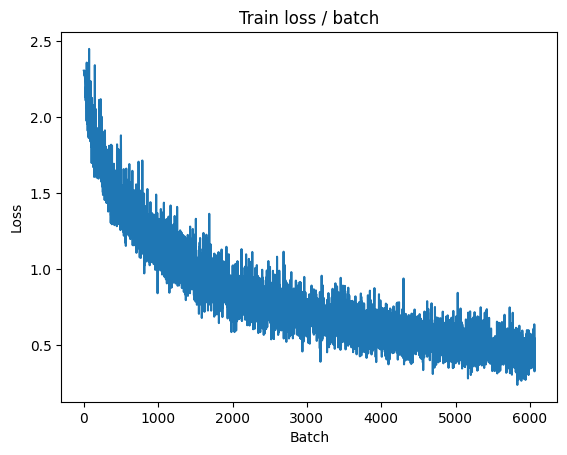


===============> Total time 22s	Avg loss 0.4448	Avg Prec@1 84.51 %	Avg Prec@5 99.46 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.6001 (0.6001)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6482	Avg Prec@1 78.60 %	Avg Prec@5 98.66 %



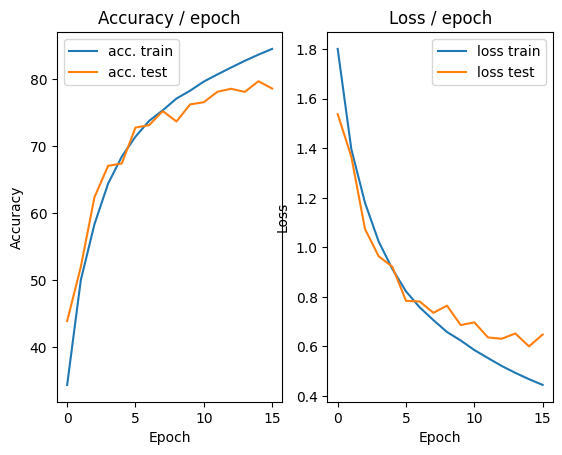

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.3181 (0.3181)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


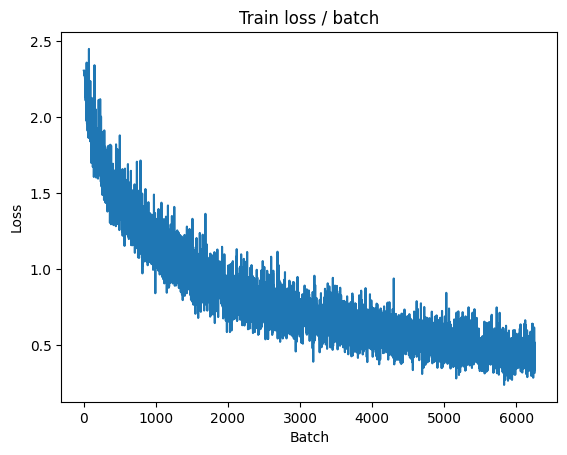

[TRAIN Batch 200/391]	Time 0.055s (0.058s)	Loss 0.3584 (0.4232)	Prec@1  85.9 ( 85.2)	Prec@5 100.0 ( 99.5)


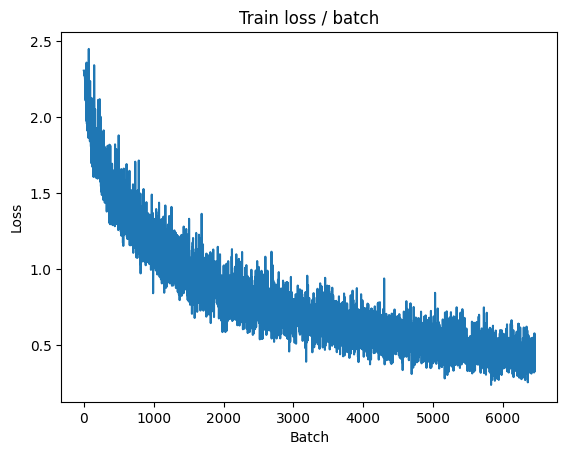


===============> Total time 22s	Avg loss 0.4246	Avg Prec@1 85.17 %	Avg Prec@5 99.48 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.5386 (0.5386)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5863	Avg Prec@1 80.14 %	Avg Prec@5 98.88 %



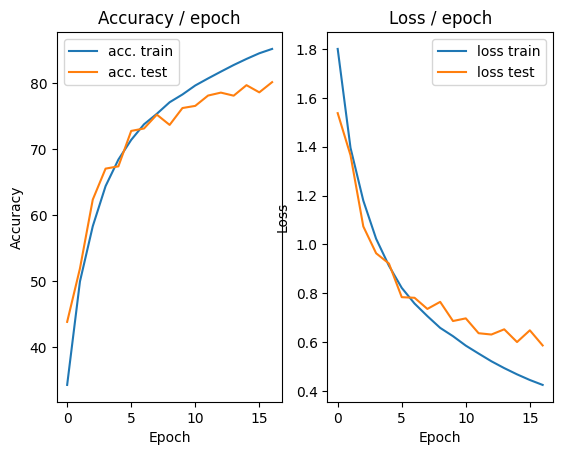

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.3918 (0.3918)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


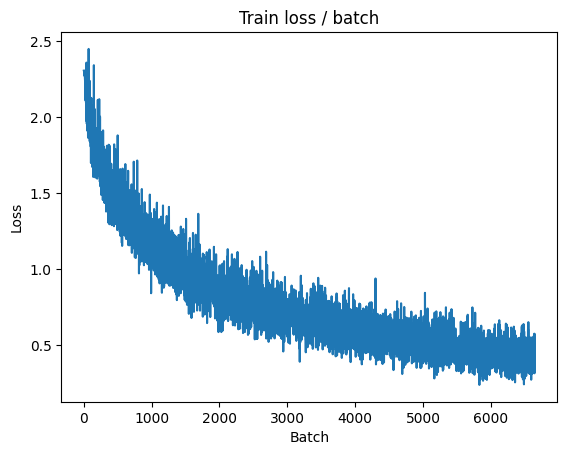

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.5652 (0.4027)	Prec@1  82.8 ( 85.7)	Prec@5  99.2 ( 99.5)


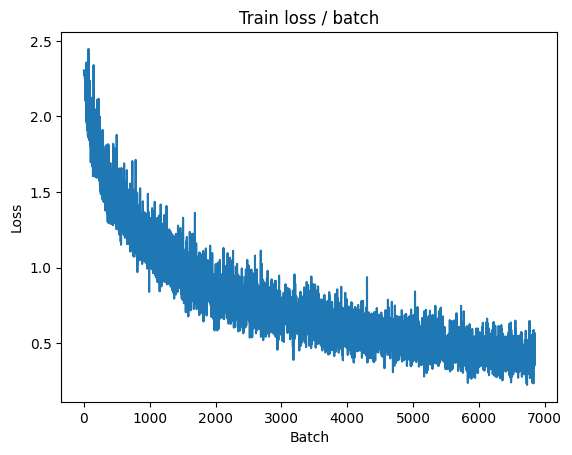


===============> Total time 22s	Avg loss 0.4083	Avg Prec@1 85.71 %	Avg Prec@5 99.48 %

[EVAL Batch 000/079]	Time 0.228s (0.228s)	Loss 0.5952 (0.5952)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6134	Avg Prec@1 79.41 %	Avg Prec@5 98.96 %



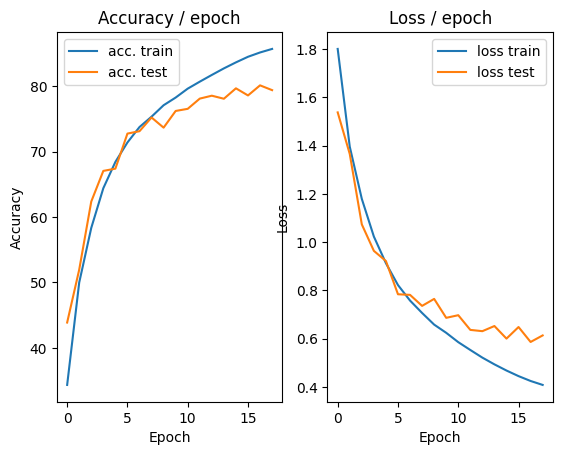

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.4391 (0.4391)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


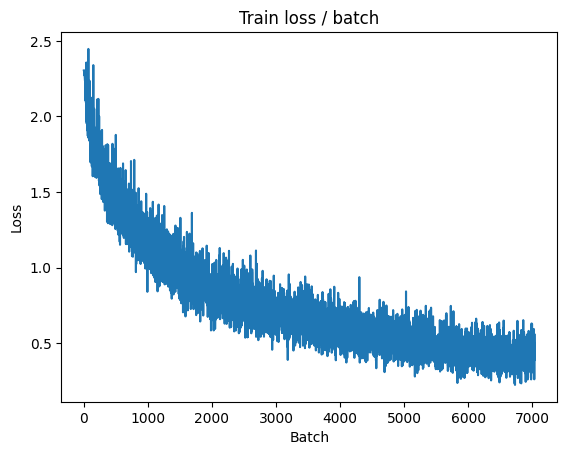

[TRAIN Batch 200/391]	Time 0.058s (0.058s)	Loss 0.3001 (0.3779)	Prec@1  89.8 ( 86.5)	Prec@5 100.0 ( 99.7)


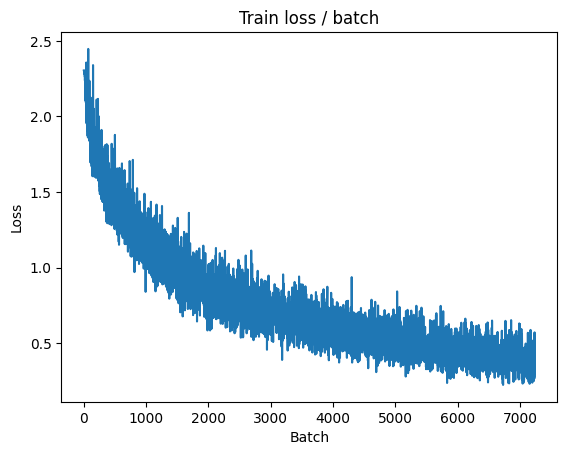


===============> Total time 22s	Avg loss 0.3856	Avg Prec@1 86.32 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 0.5752 (0.5752)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5785	Avg Prec@1 81.11 %	Avg Prec@5 98.90 %



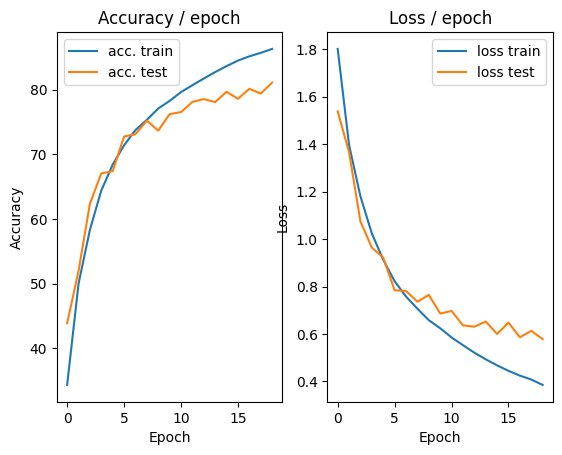

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.3549 (0.3549)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


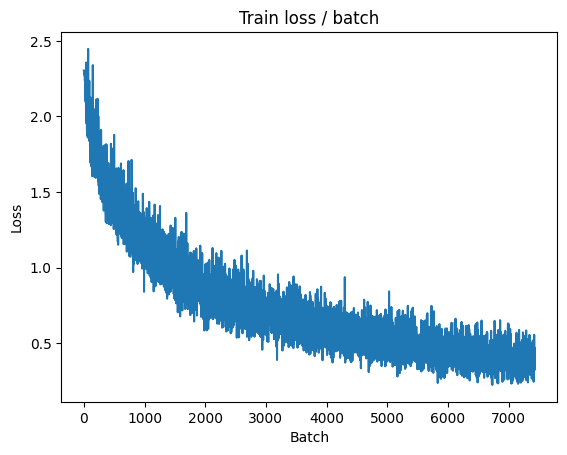

[TRAIN Batch 200/391]	Time 0.056s (0.058s)	Loss 0.3958 (0.3661)	Prec@1  86.7 ( 87.3)	Prec@5  99.2 ( 99.6)


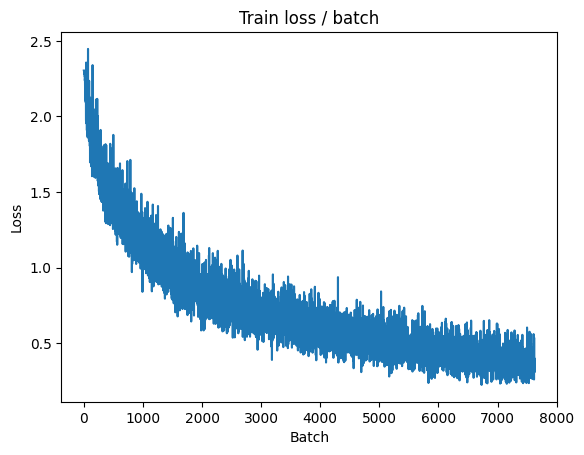


===============> Total time 22s	Avg loss 0.3697	Avg Prec@1 87.08 %	Avg Prec@5 99.60 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.5625 (0.5625)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6114	Avg Prec@1 79.58 %	Avg Prec@5 99.04 %



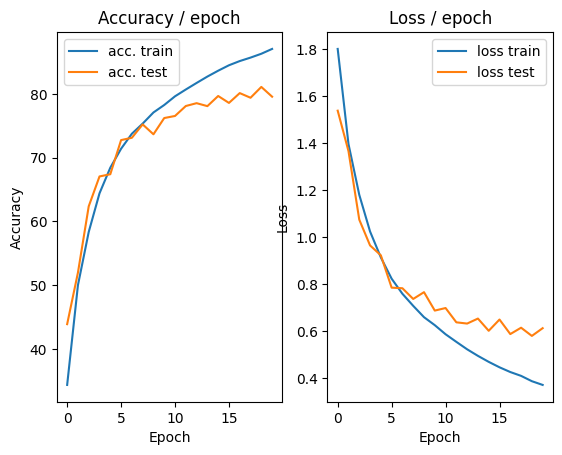

In [23]:
main(batch_size, lr, epochs, cuda=True)

**Question 25** [**Bonus**] : Many other variants of SGD exist and many learning rate planning strategies exist. Which ones ? Test some of them.

In [15]:
def main(batch_size=128, lr=0.1, epochs=5, cuda=False, download=False):

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    
    # We try a new optimiser
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)


    # Create learning rate scheduler
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda, download)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        # Modify the learning rate after each epoch
        lr_sched.step()

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 2.3027 (2.3027)	Prec@1   7.8 (  7.8)	Prec@5  48.4 ( 48.4)


<Figure size 640x480 with 0 Axes>

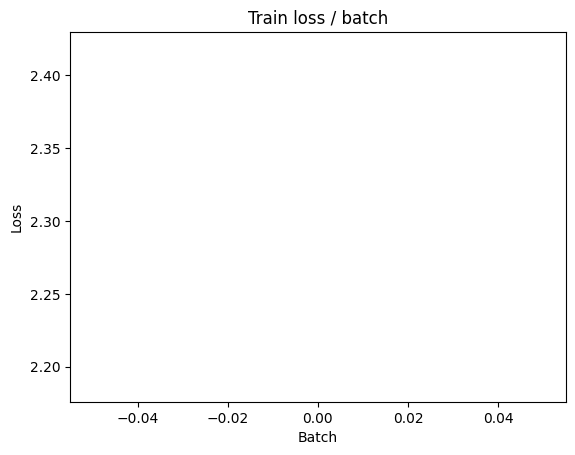

[TRAIN Batch 200/391]	Time 0.061s (0.063s)	Loss 2.1484 (2.2404)	Prec@1  21.9 ( 16.0)	Prec@5  75.8 ( 62.7)


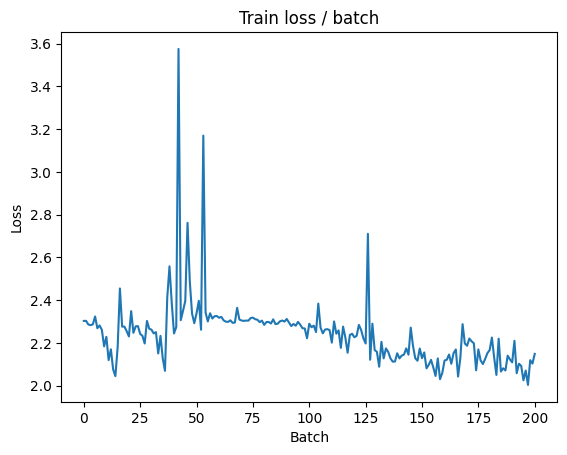


===============> Total time 24s	Avg loss 2.0663	Avg Prec@1 22.73 %	Avg Prec@5 72.40 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 1.7612 (1.7612)	Prec@1  32.8 ( 32.8)	Prec@5  89.1 ( 89.1)

===============> Total time 2s	Avg loss 1.7374	Avg Prec@1 34.11 %	Avg Prec@5 87.71 %



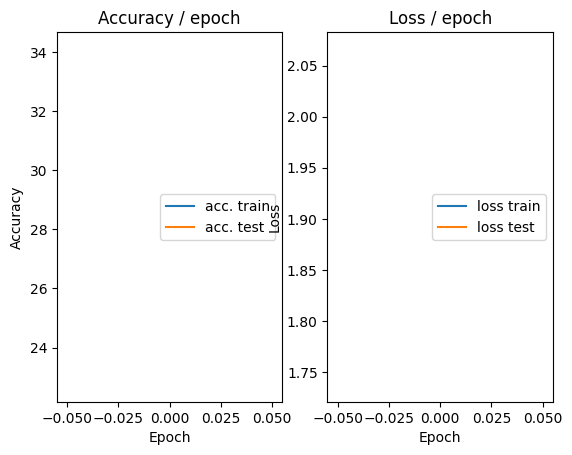

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 1.6519 (1.6519)	Prec@1  33.6 ( 33.6)	Prec@5  91.4 ( 91.4)


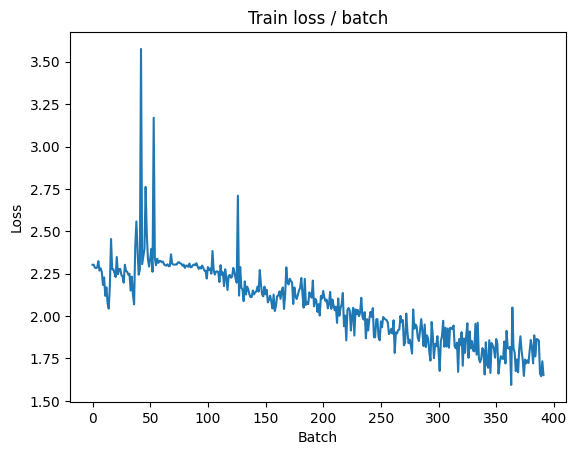

[TRAIN Batch 200/391]	Time 0.059s (0.062s)	Loss 1.8872 (1.7106)	Prec@1  31.2 ( 37.1)	Prec@5  80.5 ( 87.4)


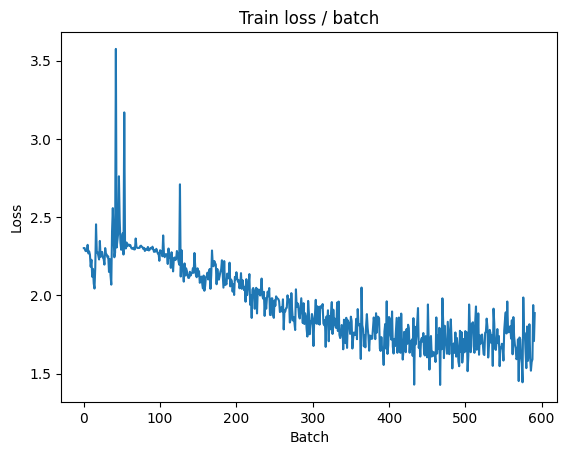


===============> Total time 24s	Avg loss 1.6933	Avg Prec@1 37.78 %	Avg Prec@5 87.94 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.8130 (1.8130)	Prec@1  35.9 ( 35.9)	Prec@5  86.7 ( 86.7)

===============> Total time 2s	Avg loss 1.7214	Avg Prec@1 37.44 %	Avg Prec@5 88.20 %



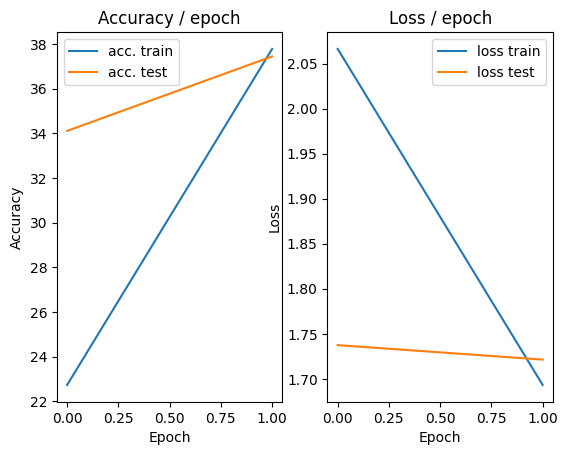

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 1.7546 (1.7546)	Prec@1  39.1 ( 39.1)	Prec@5  83.6 ( 83.6)


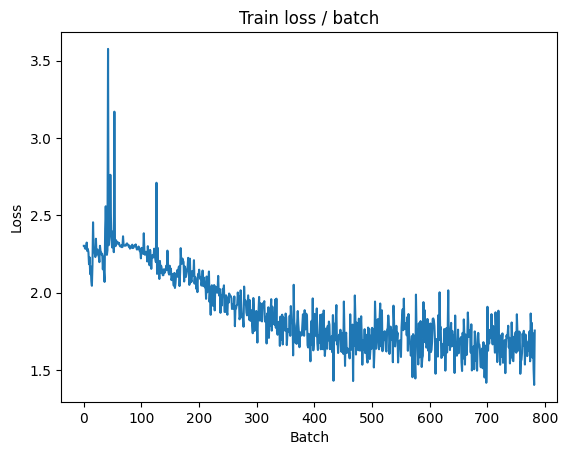

[TRAIN Batch 200/391]	Time 0.060s (0.063s)	Loss 1.6850 (1.6061)	Prec@1  37.5 ( 41.3)	Prec@5  86.7 ( 89.8)


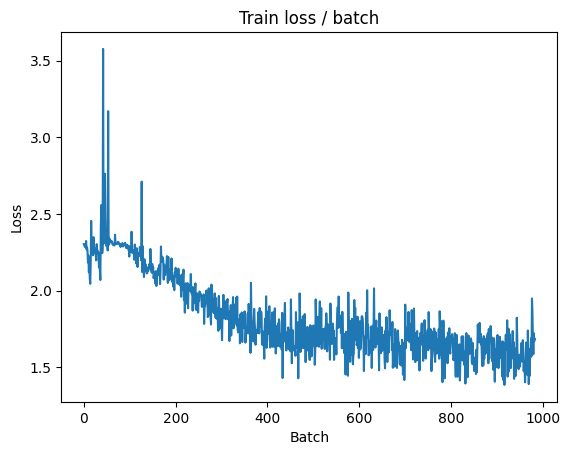


===============> Total time 24s	Avg loss 1.6025	Avg Prec@1 41.54 %	Avg Prec@5 89.90 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.6801 (1.6801)	Prec@1  40.6 ( 40.6)	Prec@5  89.8 ( 89.8)

===============> Total time 2s	Avg loss 1.5812	Avg Prec@1 42.52 %	Avg Prec@5 91.21 %



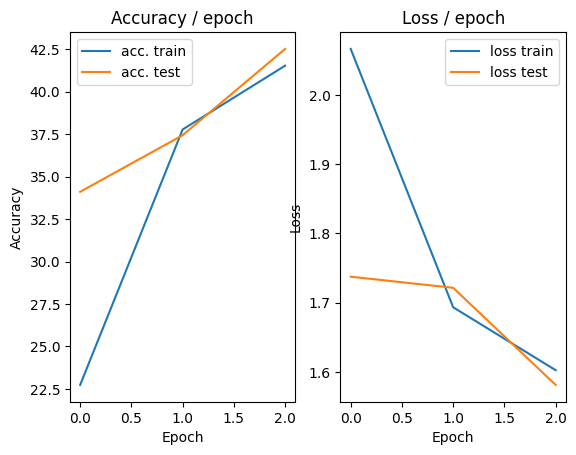

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 1.5147 (1.5147)	Prec@1  46.9 ( 46.9)	Prec@5  86.7 ( 86.7)


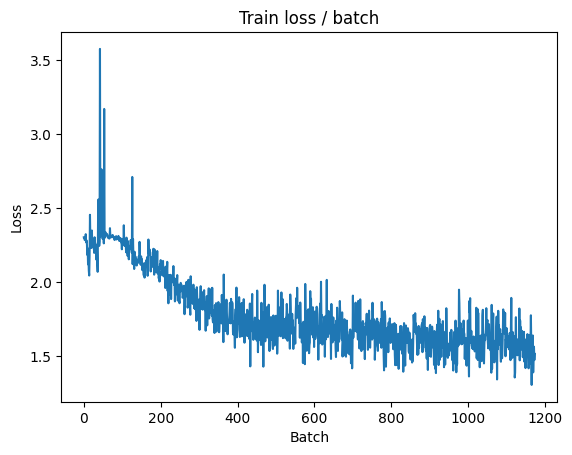

[TRAIN Batch 200/391]	Time 0.060s (0.062s)	Loss 1.3847 (1.5198)	Prec@1  51.6 ( 45.5)	Prec@5  87.5 ( 91.0)


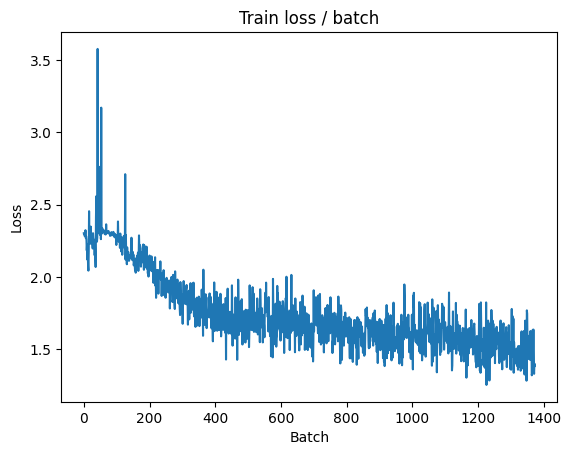


===============> Total time 24s	Avg loss 1.5061	Avg Prec@1 46.02 %	Avg Prec@5 91.26 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.5009 (1.5009)	Prec@1  47.7 ( 47.7)	Prec@5  90.6 ( 90.6)

===============> Total time 2s	Avg loss 1.4919	Avg Prec@1 46.79 %	Avg Prec@5 91.80 %



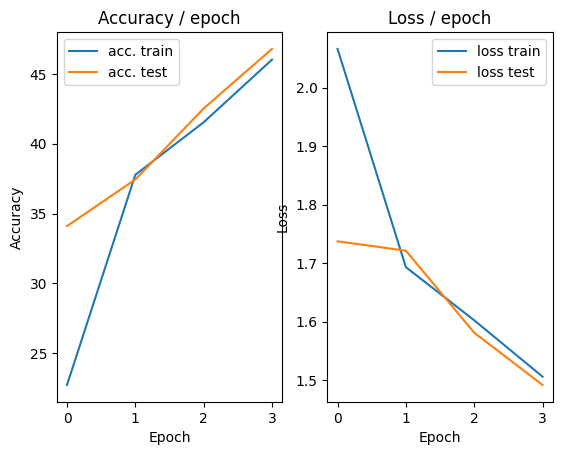

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 1.6437 (1.6437)	Prec@1  46.9 ( 46.9)	Prec@5  86.7 ( 86.7)


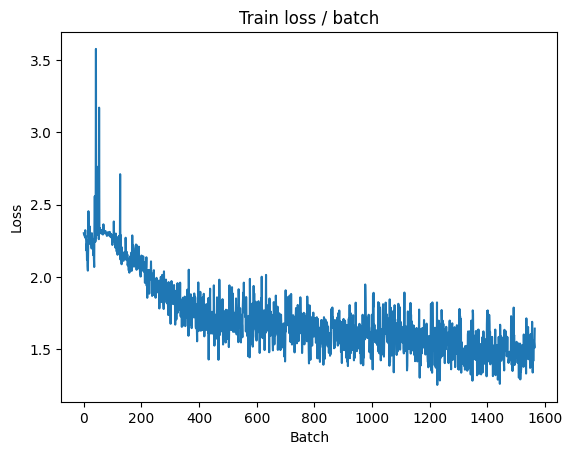

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 1.3455 (1.4642)	Prec@1  47.7 ( 47.8)	Prec@5  94.5 ( 91.7)


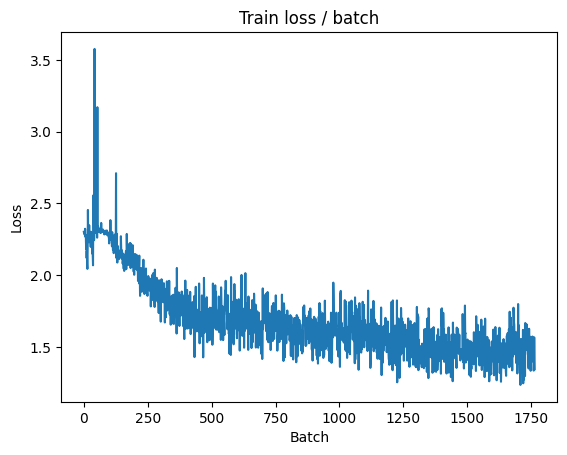


===============> Total time 24s	Avg loss 1.4857	Avg Prec@1 47.02 %	Avg Prec@5 91.46 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 1.5989 (1.5989)	Prec@1  34.4 ( 34.4)	Prec@5  89.8 ( 89.8)

===============> Total time 2s	Avg loss 1.5478	Avg Prec@1 42.28 %	Avg Prec@5 91.29 %



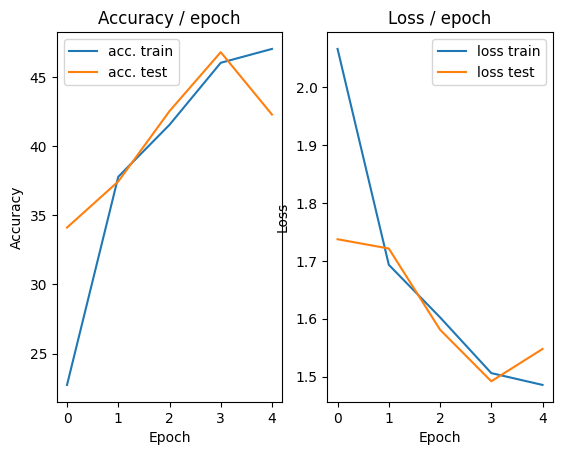

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 1.4093 (1.4093)	Prec@1  50.8 ( 50.8)	Prec@5  92.2 ( 92.2)


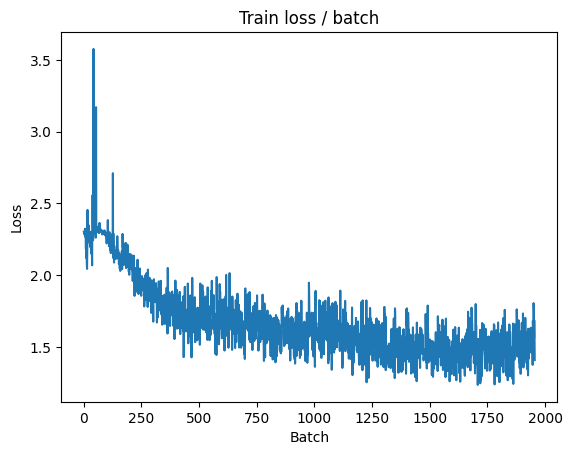

[TRAIN Batch 200/391]	Time 0.060s (0.062s)	Loss 1.5173 (1.4366)	Prec@1  49.2 ( 49.3)	Prec@5  90.6 ( 92.1)


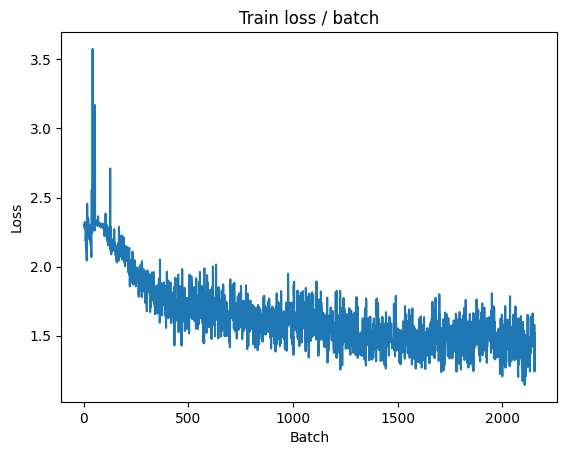


===============> Total time 23s	Avg loss 1.4326	Avg Prec@1 49.56 %	Avg Prec@5 92.21 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 1.4369 (1.4369)	Prec@1  50.8 ( 50.8)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.4355	Avg Prec@1 50.83 %	Avg Prec@5 93.03 %



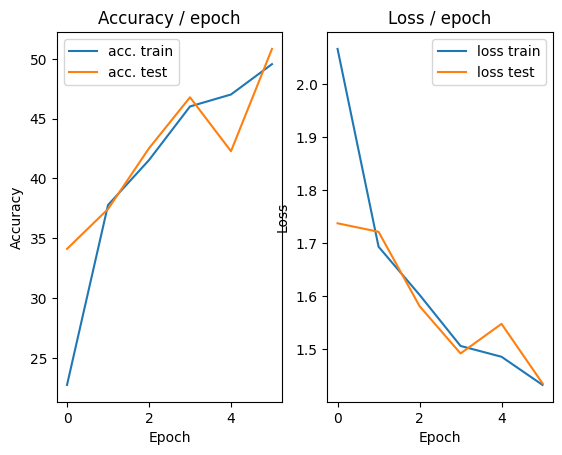

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 1.1426 (1.1426)	Prec@1  60.9 ( 60.9)	Prec@5  97.7 ( 97.7)


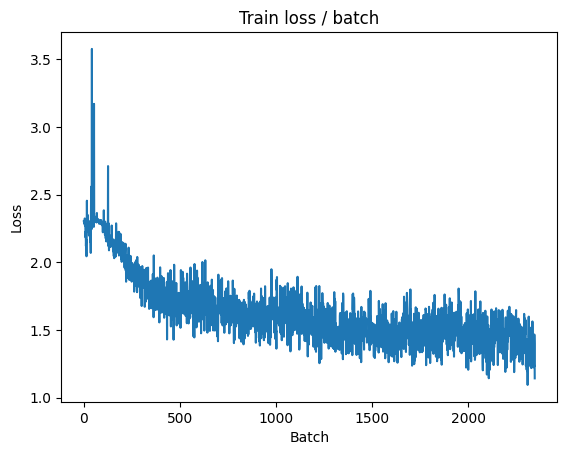

[TRAIN Batch 200/391]	Time 0.060s (0.062s)	Loss 1.4499 (1.3618)	Prec@1  46.1 ( 52.0)	Prec@5  89.8 ( 93.0)


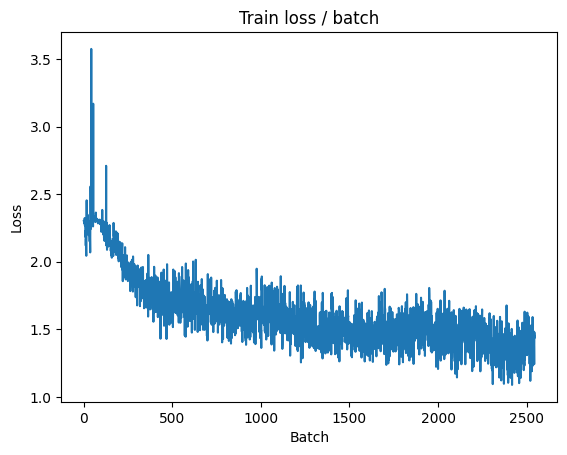


===============> Total time 24s	Avg loss 1.3569	Avg Prec@1 52.54 %	Avg Prec@5 93.10 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.3850 (1.3850)	Prec@1  51.6 ( 51.6)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.3812	Avg Prec@1 52.07 %	Avg Prec@5 92.62 %



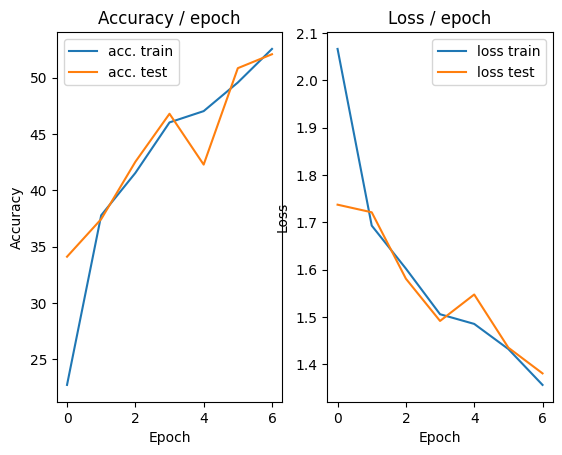

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 1.3701 (1.3701)	Prec@1  50.0 ( 50.0)	Prec@5  92.2 ( 92.2)


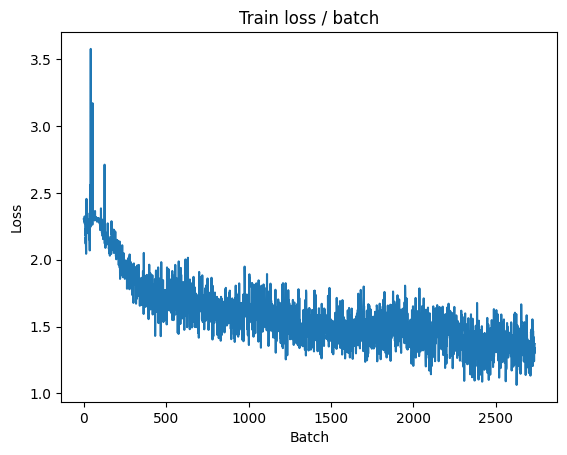

[TRAIN Batch 200/391]	Time 0.058s (0.062s)	Loss 1.2416 (1.3086)	Prec@1  56.2 ( 54.6)	Prec@5  93.8 ( 93.3)


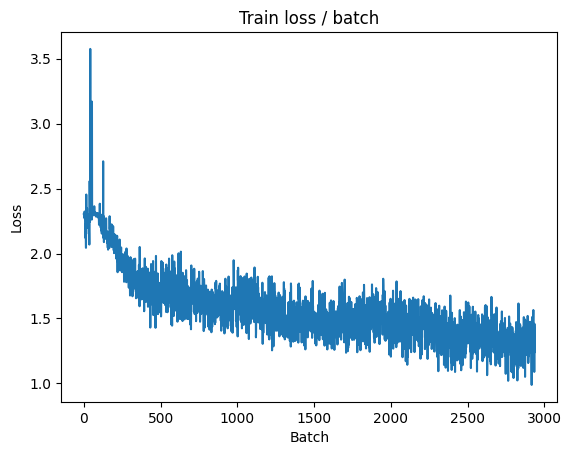


===============> Total time 24s	Avg loss 1.3048	Avg Prec@1 54.63 %	Avg Prec@5 93.52 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 1.4156 (1.4156)	Prec@1  50.8 ( 50.8)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.3146	Avg Prec@1 55.31 %	Avg Prec@5 93.71 %



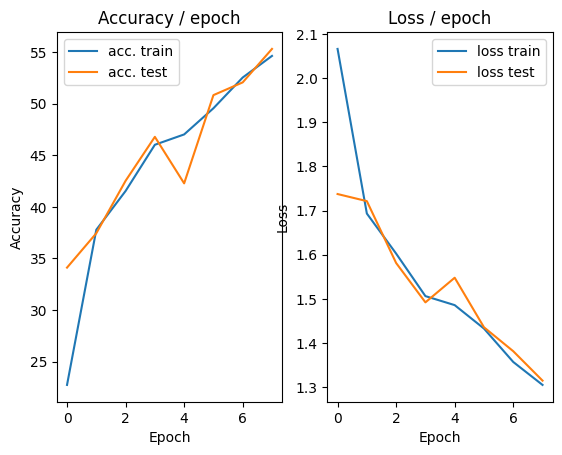

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 1.1228 (1.1228)	Prec@1  60.2 ( 60.2)	Prec@5  96.9 ( 96.9)


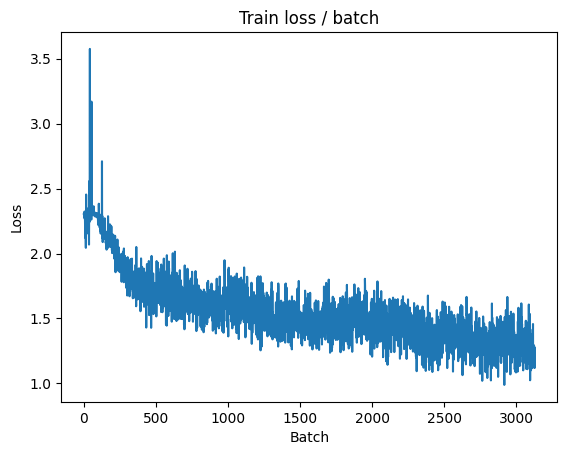

[TRAIN Batch 200/391]	Time 0.060s (0.062s)	Loss 1.1055 (1.2202)	Prec@1  59.4 ( 58.0)	Prec@5  96.1 ( 94.4)


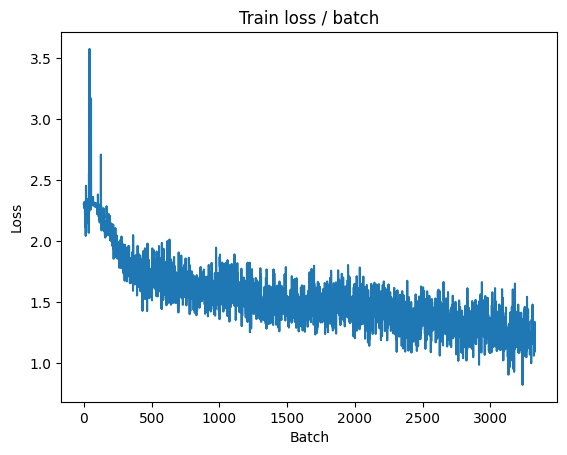


===============> Total time 24s	Avg loss 1.2317	Avg Prec@1 57.74 %	Avg Prec@5 94.23 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 1.4666 (1.4666)	Prec@1  49.2 ( 49.2)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.3216	Avg Prec@1 56.20 %	Avg Prec@5 93.15 %



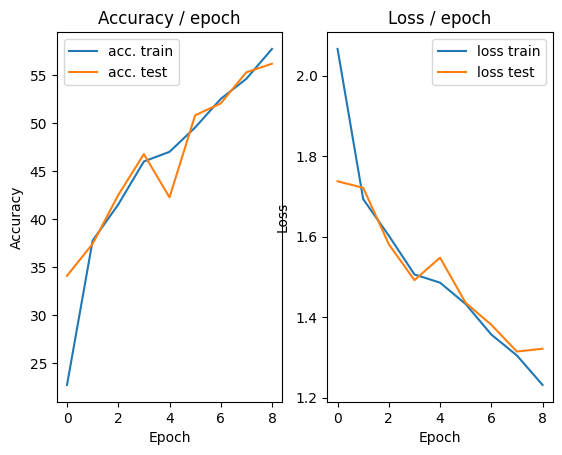

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 1.0795 (1.0795)	Prec@1  67.2 ( 67.2)	Prec@5  94.5 ( 94.5)


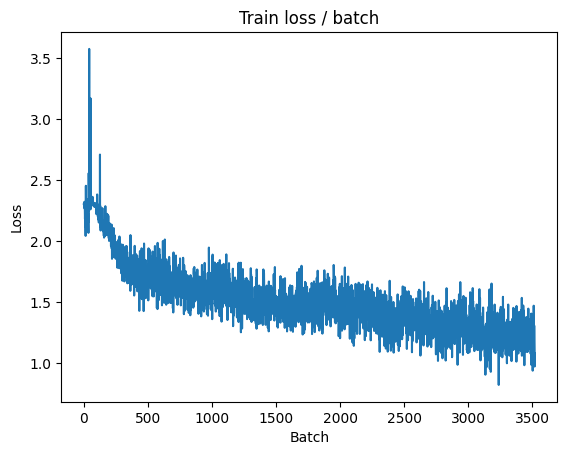

[TRAIN Batch 200/391]	Time 0.060s (0.062s)	Loss 1.0901 (1.1915)	Prec@1  59.4 ( 59.5)	Prec@5  96.9 ( 94.7)


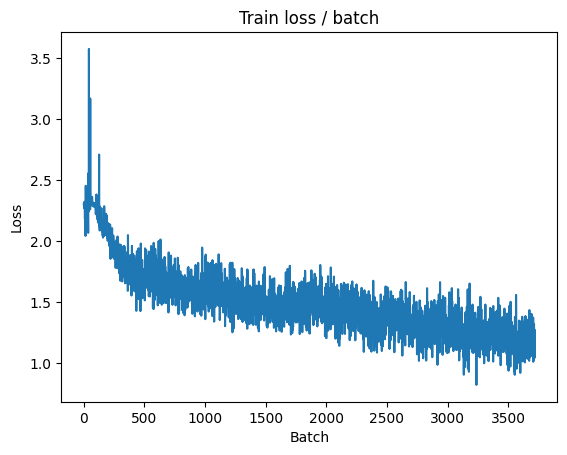


===============> Total time 24s	Avg loss 1.1877	Avg Prec@1 59.59 %	Avg Prec@5 94.71 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.2272 (1.2272)	Prec@1  61.7 ( 61.7)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.2004	Avg Prec@1 59.79 %	Avg Prec@5 95.03 %



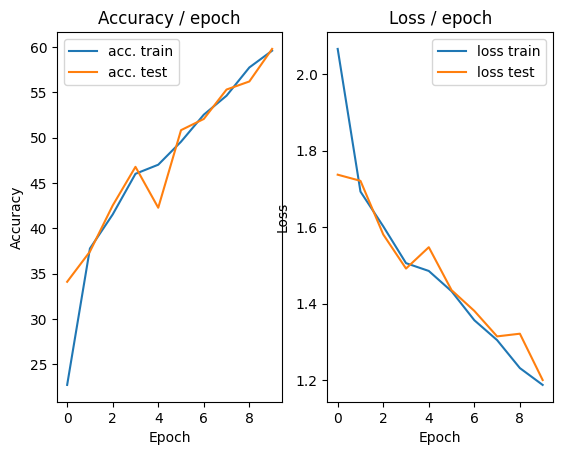

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.8707 (0.8707)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)


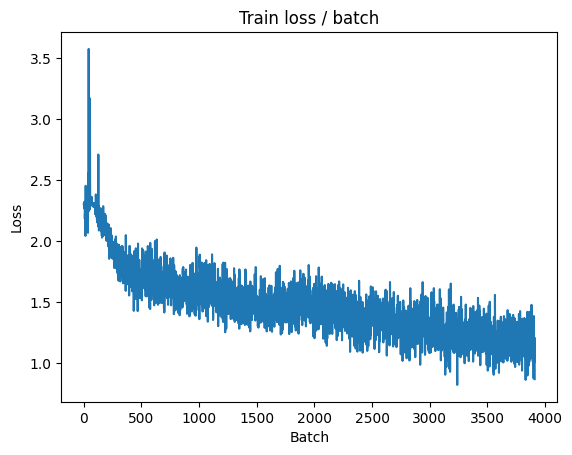

[TRAIN Batch 200/391]	Time 0.060s (0.062s)	Loss 1.1895 (1.1143)	Prec@1  58.6 ( 62.0)	Prec@5  91.4 ( 95.0)


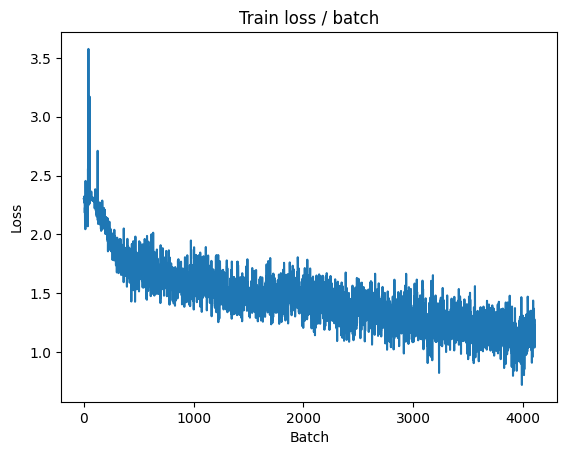


===============> Total time 24s	Avg loss 1.1292	Avg Prec@1 61.62 %	Avg Prec@5 95.12 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 1.1603 (1.1603)	Prec@1  60.2 ( 60.2)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.2565	Avg Prec@1 57.35 %	Avg Prec@5 93.96 %



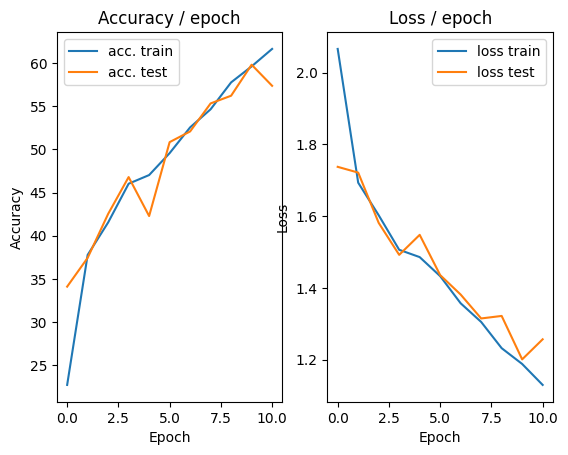

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.2934 (1.2934)	Prec@1  53.1 ( 53.1)	Prec@5  95.3 ( 95.3)


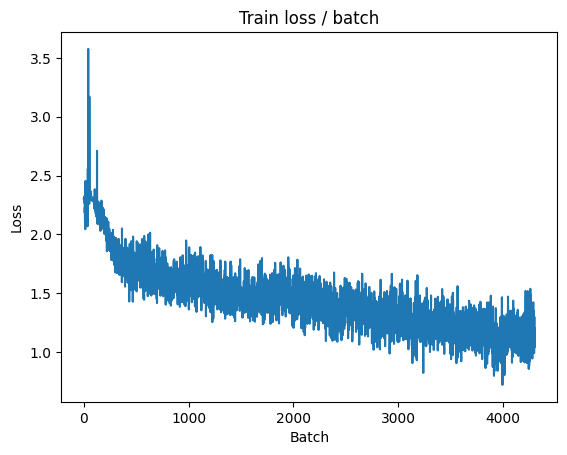

[TRAIN Batch 200/391]	Time 0.059s (0.062s)	Loss 1.3792 (1.0644)	Prec@1  55.5 ( 64.1)	Prec@5  94.5 ( 95.8)


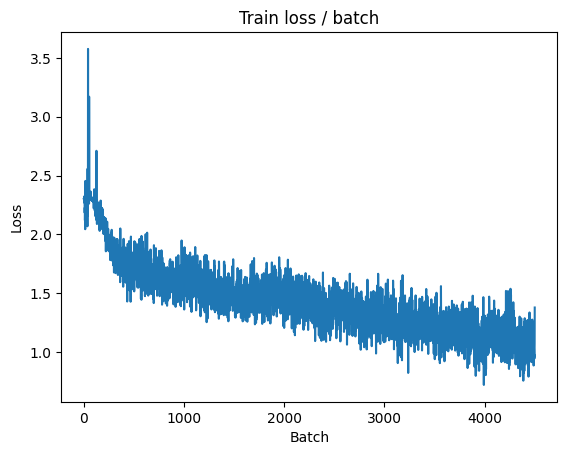


===============> Total time 24s	Avg loss 1.0851	Avg Prec@1 63.61 %	Avg Prec@5 95.54 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.1365 (1.1365)	Prec@1  66.4 ( 66.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.1928	Avg Prec@1 61.95 %	Avg Prec@5 94.96 %



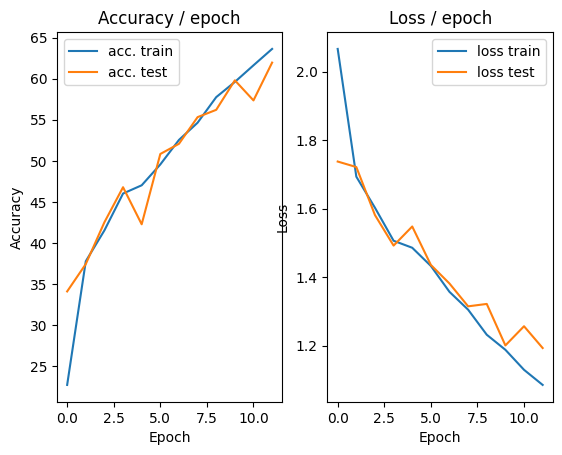

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.9130 (0.9130)	Prec@1  65.6 ( 65.6)	Prec@5  98.4 ( 98.4)


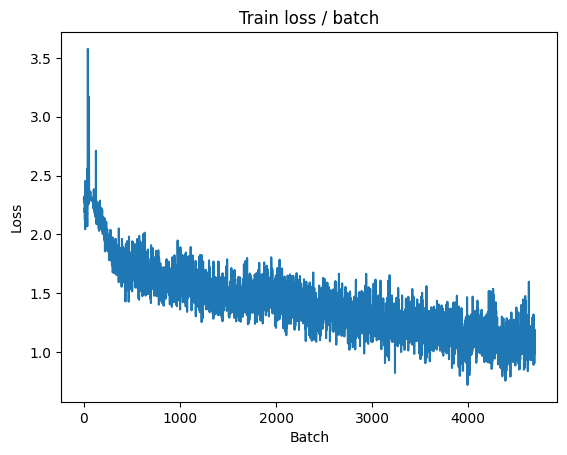

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 1.0944 (0.9970)	Prec@1  62.5 ( 65.9)	Prec@5  97.7 ( 96.3)


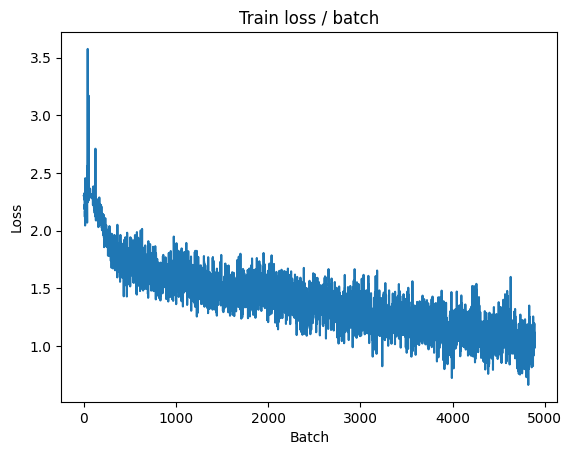


===============> Total time 24s	Avg loss 1.0117	Avg Prec@1 65.74 %	Avg Prec@5 96.17 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 1.2628 (1.2628)	Prec@1  60.9 ( 60.9)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2647	Avg Prec@1 60.86 %	Avg Prec@5 94.61 %



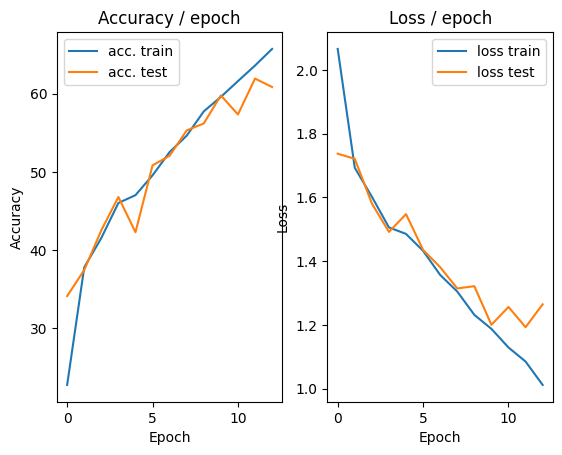

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.113s (0.113s)	Loss 0.8964 (0.8964)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)


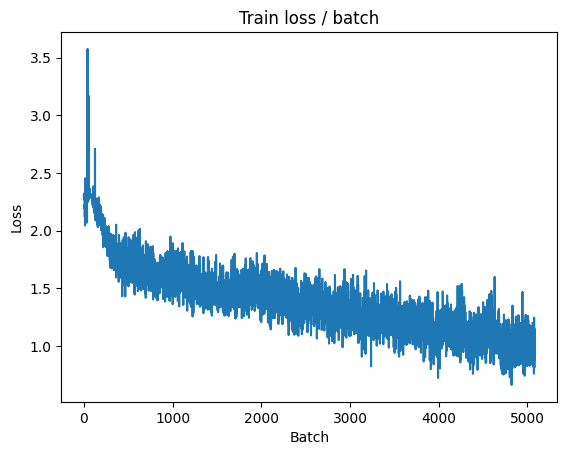

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 0.8940 (0.9177)	Prec@1  69.5 ( 69.3)	Prec@5  96.1 ( 97.0)


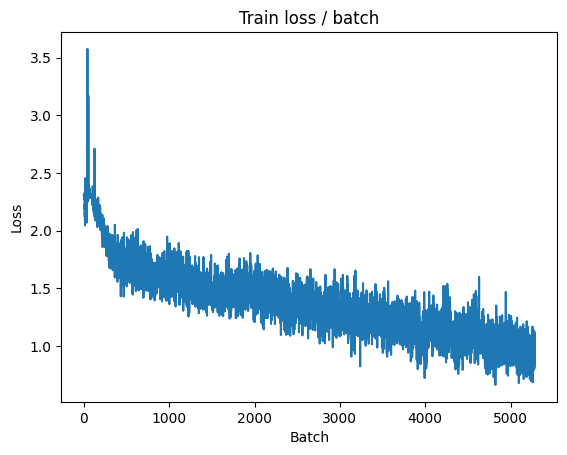


===============> Total time 24s	Avg loss 0.9361	Avg Prec@1 68.51 %	Avg Prec@5 96.72 %

[EVAL Batch 000/079]	Time 0.100s (0.100s)	Loss 1.2882 (1.2882)	Prec@1  61.7 ( 61.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.2362	Avg Prec@1 61.99 %	Avg Prec@5 95.27 %



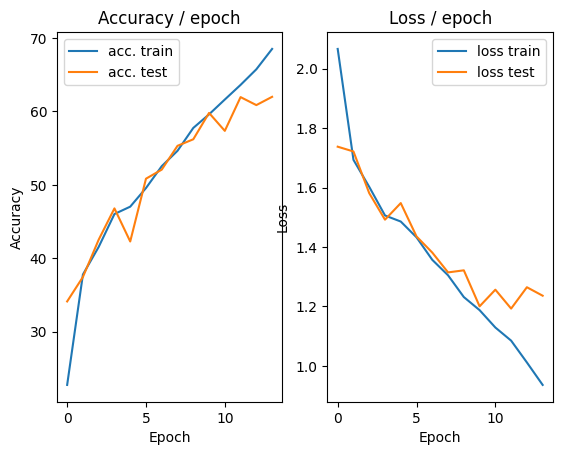

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.8254 (0.8254)	Prec@1  65.6 ( 65.6)	Prec@5  98.4 ( 98.4)


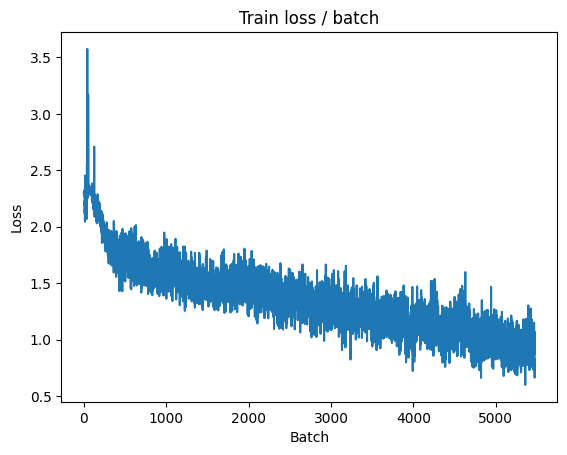

[TRAIN Batch 200/391]	Time 0.059s (0.062s)	Loss 1.1289 (0.8485)	Prec@1  63.3 ( 71.6)	Prec@5  94.5 ( 97.3)


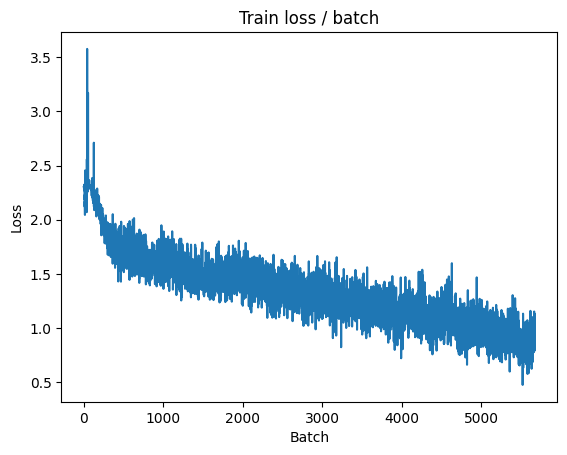


===============> Total time 24s	Avg loss 0.8926	Avg Prec@1 70.14 %	Avg Prec@5 96.93 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 1.1853 (1.1853)	Prec@1  61.7 ( 61.7)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.2083	Avg Prec@1 62.13 %	Avg Prec@5 94.32 %



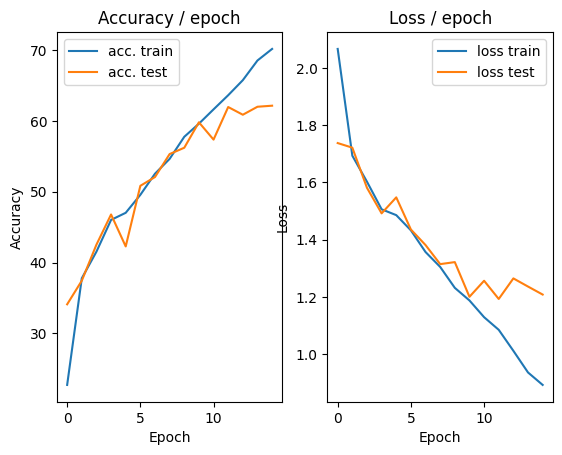

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.8434 (0.8434)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)


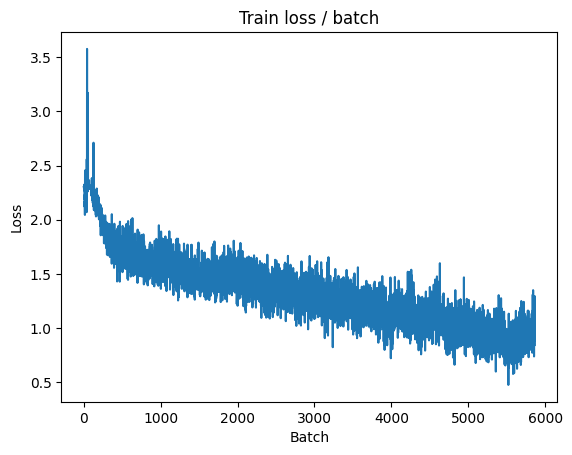

[TRAIN Batch 200/391]	Time 0.061s (0.063s)	Loss 0.8110 (0.7816)	Prec@1  70.3 ( 73.5)	Prec@5  97.7 ( 97.9)


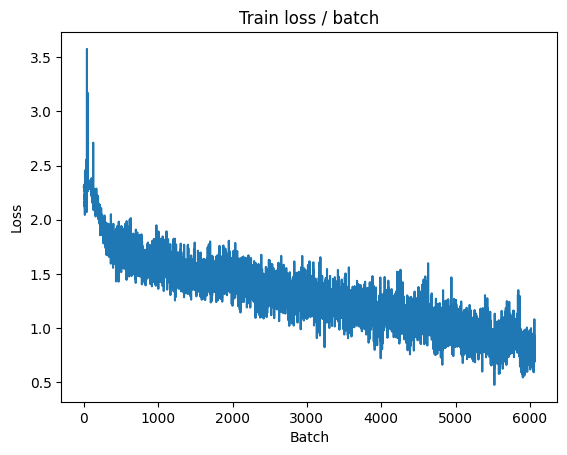


===============> Total time 24s	Avg loss 0.8400	Avg Prec@1 71.96 %	Avg Prec@5 97.37 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.2125 (1.2125)	Prec@1  64.8 ( 64.8)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.2134	Avg Prec@1 64.08 %	Avg Prec@5 94.76 %



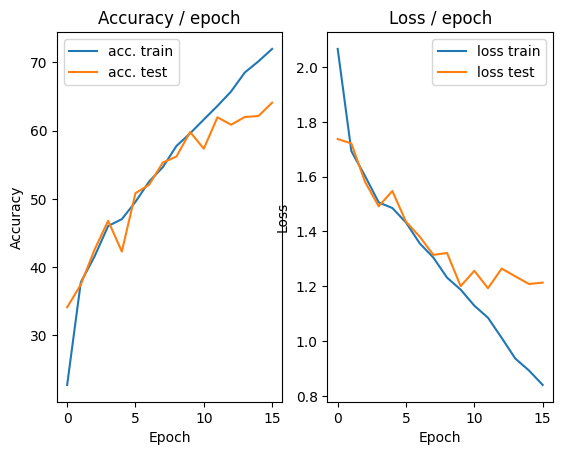

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.7512 (0.7512)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)


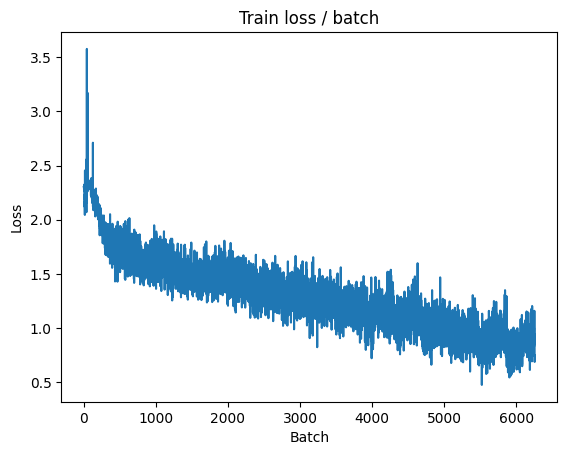

[TRAIN Batch 200/391]	Time 0.063s (0.063s)	Loss 0.7692 (0.7341)	Prec@1  75.0 ( 75.8)	Prec@5  98.4 ( 97.9)


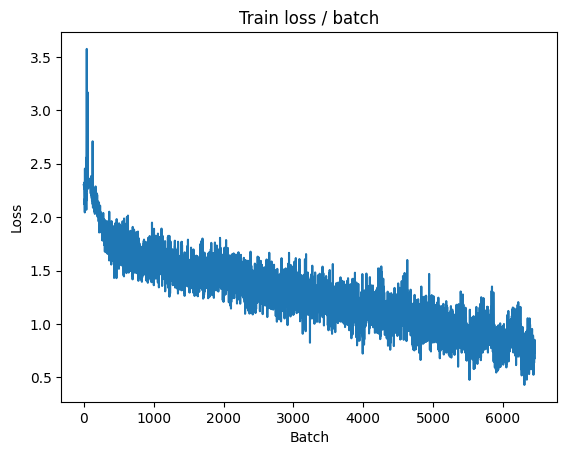


===============> Total time 24s	Avg loss 0.7565	Avg Prec@1 75.08 %	Avg Prec@5 97.80 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.1909 (1.1909)	Prec@1  63.3 ( 63.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2398	Avg Prec@1 62.73 %	Avg Prec@5 94.91 %



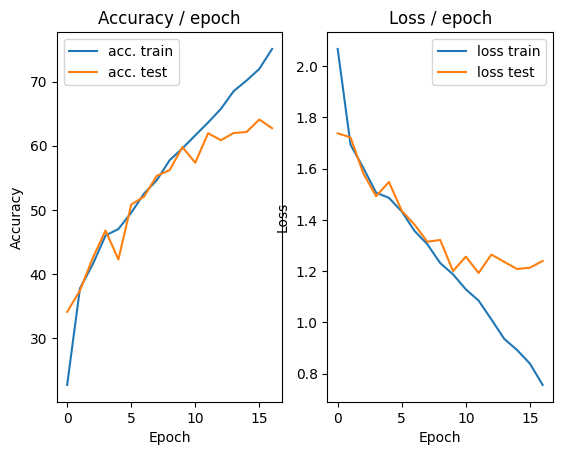

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.107s (0.107s)	Loss 0.6848 (0.6848)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)


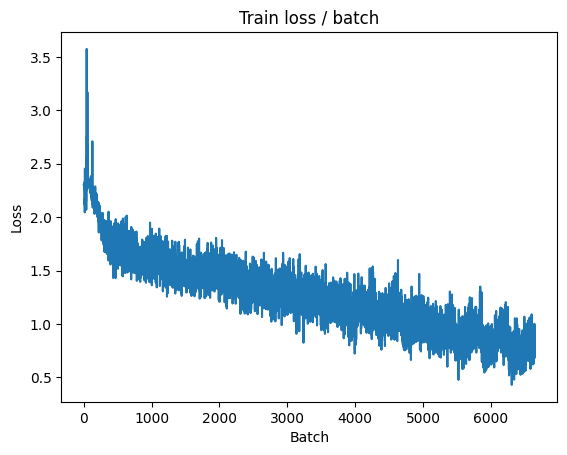

[TRAIN Batch 200/391]	Time 0.061s (0.062s)	Loss 0.7500 (0.6801)	Prec@1  69.5 ( 77.3)	Prec@5  98.4 ( 98.3)


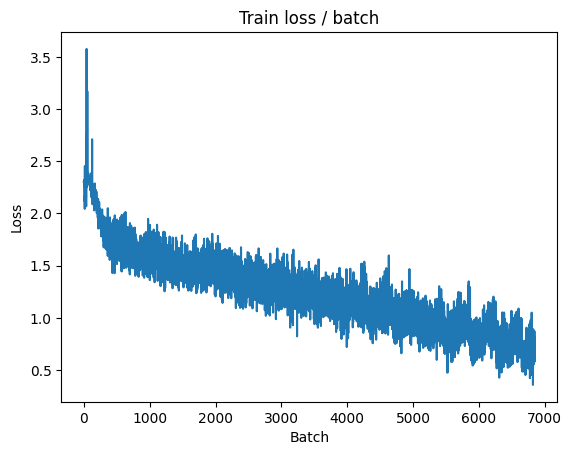


===============> Total time 24s	Avg loss 0.7130	Avg Prec@1 76.35 %	Avg Prec@5 98.21 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 1.3225 (1.3225)	Prec@1  60.9 ( 60.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.2640	Avg Prec@1 64.95 %	Avg Prec@5 95.32 %



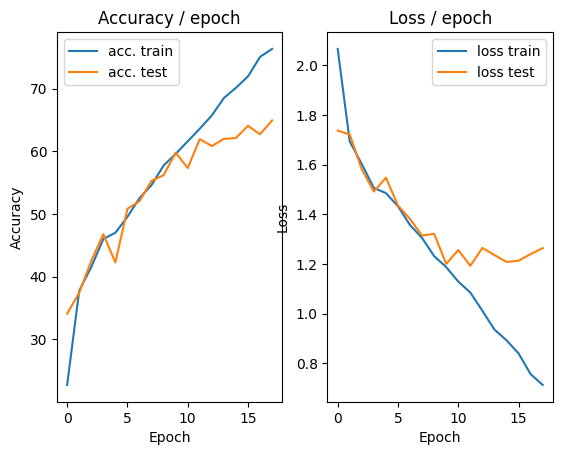

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.4567 (0.4567)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)


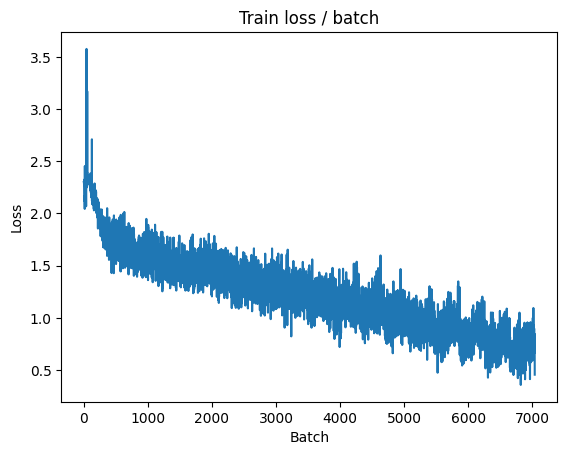

[TRAIN Batch 200/391]	Time 0.060s (0.063s)	Loss 0.5537 (0.5896)	Prec@1  78.9 ( 80.3)	Prec@5  98.4 ( 98.7)


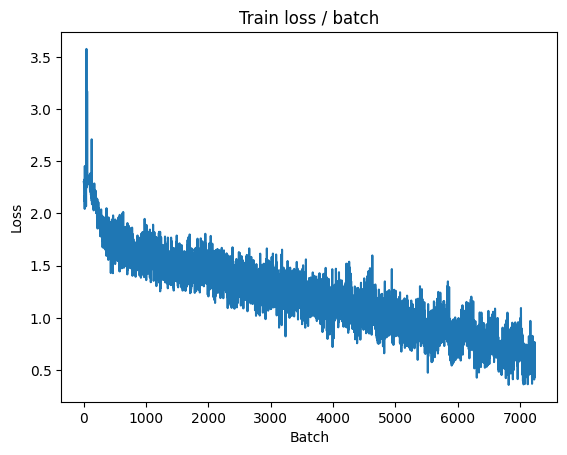


===============> Total time 24s	Avg loss 0.6159	Avg Prec@1 79.46 %	Avg Prec@5 98.58 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 1.2589 (1.2589)	Prec@1  71.9 ( 71.9)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.3244	Avg Prec@1 65.04 %	Avg Prec@5 95.05 %



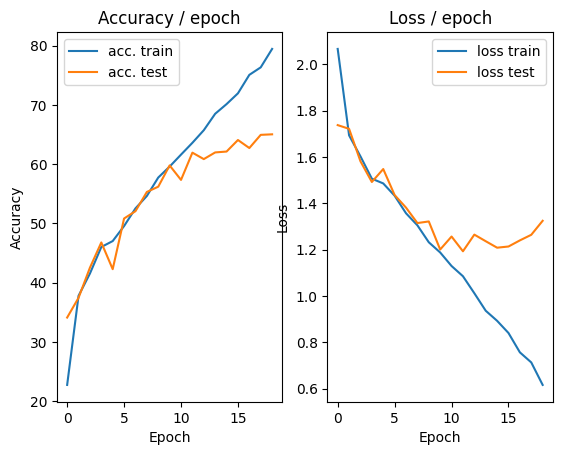

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 0.4976 (0.4976)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)


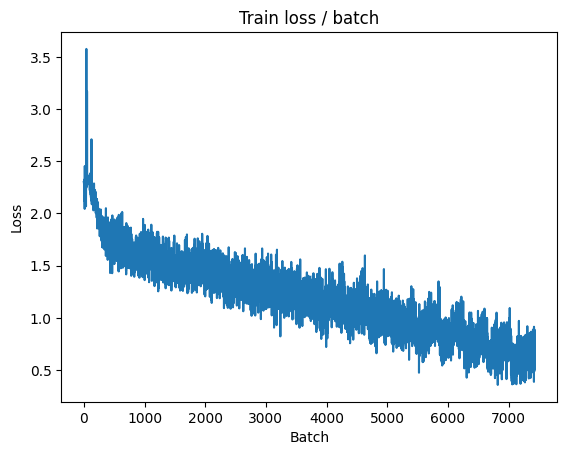

[TRAIN Batch 200/391]	Time 0.060s (0.063s)	Loss 0.7301 (0.5118)	Prec@1  75.8 ( 83.2)	Prec@5  99.2 ( 99.0)


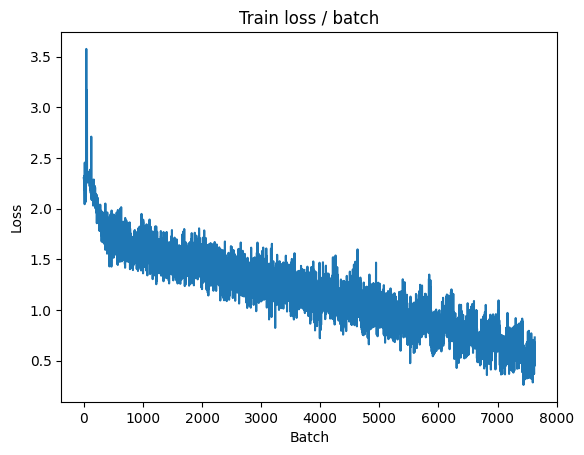


===============> Total time 24s	Avg loss 0.5597	Avg Prec@1 81.56 %	Avg Prec@5 98.85 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 1.2972 (1.2972)	Prec@1  71.9 ( 71.9)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.4156	Avg Prec@1 65.16 %	Avg Prec@5 95.05 %



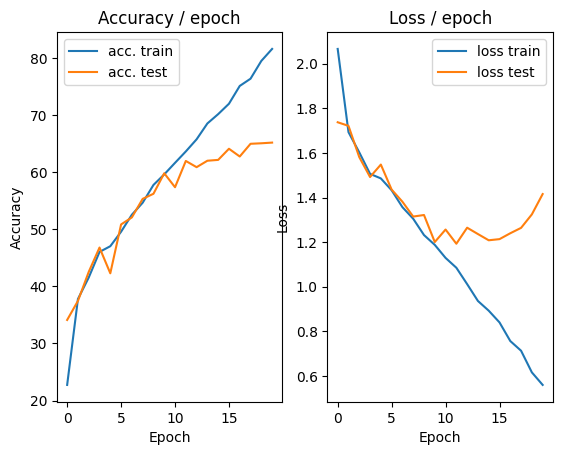

In [16]:
main(batch_size, lr, epochs, cuda=True)

### 3.4 Regularization of the network by *dropout*
**Implementation** : Add a dropout layer between $\texttt{fc4}$ and $\texttt{fc5}$.

In [17]:
# The former version before bonus
def main(batch_size=128, lr=0.1, epochs=5, cuda=False, download=False):

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    # Create learning rate scheduler
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda, download)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        # Modify the learning rate after each epoch
        lr_sched.step()

class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),     
            nn.ReLU(),
            nn.MaxPool2d((2,2),stride=2,padding=0),            

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),    
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),         

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),     
            nn.ReLU(),

            # Set ceil_mode=True to increase the feature map size in the pooling layer, compensating for the information loss caused by cropping.
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode = True),         
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(4*4*64, 1000),
            nn.ReLU(),
            # the drop out layer
            nn.Dropout(p=0.5),
            nn.Linear(1000, 10),
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 2.504s (2.504s)	Loss 2.3052 (2.3052)	Prec@1   5.5 (  5.5)	Prec@5  49.2 ( 49.2)


<Figure size 640x480 with 0 Axes>

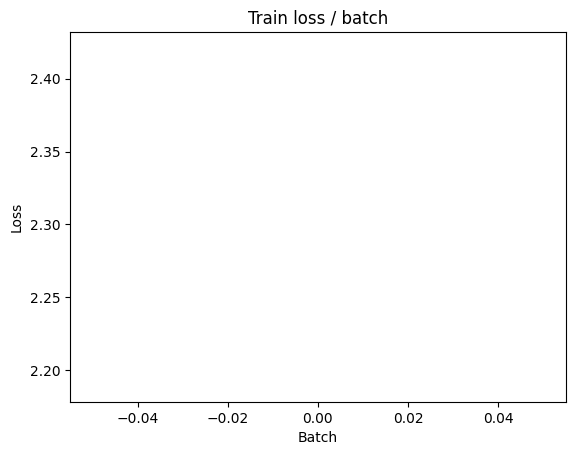

[TRAIN Batch 200/391]	Time 0.056s (0.068s)	Loss 1.8509 (1.9672)	Prec@1  32.8 ( 27.8)	Prec@5  86.7 ( 78.5)


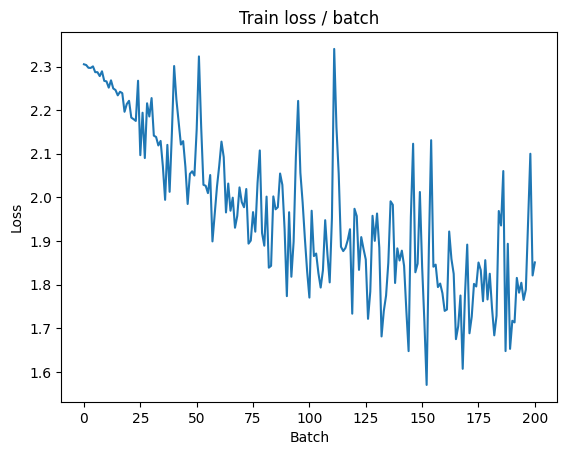


===============> Total time 25s	Avg loss 1.8108	Avg Prec@1 33.85 %	Avg Prec@5 83.75 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 1.4484 (1.4484)	Prec@1  53.9 ( 53.9)	Prec@5  92.2 ( 92.2)

===============> Total time 2s	Avg loss 1.4314	Avg Prec@1 47.95 %	Avg Prec@5 92.84 %



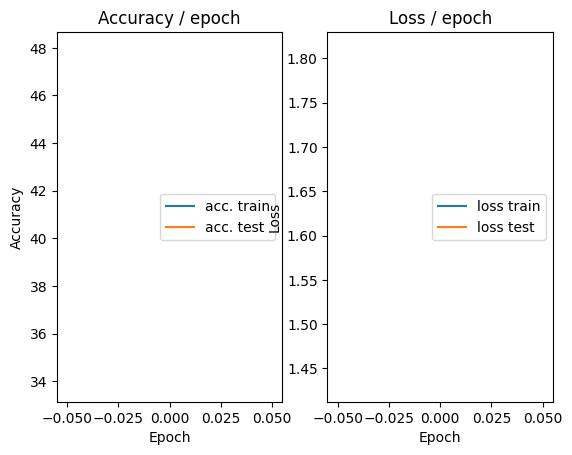

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 1.6019 (1.6019)	Prec@1  40.6 ( 40.6)	Prec@5  88.3 ( 88.3)


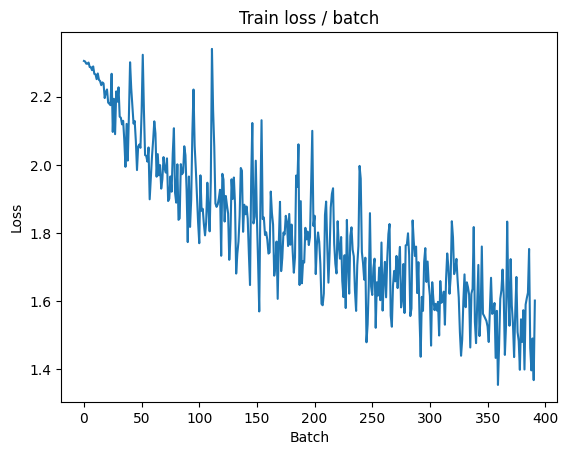

[TRAIN Batch 200/391]	Time 0.054s (0.058s)	Loss 1.3642 (1.4675)	Prec@1  53.1 ( 47.3)	Prec@5  95.3 ( 92.2)


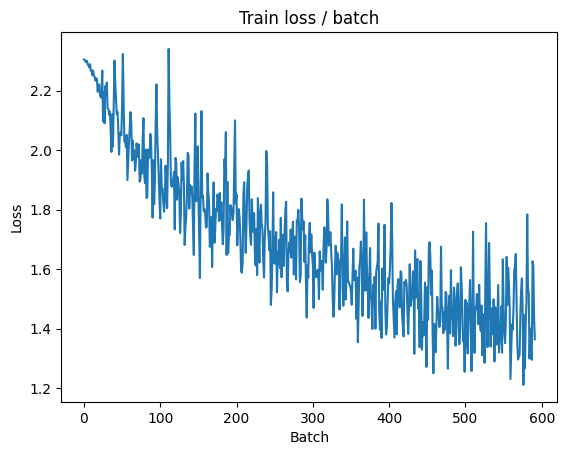


===============> Total time 22s	Avg loss 1.4103	Avg Prec@1 49.65 %	Avg Prec@5 92.87 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 1.1570 (1.1570)	Prec@1  63.3 ( 63.3)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.1991	Avg Prec@1 57.56 %	Avg Prec@5 95.12 %



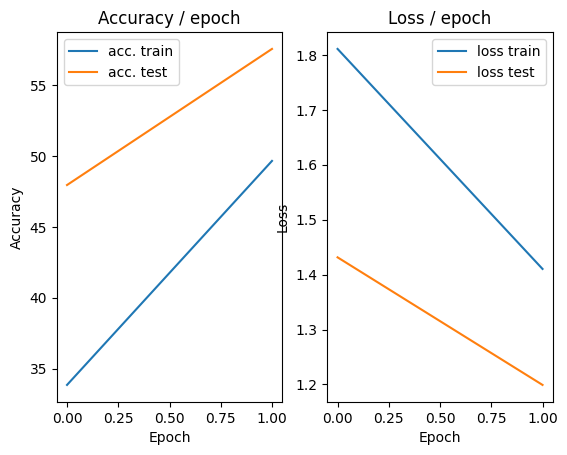

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 1.2497 (1.2497)	Prec@1  55.5 ( 55.5)	Prec@5  90.6 ( 90.6)


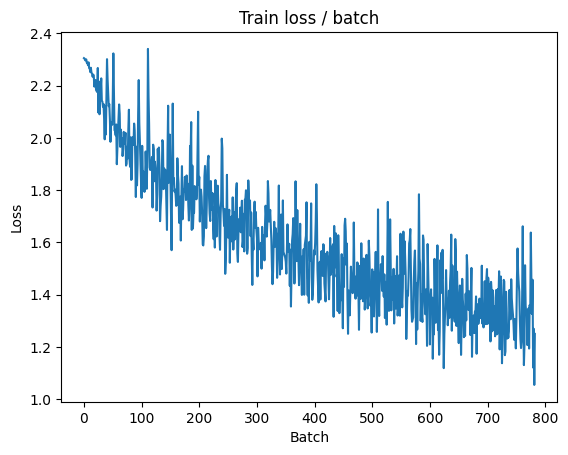

[TRAIN Batch 200/391]	Time 0.055s (0.057s)	Loss 1.2676 (1.2467)	Prec@1  53.1 ( 56.0)	Prec@5  97.7 ( 94.8)


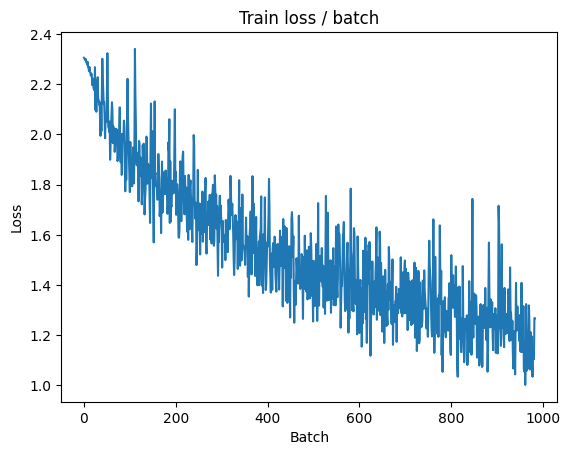


===============> Total time 22s	Avg loss 1.2074	Avg Prec@1 57.36 %	Avg Prec@5 95.17 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 1.1433 (1.1433)	Prec@1  55.5 ( 55.5)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1377	Avg Prec@1 60.00 %	Avg Prec@5 95.75 %



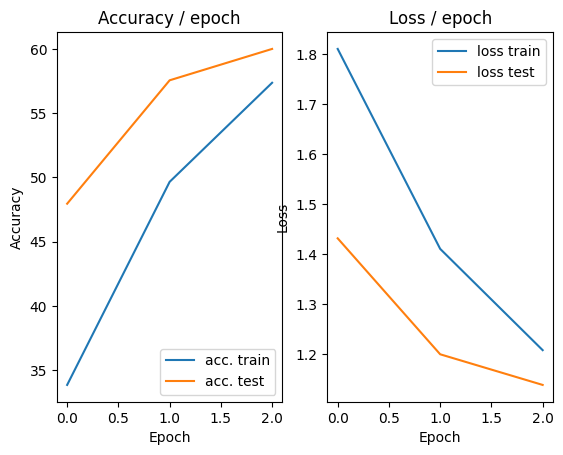

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 1.1417 (1.1417)	Prec@1  57.8 ( 57.8)	Prec@5  93.0 ( 93.0)


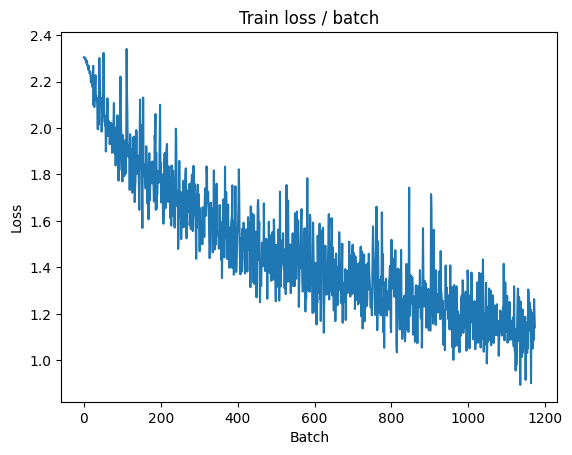

[TRAIN Batch 200/391]	Time 0.053s (0.057s)	Loss 1.0877 (1.0834)	Prec@1  56.2 ( 61.8)	Prec@5  96.1 ( 96.1)


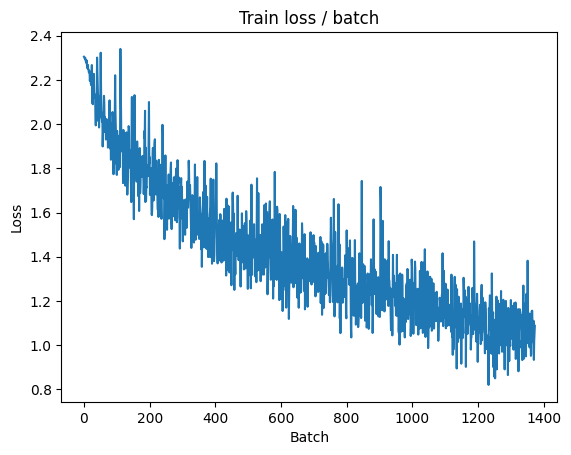


===============> Total time 22s	Avg loss 1.0609	Avg Prec@1 62.77 %	Avg Prec@5 96.24 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 0.9020 (0.9020)	Prec@1  74.2 ( 74.2)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9705	Avg Prec@1 66.59 %	Avg Prec@5 96.63 %



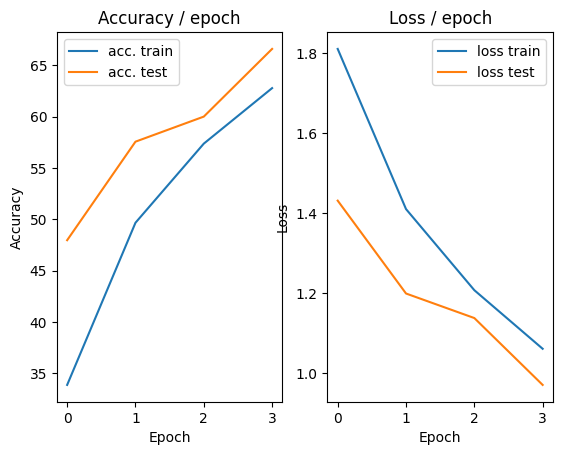

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 1.0271 (1.0271)	Prec@1  62.5 ( 62.5)	Prec@5  96.9 ( 96.9)


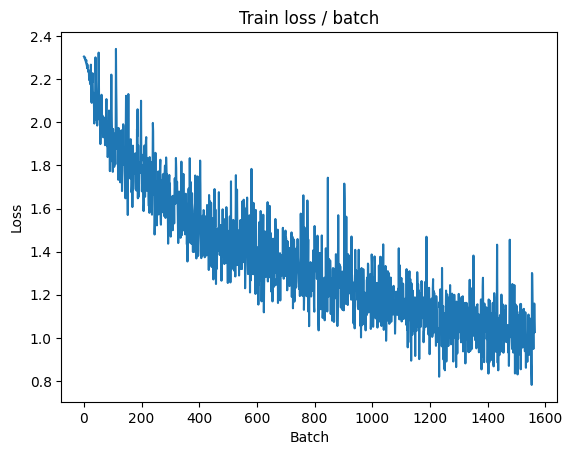

[TRAIN Batch 200/391]	Time 0.056s (0.057s)	Loss 1.1943 (0.9681)	Prec@1  63.3 ( 66.0)	Prec@5  96.1 ( 97.1)


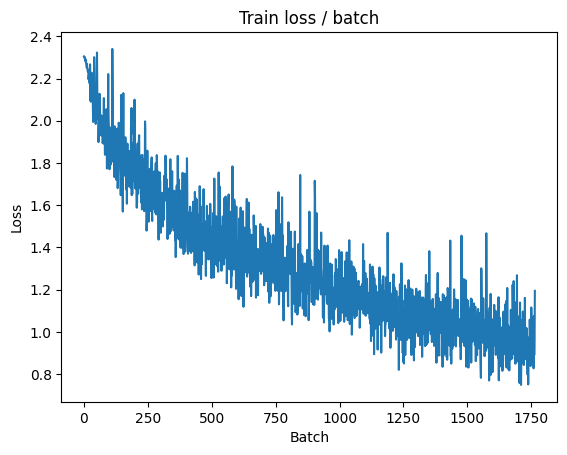


===============> Total time 22s	Avg loss 0.9577	Avg Prec@1 66.49 %	Avg Prec@5 97.10 %

[EVAL Batch 000/079]	Time 0.100s (0.100s)	Loss 0.7586 (0.7586)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8963	Avg Prec@1 68.62 %	Avg Prec@5 97.20 %



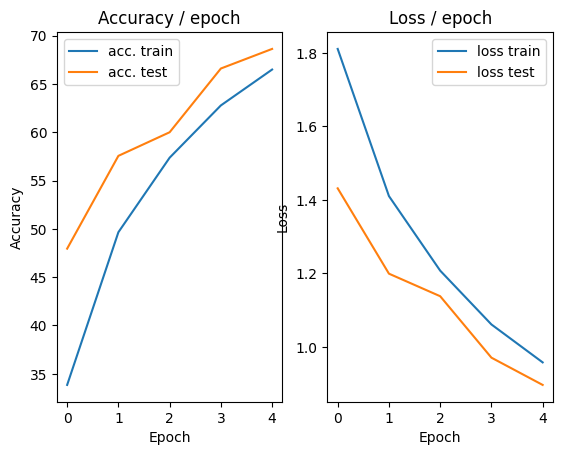

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 1.0768 (1.0768)	Prec@1  60.9 ( 60.9)	Prec@5  97.7 ( 97.7)


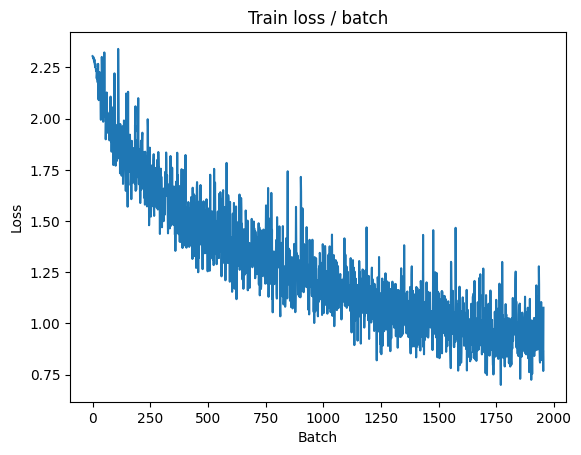

[TRAIN Batch 200/391]	Time 0.058s (0.057s)	Loss 0.9652 (0.8868)	Prec@1  69.5 ( 69.1)	Prec@5  96.9 ( 97.6)


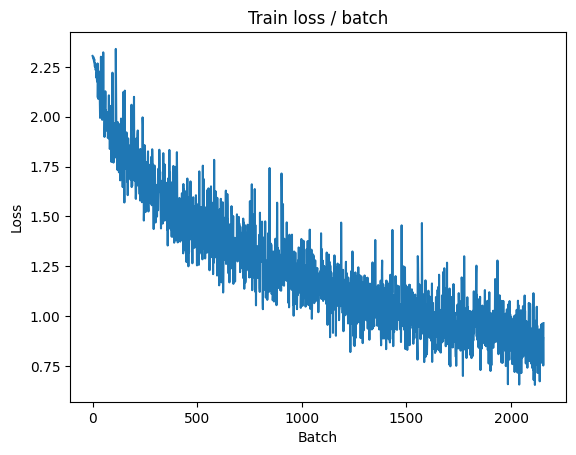


===============> Total time 22s	Avg loss 0.8785	Avg Prec@1 69.41 %	Avg Prec@5 97.53 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 0.7476 (0.7476)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8479	Avg Prec@1 70.41 %	Avg Prec@5 97.57 %



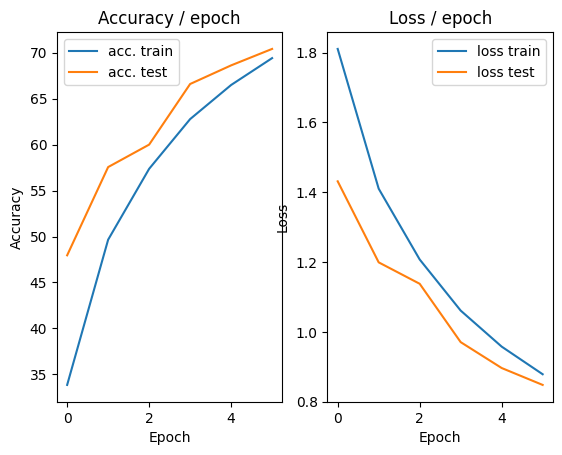

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.9481 (0.9481)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)


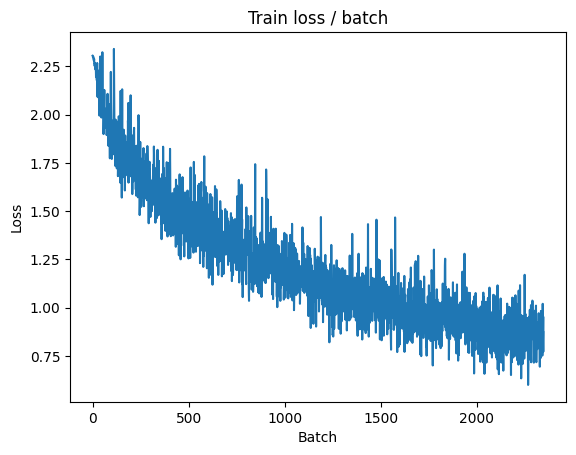

[TRAIN Batch 200/391]	Time 0.057s (0.057s)	Loss 0.8734 (0.8237)	Prec@1  70.3 ( 71.3)	Prec@5  98.4 ( 97.9)


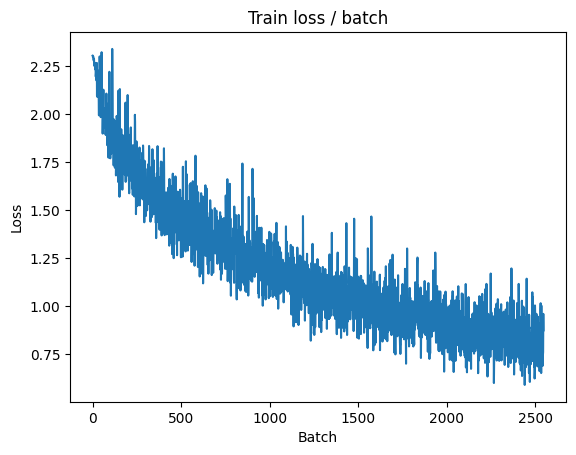


===============> Total time 22s	Avg loss 0.8153	Avg Prec@1 71.62 %	Avg Prec@5 97.90 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.9332 (0.9332)	Prec@1  64.8 ( 64.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9022	Avg Prec@1 69.33 %	Avg Prec@5 96.48 %



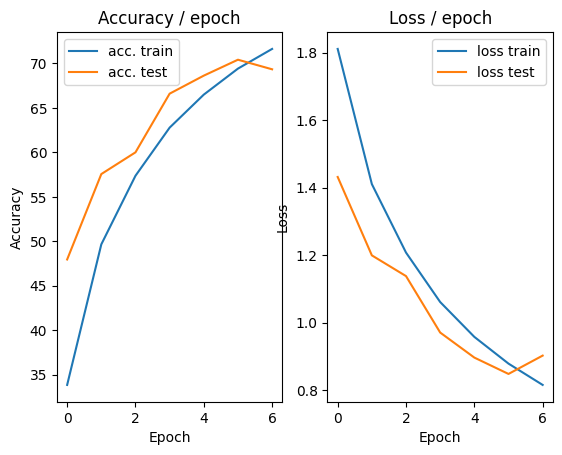

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.8338 (0.8338)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)


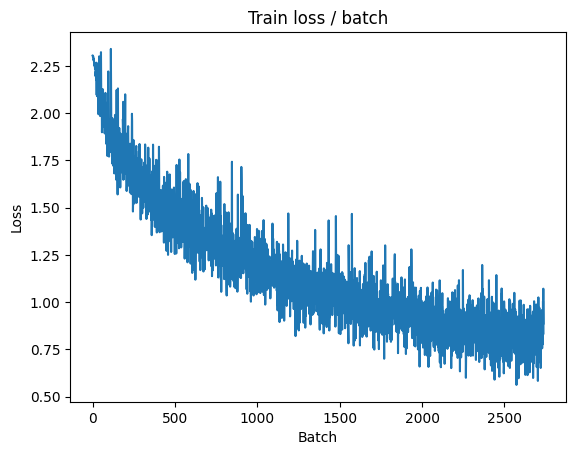

[TRAIN Batch 200/391]	Time 0.055s (0.057s)	Loss 0.8351 (0.7737)	Prec@1  72.7 ( 73.3)	Prec@5  96.9 ( 98.0)


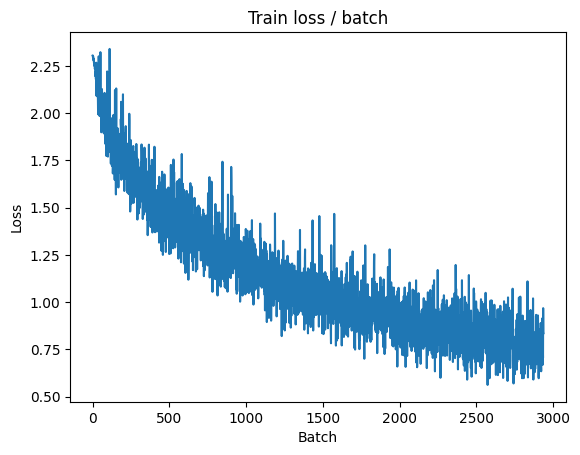


===============> Total time 22s	Avg loss 0.7691	Avg Prec@1 73.37 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.6131 (0.6131)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7075	Avg Prec@1 75.57 %	Avg Prec@5 98.39 %



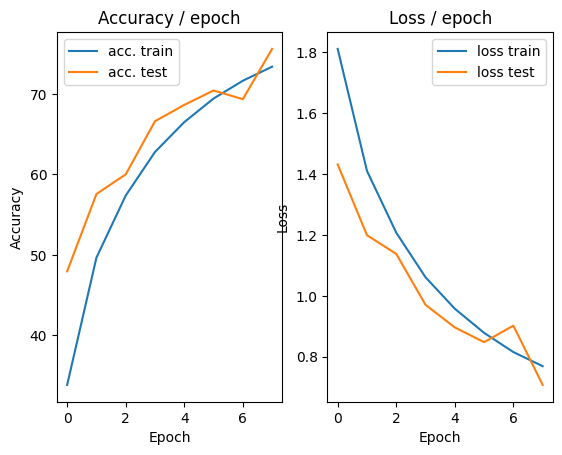

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.8038 (0.8038)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)


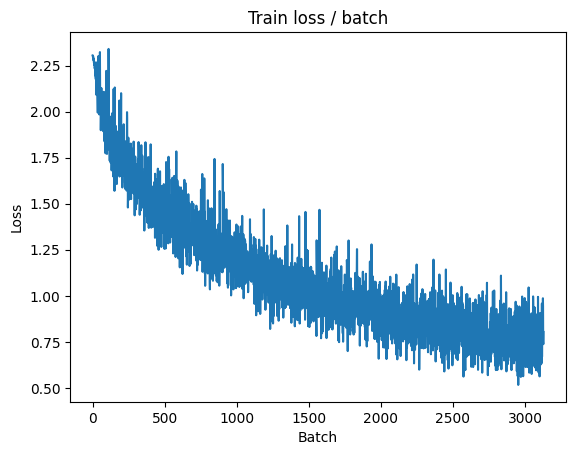

[TRAIN Batch 200/391]	Time 0.055s (0.057s)	Loss 0.6680 (0.7263)	Prec@1  71.9 ( 74.8)	Prec@5  98.4 ( 98.2)


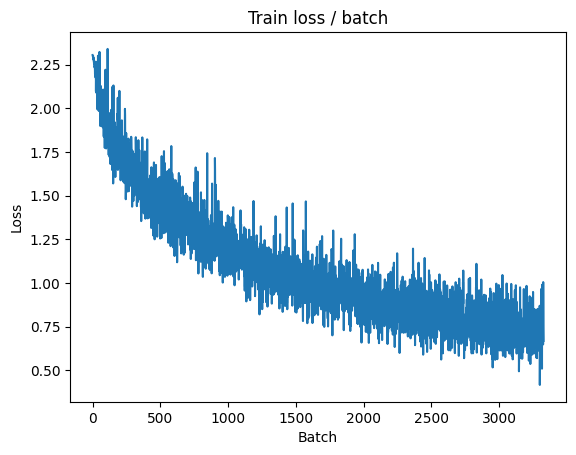


===============> Total time 22s	Avg loss 0.7218	Avg Prec@1 75.05 %	Avg Prec@5 98.27 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 0.6100 (0.6100)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7107	Avg Prec@1 75.01 %	Avg Prec@5 98.52 %



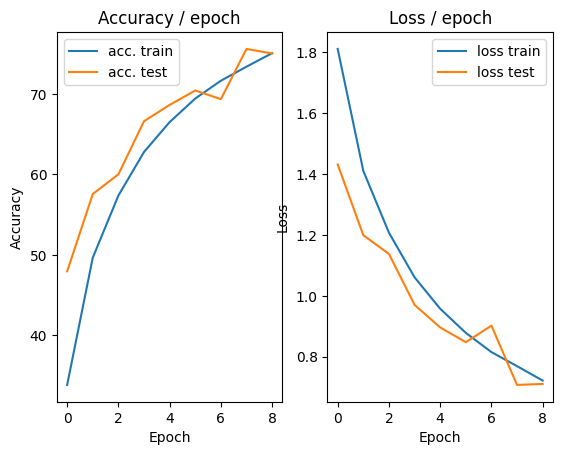

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.6063 (0.6063)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


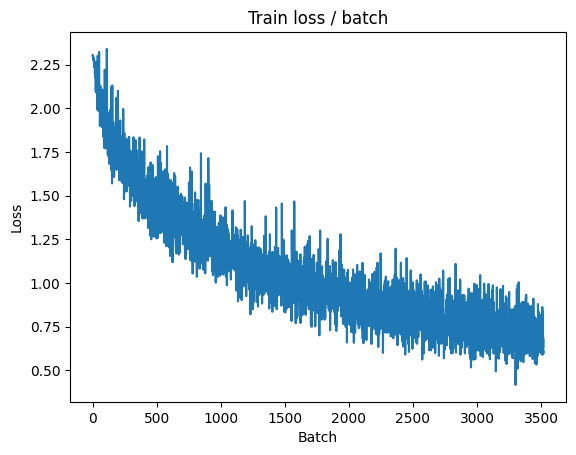

[TRAIN Batch 200/391]	Time 0.054s (0.057s)	Loss 0.6286 (0.6877)	Prec@1  76.6 ( 76.1)	Prec@5  98.4 ( 98.4)


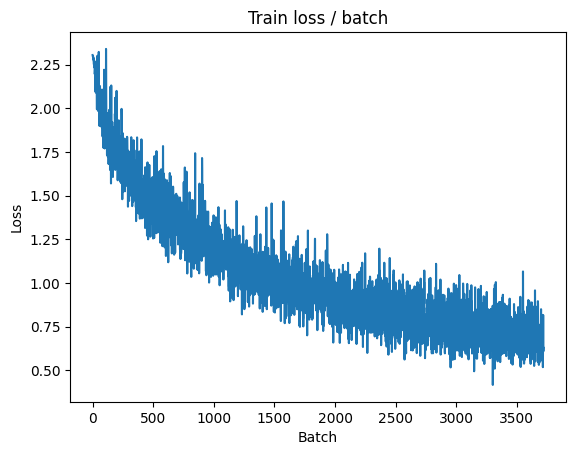


===============> Total time 22s	Avg loss 0.6862	Avg Prec@1 76.23 %	Avg Prec@5 98.51 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.5540 (0.5540)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 6s	Avg loss 0.6604	Avg Prec@1 77.45 %	Avg Prec@5 98.60 %



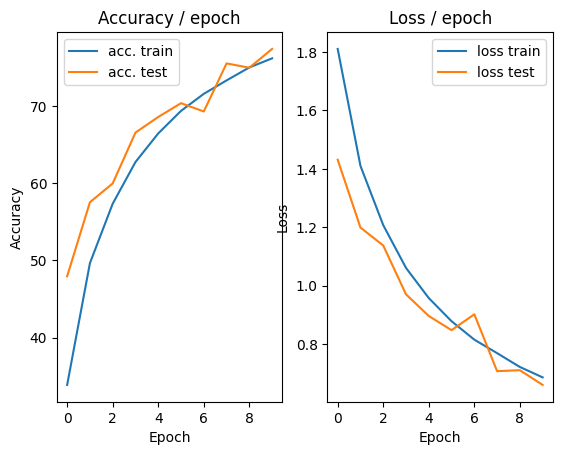

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.5484 (0.5484)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


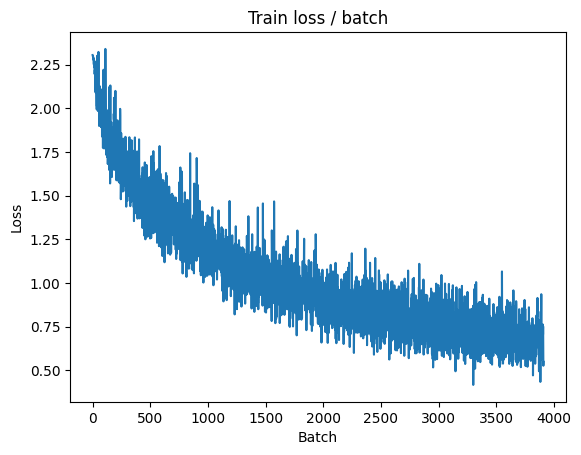

[TRAIN Batch 200/391]	Time 0.055s (0.059s)	Loss 0.8173 (0.6575)	Prec@1  71.9 ( 77.1)	Prec@5  96.9 ( 98.6)


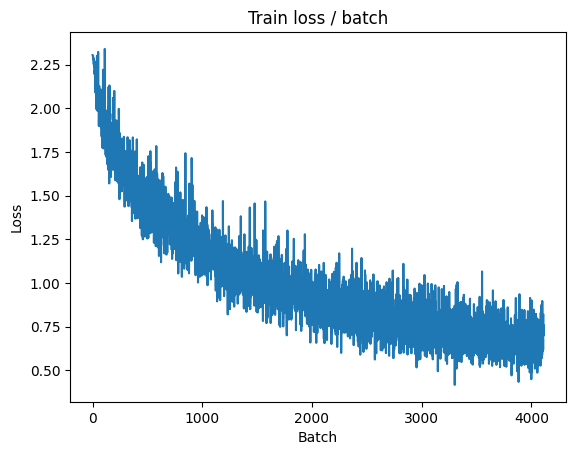


===============> Total time 23s	Avg loss 0.6562	Avg Prec@1 77.32 %	Avg Prec@5 98.66 %

[EVAL Batch 000/079]	Time 0.247s (0.247s)	Loss 0.5756 (0.5756)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 4s	Avg loss 0.6594	Avg Prec@1 77.51 %	Avg Prec@5 98.64 %



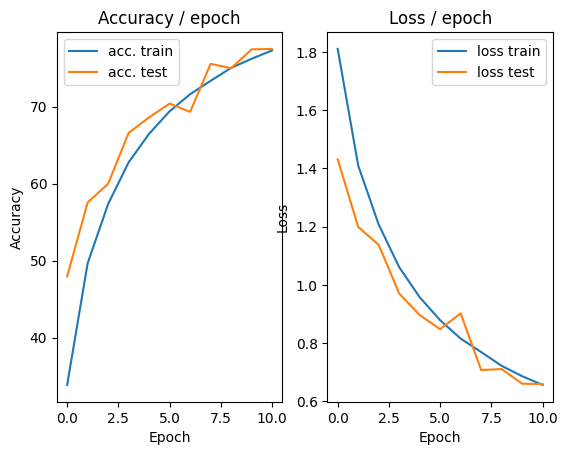

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.7137 (0.7137)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)


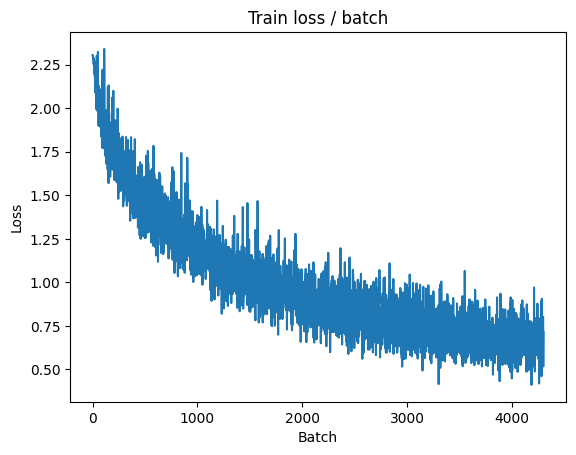

[TRAIN Batch 200/391]	Time 0.057s (0.078s)	Loss 0.6212 (0.6268)	Prec@1  72.7 ( 78.3)	Prec@5  97.7 ( 98.8)


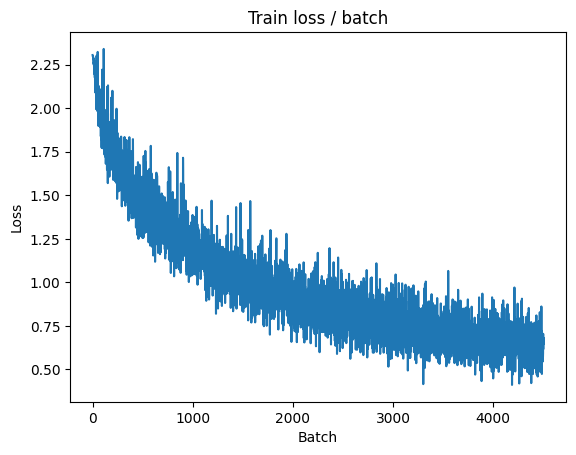


===============> Total time 27s	Avg loss 0.6273	Avg Prec@1 77.98 %	Avg Prec@5 98.73 %

[EVAL Batch 000/079]	Time 0.231s (0.231s)	Loss 0.5643 (0.5643)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6606	Avg Prec@1 77.18 %	Avg Prec@5 98.48 %



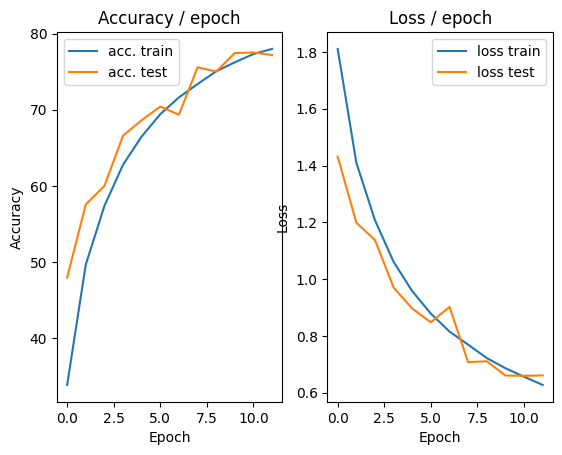

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.6192 (0.6192)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)


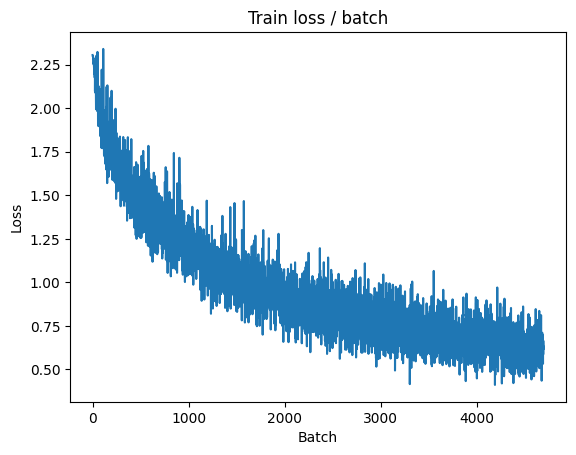

[TRAIN Batch 200/391]	Time 0.055s (0.058s)	Loss 0.5535 (0.6006)	Prec@1  76.6 ( 79.1)	Prec@5  99.2 ( 98.8)


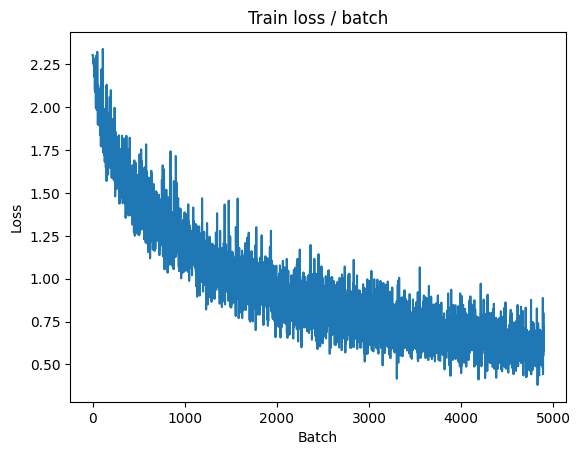


===============> Total time 22s	Avg loss 0.6008	Avg Prec@1 78.98 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.4846 (0.4846)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6142	Avg Prec@1 78.69 %	Avg Prec@5 98.73 %



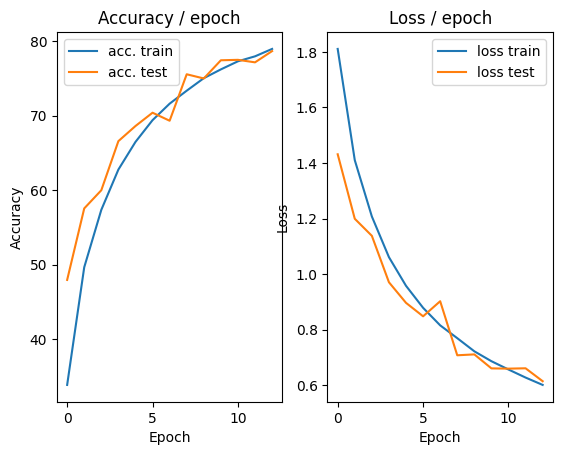

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.4881 (0.4881)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


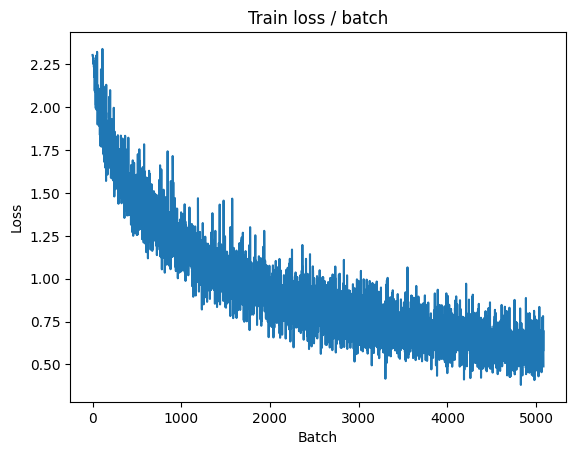

[TRAIN Batch 200/391]	Time 0.059s (0.058s)	Loss 0.7304 (0.5859)	Prec@1  77.3 ( 79.6)	Prec@5  98.4 ( 98.9)


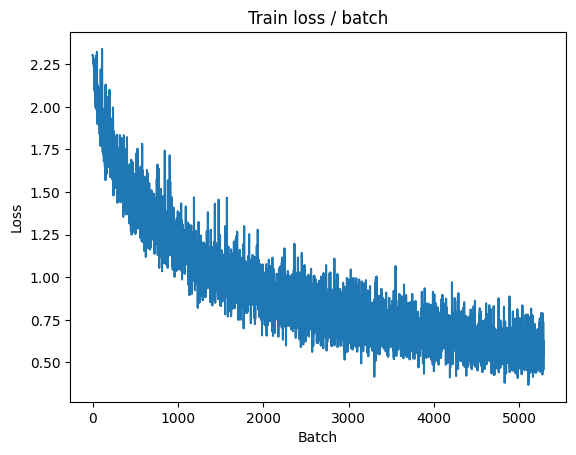


===============> Total time 22s	Avg loss 0.5801	Avg Prec@1 79.74 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 0.4842 (0.4842)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6059	Avg Prec@1 78.89 %	Avg Prec@5 98.77 %



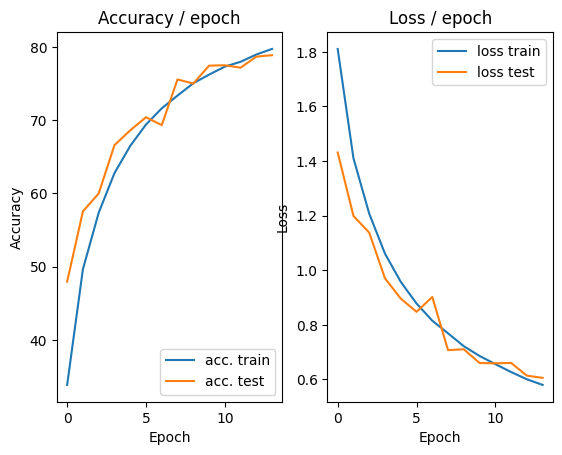

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.3411 (0.3411)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


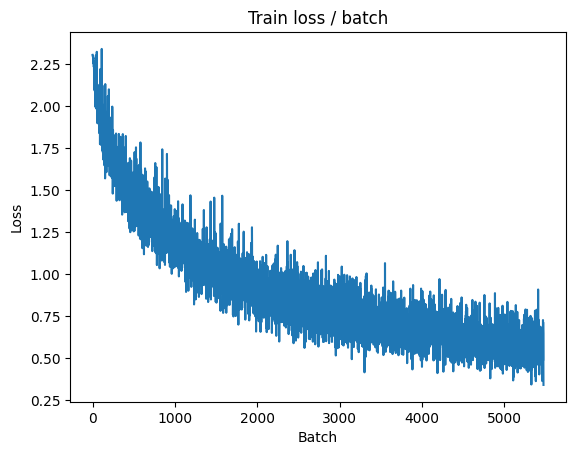

[TRAIN Batch 200/391]	Time 0.056s (0.057s)	Loss 0.3651 (0.5481)	Prec@1  88.3 ( 80.9)	Prec@5 100.0 ( 99.1)


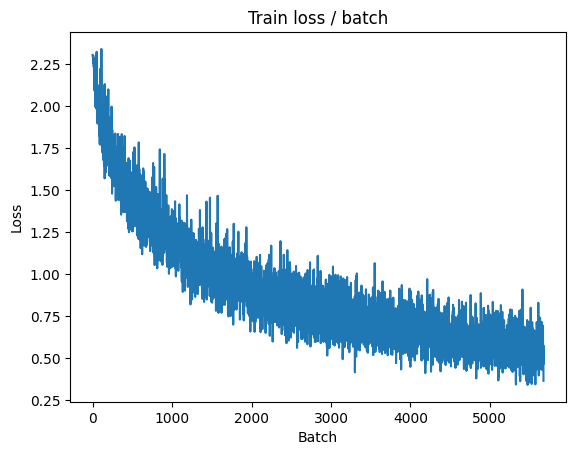


===============> Total time 22s	Avg loss 0.5572	Avg Prec@1 80.61 %	Avg Prec@5 98.99 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 0.5216 (0.5216)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6010	Avg Prec@1 79.43 %	Avg Prec@5 98.81 %



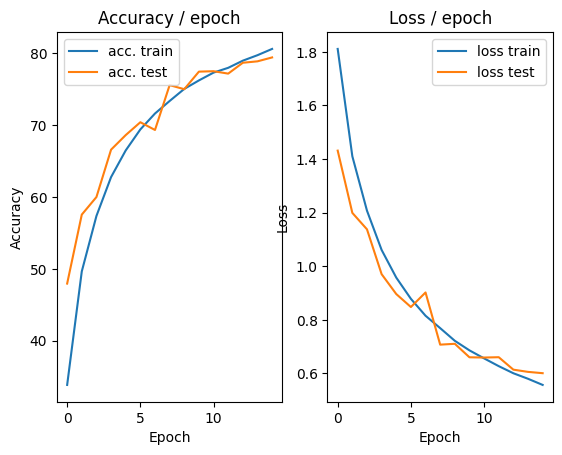

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.4910 (0.4910)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


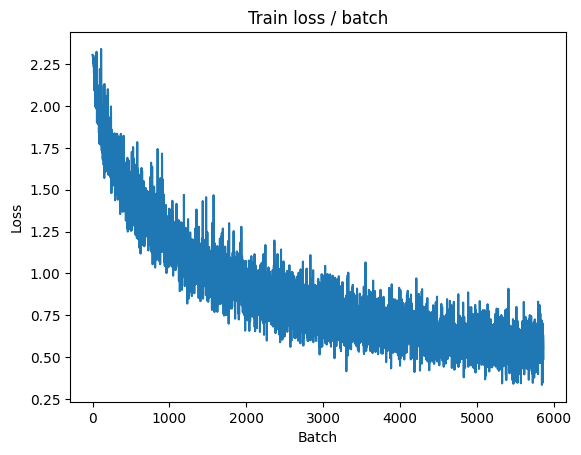

[TRAIN Batch 200/391]	Time 0.057s (0.059s)	Loss 0.6223 (0.5447)	Prec@1  78.1 ( 80.8)	Prec@5  98.4 ( 99.1)


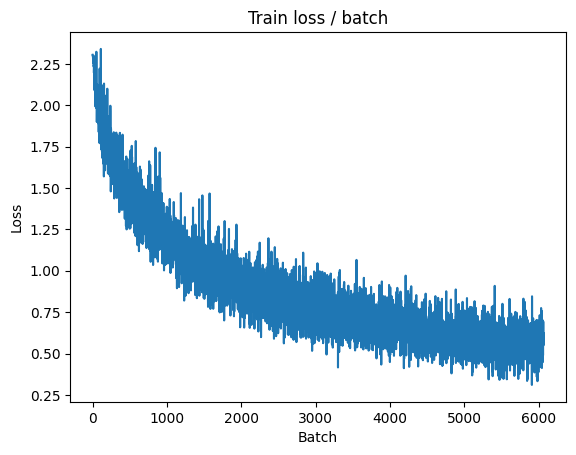


===============> Total time 22s	Avg loss 0.5384	Avg Prec@1 81.15 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.5092 (0.5092)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5817	Avg Prec@1 79.97 %	Avg Prec@5 98.80 %



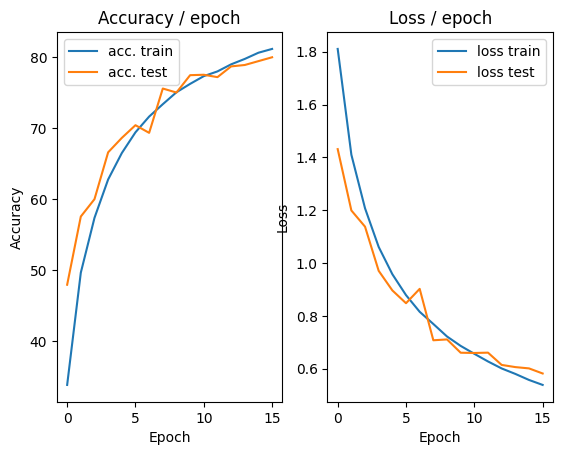

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.5418 (0.5418)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


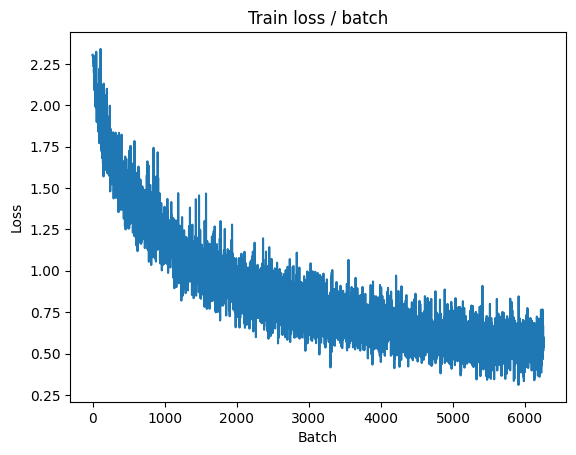

[TRAIN Batch 200/391]	Time 0.056s (0.057s)	Loss 0.3766 (0.5173)	Prec@1  89.1 ( 82.1)	Prec@5  99.2 ( 99.1)


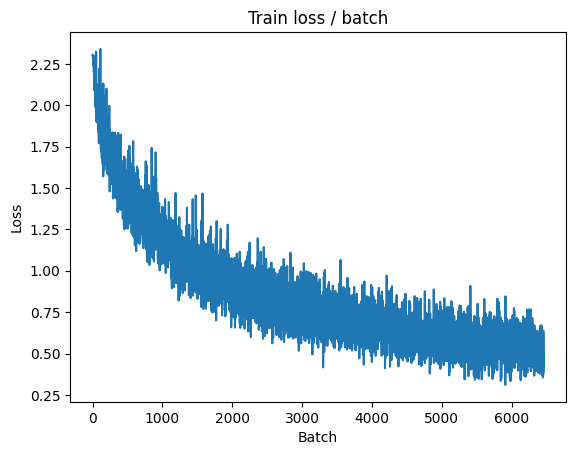


===============> Total time 22s	Avg loss 0.5202	Avg Prec@1 81.92 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 0.4552 (0.4552)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5794	Avg Prec@1 79.90 %	Avg Prec@5 98.91 %



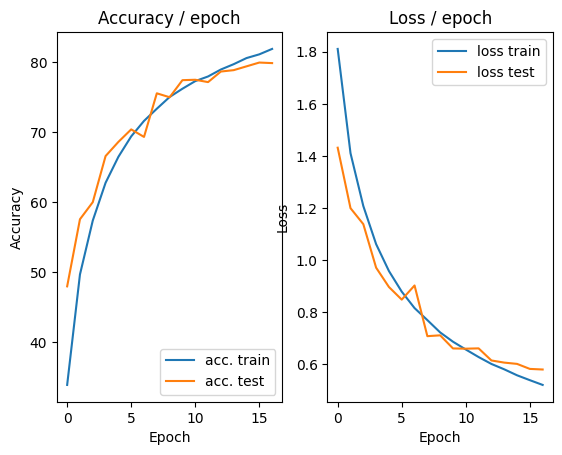

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.6025 (0.6025)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)


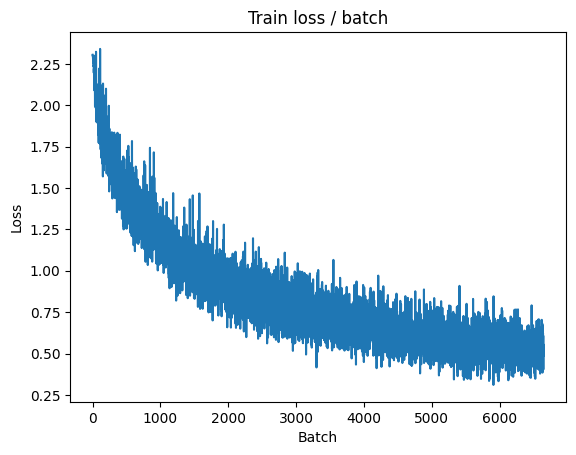

[TRAIN Batch 200/391]	Time 0.053s (0.058s)	Loss 0.6118 (0.5057)	Prec@1  73.4 ( 82.3)	Prec@5  99.2 ( 99.2)


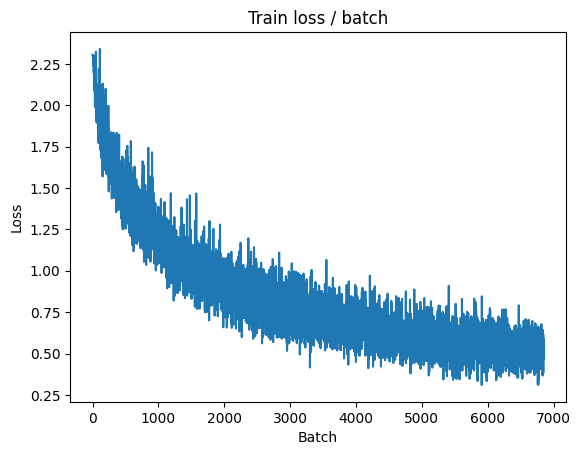


===============> Total time 22s	Avg loss 0.5071	Avg Prec@1 82.29 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 0.4266 (0.4266)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5618	Avg Prec@1 80.51 %	Avg Prec@5 99.06 %



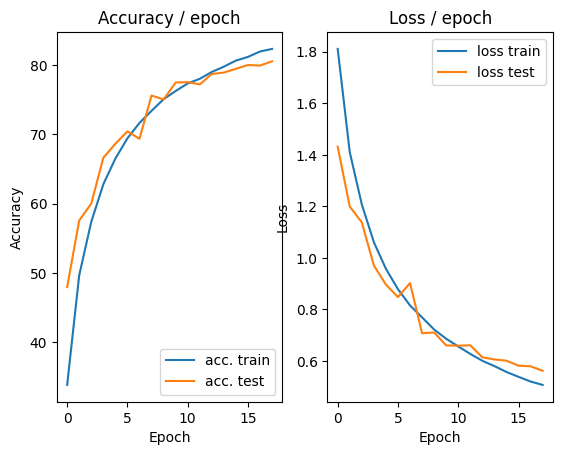

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.5757 (0.5757)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


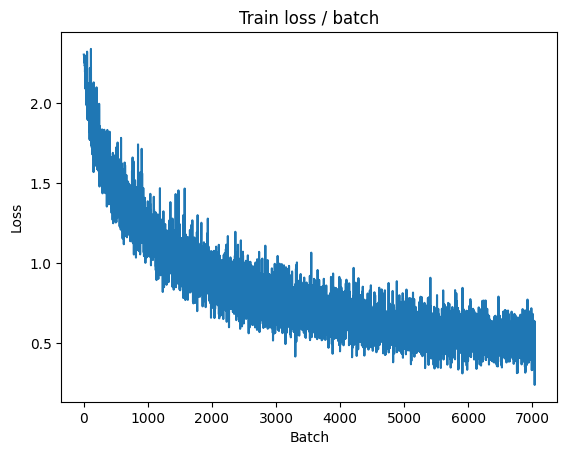

[TRAIN Batch 200/391]	Time 0.057s (0.058s)	Loss 0.5066 (0.4887)	Prec@1  81.2 ( 82.8)	Prec@5  98.4 ( 99.2)


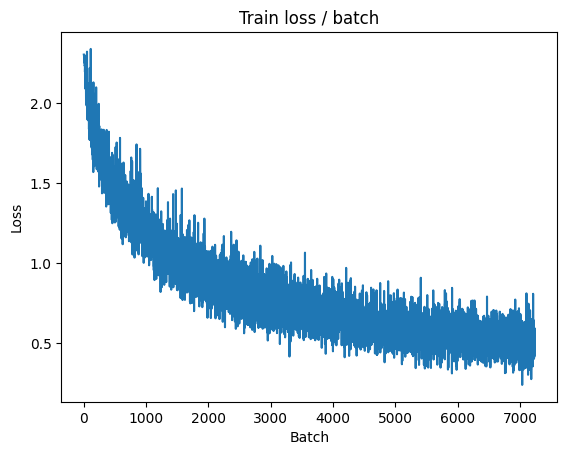


===============> Total time 22s	Avg loss 0.4905	Avg Prec@1 82.82 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 0.4670 (0.4670)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5674	Avg Prec@1 80.83 %	Avg Prec@5 98.89 %



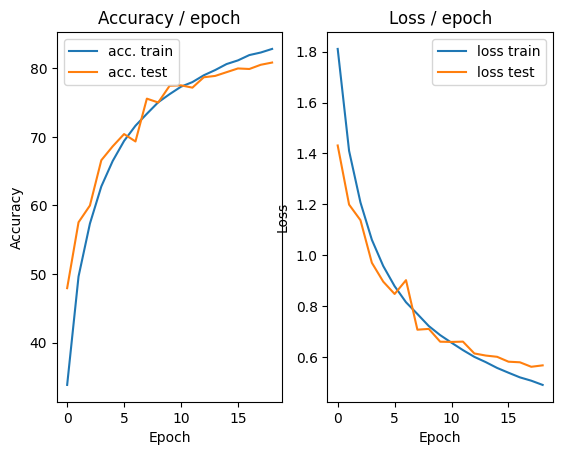

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.4856 (0.4856)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


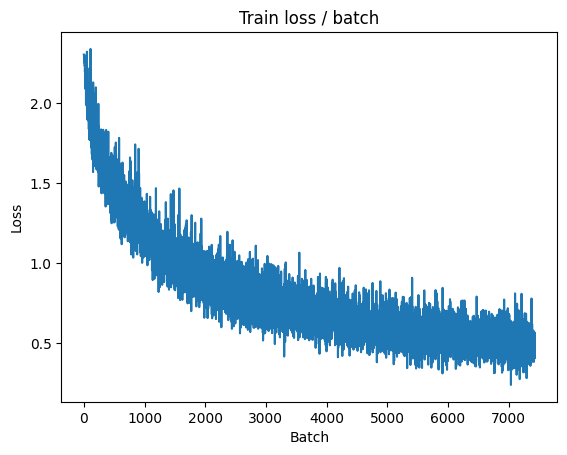

[TRAIN Batch 200/391]	Time 0.057s (0.057s)	Loss 0.3874 (0.4745)	Prec@1  89.1 ( 83.6)	Prec@5  96.9 ( 99.3)


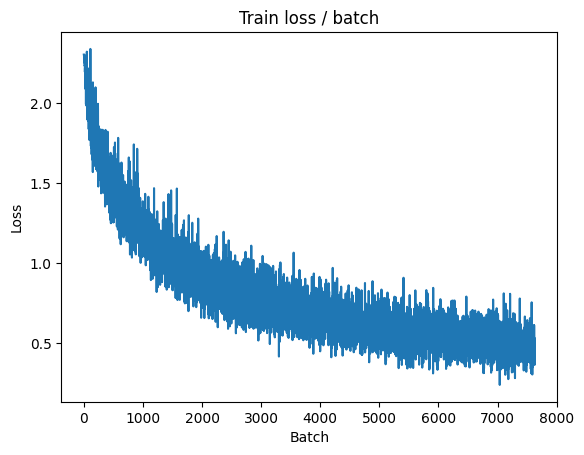


===============> Total time 22s	Avg loss 0.4766	Avg Prec@1 83.48 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.4251 (0.4251)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5433	Avg Prec@1 81.57 %	Avg Prec@5 99.01 %



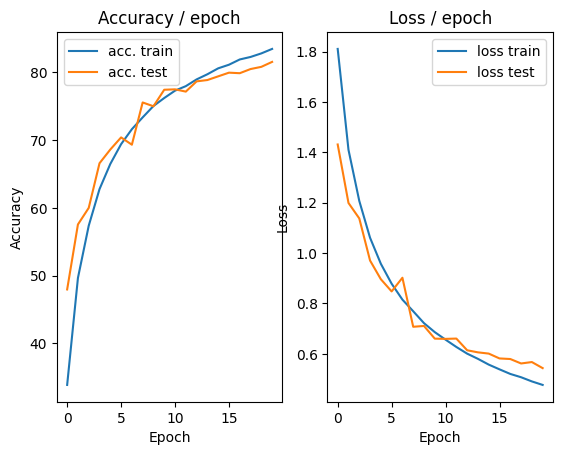

In [18]:
main(batch_size, lr, epochs, cuda=True)

### 3.5 Use of *batch normalization*
**Implementation** : Add a 2D *batch normalization* layer immediately after each convolution layer.

In [19]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),   
            nn.BatchNorm2d(32),                                 # <- Batch normalisation 
            nn.ReLU(),
            nn.MaxPool2d((2,2),stride=2,padding=0),            

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2), 
            nn.BatchNorm2d(64),                                 # <- Batch normalisation
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),         

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(64),                                 # <- Batch normalisation
            nn.ReLU(),

            # Set ceil_mode=True to increase the feature map size in the pooling layer, compensating for the information loss caused by cropping.
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode = True),         
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(4*4*64, 1000),
            nn.ReLU(),
            # the drop out layer
            nn.Dropout(p=0.5),
            nn.Linear(1000, 10),
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 2.2678 (2.2678)	Prec@1  20.3 ( 20.3)	Prec@5  57.0 ( 57.0)


<Figure size 640x480 with 0 Axes>

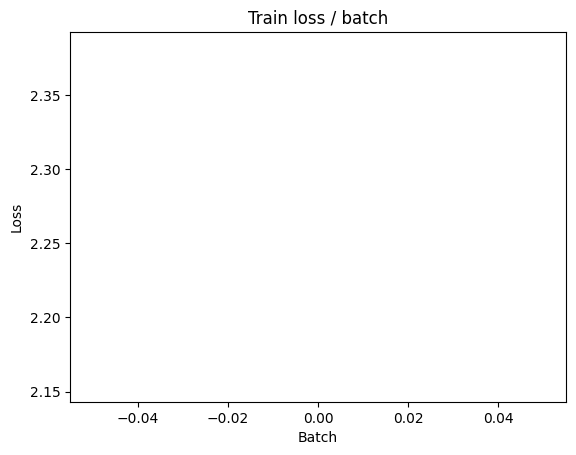

[TRAIN Batch 200/391]	Time 0.059s (0.061s)	Loss 1.3115 (1.6699)	Prec@1  51.6 ( 38.6)	Prec@5  96.1 ( 88.1)


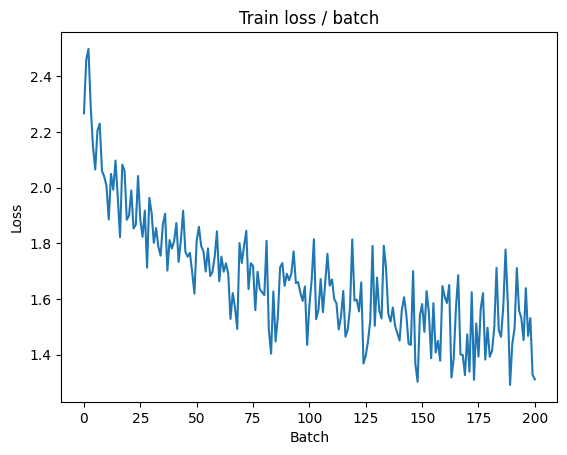


===============> Total time 23s	Avg loss 1.5228	Avg Prec@1 44.32 %	Avg Prec@5 90.59 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.4335 (1.4335)	Prec@1  47.7 ( 47.7)	Prec@5  90.6 ( 90.6)

===============> Total time 2s	Avg loss 1.4756	Avg Prec@1 47.25 %	Avg Prec@5 90.89 %



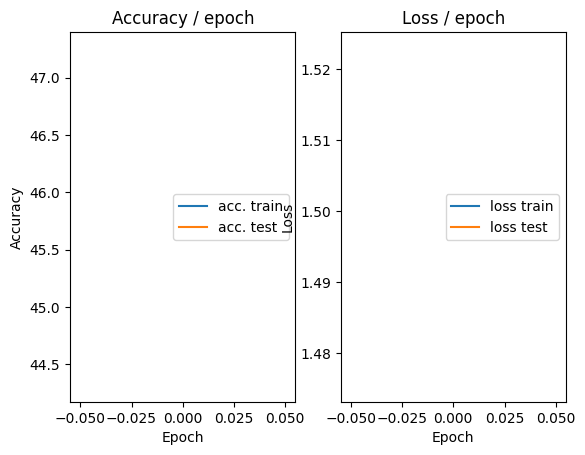

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 1.3222 (1.3222)	Prec@1  52.3 ( 52.3)	Prec@5  93.8 ( 93.8)


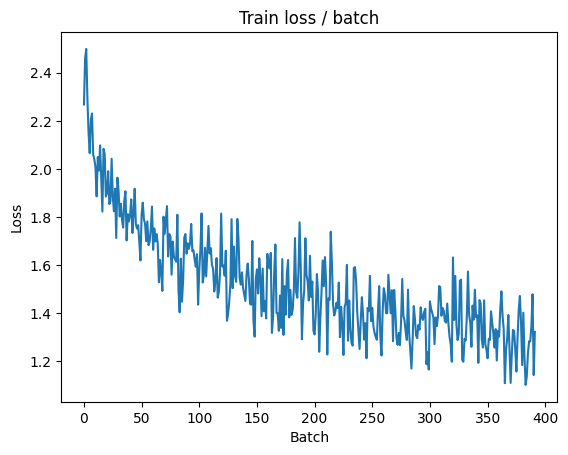

[TRAIN Batch 200/391]	Time 0.057s (0.061s)	Loss 1.1467 (1.1970)	Prec@1  60.2 ( 57.1)	Prec@5  96.1 ( 95.4)


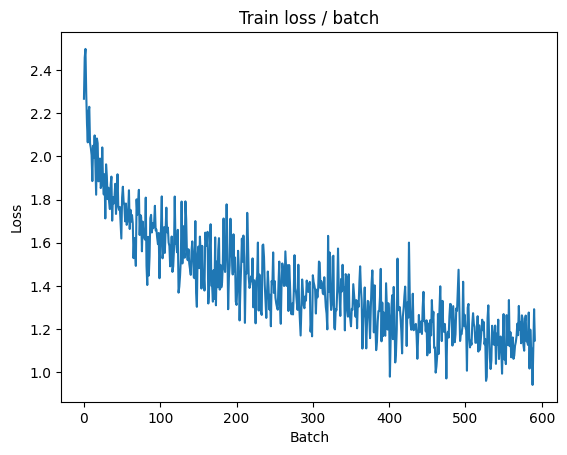


===============> Total time 23s	Avg loss 1.1448	Avg Prec@1 58.86 %	Avg Prec@5 95.78 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.9132 (0.9132)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9733	Avg Prec@1 65.19 %	Avg Prec@5 97.01 %



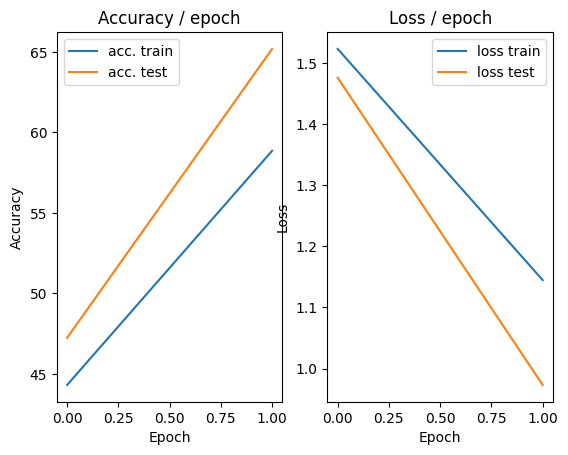

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 0.9720 (0.9720)	Prec@1  71.1 ( 71.1)	Prec@5  99.2 ( 99.2)


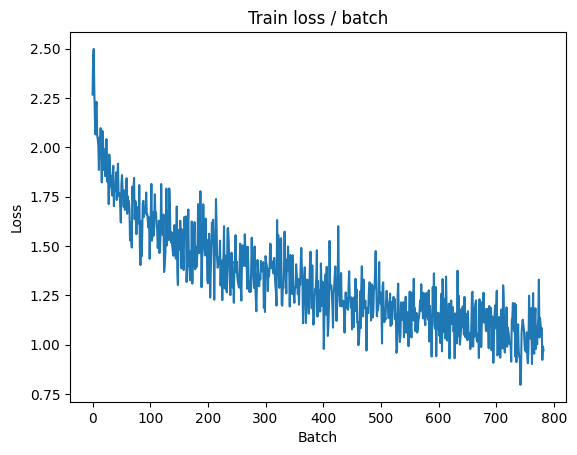

[TRAIN Batch 200/391]	Time 0.062s (0.061s)	Loss 1.0280 (1.0053)	Prec@1  59.4 ( 64.5)	Prec@5  98.4 ( 96.8)


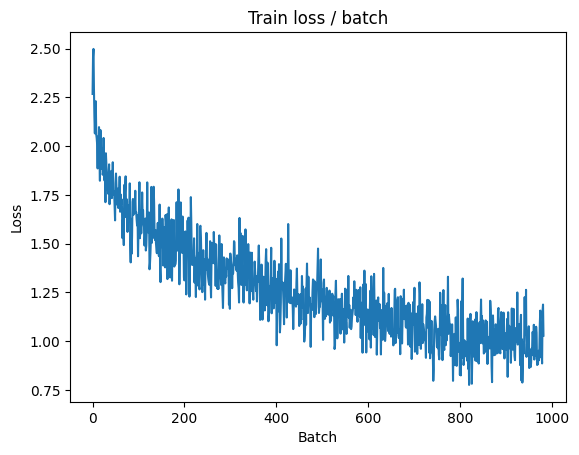


===============> Total time 23s	Avg loss 0.9807	Avg Prec@1 65.29 %	Avg Prec@5 96.93 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.1133 (1.1133)	Prec@1  60.9 ( 60.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.1471	Avg Prec@1 59.18 %	Avg Prec@5 96.06 %



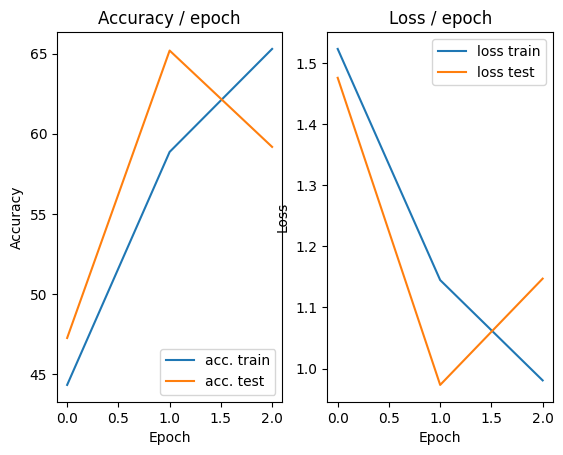

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.9797 (0.9797)	Prec@1  66.4 ( 66.4)	Prec@5  98.4 ( 98.4)


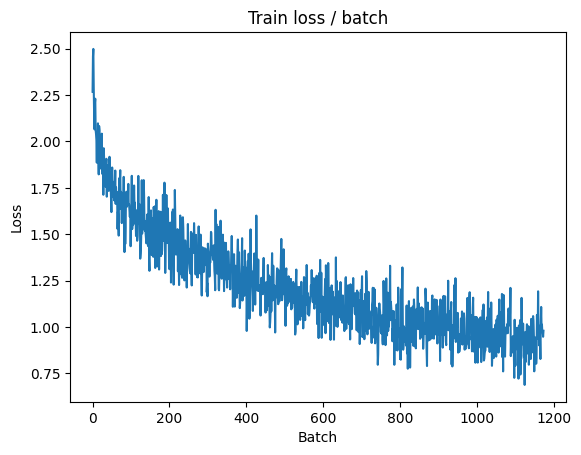

[TRAIN Batch 200/391]	Time 0.053s (0.061s)	Loss 1.0355 (0.8901)	Prec@1  60.2 ( 68.7)	Prec@5  96.9 ( 97.4)


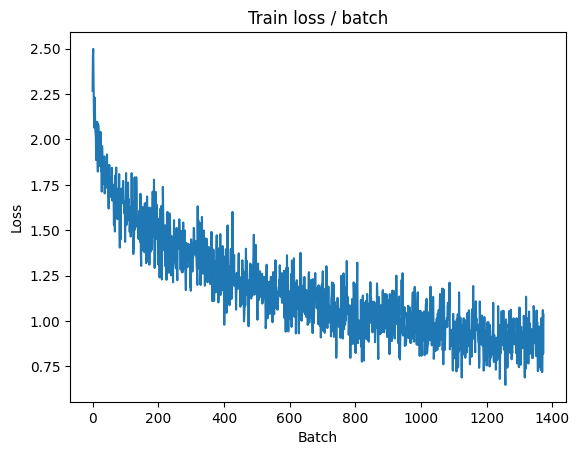


===============> Total time 23s	Avg loss 0.8751	Avg Prec@1 69.16 %	Avg Prec@5 97.58 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 0.9662 (0.9662)	Prec@1  71.1 ( 71.1)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.0675	Avg Prec@1 64.41 %	Avg Prec@5 96.43 %



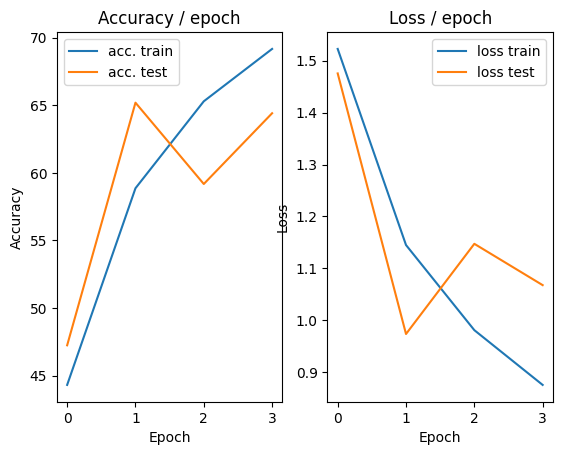

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 0.8035 (0.8035)	Prec@1  70.3 ( 70.3)	Prec@5 100.0 (100.0)


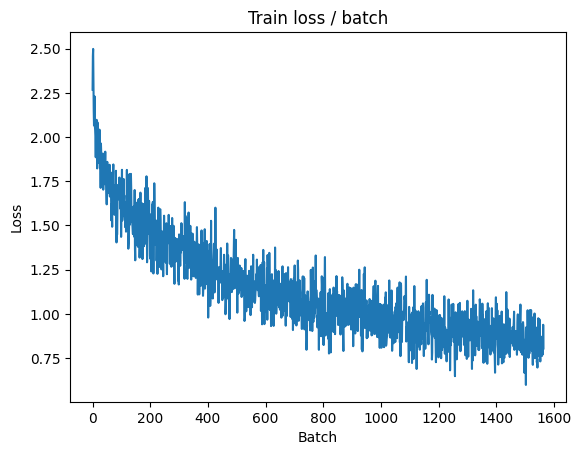

[TRAIN Batch 200/391]	Time 0.059s (0.061s)	Loss 0.5951 (0.8104)	Prec@1  78.9 ( 71.5)	Prec@5  99.2 ( 97.8)


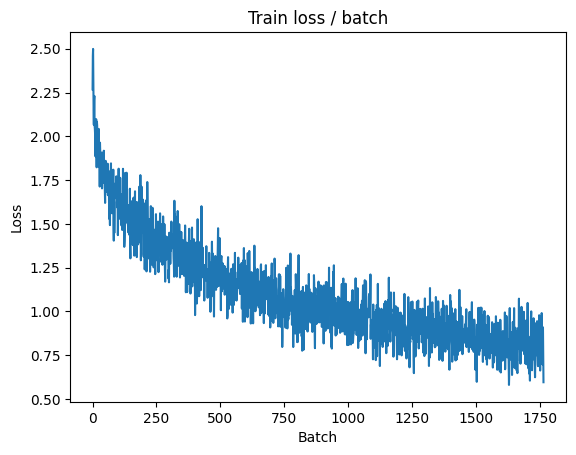


===============> Total time 23s	Avg loss 0.8052	Avg Prec@1 71.69 %	Avg Prec@5 97.94 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 0.9697 (0.9697)	Prec@1  68.0 ( 68.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0424	Avg Prec@1 65.37 %	Avg Prec@5 96.39 %



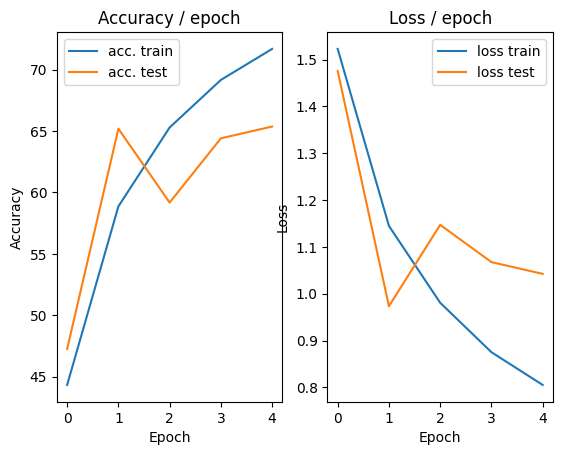

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.6754 (0.6754)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


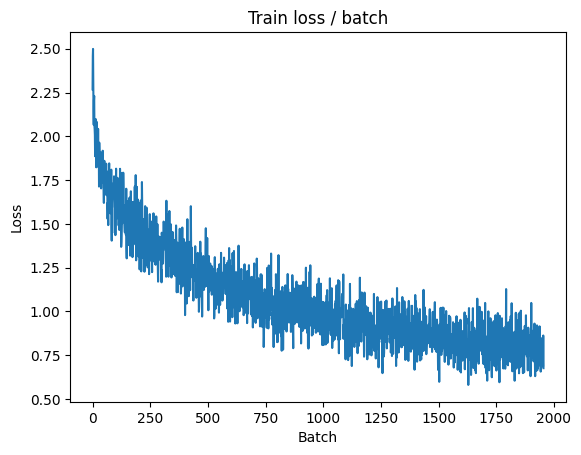

[TRAIN Batch 200/391]	Time 0.060s (0.061s)	Loss 0.8137 (0.7500)	Prec@1  66.4 ( 73.5)	Prec@5  99.2 ( 98.2)


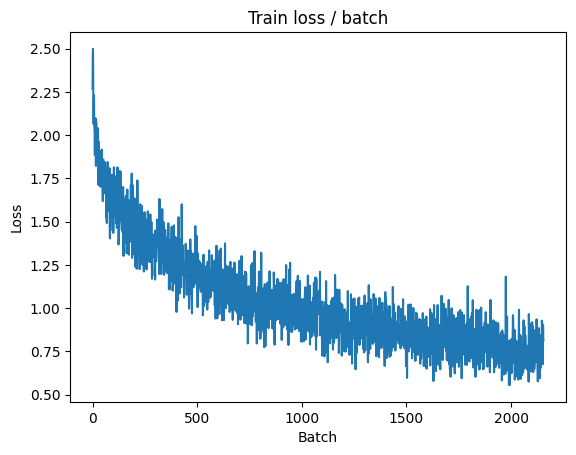


===============> Total time 23s	Avg loss 0.7449	Avg Prec@1 73.83 %	Avg Prec@5 98.25 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.8011 (0.8011)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7848	Avg Prec@1 72.20 %	Avg Prec@5 97.87 %



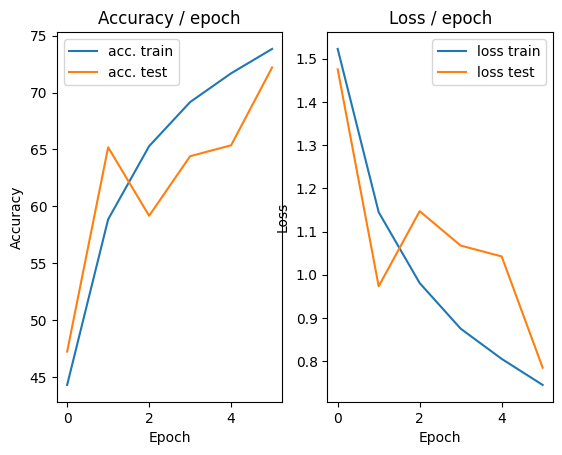

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.6522 (0.6522)	Prec@1  76.6 ( 76.6)	Prec@5 100.0 (100.0)


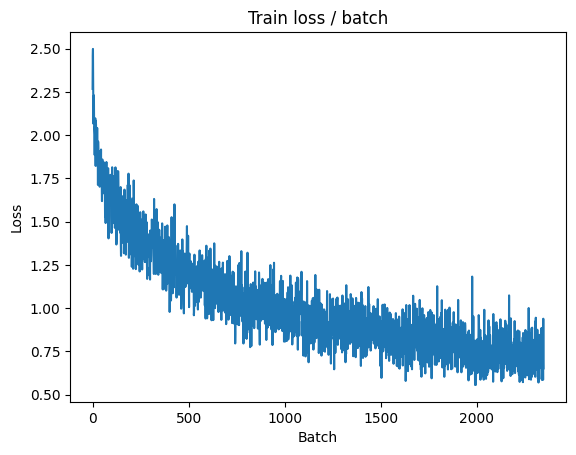

[TRAIN Batch 200/391]	Time 0.058s (0.061s)	Loss 0.6942 (0.7092)	Prec@1  75.0 ( 75.0)	Prec@5 100.0 ( 98.4)


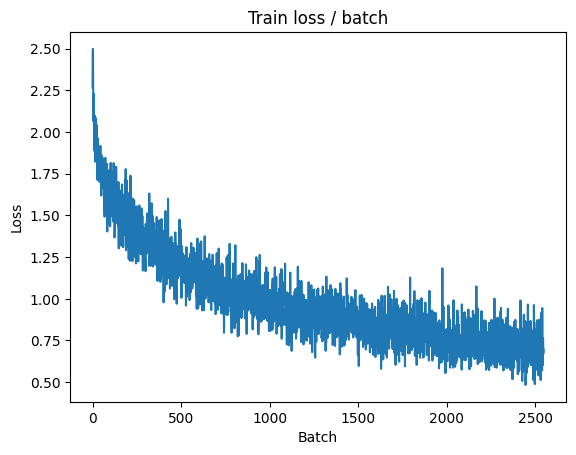


===============> Total time 23s	Avg loss 0.6996	Avg Prec@1 75.53 %	Avg Prec@5 98.51 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 0.6408 (0.6408)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6943	Avg Prec@1 76.31 %	Avg Prec@5 98.33 %



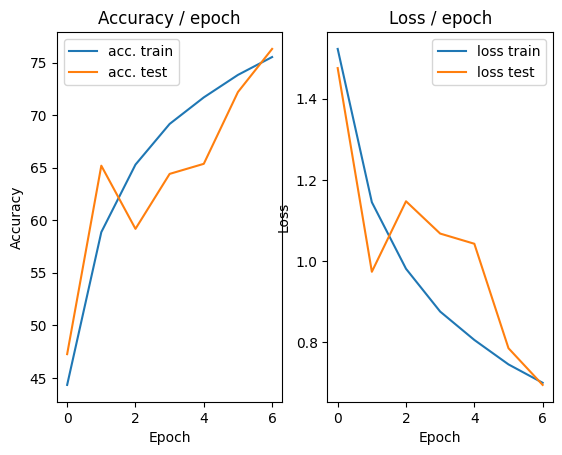

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.7443 (0.7443)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


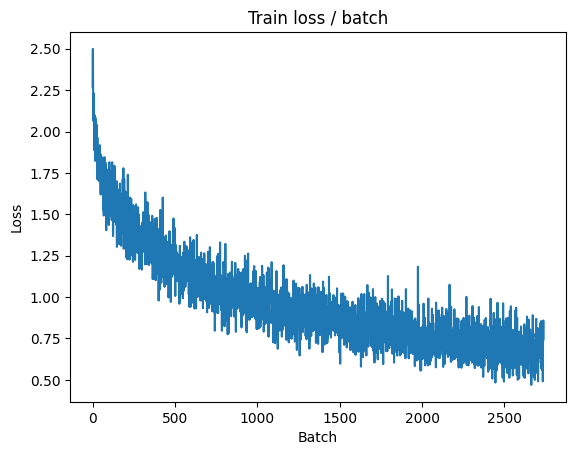

[TRAIN Batch 200/391]	Time 0.059s (0.061s)	Loss 0.6430 (0.6727)	Prec@1  78.1 ( 76.5)	Prec@5  98.4 ( 98.7)


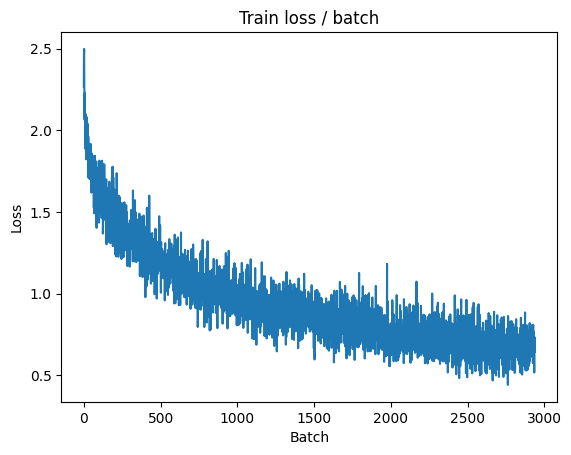


===============> Total time 23s	Avg loss 0.6682	Avg Prec@1 76.54 %	Avg Prec@5 98.65 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 0.6374 (0.6374)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6573	Avg Prec@1 77.22 %	Avg Prec@5 98.52 %



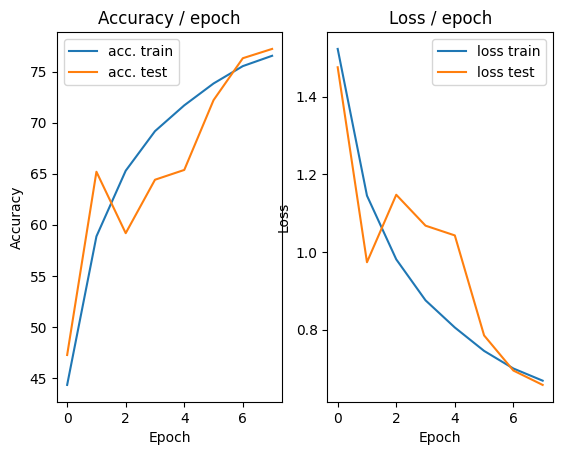

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.7525 (0.7525)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)


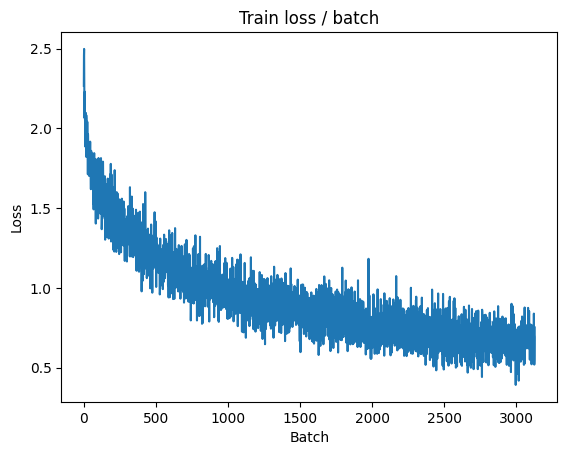

[TRAIN Batch 200/391]	Time 0.061s (0.061s)	Loss 0.6693 (0.6387)	Prec@1  82.0 ( 77.6)	Prec@5  98.4 ( 98.8)


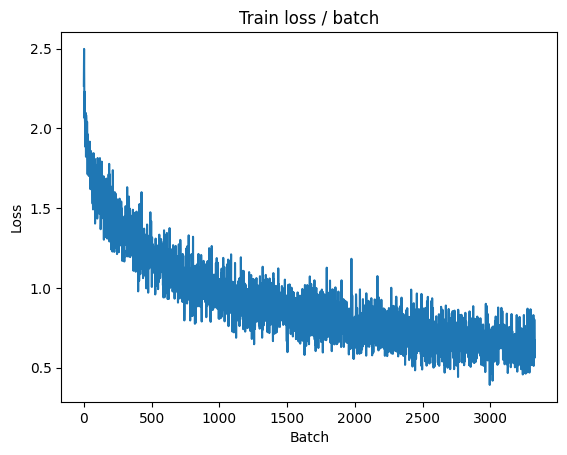


===============> Total time 23s	Avg loss 0.6322	Avg Prec@1 77.97 %	Avg Prec@5 98.79 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 0.5737 (0.5737)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6632	Avg Prec@1 76.40 %	Avg Prec@5 98.82 %



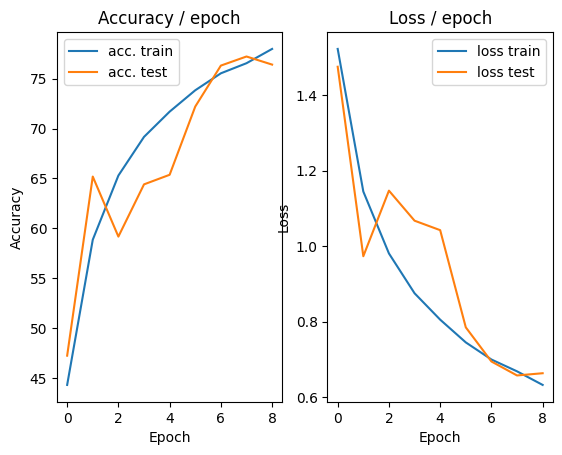

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.5523 (0.5523)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


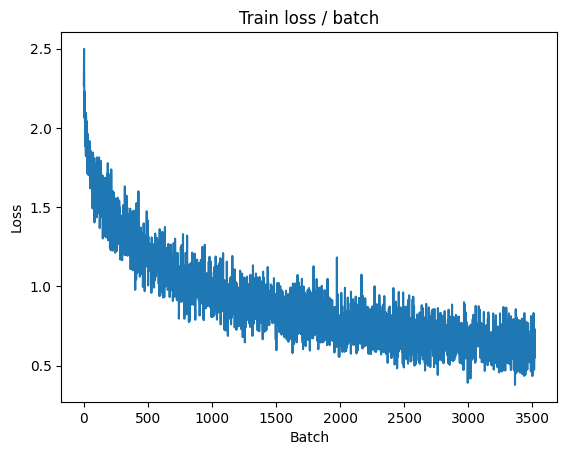

[TRAIN Batch 200/391]	Time 0.060s (0.061s)	Loss 0.5448 (0.6138)	Prec@1  78.9 ( 78.5)	Prec@5  99.2 ( 98.8)


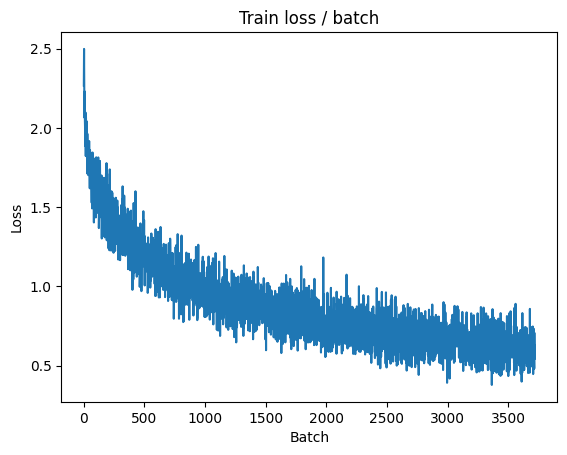


===============> Total time 23s	Avg loss 0.6058	Avg Prec@1 78.77 %	Avg Prec@5 98.81 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.6128 (0.6128)	Prec@1  84.4 ( 84.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7190	Avg Prec@1 75.95 %	Avg Prec@5 98.71 %



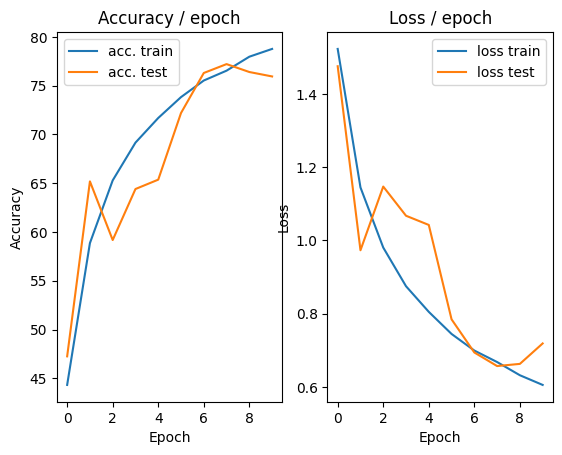

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.149s (0.149s)	Loss 0.6295 (0.6295)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


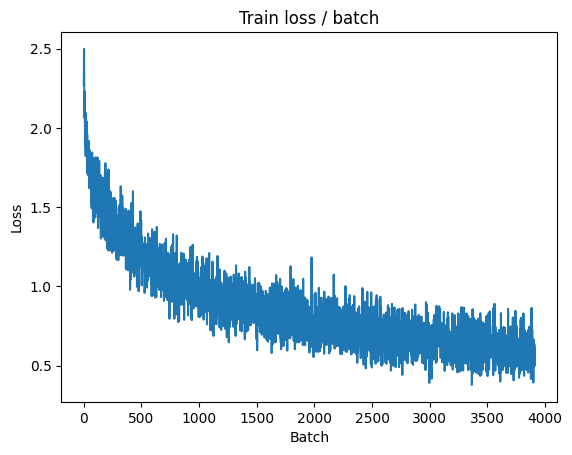

[TRAIN Batch 200/391]	Time 0.060s (0.061s)	Loss 0.5848 (0.5827)	Prec@1  82.0 ( 79.8)	Prec@5  98.4 ( 98.9)


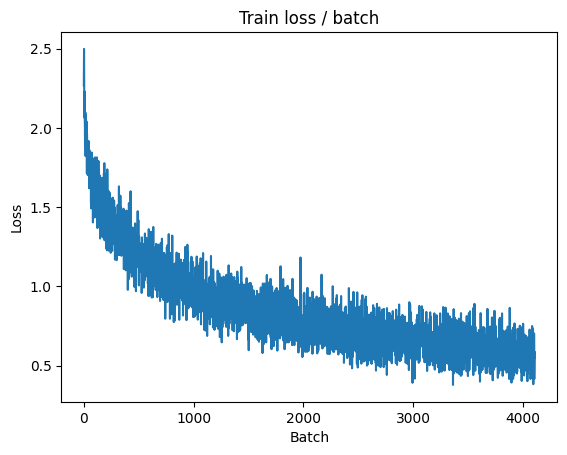


===============> Total time 23s	Avg loss 0.5832	Avg Prec@1 79.65 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 0.5862 (0.5862)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6500	Avg Prec@1 77.63 %	Avg Prec@5 98.76 %



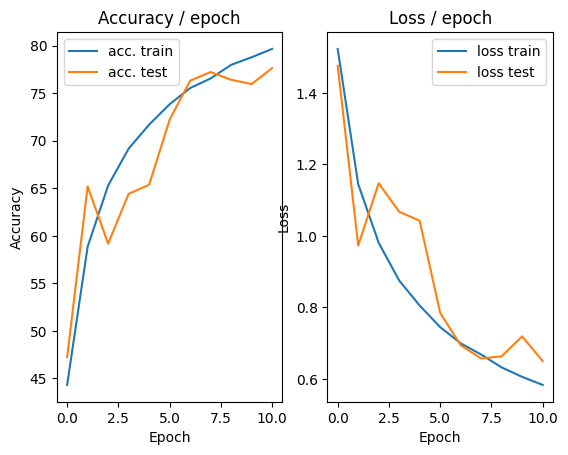

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 0.5414 (0.5414)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


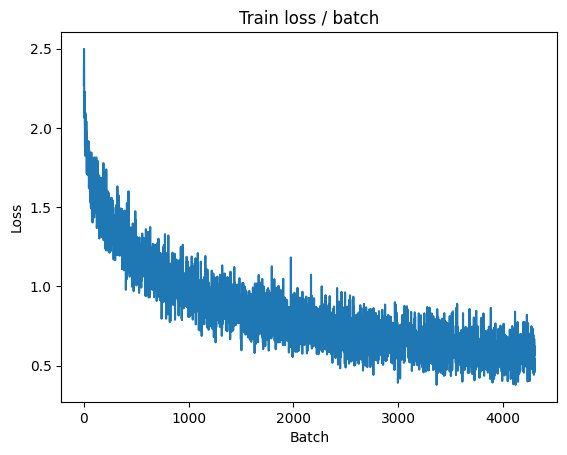

[TRAIN Batch 200/391]	Time 0.058s (0.061s)	Loss 0.5809 (0.5574)	Prec@1  82.0 ( 80.4)	Prec@5  98.4 ( 99.0)


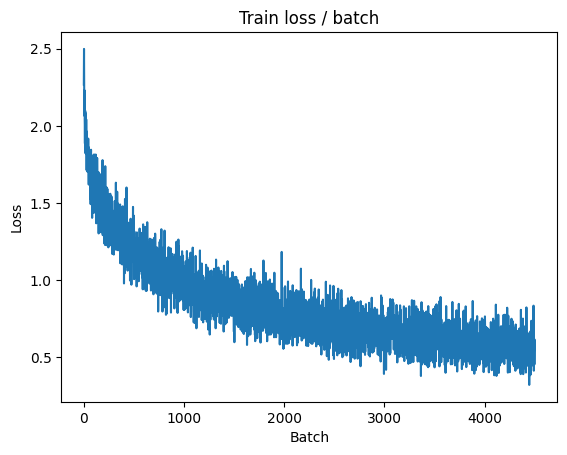


===============> Total time 23s	Avg loss 0.5590	Avg Prec@1 80.32 %	Avg Prec@5 99.07 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 0.5115 (0.5115)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5544	Avg Prec@1 80.51 %	Avg Prec@5 99.09 %



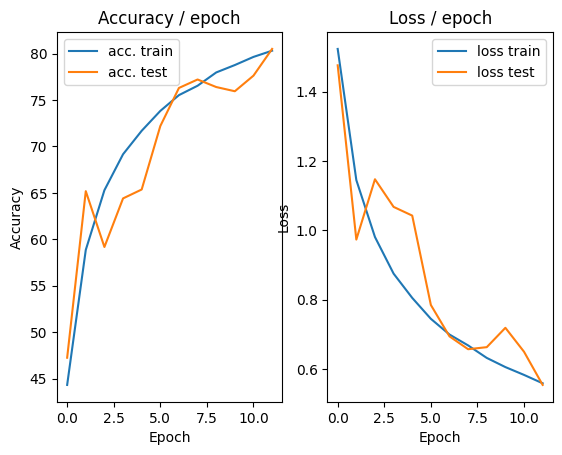

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.5950 (0.5950)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


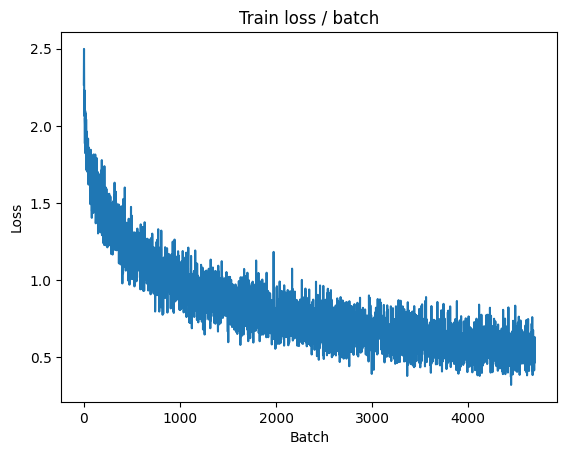

[TRAIN Batch 200/391]	Time 0.057s (0.061s)	Loss 0.5108 (0.5468)	Prec@1  79.7 ( 80.7)	Prec@5 100.0 ( 99.0)


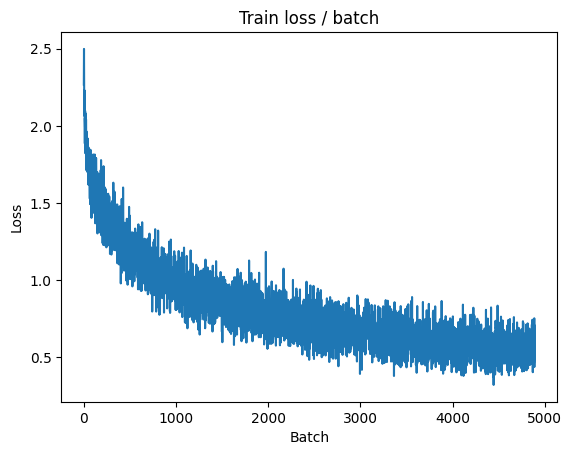


===============> Total time 23s	Avg loss 0.5443	Avg Prec@1 80.94 %	Avg Prec@5 99.05 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 0.5769 (0.5769)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6086	Avg Prec@1 78.30 %	Avg Prec@5 98.83 %



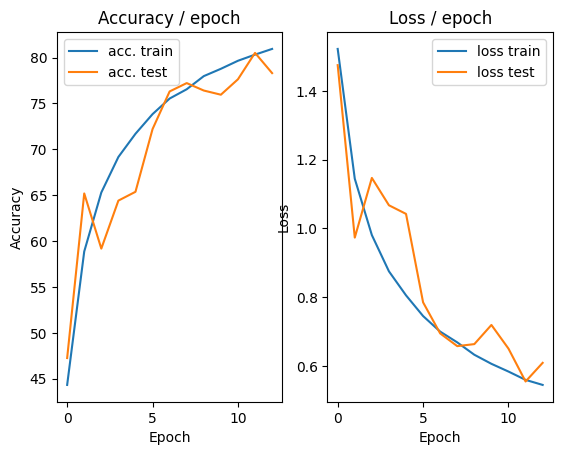

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.4201 (0.4201)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


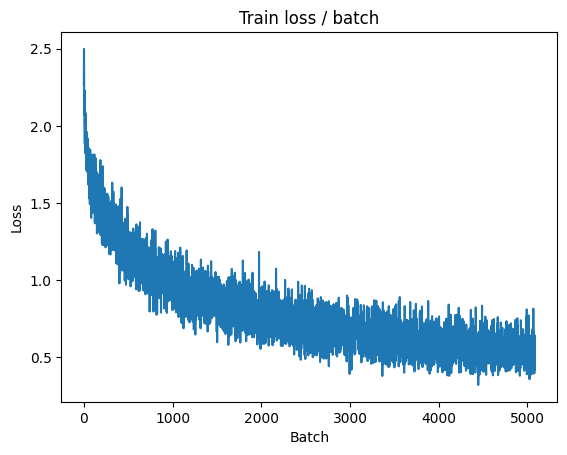

[TRAIN Batch 200/391]	Time 0.058s (0.062s)	Loss 0.5413 (0.5225)	Prec@1  82.0 ( 81.7)	Prec@5  98.4 ( 99.2)


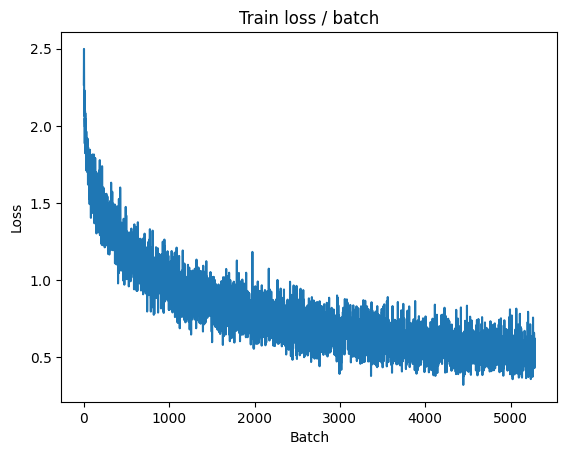


===============> Total time 23s	Avg loss 0.5248	Avg Prec@1 81.54 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.6172 (0.6172)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5784	Avg Prec@1 79.91 %	Avg Prec@5 98.99 %



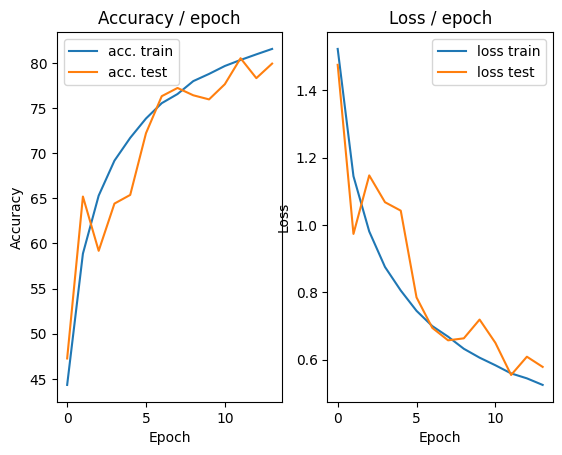

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.5112 (0.5112)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


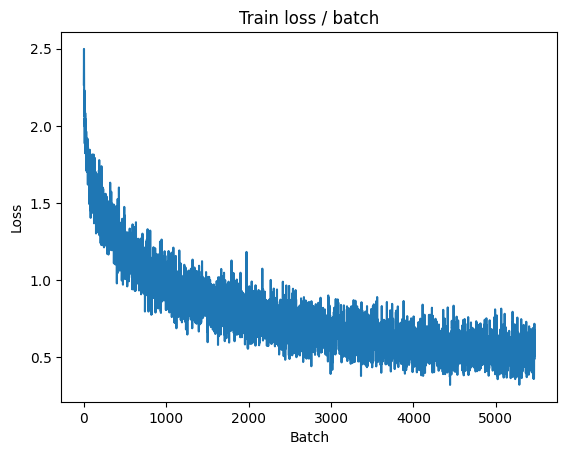

[TRAIN Batch 200/391]	Time 0.058s (0.061s)	Loss 0.4595 (0.5073)	Prec@1  85.2 ( 82.2)	Prec@5 100.0 ( 99.1)


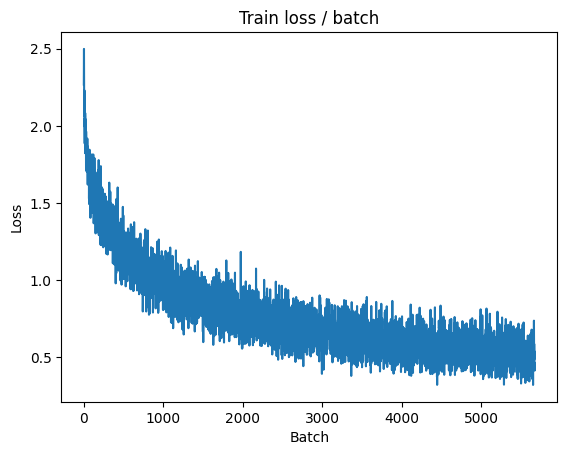


===============> Total time 23s	Avg loss 0.5082	Avg Prec@1 82.15 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 0.5116 (0.5116)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5639	Avg Prec@1 80.58 %	Avg Prec@5 98.98 %



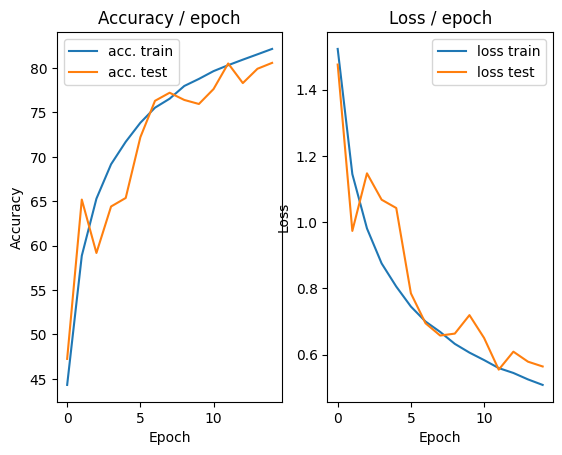

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.4489 (0.4489)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


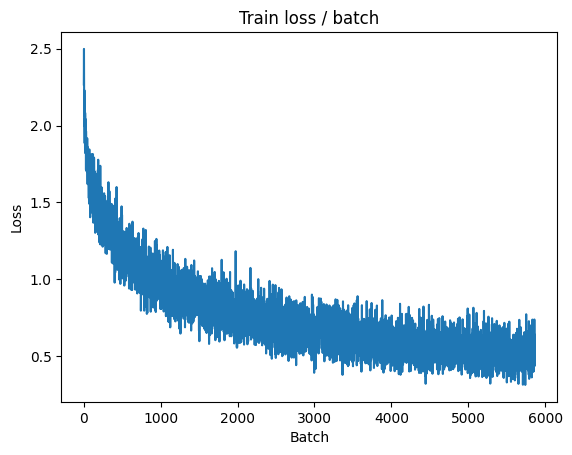

[TRAIN Batch 200/391]	Time 0.061s (0.061s)	Loss 0.6101 (0.4901)	Prec@1  78.1 ( 82.9)	Prec@5 100.0 ( 99.2)


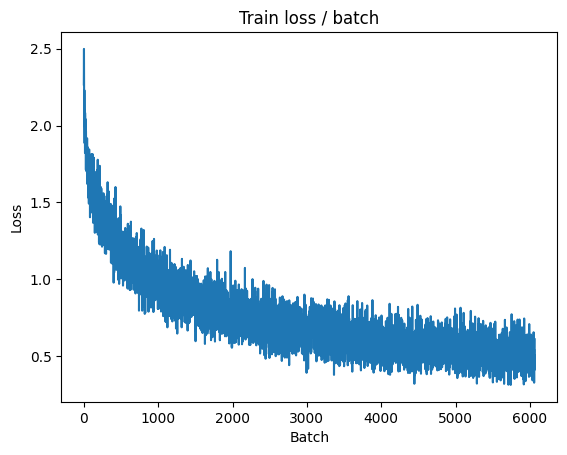


===============> Total time 23s	Avg loss 0.4876	Avg Prec@1 82.81 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 0.5512 (0.5512)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5377	Avg Prec@1 81.63 %	Avg Prec@5 99.01 %



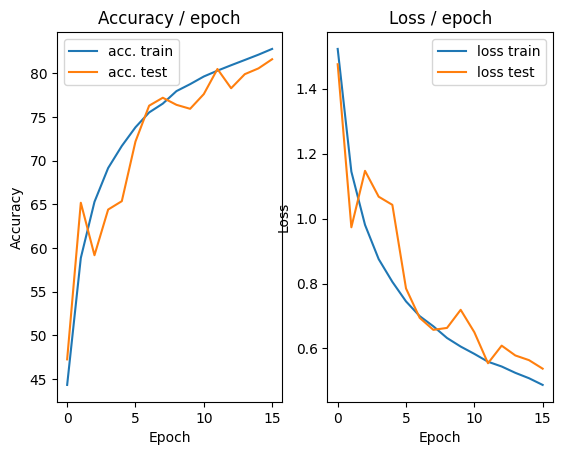

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 0.5096 (0.5096)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


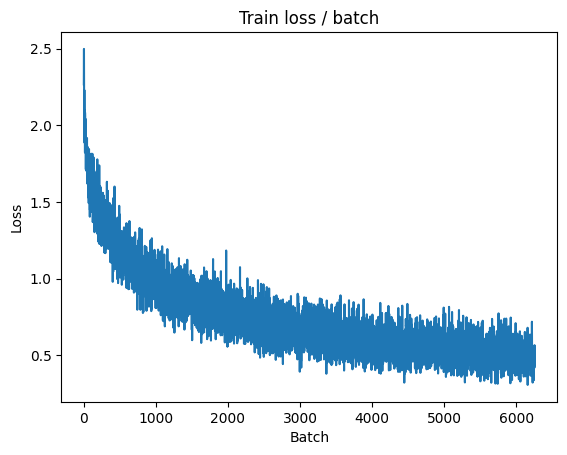

[TRAIN Batch 200/391]	Time 0.063s (0.061s)	Loss 0.5026 (0.4805)	Prec@1  81.2 ( 83.3)	Prec@5 100.0 ( 99.3)


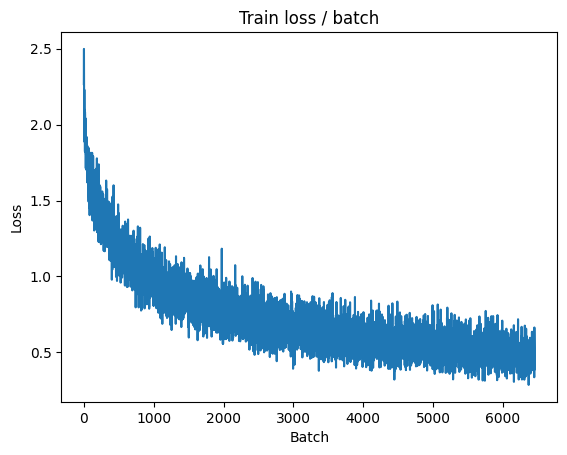


===============> Total time 23s	Avg loss 0.4813	Avg Prec@1 83.22 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 0.5314 (0.5314)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5515	Avg Prec@1 81.06 %	Avg Prec@5 99.02 %



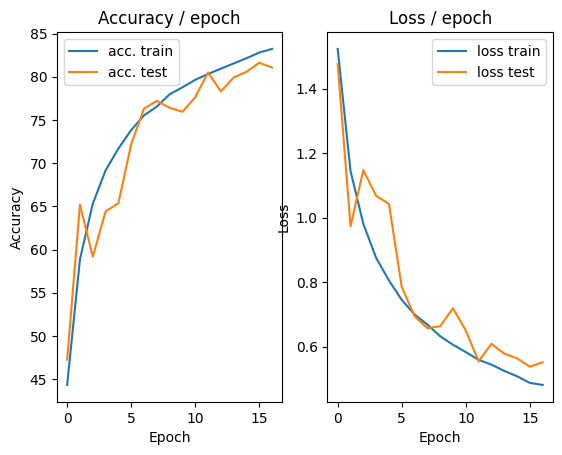

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 0.5477 (0.5477)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


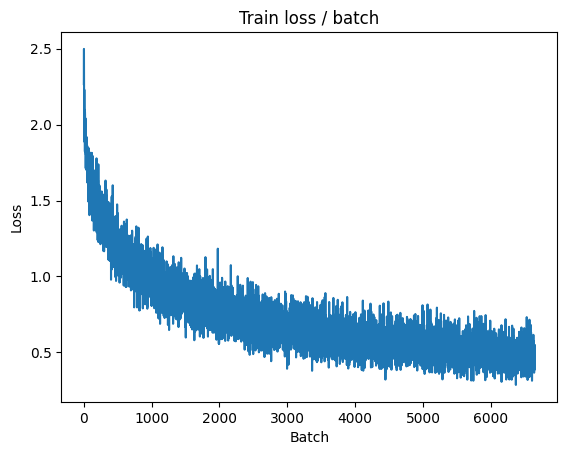

[TRAIN Batch 200/391]	Time 0.057s (0.062s)	Loss 0.4982 (0.4586)	Prec@1  83.6 ( 83.8)	Prec@5  99.2 ( 99.4)


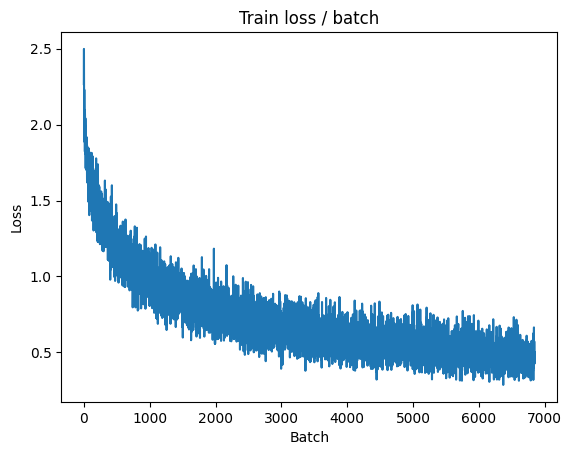


===============> Total time 23s	Avg loss 0.4653	Avg Prec@1 83.78 %	Avg Prec@5 99.30 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 0.5069 (0.5069)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5376	Avg Prec@1 81.14 %	Avg Prec@5 99.16 %



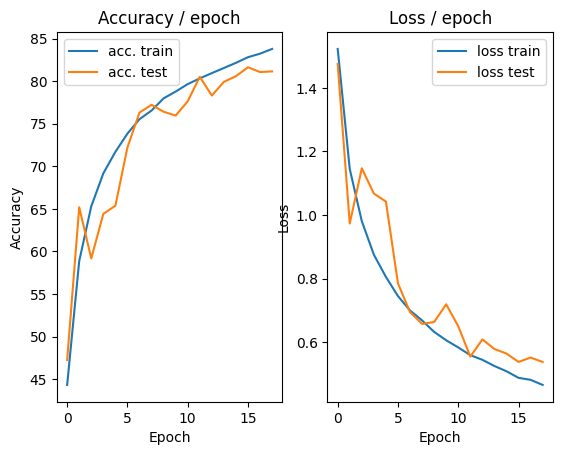

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 0.4365 (0.4365)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


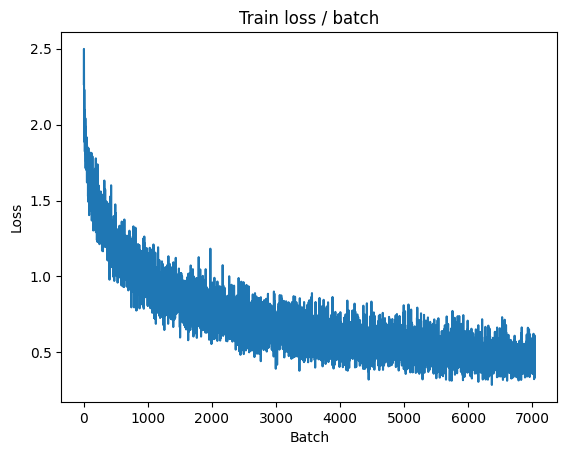

[TRAIN Batch 200/391]	Time 0.058s (0.061s)	Loss 0.5629 (0.4538)	Prec@1  83.6 ( 84.0)	Prec@5  97.7 ( 99.3)


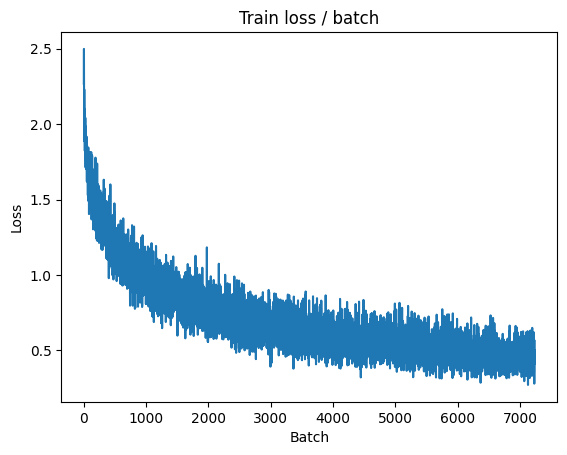


===============> Total time 23s	Avg loss 0.4534	Avg Prec@1 84.15 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.254s (0.254s)	Loss 0.4534 (0.4534)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4996	Avg Prec@1 82.47 %	Avg Prec@5 99.16 %



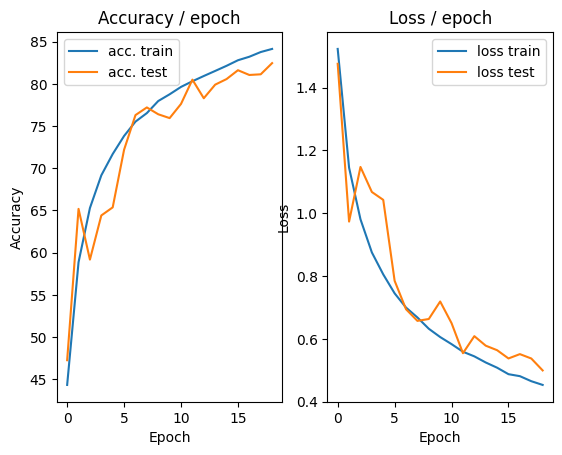

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.3701 (0.3701)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


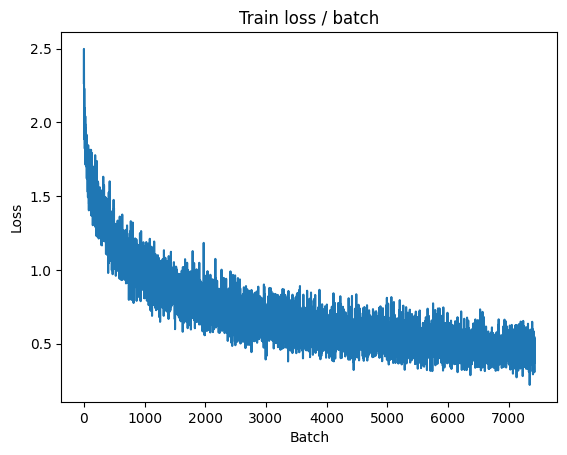

[TRAIN Batch 200/391]	Time 0.061s (0.061s)	Loss 0.3650 (0.4425)	Prec@1  83.6 ( 84.5)	Prec@5 100.0 ( 99.4)


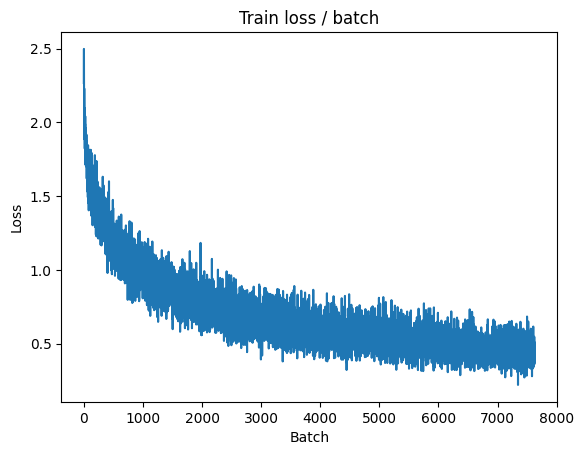


===============> Total time 23s	Avg loss 0.4429	Avg Prec@1 84.51 %	Avg Prec@5 99.41 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 0.4391 (0.4391)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.5005	Avg Prec@1 82.64 %	Avg Prec@5 99.11 %



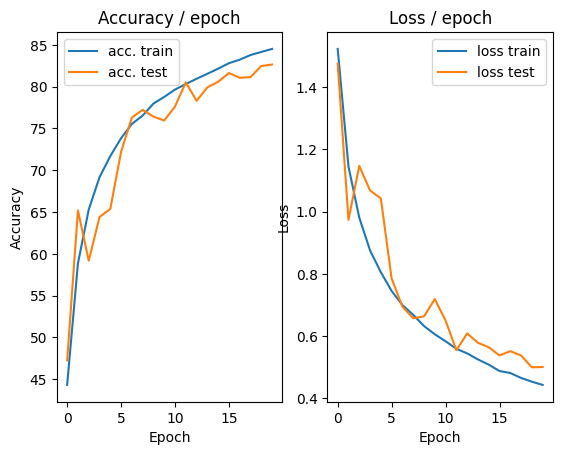

In [20]:
main(batch_size, lr, epochs, cuda=True)